In [1]:
##Experimento 01
## En este experimento agregamos los identificadores de arasaac al modelo
## Formato identificados: pict_id_palabra

In [2]:
!python --version

import torch
print(torch.__version__)
print(torch.cuda.is_available())

!pip install transformers==4.50.0
!pip install -U datasets
!pip install tensorboard
!pip install sentencepiece
!pip install accelerate
!pip install evaluate==0.4.0
!pip install bleu
!pip install -U scikit-learn
!pip install nltk datasets
!pip install sacrebleu

Python 3.10.15
2.5.1+cu118
True
Defaulting to user installation because normal site-packages is not writeable
   ---------------------------------------- 0.0/10.2 MB ? eta -:--:--
   ---------------------------------------- 10.2/10.2 MB 79.4 MB/s eta 0:00:00


  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.


Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable


In [8]:
import os
import torch
import numpy as np
import evaluate
import sacrebleu
import transformers
from datasets import load_dataset
from transformers import AutoTokenizer, AutoModelForSeq2SeqLM, Seq2SeqTrainingArguments, Seq2SeqTrainer, DataCollatorForSeq2Seq

os.environ["CUDA_VISIBLE_DEVICES"]="1,3"
os.environ["PYTORCH_CUDA_ALLOC_CONF"] = "max_split_size_mb:32"

torch.cuda.empty_cache()

In [9]:
print(transformers.__version__)


4.50.0


In [10]:
import json
lista_pictogramas_ids=[]
with open("ids_id_word.txt", 'r', encoding='utf-8') as archivo:
  lineas = archivo.readlines()
  for linea in lineas:
    lista_pictogramas_ids.append(linea.strip())

print(len(lista_pictogramas_ids))

20132


In [11]:
dataset_train = load_dataset('json', data_files='train_data.json')['train']
dataset_test = load_dataset('json', data_files='test_data.json')['train']
dataset_valid = load_dataset('json', data_files='validation_data.json')['train']

# Mostrar estadísticas básicas
print(dataset_train)
print(dataset_test)
print(dataset_valid)

Dataset({
    features: ['id', 'oracion', 'traduccion'],
    num_rows: 15208
})
Dataset({
    features: ['id', 'oracion', 'traduccion'],
    num_rows: 973
})
Dataset({
    features: ['id', 'oracion', 'traduccion'],
    num_rows: 973
})


In [12]:
model_checkpoint = "flax-community/spanish-t5-small" #"vgaraujov/t5-base-spanish"

tokenizer = AutoTokenizer.from_pretrained(model_checkpoint)
model = AutoModelForSeq2SeqLM.from_pretrained(model_checkpoint)

total_params = sum(p.numel() for p in model.parameters())
print(f"{total_params:,} total parameters.")

total_trainable_params = sum(
    p.numel() for p in model.parameters() if p.requires_grad)
print(f"{total_trainable_params:,} training parameters.")

# Agregar nuevos tokens al tokenizer
existing_tokens = set(tokenizer.get_vocab().keys())
new_tokens = [token for token in lista_pictogramas_ids if token not in existing_tokens]
tokenizer.add_tokens(new_tokens)

model.resize_token_embeddings(len(tokenizer))

# Validar parámetros actualizados
print("After adding new tokens:")
total_params = sum(p.numel() for p in model.parameters())
print(f"{total_params:,} total parameters.")
total_trainable_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
print(f"{total_trainable_params:,} training parameters.")

new_token_ids = tokenizer.convert_tokens_to_ids(new_tokens)
print(f"Sample IDs of new tokens: {new_token_ids[:10]}")

new_embeddings = model.get_input_embeddings().weight.data[new_token_ids]
print("Sample embeddings for new tokens:", new_embeddings[:5])

data_collator = DataCollatorForSeq2Seq(tokenizer, model=model)

# Convertir los nuevos tokens a sus IDs
new_token_ids = tokenizer.convert_tokens_to_ids(new_tokens)

# Mostrar ejemplos de tokens agregados y sus IDs
for token, token_id in zip(new_tokens[:10], new_token_ids[:10]):
    print(f"Token: {token}, ID: {token_id}")

60,493,824 total parameters.
60,493,824 training parameters.


The new embeddings will be initialized from a multivariate normal distribution that has old embeddings' mean and covariance. As described in this article: https://nlp.stanford.edu/~johnhew/vocab-expansion.html. To disable this, use `mean_resizing=False`


After adding new tokens:
70,781,440 total parameters.
70,781,440 training parameters.
Sample IDs of new tokens: [32103, 32104, 32105, 32106, 32107, 32108, 32109, 32110, 32111, 32112]
Sample embeddings for new tokens: tensor([[ 0.4680, -0.5676, -0.4633,  ...,  0.7039, -0.5304, -0.0856],
        [ 0.4680, -0.5677, -0.4634,  ...,  0.7040, -0.5305, -0.0855],
        [ 0.4681, -0.5677, -0.4634,  ...,  0.7039, -0.5304, -0.0856],
        [ 0.4681, -0.5677, -0.4633,  ...,  0.7039, -0.5305, -0.0855],
        [ 0.4680, -0.5676, -0.4633,  ...,  0.7039, -0.5305, -0.0855]])
Token: pict_2247_acera, ID: 32103
Token: pict_2247_vereda, ID: 32104
Token: pict_2248_agua, ID: 32105
Token: pict_2249_alfombra, ID: 32106
Token: pict_2250_almohada, ID: 32107
Token: pict_2251_ambulancia, ID: 32108
Token: pict_2252_anillo, ID: 32109
Token: pict_2253_antena, ID: 32110
Token: pict_2253_parabólica, ID: 32111
Token: pict_2254_araña, ID: 32112


In [13]:
model.to(torch.device('cuda'))
model.device

device(type='cuda', index=0)

In [14]:
max_input_length = 40
max_target_length = 40

batch_size=16
metric ="bleu"
model_name = "t5-xgen-finetuned"
evaluation_strategy = "epoch"
save_strategy="epoch"
overwrite_output_dir=True
learning_rate=10e-5
gradient_accumulation_steps=1
weight_decay=0.01
do_train=True
do_eval=True
save_total_limit=20
num_train_epochs=20
seed=42
predict_with_generate=True
fp16=True
metric_for_best_model="bleu"
load_best_model_at_end=True
generation_max_length = max_target_length
logging_strategy="epoch"
eval_accumulation_steps=2

In [15]:
def preprocess_function(examples):
    inputs = ["translate: " + oracion for oracion in examples['oracion']]
    model_inputs = tokenizer(inputs, max_length=max_input_length, truncation=True, padding="max_length")    
    labels = tokenizer(text_target=examples["traduccion"], max_length=max_target_length, truncation=True, padding="max_length")
    model_inputs["labels"] = labels["input_ids"]
    return model_inputs

In [16]:
encoded_train = dataset_train.map(preprocess_function, batched=True)
encoded_test = dataset_test.map(preprocess_function, batched=True)
encoded_validation = dataset_valid.map(preprocess_function, batched=True)

Map:   0%|          | 0/973 [00:00<?, ? examples/s]

In [17]:
bleu_metric = evaluate.load("bleu")
chrf_metric = evaluate.load('chrf')

def compute_metrics_v2(eval_preds):
    print(f"metrics v2")
    predictions, labels = eval_preds

    # Reemplazar -100 con pad_token_id tanto en predicciones como en etiquetas
    pad_token_id = tokenizer.pad_token_id
    predictions = np.where(predictions != -100, predictions, pad_token_id)
    labels = np.where(labels != -100, labels, pad_token_id)
    
    decoded_preds = tokenizer.batch_decode(predictions, skip_special_tokens=True)
    decoded_labels = tokenizer.batch_decode(labels, skip_special_tokens=True)
     
    # Asegurarse de que BLEU reciba cadenas completas, no listas de palabras
    preds = [" ".join(pred.split()) for pred in decoded_preds]
    refs = [[" ".join(label.split())] for label in decoded_labels]  # Lista de listas para referencias
    
    print(f"bleu_preds {preds}")
    print(f"bleu_refs {refs}")
    
    # Calcular BLEU
    try:
        bleu_result = bleu_metric.compute(predictions=preds, references=refs)
        bleu_score = {"bleu": bleu_result["bleu"], "precisions": bleu_result["precisions"]}
    except Exception as e:
        print(f"Error al calcular BLEU: {e}")
        bleu_score = {"bleu": 0.0}

    # Calcular CHRF++
    try:
        chrf_result = chrf_metric.compute(predictions=preds, references=refs, word_order = 2)
        print(chrf_result)
        chrf_score = {"chrf": chrf_result["score"]}
    except Exception as e:
        print(f"Error al calcular CHRF++: {e}")
        chrf_score = {"chrf": 0.0}
        
    # Combinar resultados
    combined_results = {**bleu_score, **chrf_score}
    return combined_results

In [19]:
from transformers import Seq2SeqTrainingArguments, Seq2SeqTrainer
args = Seq2SeqTrainingArguments(
    output_dir="./results",
    eval_strategy = evaluation_strategy,
    save_strategy = save_strategy,
    overwrite_output_dir = overwrite_output_dir,
    learning_rate = learning_rate,
    per_device_train_batch_size = batch_size,
    per_device_eval_batch_size= batch_size,
    gradient_accumulation_steps= gradient_accumulation_steps,
    weight_decay= weight_decay,
    do_train= do_train,
    do_eval= do_eval,
    save_total_limit= save_total_limit,
    num_train_epochs= num_train_epochs,
    seed= seed,
    predict_with_generate= predict_with_generate,
    fp16= fp16,
    generation_max_length=generation_max_length,
    logging_strategy=logging_strategy,
    load_best_model_at_end=True,
    metric_for_best_model="bleu",
    )

trainer = Seq2SeqTrainer(
    model,
    args,
    train_dataset=encoded_train,
    eval_dataset=encoded_test,
    data_collator=data_collator,
    tokenizer=tokenizer,
    compute_metrics=compute_metrics_v2
)



C:\Users\apare\AppData\Local\Temp\ipykernel_15220\1475620636.py:25: FutureWarning: `tokenizer` is deprecated and will be removed in version 5.0.0 for `Seq2SeqTrainer.__init__`. Use `processing_class` instead.
  trainer = Seq2SeqTrainer(


In [ ]:
trainer.train()

Passing a tuple of `past_key_values` is deprecated and will be removed in Transformers v4.48.0. You should pass an instance of `EncoderDecoderCache` instead, e.g. `past_key_values=EncoderDecoderCache.from_legacy_cache(past_key_values)`.


Epoch,Training Loss,Validation Loss,Bleu,Precisions,Chrf
1,1.182800,1.002123,0.000000,"[0.4473684210526316, 0.0, 0.0, 0.0]",1.321918
2,0.772700,0.970394,0.000000,"[0.33459982409850486, 0.10924124867956143, 0.00267833565958731, 0.0]",16.523587


metrics v2
bleu_preds ['', '', '', '', 'tallo', '', '', '', '', '', '', '', '', '', '', 'inflamación', '', '', '', 'voz digitalizada', 'té', 'traigo', '', '', '', '', 'presentación', '', 'crujirse', '', 'mezclar', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', 'corregir', '', '', 'sentado', '', '', '', '', '', '', '', '', '', '', '', '', '', 'yo', '', '', '', 'elaborar', 'prohibido', '', '', '', '', '', '', 'elaborar', '', '', '', '', '', '', '', '', '', '', '', '', 'yo', '', '', 'señalar', '', '', 'salvemos', '', '', '', '', '', '', '', '', 'sumar', '', 'suelto', '', '', '', 'cartulinas', '', '', 'maría', '', '', 'adiós', '', '', 'venus', 'describe', '', 'clara', '', '', '', '', '', 'yo', '', '', '', '', '', '', '', '', '', 'yo', '11 bolsas', '', '', '', 'dolorido', 'érase', 'nosotras', 'enjabonar', '', '', 'rastrillo', '', 'crea crea', '', 'preocupada', '', '', '', '', '', '', 'clara', '', 'marciales', '', '', '', '', '', '', '', '', '', '', '', 'anoto', 

Trainer is attempting to log a value of "[0.4473684210526316, 0.0, 0.0, 0.0]" of type <class 'list'> for key "eval/precisions" as a scalar. This invocation of Tensorboard's writer.add_scalar() is incorrect so we dropped this attribute.


{'score': 1.3219184670084736, 'char_order': 6, 'word_order': 2, 'beta': 2}
metrics v2
bleu_preds ['pict_3418_? pict_3418_? pict_3418_? pict_3418_? pict_3418_?', 'pict_3418_? voto pict_3418_? pict_3418_?', 'pict_3418_? pict_3418_? pict_3418_? pict_3418_? pict_3418_? pict_3418_? pict_3418_? pict_3418_? pict_3418_? pict_3418_? pict_3418_? pict_3418_? pict_3418_? pict_3418_? pict_3418_? pict_3418_? pict_3418_? pict_3418_? pict_3418_? pict_3418_?', 'pict_3418_? pict_3418_? algo pict_3418_? pict_3418_? pict_3418_?', 'tallo', 'pict_3418_? pict_3418_? pict_3418_? pict_3418_? pict_3418_? pict_3418_? pict_3418_? pict_3418_? pict_3418_? pict_3418_? pict_3418_?', 'pict_3418_? pict_3418_? pict_3418_? pict_3418_? pict_3418_? pict_3418_? pict_3418_? pict_3418_? pict_3418_? pict_3418_? pict_3418_? pict_3418_? pict_3418_? pict_3418_? pict_3418_? pict_3418_?', 'pict_3418_? pict_3418_? pict_3418_? pict_3418_? pict_3418_?', 'pict_3418_? pict_3418_? pict_3418_? cosas pict_3418_? pict_3418_?', 'pict_3418_? 

Trainer is attempting to log a value of "[0.33459982409850486, 0.10924124867956143, 0.00267833565958731, 0.0]" of type <class 'list'> for key "eval/precisions" as a scalar. This invocation of Tensorboard's writer.add_scalar() is incorrect so we dropped this attribute.


{'score': 16.52358685786072, 'char_order': 6, 'word_order': 2, 'beta': 2}


In [6]:
## Se necesita saber con exactitud como se llama el folder para cargar el mejor modelo

tokenizerv1 = AutoTokenizer.from_pretrained('./results/checkpoint-19220')
modelv1 = AutoModelForSeq2SeqLM.from_pretrained('./results/checkpoint-19220')

device1 = torch.device("cuda")
modelv1.to(device1)
modelv1.eval()

T5ForConditionalGeneration(
  (shared): Embedding(70918, 512)
  (encoder): T5Stack(
    (embed_tokens): Embedding(70918, 512)
    (block): ModuleList(
      (0): T5Block(
        (layer): ModuleList(
          (0): T5LayerSelfAttention(
            (SelfAttention): T5Attention(
              (q): Linear(in_features=512, out_features=512, bias=False)
              (k): Linear(in_features=512, out_features=512, bias=False)
              (v): Linear(in_features=512, out_features=512, bias=False)
              (o): Linear(in_features=512, out_features=512, bias=False)
              (relative_attention_bias): Embedding(32, 8)
            )
            (layer_norm): T5LayerNorm()
            (dropout): Dropout(p=0.1, inplace=False)
          )
          (1): T5LayerFF(
            (DenseReluDense): T5DenseActDense(
              (wi): Linear(in_features=512, out_features=2048, bias=False)
              (wo): Linear(in_features=2048, out_features=512, bias=False)
              (dropout): Drop

In [8]:
!pip install matplotlib

# Función para preparar los datos para la predicción
def prepare_data_for_prediction(dataset, tokenizer):
    # Transformar los datos para que sean aptos para el modelo
    prepared_data = []
    for example in dataset:
        inputs = tokenizerv1("translate: " + example['oracion'], return_tensors="pt", padding="max_length", truncation=True, max_length=max_input_length)
        inputs = {k: v.to(device1) for k, v in inputs.items()}
        prepared_data.append(inputs)
    return prepared_data

# Preparar los datos de validación para la predicción
prepared_validation_data = prepare_data_for_prediction(dataset_valid, tokenizerv1)

# Lista para guardar las predicciones
predictions = []

# Generar predicciones para cada entrada en los datos de validación
for inputs in prepared_validation_data:
    with torch.no_grad():
        outputs = modelv1.generate(**inputs, max_length=max_target_length)
    decoded_output = tokenizerv1.decode(outputs[0], skip_special_tokens=True)
    predictions.append(decoded_output)

# Imprimir las predicciones
for i, prediction in enumerate(predictions):
    print(f"Oracion: {dataset_valid[i]}, Prediction {i+1}: {prediction}")

Oracion: {'id': 0, 'oracion': 'Vivo en Sudamérica', 'traduccion': 'pict_7302_vivir pict_7034_en pict_34387_Sudamérica'}, Prediction 1: pict_9819_lugar pict_7034_en sudamérica
Oracion: {'id': 1, 'oracion': '¿Quiénes leerán el poster?', 'traduccion': 'pict_13358_quiénes pict_31680_leer pict_8476_el pict_28881_póster'}, Prediction 2: pict_3415_¿ pict_22619_cómo pict_7141_leer pict_8476_el poster pict_3418_?
Oracion: {'id': 2, 'oracion': 'Organizar una obra de teatro', 'traduccion': 'pict_35653_organizar pict_8474_una pict_11319_obra_de_teatro'}, Prediction 3: pict_15485_usar pict_8474_una pict_9870_exposición pict_7074_de pict_4649_feria
Oracion: {'id': 3, 'oracion': 'Mira el paisaje', 'traduccion': 'pict_2474_mirar pict_8476_el pict_10304_paisaje'}, Prediction 4: pict_8579_explicar pict_8476_el pict_2248_agua
Oracion: {'id': 4, 'oracion': 'Observa al niño trabajar', 'traduccion': 'pict_2474_observar pict_11709_al pict_7176_niño pict_2599_trabajar'}, Prediction 5: pict_8579_explicar pict_

In [31]:
from IPython.display import display

import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from PIL import Image 

def obtener_tokens(oracion):
    resultado = []
    token = oracion.strip().split(" ")
    n = len(token)
    #print(n)
    
    i = 0
    while i < n:
        token_strip = token[i].strip()
        
        if not token_strip.startswith("pict_"):
            resultado.append(token_strip)
            i = i + 1
            continue

        elements = token_strip.strip().split("_")
        pict_id = elements[1]
        tail = elements[len(elements)-1]
            
        if tail != "past" and tail != "future" and tail != "plural":
            resultado.append(f"./imagenes_procesadas/pict_{pict_id}.png")
        else:
            resultado.append(f"./imagenes_procesadas/pict_{pict_id}_{tail}.png")

        i = i + 1
    return resultado
    

def imprimir_imagenes(rutas_imagenes):
    num_imagenes = len(rutas_imagenes)

    # Crear subplots
    fig, axes = plt.subplots(1, num_imagenes, figsize=(5, 5))
    if num_imagenes == 1:
        axes = [axes]  # Convertir en lista si es un único subplot

    for ax, ruta_imagen in zip(axes, rutas_imagenes):
        #print(f"Procesando: {ruta_imagen}")  # Debugging
        if "imagenes_procesadas" in ruta_imagen:
            try:
                img = mpimg.imread(ruta_imagen)  # Usar matplotlib para cargar la imagen
                ax.imshow(img)
                ax.axis('off')
            except Exception as e:
                ax.axis('off')
                ax.text(0.5, 0.5, f"Error: {str(e)}", fontsize=12, ha='center', va='center')
        else:
            ax.axis('off')  # Ocultar los ejes
            ax.text(0.5, 0.5, ruta_imagen, fontsize=12, ha='center', va='center')

    plt.tight_layout()
    plt.show()

In [24]:
import os

ruta = "./imagenes_procesadas"
archivos = os.listdir(ruta)
print(archivos)

['pict_10133.png', 'pict_10133_future.png', 'pict_10133_past.png', 'pict_10135.png', 'pict_10135_plural.png', 'pict_10137.png', 'pict_10137_future.png', 'pict_10137_past.png', 'pict_10138.png', 'pict_10138_future.png', 'pict_10138_past.png', 'pict_10139.png', 'pict_10139_future.png', 'pict_10139_past.png', 'pict_10140.png', 'pict_10140_future.png', 'pict_10140_past.png', 'pict_10141.png', 'pict_10141_future.png', 'pict_10141_past.png', 'pict_10142.png', 'pict_10142_future.png', 'pict_10142_past.png', 'pict_10143.png', 'pict_10143_future.png', 'pict_10143_past.png', 'pict_10144.png', 'pict_10144_future.png', 'pict_10144_past.png', 'pict_10145.png', 'pict_10145_future.png', 'pict_10145_past.png', 'pict_10146.png', 'pict_10146_future.png', 'pict_10146_past.png', 'pict_10147.png', 'pict_10147_future.png', 'pict_10147_past.png', 'pict_10148.png', 'pict_10148_future.png', 'pict_10148_past.png', 'pict_10149.png', 'pict_10149_future.png', 'pict_10149_past.png', 'pict_10150.png', 'pict_10150_fu

Oracion: pict_7302_vivir pict_7034_en pict_34387_Sudamérica
3
Procesando: ./imagenes_procesadas/pict_7302.png
Procesando: ./imagenes_procesadas/pict_7034.png
Procesando: ./imagenes_procesadas/pict_34387.png


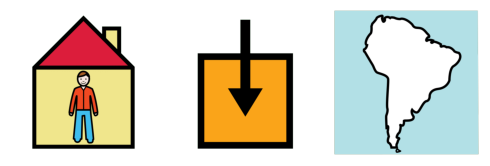

Prediction pict_9819_lugar pict_7034_en sudamérica
3
['./imagenes_procesadas/pict_9819.png', './imagenes_procesadas/pict_7034.png', 'sudamérica']
Procesando: ./imagenes_procesadas/pict_9819.png
Procesando: ./imagenes_procesadas/pict_7034.png
Procesando: sudamérica


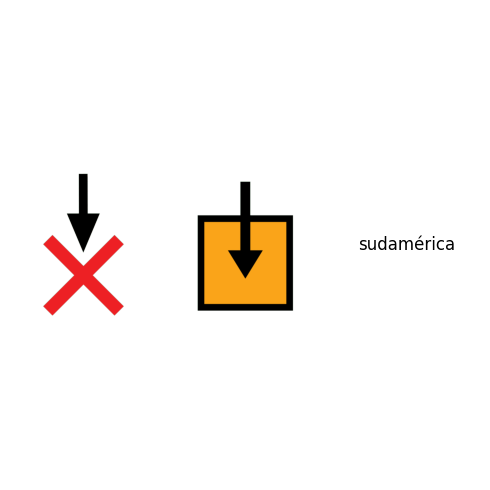

Oracion: pict_13358_quiénes pict_31680_leer pict_8476_el pict_28881_póster
4
Procesando: ./imagenes_procesadas/pict_13358.png
Procesando: ./imagenes_procesadas/pict_31680.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_28881.png


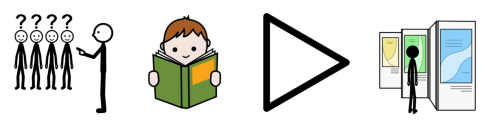

Prediction pict_3415_¿ pict_22619_cómo pict_7141_leer pict_8476_el poster pict_3418_?
6
['./imagenes_procesadas/pict_3415.png', './imagenes_procesadas/pict_22619.png', './imagenes_procesadas/pict_7141.png', './imagenes_procesadas/pict_8476.png', 'poster', './imagenes_procesadas/pict_3418.png']
Procesando: ./imagenes_procesadas/pict_3415.png
Procesando: ./imagenes_procesadas/pict_22619.png
Procesando: ./imagenes_procesadas/pict_7141.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: poster
Procesando: ./imagenes_procesadas/pict_3418.png


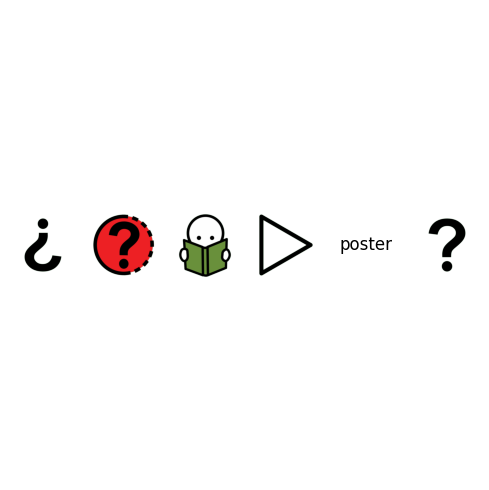

Oracion: pict_35653_organizar pict_8474_una pict_11319_obra_de_teatro
3
Procesando: ./imagenes_procesadas/pict_35653.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_11319.png


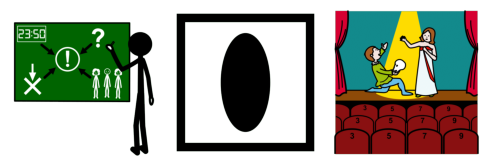

Prediction pict_15485_usar pict_8474_una pict_9870_exposición pict_7074_de pict_4649_feria
5
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_9870.png', './imagenes_procesadas/pict_7074.png', './imagenes_procesadas/pict_4649.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_9870.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_4649.png


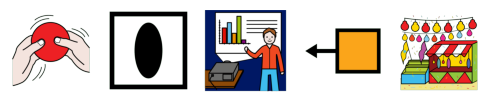

Oracion: pict_2474_mirar pict_8476_el pict_10304_paisaje
3
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_10304.png


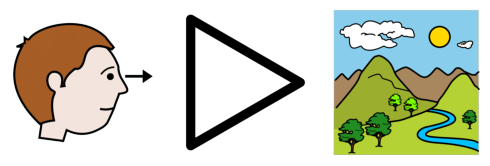

Prediction pict_8579_explicar pict_8476_el pict_2248_agua
3
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_8476.png', './imagenes_procesadas/pict_2248.png']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_2248.png


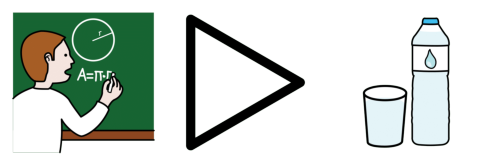

Oracion: pict_2474_observar pict_11709_al pict_7176_niño pict_2599_trabajar
4
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_11709.png
Procesando: ./imagenes_procesadas/pict_7176.png
Procesando: ./imagenes_procesadas/pict_2599.png


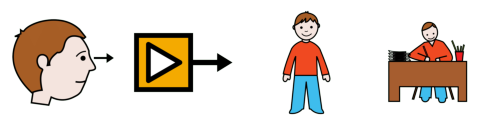

Prediction pict_8579_explicar pict_11709_al pict_9819_lugar pict_8029_aprender
4
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_11709.png', './imagenes_procesadas/pict_9819.png', './imagenes_procesadas/pict_8029.png']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_11709.png
Procesando: ./imagenes_procesadas/pict_9819.png
Procesando: ./imagenes_procesadas/pict_8029.png


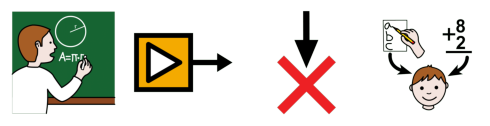

Oracion: pict_2872_ordenar pict_8476_la pict_7233_ropa
3
Procesando: ./imagenes_procesadas/pict_2872.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_7233.png


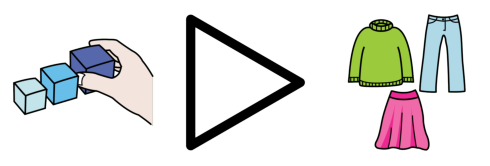

Prediction pict_9030_responder pict_7029_la pict_2248_agua
3
['./imagenes_procesadas/pict_9030.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_2248.png']
Procesando: ./imagenes_procesadas/pict_9030.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_2248.png


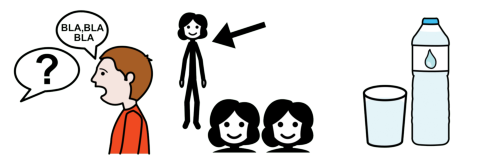

Oracion: pict_9030_responder pict_8476_la pict_7217_pregunta
3
Procesando: ./imagenes_procesadas/pict_9030.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_7217.png


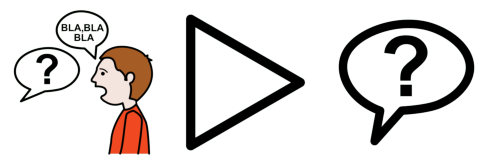

Prediction pict_3345_hablar pict_7031_las pict_7217_pregunta
3
['./imagenes_procesadas/pict_3345.png', './imagenes_procesadas/pict_7031.png', './imagenes_procesadas/pict_7217.png']
Procesando: ./imagenes_procesadas/pict_3345.png
Procesando: ./imagenes_procesadas/pict_7031.png
Procesando: ./imagenes_procesadas/pict_7217.png


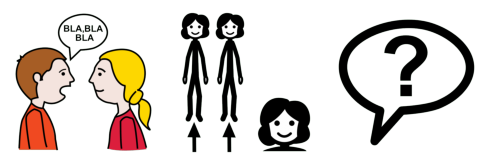

Oracion: pict_31807_yo pict_7271_tener pict_10312_lápiz_y_papel
3
Procesando: ./imagenes_procesadas/pict_31807.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_10312.png


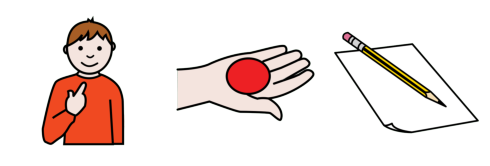

Prediction pict_15485_usar pict_7271_tener pict_7141_leer pict_3047_y pict_11572_plantas
5
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_7141.png', './imagenes_procesadas/pict_3047.png', './imagenes_procesadas/pict_11572.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_7141.png
Procesando: ./imagenes_procesadas/pict_3047.png
Procesando: ./imagenes_procesadas/pict_11572.png


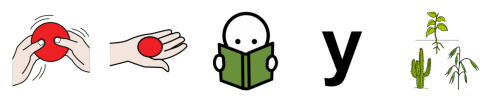

Oracion: pict_9870_exponer pict_8477_los pict_24769_trabajos_manuales
3
Procesando: ./imagenes_procesadas/pict_9870.png
Procesando: ./imagenes_procesadas/pict_8477.png
Procesando: ./imagenes_procesadas/pict_24769.png


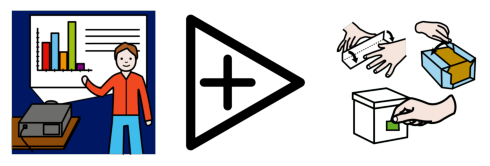

Prediction pict_8579_explicar pict_7033_los pict_37340_texto manuales
4
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_7033.png', './imagenes_procesadas/pict_37340.png', 'manuales']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_7033.png
Procesando: ./imagenes_procesadas/pict_37340.png
Procesando: manuales


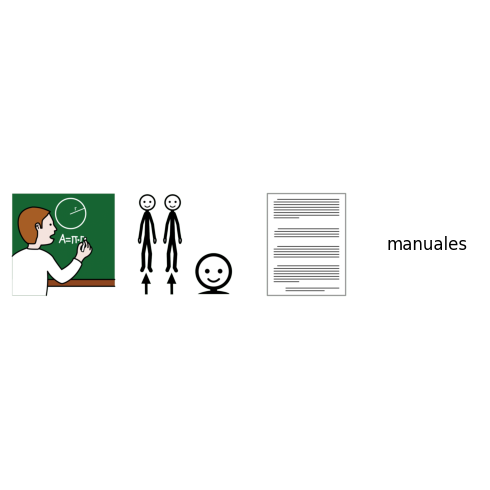

Oracion: pict_7309_yo pict_24711_prestar_atención
2
Procesando: ./imagenes_procesadas/pict_7309.png
Procesando: ./imagenes_procesadas/pict_24711.png


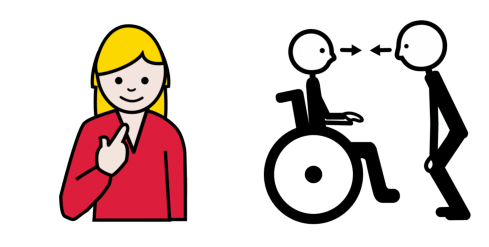

Prediction pict_15485_usar pict_3189_, pict_9870_presentar pict_9819_lugar
4
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_3189.png', './imagenes_procesadas/pict_9870.png', './imagenes_procesadas/pict_9819.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_3189.png
Procesando: ./imagenes_procesadas/pict_9870.png
Procesando: ./imagenes_procesadas/pict_9819.png


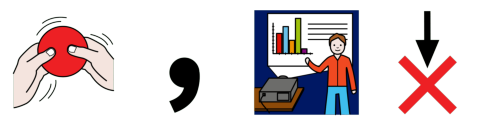

Oracion: pict_32054_visión_borrosa
1
Procesando: ./imagenes_procesadas/pict_32054.png


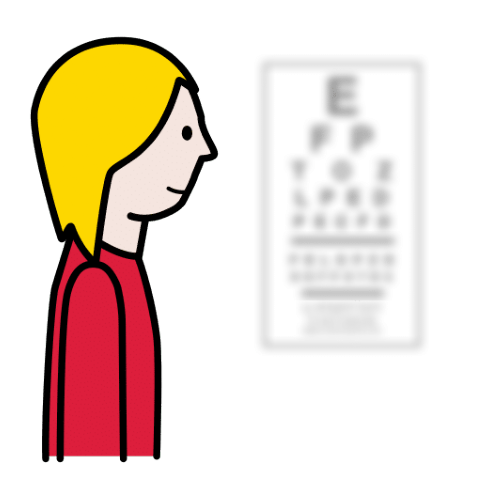

Prediction visión borrosa
2
['visión', 'borrosa']
Procesando: visión
Procesando: borrosa


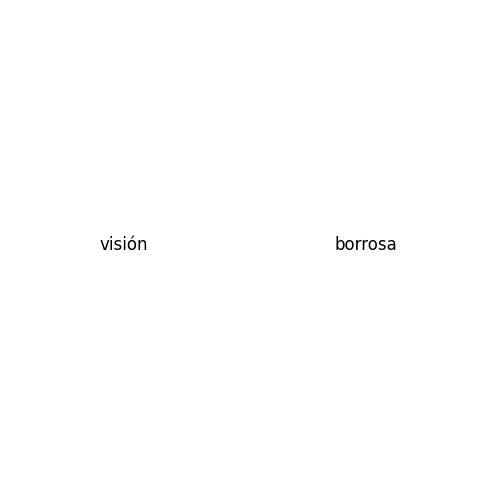

Oracion: pict_8107_escribir pict_12283_tus pict_32584_cualidades
3
Procesando: ./imagenes_procesadas/pict_8107.png
Procesando: ./imagenes_procesadas/pict_12283.png
Procesando: ./imagenes_procesadas/pict_32584.png


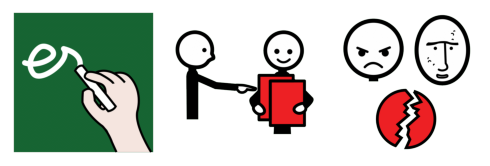

Prediction pict_2380_escribir pict_12281_tu pict_11572_plantas
3
['./imagenes_procesadas/pict_2380.png', './imagenes_procesadas/pict_12281.png', './imagenes_procesadas/pict_11572.png']
Procesando: ./imagenes_procesadas/pict_2380.png
Procesando: ./imagenes_procesadas/pict_12281.png
Procesando: ./imagenes_procesadas/pict_11572.png


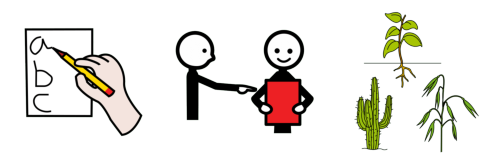

Oracion: pict_24721_clima pict_25153_helada
2
Procesando: ./imagenes_procesadas/pict_24721.png
Procesando: ./imagenes_procesadas/pict_25153.png


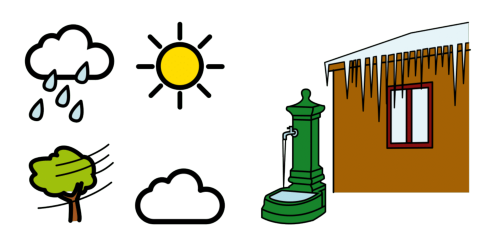

Prediction pict_9819_lugar pict_22769_artesanía
2
['./imagenes_procesadas/pict_9819.png', './imagenes_procesadas/pict_22769.png']
Procesando: ./imagenes_procesadas/pict_9819.png
Procesando: ./imagenes_procesadas/pict_22769.png


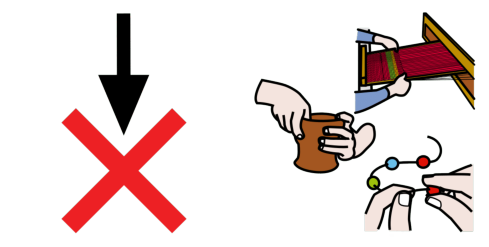

Oracion: pict_2617_me pict_9901_inscripción
2
Procesando: ./imagenes_procesadas/pict_2617.png
Procesando: ./imagenes_procesadas/pict_9901.png


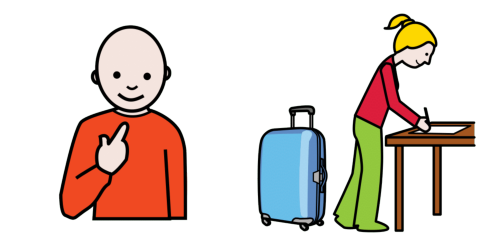

Prediction pict_7271_tener inscribiré
2
['./imagenes_procesadas/pict_7271.png', 'inscribiré']
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: inscribiré


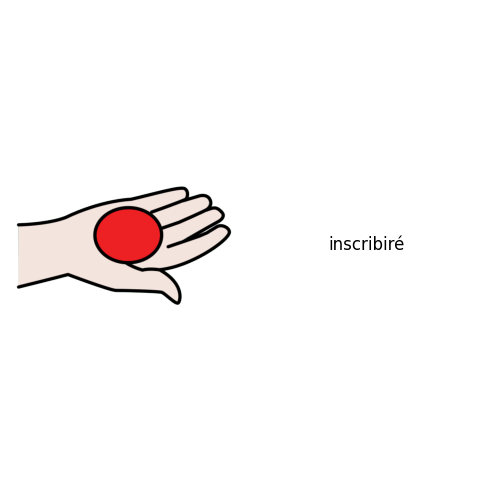

Oracion: pict_6014_iceberg
1
Procesando: ./imagenes_procesadas/pict_6014.png


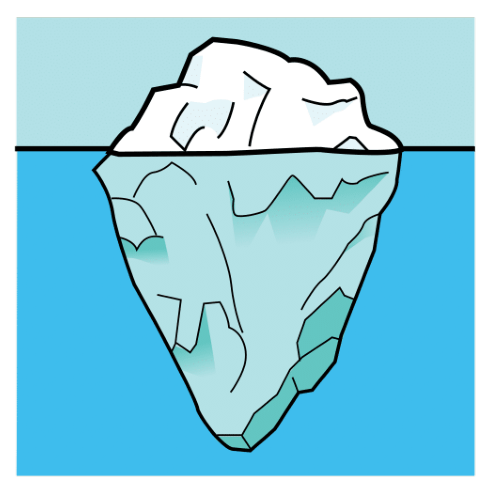

Prediction iceberg
1
['iceberg']
Procesando: iceberg


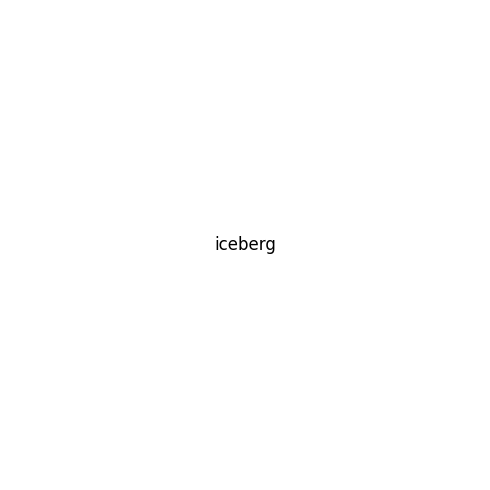

Oracion: pict_6156_yo_no_quiero pict_29839_nada
2
Procesando: ./imagenes_procesadas/pict_6156.png
Procesando: ./imagenes_procesadas/pict_29839.png


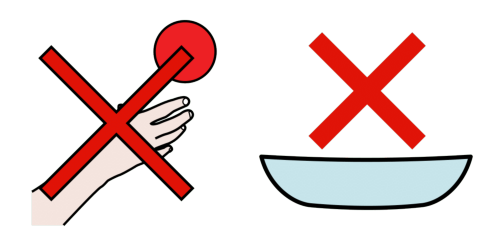

Prediction pict_15485_usar pict_5526_no pict_7271_tener pict_3220_más
4
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_5526.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_3220.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_5526.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_3220.png


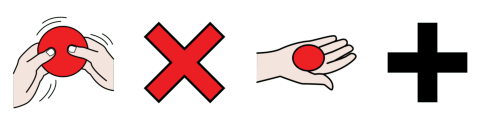

Oracion: pict_2474_observar pict_2408_globo
2
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_2408.png


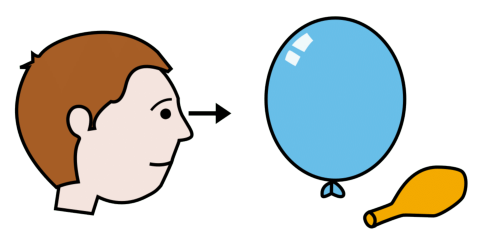

Prediction pict_8579_explicar pict_7033_los pict_11572_plantas
3
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_7033.png', './imagenes_procesadas/pict_11572.png']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_7033.png
Procesando: ./imagenes_procesadas/pict_11572.png


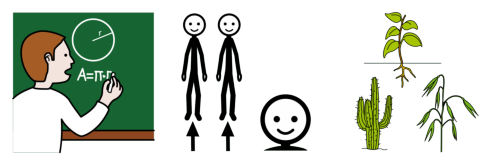

Oracion: pict_2474_observar pict_8476_la pict_4682_línea_ondulada
3
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_4682.png


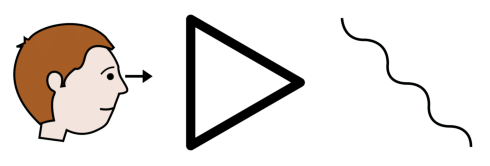

Prediction pict_8579_explicar pict_7029_la pict_9870_exposición ondulada
4
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_9870.png', 'ondulada']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_9870.png
Procesando: ondulada


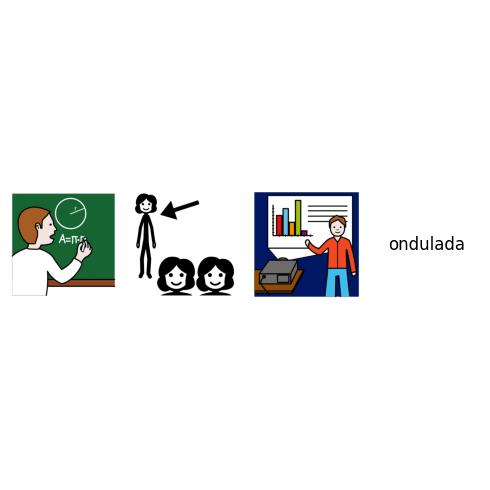

Oracion: pict_6599_proteger pict_7041_a pict_8477_los pict_11375_seres_vivos
4
Procesando: ./imagenes_procesadas/pict_6599.png
Procesando: ./imagenes_procesadas/pict_7041.png
Procesando: ./imagenes_procesadas/pict_8477.png
Procesando: ./imagenes_procesadas/pict_11375.png


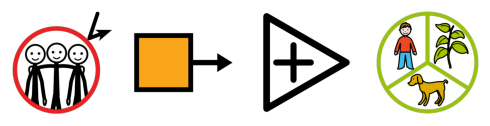

Prediction pict_11691_cuidar pict_3021_a pict_7033_los pict_6901_animales
4
['./imagenes_procesadas/pict_11691.png', './imagenes_procesadas/pict_3021.png', './imagenes_procesadas/pict_7033.png', './imagenes_procesadas/pict_6901.png']
Procesando: ./imagenes_procesadas/pict_11691.png
Procesando: ./imagenes_procesadas/pict_3021.png
Procesando: ./imagenes_procesadas/pict_7033.png
Procesando: ./imagenes_procesadas/pict_6901.png


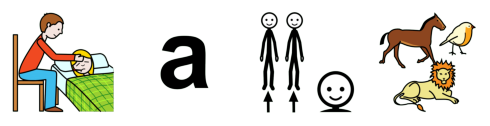

Oracion: pict_5441_yo_quiero pict_9043_cosechar
2
Procesando: ./imagenes_procesadas/pict_5441.png
Procesando: ./imagenes_procesadas/pict_9043.png


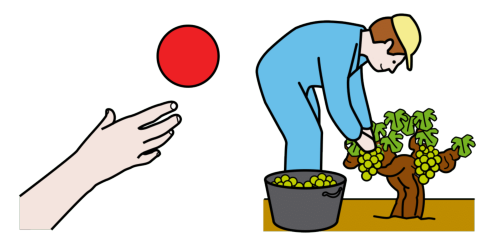

Prediction pict_15485_usar pict_7271_tener pict_11691_cuidar
3
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_11691.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_11691.png


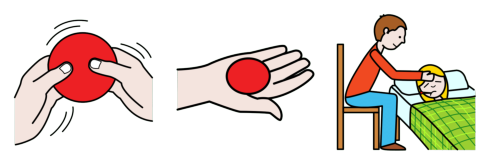

Oracion: pict_22620_qué pict_2474_observar pict_7034_en pict_8476_el pict_8064_cartel
5
Procesando: ./imagenes_procesadas/pict_22620.png
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_7034.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_8064.png


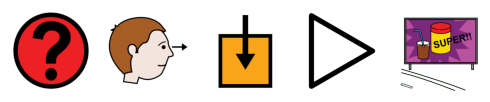

Prediction pict_11351_que pict_8579_explicar pict_7034_en pict_8476_el pict_9819_lugar
5
['./imagenes_procesadas/pict_11351.png', './imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_7034.png', './imagenes_procesadas/pict_8476.png', './imagenes_procesadas/pict_9819.png']
Procesando: ./imagenes_procesadas/pict_11351.png
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_7034.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_9819.png


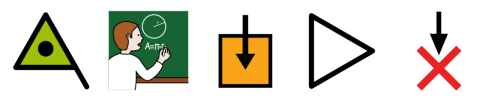

Oracion: pict_2474_ver pict_8476_la pict_26334_polea
3
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_26334.png


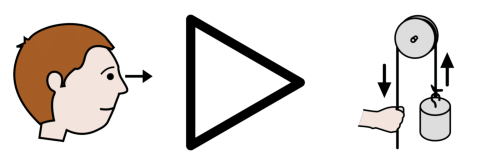

Prediction pict_8579_explicar pict_7029_la pict_22769_artesanía
3
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_22769.png']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_22769.png


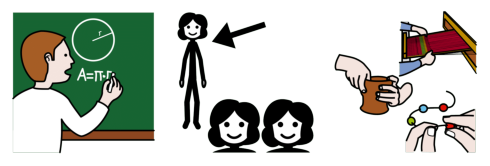

Oracion: pict_22619_cómo pict_7033_ellos pict_8107_escribir pict_8474_un pict_6470_cuento
5
Procesando: ./imagenes_procesadas/pict_22619.png
Procesando: ./imagenes_procesadas/pict_7033.png
Procesando: ./imagenes_procesadas/pict_8107.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_6470.png


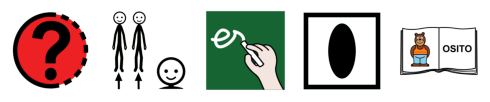

Prediction pict_3415_¿ pict_22619_cómo pict_6481_se pict_2380_escribir pict_8474_un pict_7217_pregunta pict_3418_?
7
['./imagenes_procesadas/pict_3415.png', './imagenes_procesadas/pict_22619.png', './imagenes_procesadas/pict_6481.png', './imagenes_procesadas/pict_2380.png', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_7217.png', './imagenes_procesadas/pict_3418.png']
Procesando: ./imagenes_procesadas/pict_3415.png
Procesando: ./imagenes_procesadas/pict_22619.png
Procesando: ./imagenes_procesadas/pict_6481.png
Procesando: ./imagenes_procesadas/pict_2380.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_7217.png
Procesando: ./imagenes_procesadas/pict_3418.png


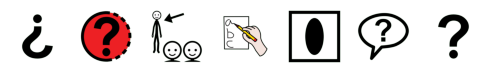

Oracion: pict_37711_resolver pict_8476_el pict_38462_exámen
3
Procesando: ./imagenes_procesadas/pict_37711.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_38462.png


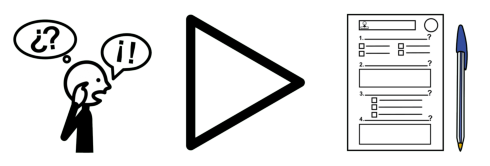

Prediction pict_35653_organizar pict_8476_el pict_9870_exposición
3
['./imagenes_procesadas/pict_35653.png', './imagenes_procesadas/pict_8476.png', './imagenes_procesadas/pict_9870.png']
Procesando: ./imagenes_procesadas/pict_35653.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_9870.png


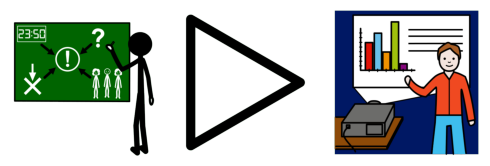

Oracion: pict_2474_observar pict_5556_problema
2
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_5556.png


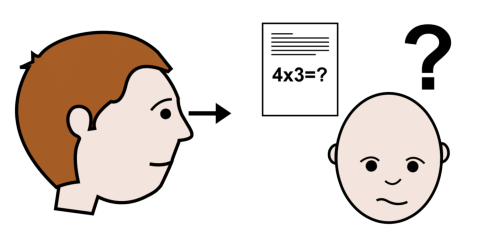

Prediction pict_2474_observar pict_8474_un pict_7217_pregunta
3
['./imagenes_procesadas/pict_2474.png', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_7217.png']
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_7217.png


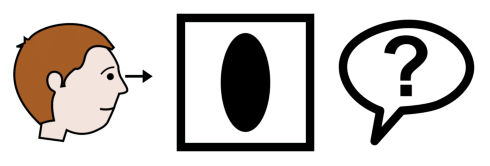

Oracion: pict_34713_cambio_de_turno
1
Procesando: ./imagenes_procesadas/pict_34713.png


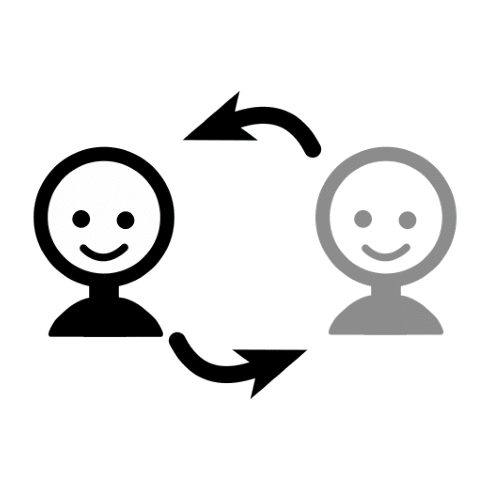

Prediction pict_7217_pregunta pict_7074_de pict_4604_claro
3
['./imagenes_procesadas/pict_7217.png', './imagenes_procesadas/pict_7074.png', './imagenes_procesadas/pict_4604.png']
Procesando: ./imagenes_procesadas/pict_7217.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_4604.png


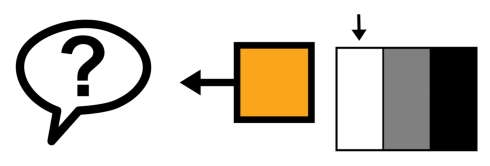

Oracion: pict_22619_cómo pict_37711_resolver
2
Procesando: ./imagenes_procesadas/pict_22619.png
Procesando: ./imagenes_procesadas/pict_37711.png


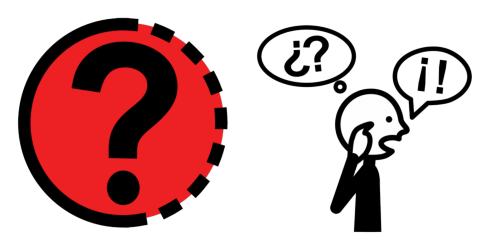

Prediction pict_22619_cómo pict_35653_organizar
2
['./imagenes_procesadas/pict_22619.png', './imagenes_procesadas/pict_35653.png']
Procesando: ./imagenes_procesadas/pict_22619.png
Procesando: ./imagenes_procesadas/pict_35653.png


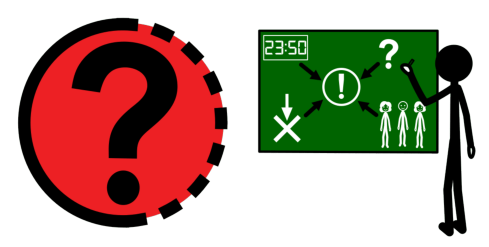

Oracion: pict_25618_cuidado pict_7064_con pict_8476_el pict_36165_ruidoso
4
Procesando: ./imagenes_procesadas/pict_25618.png
Procesando: ./imagenes_procesadas/pict_7064.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_36165.png


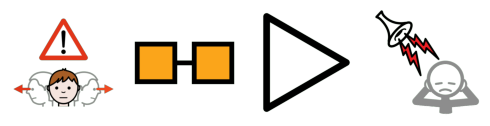

Prediction pict_9819_lugar pict_7064_con pict_8476_el ruido
4
['./imagenes_procesadas/pict_9819.png', './imagenes_procesadas/pict_7064.png', './imagenes_procesadas/pict_8476.png', 'ruido']
Procesando: ./imagenes_procesadas/pict_9819.png
Procesando: ./imagenes_procesadas/pict_7064.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ruido


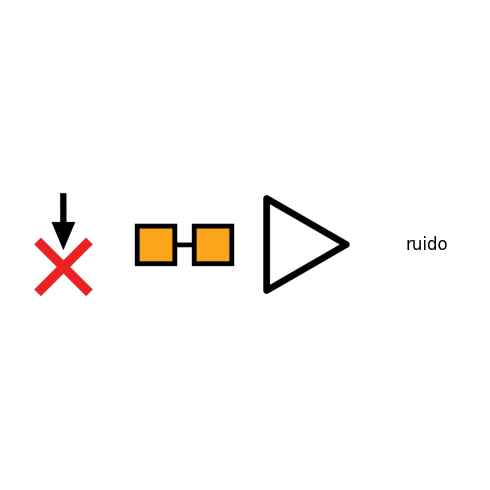

Oracion: pict_26061_energía_eólica
1
Procesando: ./imagenes_procesadas/pict_26061.png


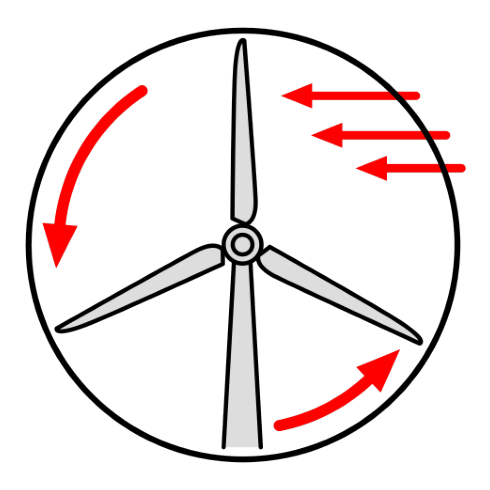

Prediction pict_2248_agua eólica
2
['./imagenes_procesadas/pict_2248.png', 'eólica']
Procesando: ./imagenes_procesadas/pict_2248.png
Procesando: eólica


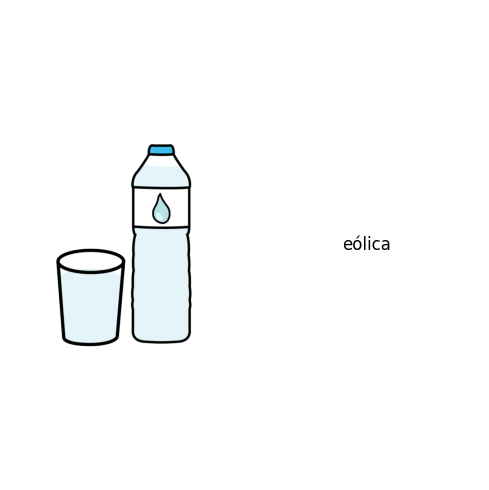

Oracion: pict_7280_traer pict_8474_una pict_36425_papas_asadas
3
Procesando: ./imagenes_procesadas/pict_7280.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_36425.png


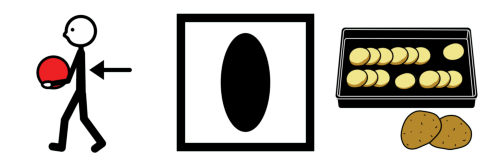

Prediction tráeme pict_8474_una pict_2248_agua asada
4
['tráeme', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_2248.png', 'asada']
Procesando: tráeme
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_2248.png
Procesando: asada


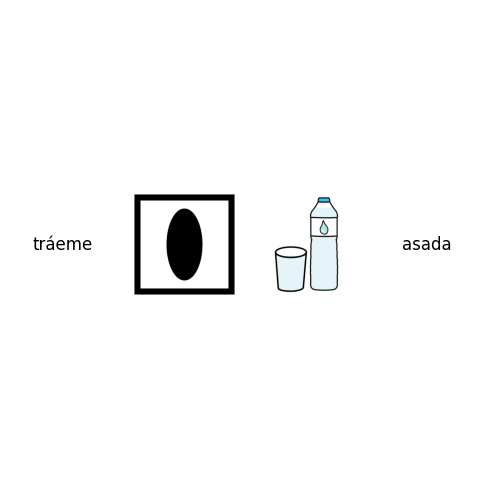

Oracion: pict_7034_en pict_8476_el pict_2683_campo pict_34043_tulipanes pict_7105_flores
5
Procesando: ./imagenes_procesadas/pict_7034.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_2683.png
Procesando: ./imagenes_procesadas/pict_34043.png
Procesando: ./imagenes_procesadas/pict_7105.png


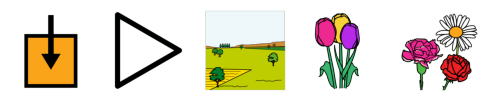

Prediction pict_7034_en pict_8476_el pict_9819_lugar pict_7271_tener tulipanes pict_3047_y 
6
['./imagenes_procesadas/pict_7034.png', './imagenes_procesadas/pict_8476.png', './imagenes_procesadas/pict_9819.png', './imagenes_procesadas/pict_7271.png', 'tulipanes', './imagenes_procesadas/pict_3047.png']
Procesando: ./imagenes_procesadas/pict_7034.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_9819.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: tulipanes
Procesando: ./imagenes_procesadas/pict_3047.png


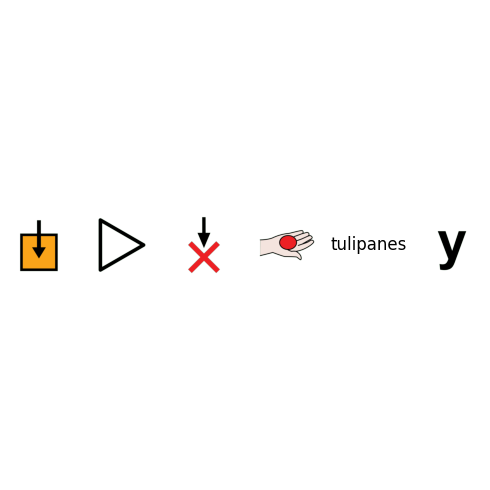

Oracion: pict_21917_gustar
1
Procesando: ./imagenes_procesadas/pict_21917.png


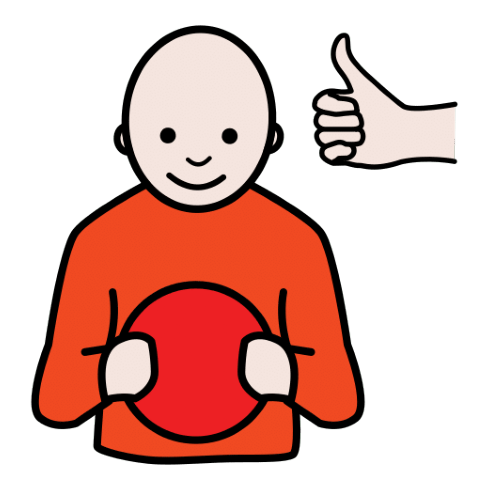

Prediction pict_7271_tener pict_7271_tener
2
['./imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_7271.png']
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_7271.png


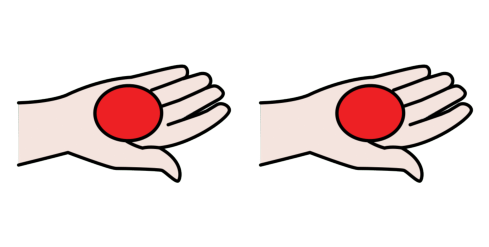

Oracion: pict_6998_corregir pict_22763_poesía pict_38900_compartir pict_8487_amigo
4
Procesando: ./imagenes_procesadas/pict_6998.png
Procesando: ./imagenes_procesadas/pict_22763.png
Procesando: ./imagenes_procesadas/pict_38900.png
Procesando: ./imagenes_procesadas/pict_8487.png


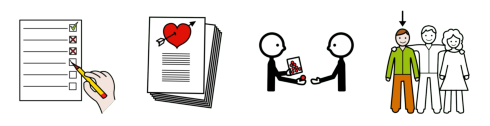

Prediction pict_2474_observar pict_7029_la pict_9870_exposición pict_3047_y pict_11691_cuidar pict_7064_con pict_12281_tu pict_9819_lugar
8
['./imagenes_procesadas/pict_2474.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_9870.png', './imagenes_procesadas/pict_3047.png', './imagenes_procesadas/pict_11691.png', './imagenes_procesadas/pict_7064.png', './imagenes_procesadas/pict_12281.png', './imagenes_procesadas/pict_9819.png']
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_9870.png
Procesando: ./imagenes_procesadas/pict_3047.png
Procesando: ./imagenes_procesadas/pict_11691.png
Procesando: ./imagenes_procesadas/pict_7064.png
Procesando: ./imagenes_procesadas/pict_12281.png
Procesando: ./imagenes_procesadas/pict_9819.png


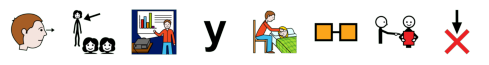

Oracion: pict_8476_el pict_24783_público pict_6564_mirar pict_11319_obra_de_teatro
4
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_24783.png
Procesando: ./imagenes_procesadas/pict_6564.png
Procesando: ./imagenes_procesadas/pict_11319.png


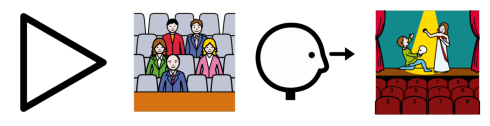

Prediction pict_8476_el pict_2248_agua pict_8579_explicar pict_7029_la pict_9870_exposición pict_7074_de pict_4649_feria
7
['./imagenes_procesadas/pict_8476.png', './imagenes_procesadas/pict_2248.png', './imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_9870.png', './imagenes_procesadas/pict_7074.png', './imagenes_procesadas/pict_4649.png']
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_2248.png
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_9870.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_4649.png


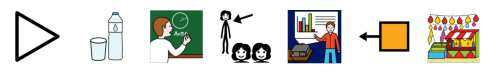

Oracion: pict_31680_leer pict_12266_mis pict_8490_anotar
3
Procesando: ./imagenes_procesadas/pict_31680.png
Procesando: ./imagenes_procesadas/pict_12266.png
Procesando: ./imagenes_procesadas/pict_8490.png


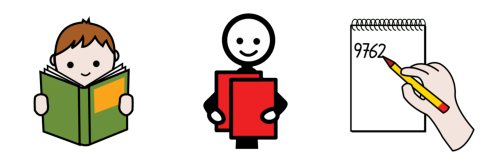

Prediction pict_7141_leer pict_12281_tu anotaciones
3
['./imagenes_procesadas/pict_7141.png', './imagenes_procesadas/pict_12281.png', 'anotaciones']
Procesando: ./imagenes_procesadas/pict_7141.png
Procesando: ./imagenes_procesadas/pict_12281.png
Procesando: anotaciones


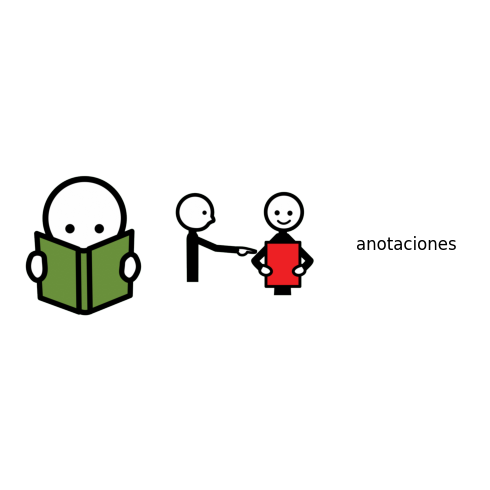

Oracion: pict_32954_vamos_a_la_tienda pict_7041_a pict_8476_la pict_4649_feria
4
Procesando: ./imagenes_procesadas/pict_32954.png
Procesando: ./imagenes_procesadas/pict_7041.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_4649.png


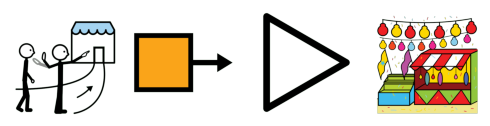

Prediction pict_7271_tener pict_3021_a pict_7029_la pict_9819_lugar
4
['./imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_3021.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_9819.png']
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_3021.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_9819.png


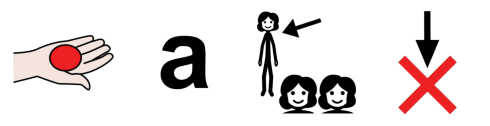

Oracion: pict_2474_observar pict_3151_rosa
2
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_3151.png


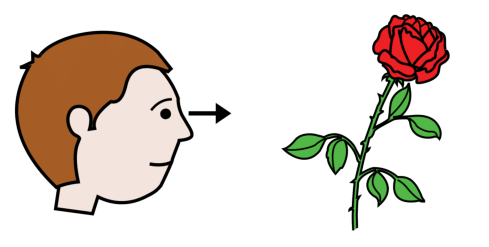

Prediction pict_8579_explicar pict_7029_la pict_2248_agua
3
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_2248.png']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_2248.png


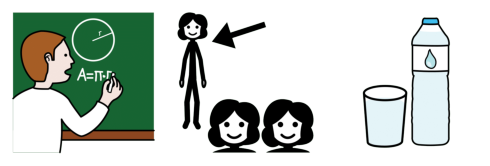

Oracion: pict_35565_sorpresa
1
Procesando: ./imagenes_procesadas/pict_35565.png


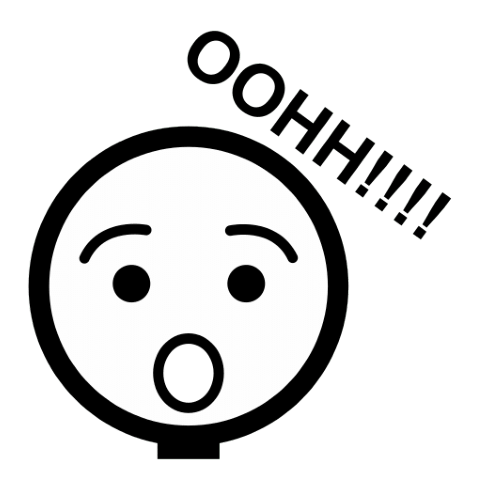

Prediction pict_4604_claro
1
['./imagenes_procesadas/pict_4604.png']
Procesando: ./imagenes_procesadas/pict_4604.png


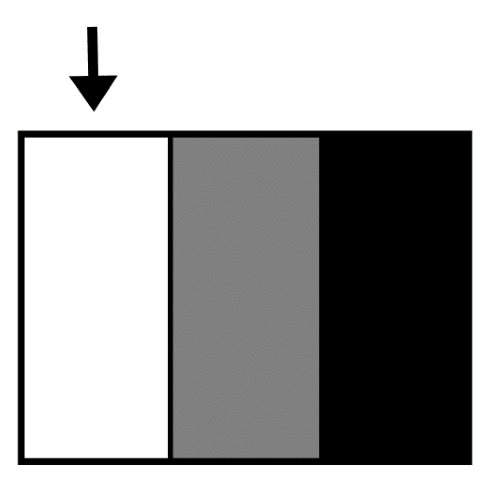

Oracion: pict_11698_elaborar pict_8065_cartel
2
Procesando: ./imagenes_procesadas/pict_11698.png
Procesando: ./imagenes_procesadas/pict_8065.png


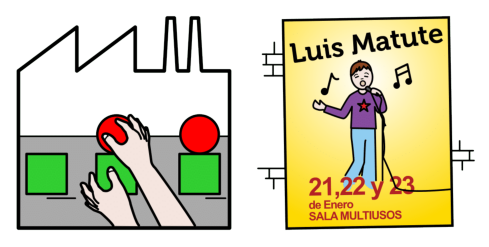

Prediction pict_15485_usar pict_8474_un pict_9819_lugar
3
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_9819.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_9819.png


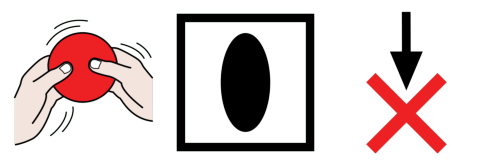

Oracion: pict_36544_hablar pict_7074_de pict_6480_él
3
Procesando: ./imagenes_procesadas/pict_36544.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_6480.png


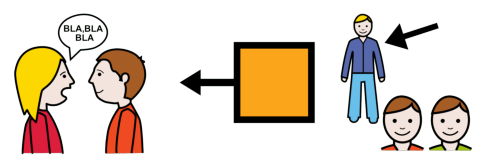

Prediction pict_3345_hablar pict_7074_de pict_5596_todos
3
['./imagenes_procesadas/pict_3345.png', './imagenes_procesadas/pict_7074.png', './imagenes_procesadas/pict_5596.png']
Procesando: ./imagenes_procesadas/pict_3345.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_5596.png


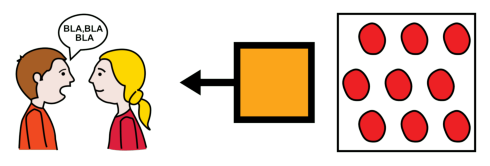

Oracion: pict_6219_subrayar pict_8476_el pict_37340_texto
3
Procesando: ./imagenes_procesadas/pict_6219.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_37340.png


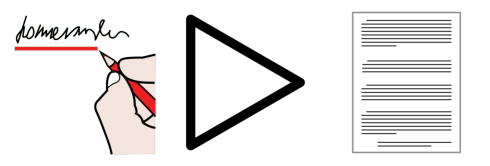

Prediction pict_9870_presentar pict_7034_en pict_8476_el pict_37340_texto
4
['./imagenes_procesadas/pict_9870.png', './imagenes_procesadas/pict_7034.png', './imagenes_procesadas/pict_8476.png', './imagenes_procesadas/pict_37340.png']
Procesando: ./imagenes_procesadas/pict_9870.png
Procesando: ./imagenes_procesadas/pict_7034.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_37340.png


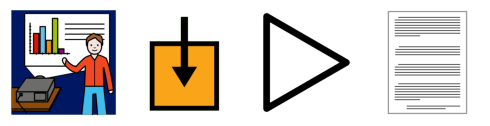

Oracion: pict_7131_hoy pict_36081_todos pict_7041_a pict_9870_exposición
4
Procesando: ./imagenes_procesadas/pict_7131.png
Procesando: ./imagenes_procesadas/pict_36081.png
Procesando: ./imagenes_procesadas/pict_7041.png
Procesando: ./imagenes_procesadas/pict_9870.png


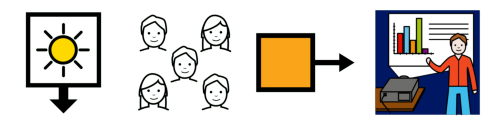

Prediction pict_6901_animales pict_5526_no pict_3021_a pict_8579_explicar
4
['./imagenes_procesadas/pict_6901.png', './imagenes_procesadas/pict_5526.png', './imagenes_procesadas/pict_3021.png', './imagenes_procesadas/pict_8579.png']
Procesando: ./imagenes_procesadas/pict_6901.png
Procesando: ./imagenes_procesadas/pict_5526.png
Procesando: ./imagenes_procesadas/pict_3021.png
Procesando: ./imagenes_procesadas/pict_8579.png


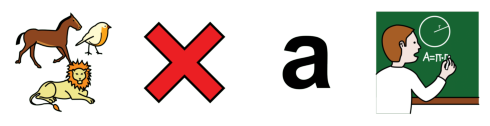

Oracion: pict_2474_mirar pict_8476_la pict_7104_flor
3
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_7104.png


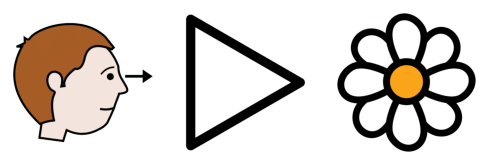

Prediction pict_8579_explicar pict_7029_la pict_2248_agua
3
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_2248.png']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_2248.png


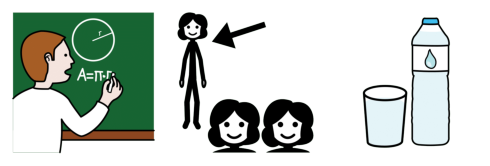

Oracion: pict_6625_te pict_36736_sentir_vergüenza_ajena
2
Procesando: ./imagenes_procesadas/pict_6625.png
Procesando: ./imagenes_procesadas/pict_36736.png


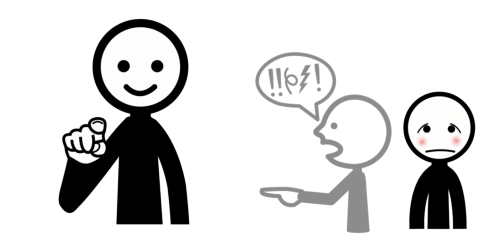

Prediction pict_7271_tener pict_7271_tener pict_4604_claro
3
['./imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_4604.png']
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_4604.png


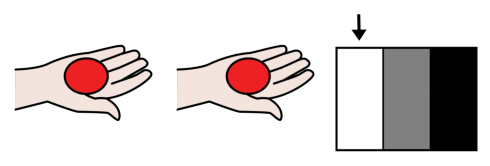

Oracion: pict_22620_qué pict_11697_entender pict_11712_del pict_37340_texto
4
Procesando: ./imagenes_procesadas/pict_22620.png
Procesando: ./imagenes_procesadas/pict_11697.png
Procesando: ./imagenes_procesadas/pict_11712.png
Procesando: ./imagenes_procesadas/pict_37340.png


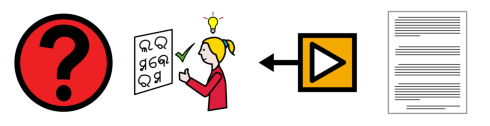

Prediction pict_3415_¿ pict_22624_qué pict_3345_hablar pict_11712_del pict_37340_texto pict_3418_?
6
['./imagenes_procesadas/pict_3415.png', './imagenes_procesadas/pict_22624.png', './imagenes_procesadas/pict_3345.png', './imagenes_procesadas/pict_11712.png', './imagenes_procesadas/pict_37340.png', './imagenes_procesadas/pict_3418.png']
Procesando: ./imagenes_procesadas/pict_3415.png
Procesando: ./imagenes_procesadas/pict_22624.png
Procesando: ./imagenes_procesadas/pict_3345.png
Procesando: ./imagenes_procesadas/pict_11712.png
Procesando: ./imagenes_procesadas/pict_37340.png
Procesando: ./imagenes_procesadas/pict_3418.png


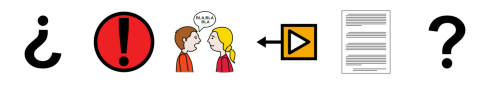

Oracion: pict_11708_acudir pict_11709_al pict_30975_taller_de_cerámica
3
Procesando: ./imagenes_procesadas/pict_11708.png
Procesando: ./imagenes_procesadas/pict_11709.png
Procesando: ./imagenes_procesadas/pict_30975.png


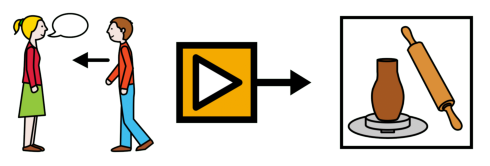

Prediction pict_11691_cuidar pict_3021_a pict_8474_un pict_9870_exposición pict_7074_de pict_9819_lugar
6
['./imagenes_procesadas/pict_11691.png', './imagenes_procesadas/pict_3021.png', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_9870.png', './imagenes_procesadas/pict_7074.png', './imagenes_procesadas/pict_9819.png']
Procesando: ./imagenes_procesadas/pict_11691.png
Procesando: ./imagenes_procesadas/pict_3021.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_9870.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_9819.png


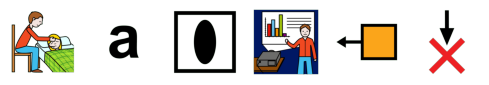

Oracion: pict_2474_observar pict_7199_peces
2
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_7199.png


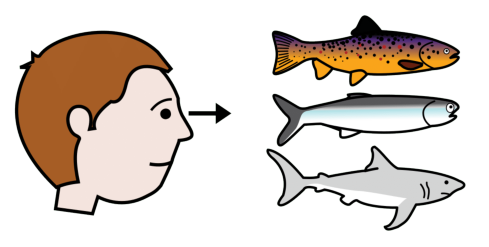

Prediction pict_8579_explicar pict_7033_los pict_2248_agua
3
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_7033.png', './imagenes_procesadas/pict_2248.png']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_7033.png
Procesando: ./imagenes_procesadas/pict_2248.png


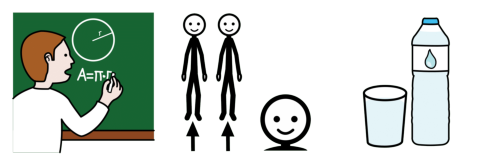

Oracion: pict_31807_yo pict_37938_guardar_ropa
2
Procesando: ./imagenes_procesadas/pict_31807.png
Procesando: ./imagenes_procesadas/pict_37938.png


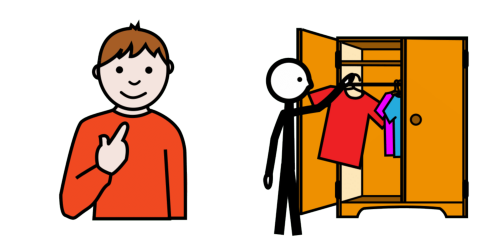

Prediction pict_15485_usar pict_35653_organizar pict_7029_la pict_2248_agua
4
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_35653.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_2248.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_35653.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_2248.png


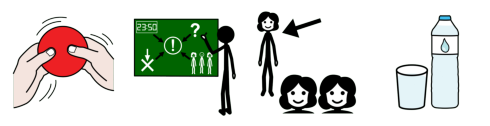

Oracion: pict_2474_observar pict_8476_el pict_3058_árbol_de_navidad
3
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_3058.png


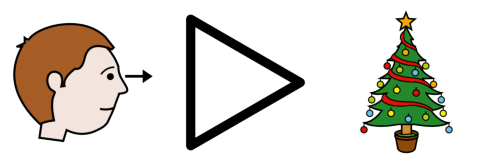

Prediction pict_8579_explicar pict_8476_el arbol pict_2248_agua
4
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_8476.png', 'arbol', './imagenes_procesadas/pict_2248.png']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: arbol
Procesando: ./imagenes_procesadas/pict_2248.png


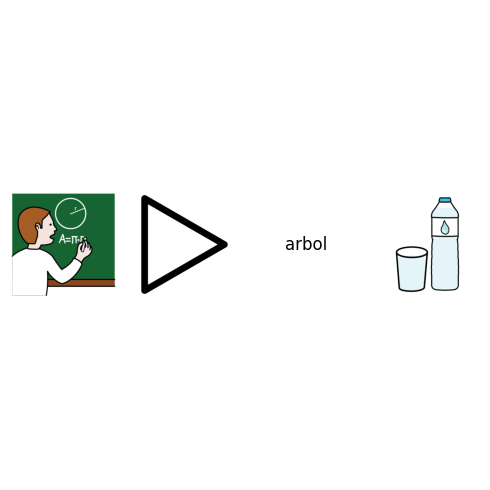

Oracion: pict_5526_no pict_37419_interrumpir_la_conversación
2
Procesando: ./imagenes_procesadas/pict_5526.png
Procesando: ./imagenes_procesadas/pict_37419.png


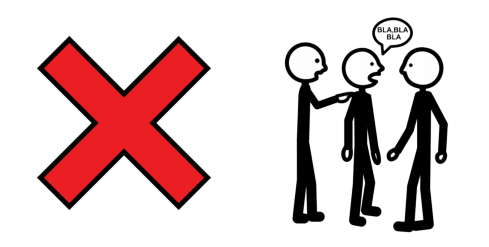

Prediction pict_5526_no interrumpir pict_7029_la pict_9870_exposición
4
['./imagenes_procesadas/pict_5526.png', 'interrumpir', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_9870.png']
Procesando: ./imagenes_procesadas/pict_5526.png
Procesando: interrumpir
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_9870.png


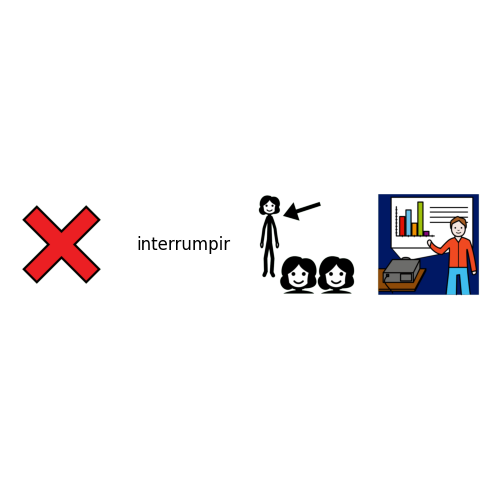

Oracion: pict_27659_cartulinas pict_4658_grande
2
Procesando: ./imagenes_procesadas/pict_27659.png
Procesando: ./imagenes_procesadas/pict_4658.png


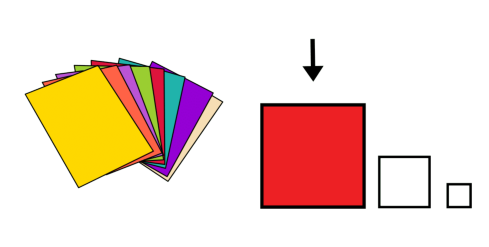

Prediction pict_22769_artesanía pict_11470_importante
2
['./imagenes_procesadas/pict_22769.png', './imagenes_procesadas/pict_11470.png']
Procesando: ./imagenes_procesadas/pict_22769.png
Procesando: ./imagenes_procesadas/pict_11470.png


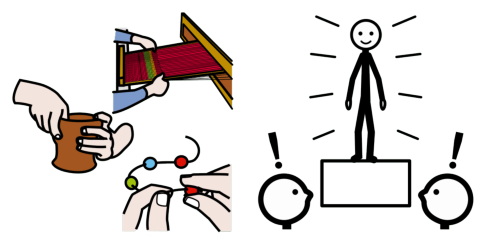

Oracion: pict_6612_señalar pict_8476_el pict_2808_rojo
3
Procesando: ./imagenes_procesadas/pict_6612.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_2808.png


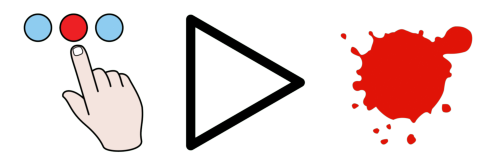

Prediction pict_8579_explicar pict_8476_el pict_9819_lugar pict_4604_claro
4
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_8476.png', './imagenes_procesadas/pict_9819.png', './imagenes_procesadas/pict_4604.png']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_9819.png
Procesando: ./imagenes_procesadas/pict_4604.png


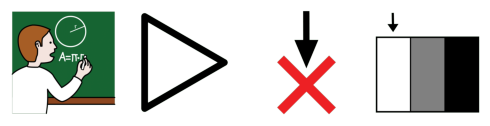

Oracion: pict_13078_completar pict_8476_la pict_27768_frase
3
Procesando: ./imagenes_procesadas/pict_13078.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_27768.png


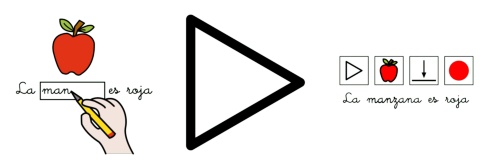

Prediction pict_35653_organizar pict_7029_la pict_7217_pregunta
3
['./imagenes_procesadas/pict_35653.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_7217.png']
Procesando: ./imagenes_procesadas/pict_35653.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_7217.png


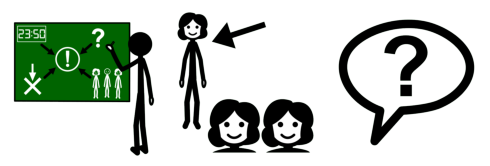

Oracion: pict_27331_seguir pict_6495_estudiar
2
Procesando: ./imagenes_procesadas/pict_27331.png
Procesando: ./imagenes_procesadas/pict_6495.png


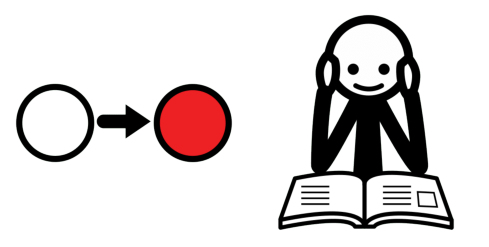

Prediction pict_3415_¿ pict_11691_cuidar pict_3345_hablar pict_3418_?
4
['./imagenes_procesadas/pict_3415.png', './imagenes_procesadas/pict_11691.png', './imagenes_procesadas/pict_3345.png', './imagenes_procesadas/pict_3418.png']
Procesando: ./imagenes_procesadas/pict_3415.png
Procesando: ./imagenes_procesadas/pict_11691.png
Procesando: ./imagenes_procesadas/pict_3345.png
Procesando: ./imagenes_procesadas/pict_3418.png


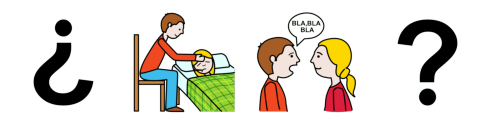

Oracion: pict_6009_hola pict_5441_quiero pict_8986_hacer_la_compra pict_7291_uno pict_9086_olla
5
Procesando: ./imagenes_procesadas/pict_6009.png
Procesando: ./imagenes_procesadas/pict_5441.png
Procesando: ./imagenes_procesadas/pict_8986.png
Procesando: ./imagenes_procesadas/pict_7291.png
Procesando: ./imagenes_procesadas/pict_9086.png


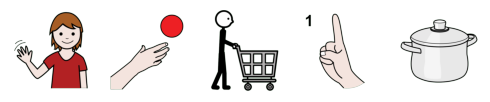

Prediction pict_11238_dibujo pict_5526_no pict_7271_tener pict_35653_organizar pict_11709_al olla
6
['./imagenes_procesadas/pict_11238.png', './imagenes_procesadas/pict_5526.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_35653.png', './imagenes_procesadas/pict_11709.png', 'olla']
Procesando: ./imagenes_procesadas/pict_11238.png
Procesando: ./imagenes_procesadas/pict_5526.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_35653.png
Procesando: ./imagenes_procesadas/pict_11709.png
Procesando: olla


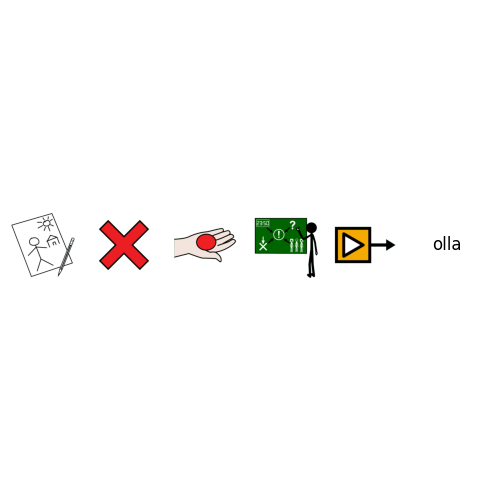

Oracion: pict_22619_cómo pict_7245_siembra
2
Procesando: ./imagenes_procesadas/pict_22619.png
Procesando: ./imagenes_procesadas/pict_7245.png


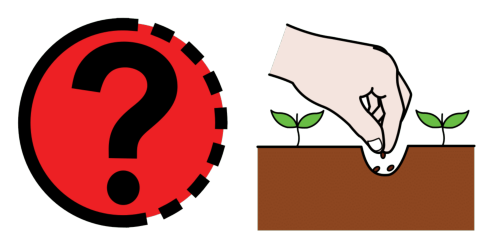

Prediction pict_3415_¿ pict_22619_cómo pict_6481_se pict_11691_cuidar pict_3418_?
5
['./imagenes_procesadas/pict_3415.png', './imagenes_procesadas/pict_22619.png', './imagenes_procesadas/pict_6481.png', './imagenes_procesadas/pict_11691.png', './imagenes_procesadas/pict_3418.png']
Procesando: ./imagenes_procesadas/pict_3415.png
Procesando: ./imagenes_procesadas/pict_22619.png
Procesando: ./imagenes_procesadas/pict_6481.png
Procesando: ./imagenes_procesadas/pict_11691.png
Procesando: ./imagenes_procesadas/pict_3418.png


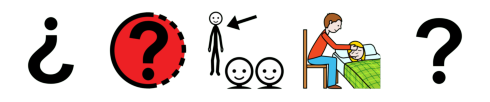

Oracion: pict_2381_escuchar
1
Procesando: ./imagenes_procesadas/pict_2381.png


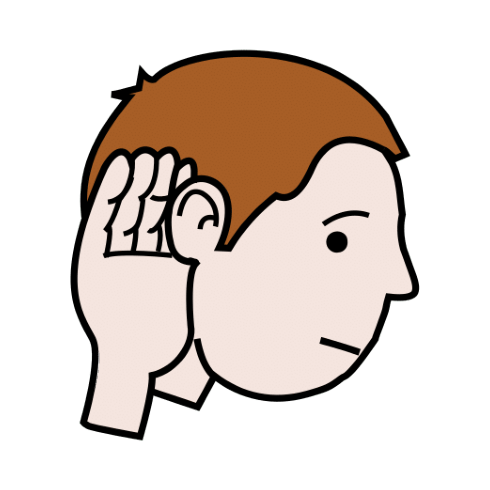

Prediction pict_3345_hablar
1
['./imagenes_procesadas/pict_3345.png']
Procesando: ./imagenes_procesadas/pict_3345.png


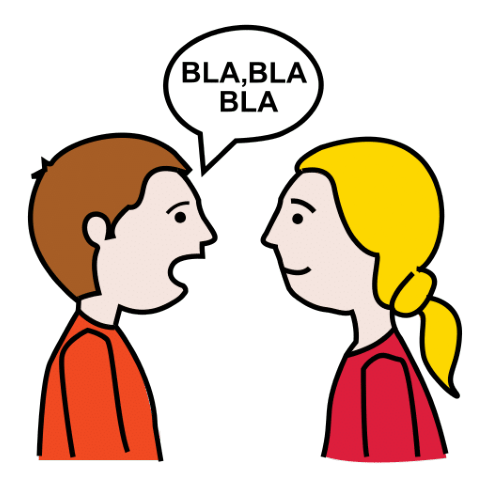

Oracion: pict_11698_elaborar pict_8474_un pict_8065_cartel
3
Procesando: ./imagenes_procesadas/pict_11698.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_8065.png


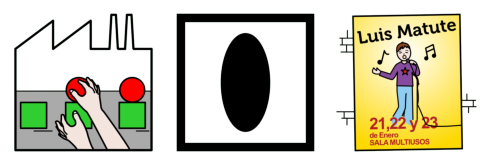

Prediction pict_15485_usar pict_8474_un pict_9819_lugar
3
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_9819.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_9819.png


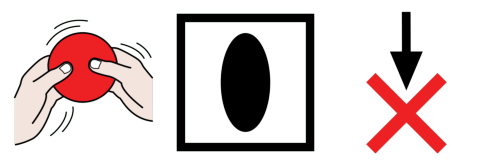

Oracion: pict_6009_hola pict_5441_quiero pict_2806_salir pict_11709_al pict_33064_recreo
5
Procesando: ./imagenes_procesadas/pict_6009.png
Procesando: ./imagenes_procesadas/pict_5441.png
Procesando: ./imagenes_procesadas/pict_2806.png
Procesando: ./imagenes_procesadas/pict_11709.png
Procesando: ./imagenes_procesadas/pict_33064.png


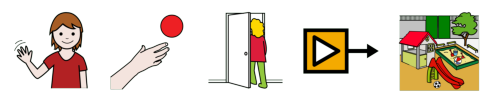

Prediction pict_11238_dibujo pict_5526_no pict_7271_tener pict_11691_cuidar pict_3021_a pict_22769_artesanía
6
['./imagenes_procesadas/pict_11238.png', './imagenes_procesadas/pict_5526.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_11691.png', './imagenes_procesadas/pict_3021.png', './imagenes_procesadas/pict_22769.png']
Procesando: ./imagenes_procesadas/pict_11238.png
Procesando: ./imagenes_procesadas/pict_5526.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_11691.png
Procesando: ./imagenes_procesadas/pict_3021.png
Procesando: ./imagenes_procesadas/pict_22769.png


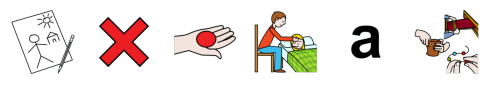

Oracion: pict_8579_explicar pict_8476_el pict_23404_curso
3
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_23404.png


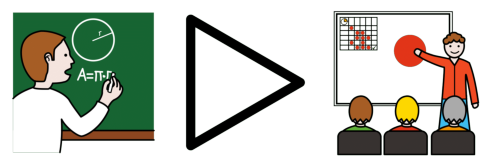

Prediction explicación pict_11712_del pict_9819_lugar
3
['explicación', './imagenes_procesadas/pict_11712.png', './imagenes_procesadas/pict_9819.png']
Procesando: explicación
Procesando: ./imagenes_procesadas/pict_11712.png
Procesando: ./imagenes_procesadas/pict_9819.png


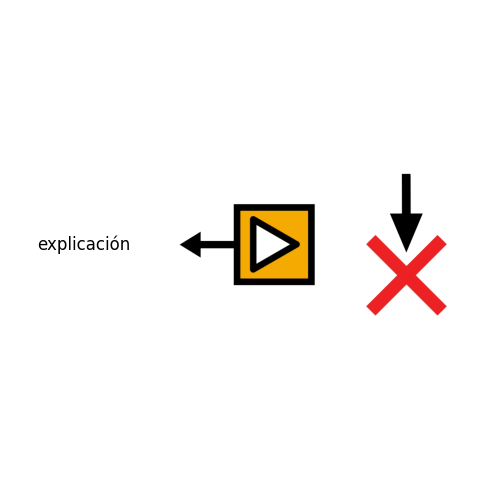

Oracion: pict_2474_observar pict_8476_el pict_38090_autobús
3
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_38090.png


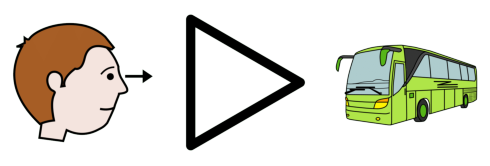

Prediction pict_8579_explicar pict_8476_el autobus
3
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_8476.png', 'autobus']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: autobus


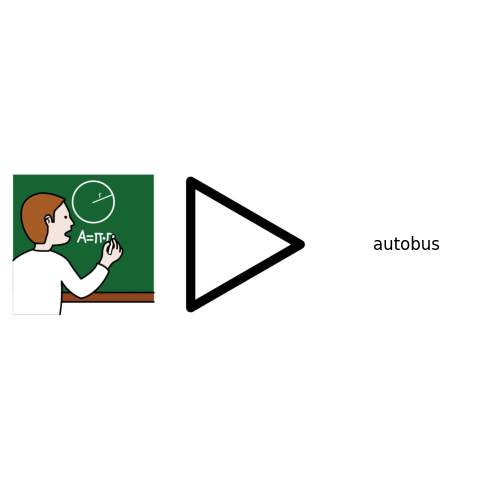

Oracion: pict_37201_alimento_saludable
1
Procesando: ./imagenes_procesadas/pict_37201.png


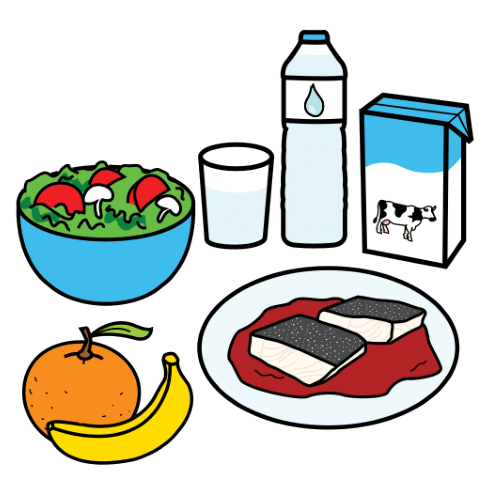

Prediction pict_2248_agua saludable
2
['./imagenes_procesadas/pict_2248.png', 'saludable']
Procesando: ./imagenes_procesadas/pict_2248.png
Procesando: saludable


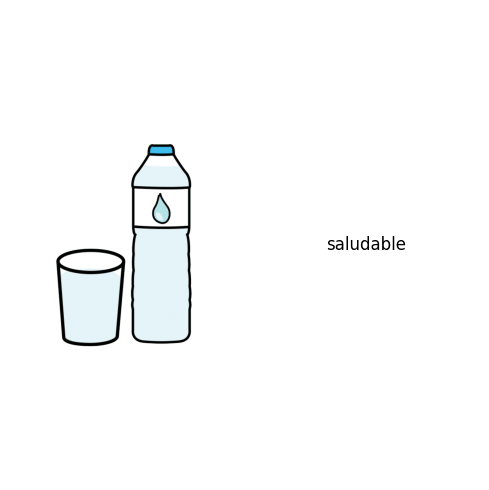

Oracion: pict_7221_puedo? pict_2380_escribir
2
Procesando: ./imagenes_procesadas/pict_7221.png
Procesando: ./imagenes_procesadas/pict_2380.png


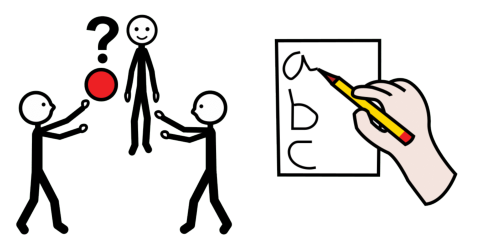

Prediction pict_3415_¿ pict_22619_cómo pict_2380_escribir pict_3418_?
4
['./imagenes_procesadas/pict_3415.png', './imagenes_procesadas/pict_22619.png', './imagenes_procesadas/pict_2380.png', './imagenes_procesadas/pict_3418.png']
Procesando: ./imagenes_procesadas/pict_3415.png
Procesando: ./imagenes_procesadas/pict_22619.png
Procesando: ./imagenes_procesadas/pict_2380.png
Procesando: ./imagenes_procesadas/pict_3418.png


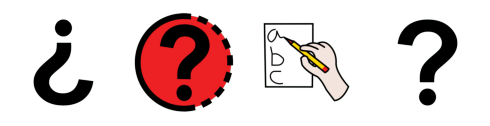

Oracion: pict_31680_leer pict_37340_texto
2
Procesando: ./imagenes_procesadas/pict_31680.png
Procesando: ./imagenes_procesadas/pict_37340.png


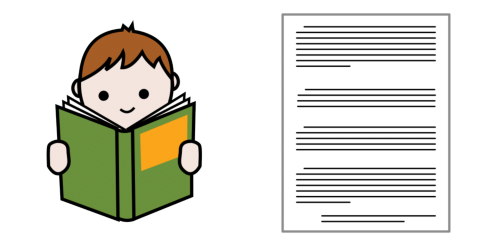

Prediction pict_7141_leer pict_8476_el pict_37340_texto
3
['./imagenes_procesadas/pict_7141.png', './imagenes_procesadas/pict_8476.png', './imagenes_procesadas/pict_37340.png']
Procesando: ./imagenes_procesadas/pict_7141.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_37340.png


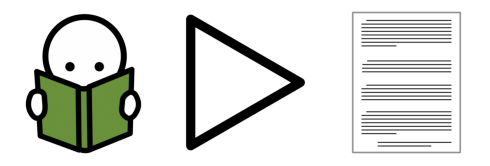

Oracion: pict_2474_observar pict_8476_el pict_32304_problema
3
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_32304.png


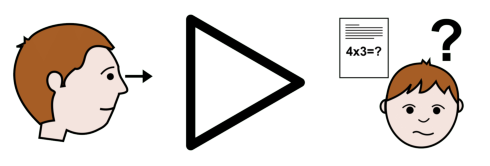

Prediction pict_8579_explicar pict_8476_el pict_7217_pregunta
3
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_8476.png', './imagenes_procesadas/pict_7217.png']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_7217.png


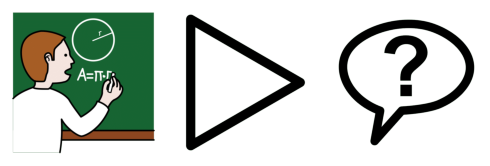

Oracion: pict_5526_no pict_31125_gritar
2
Procesando: ./imagenes_procesadas/pict_5526.png
Procesando: ./imagenes_procesadas/pict_31125.png


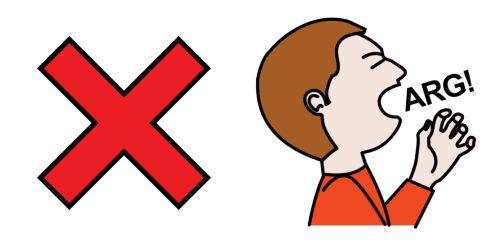

Prediction pict_5526_no pict_11691_cuidar
2
['./imagenes_procesadas/pict_5526.png', './imagenes_procesadas/pict_11691.png']
Procesando: ./imagenes_procesadas/pict_5526.png
Procesando: ./imagenes_procesadas/pict_11691.png


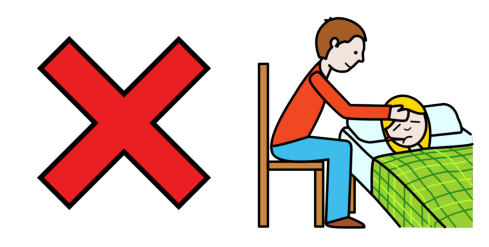

Oracion: pict_5441_pedir pict_8487_amigo pict_12278_sus pict_8490_anotar
4
Procesando: ./imagenes_procesadas/pict_5441.png
Procesando: ./imagenes_procesadas/pict_8487.png
Procesando: ./imagenes_procesadas/pict_12278.png
Procesando: ./imagenes_procesadas/pict_8490.png


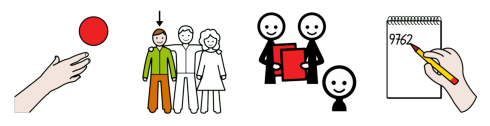

Prediction pict_11691_cuidar pict_3021_a pict_8474_un pict_4604_claro pict_7031_las anotaciones
6
['./imagenes_procesadas/pict_11691.png', './imagenes_procesadas/pict_3021.png', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_4604.png', './imagenes_procesadas/pict_7031.png', 'anotaciones']
Procesando: ./imagenes_procesadas/pict_11691.png
Procesando: ./imagenes_procesadas/pict_3021.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_4604.png
Procesando: ./imagenes_procesadas/pict_7031.png
Procesando: anotaciones


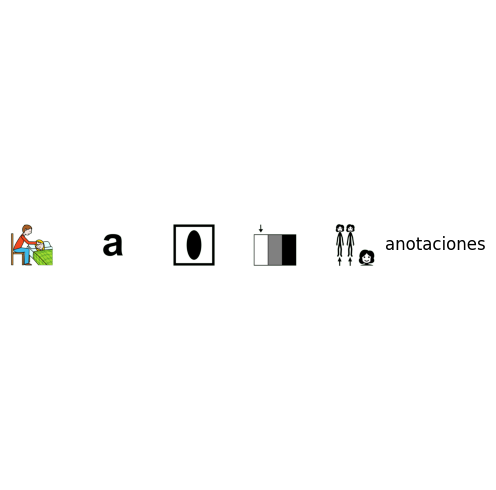

Oracion: pict_11601_¿cuál_es_tu_trabajo?
1
Procesando: ./imagenes_procesadas/pict_11601.png


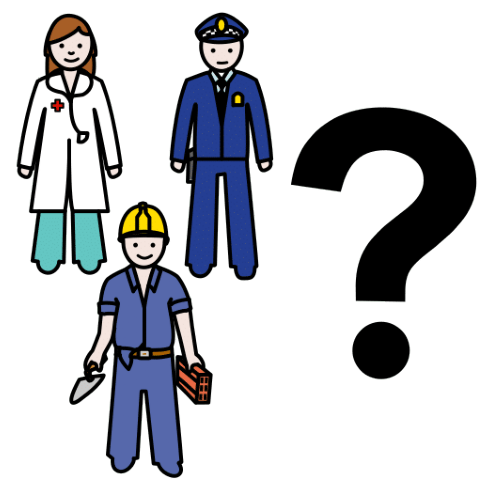

Prediction pict_22619_cómo pict_5581_ser pict_12281_tu pict_37340_texto
4
['./imagenes_procesadas/pict_22619.png', './imagenes_procesadas/pict_5581.png', './imagenes_procesadas/pict_12281.png', './imagenes_procesadas/pict_37340.png']
Procesando: ./imagenes_procesadas/pict_22619.png
Procesando: ./imagenes_procesadas/pict_5581.png
Procesando: ./imagenes_procesadas/pict_12281.png
Procesando: ./imagenes_procesadas/pict_37340.png


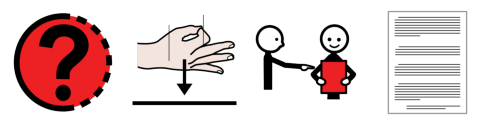

Oracion: pict_2387_estudiar pict_8476_la pict_32634_historia pict_11712_del pict_8185_Perú
5
Procesando: ./imagenes_procesadas/pict_2387.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_32634.png
Procesando: ./imagenes_procesadas/pict_11712.png
Procesando: ./imagenes_procesadas/pict_8185.png


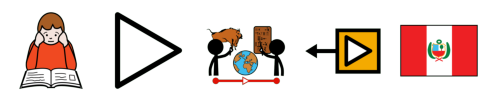

Prediction pict_35653_organizar pict_7029_la pict_9897_información pict_11712_del pict_9819_lugar
5
['./imagenes_procesadas/pict_35653.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_9897.png', './imagenes_procesadas/pict_11712.png', './imagenes_procesadas/pict_9819.png']
Procesando: ./imagenes_procesadas/pict_35653.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_9897.png
Procesando: ./imagenes_procesadas/pict_11712.png
Procesando: ./imagenes_procesadas/pict_9819.png


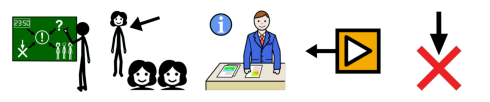

Oracion: pict_11199_cambiar_de_tema pict_7074_de pict_9870_exposición
3
Procesando: ./imagenes_procesadas/pict_11199.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_9870.png


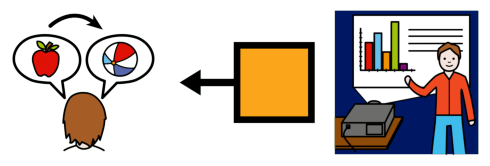

Prediction pict_8029_aprender pict_8476_el tema pict_7074_de pict_37340_texto
5
['./imagenes_procesadas/pict_8029.png', './imagenes_procesadas/pict_8476.png', 'tema', './imagenes_procesadas/pict_7074.png', './imagenes_procesadas/pict_37340.png']
Procesando: ./imagenes_procesadas/pict_8029.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: tema
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_37340.png


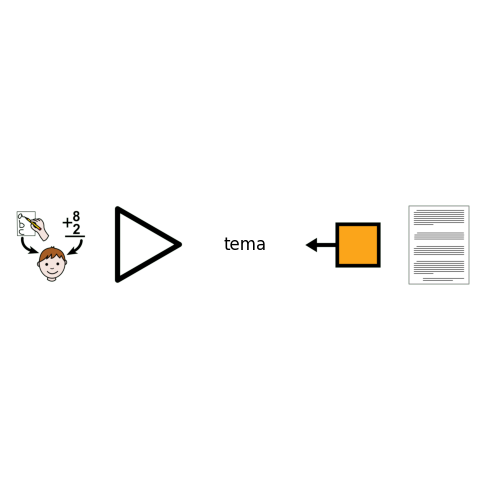

Oracion: pict_8476_el pict_30194_sentidos pict_7074_de pict_2474_ver
4
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_30194.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_2474.png


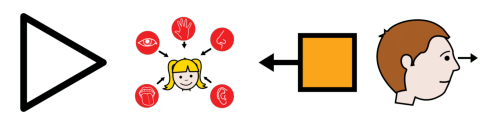

Prediction pict_8476_el sentido pict_7074_de pict_3345_hablar
4
['./imagenes_procesadas/pict_8476.png', 'sentido', './imagenes_procesadas/pict_7074.png', './imagenes_procesadas/pict_3345.png']
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: sentido
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_3345.png


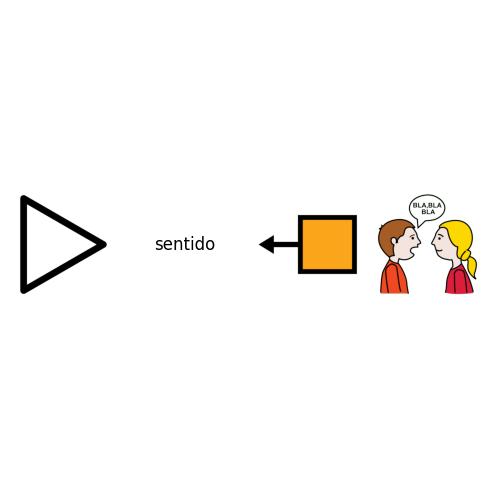

Oracion: pict_36441_reutilizar pict_8474_un pict_11318_objeto
3
Procesando: ./imagenes_procesadas/pict_36441.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_11318.png


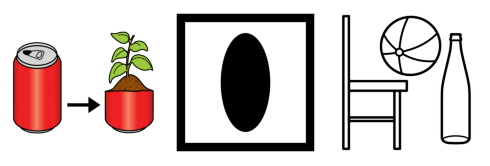

Prediction pict_7141_leer pict_8474_un pict_6901_animales
3
['./imagenes_procesadas/pict_7141.png', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_6901.png']
Procesando: ./imagenes_procesadas/pict_7141.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_6901.png


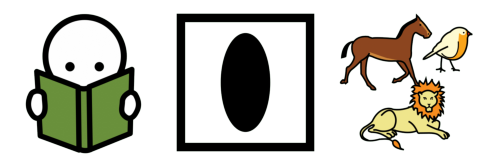

Oracion: pict_31807_yo pict_9034_saber pict_8477_las pict_36347_tareas_domésticas
4
Procesando: ./imagenes_procesadas/pict_31807.png
Procesando: ./imagenes_procesadas/pict_9034.png
Procesando: ./imagenes_procesadas/pict_8477.png
Procesando: ./imagenes_procesadas/pict_36347.png


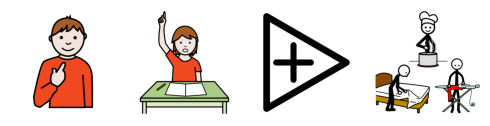

Prediction pict_6483_elegir pict_11749_hacer pict_7031_las tareas domesticas
5
['./imagenes_procesadas/pict_6483.png', './imagenes_procesadas/pict_11749.png', './imagenes_procesadas/pict_7031.png', 'tareas', 'domesticas']
Procesando: ./imagenes_procesadas/pict_6483.png
Procesando: ./imagenes_procesadas/pict_11749.png
Procesando: ./imagenes_procesadas/pict_7031.png
Procesando: tareas
Procesando: domesticas


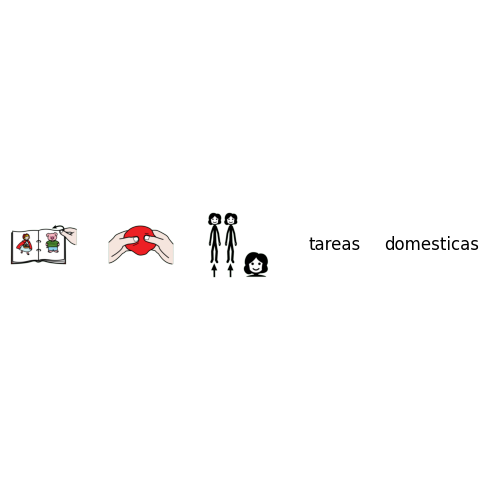

Oracion: pict_5584_sí pict_2458_mamá
2
Procesando: ./imagenes_procesadas/pict_5584.png
Procesando: ./imagenes_procesadas/pict_2458.png


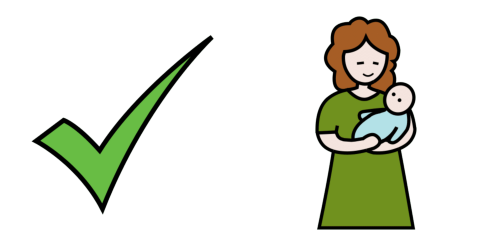

Prediction pict_5526_no pict_3189_, pict_6901_animales
3
['./imagenes_procesadas/pict_5526.png', './imagenes_procesadas/pict_3189.png', './imagenes_procesadas/pict_6901.png']
Procesando: ./imagenes_procesadas/pict_5526.png
Procesando: ./imagenes_procesadas/pict_3189.png
Procesando: ./imagenes_procesadas/pict_6901.png


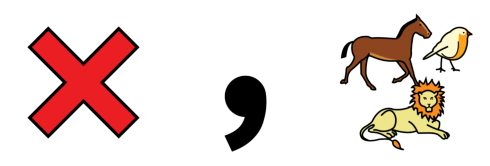

Oracion: pict_31807_yo pict_11176_alimentar pict_7041_a pict_12264_mi pict_2489_oveja
5
Procesando: ./imagenes_procesadas/pict_31807.png
Procesando: ./imagenes_procesadas/pict_11176.png
Procesando: ./imagenes_procesadas/pict_7041.png
Procesando: ./imagenes_procesadas/pict_12264.png
Procesando: ./imagenes_procesadas/pict_2489.png


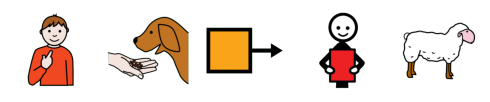

Prediction pict_15485_usar pict_2248_agua pict_3021_a pict_12281_tu pict_22769_artesanía
5
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_2248.png', './imagenes_procesadas/pict_3021.png', './imagenes_procesadas/pict_12281.png', './imagenes_procesadas/pict_22769.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_2248.png
Procesando: ./imagenes_procesadas/pict_3021.png
Procesando: ./imagenes_procesadas/pict_12281.png
Procesando: ./imagenes_procesadas/pict_22769.png


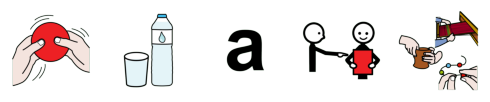

Oracion: pict_8477_los pict_6975_niños pict_9692_expresar pict_36720_respetar
4
Procesando: ./imagenes_procesadas/pict_8477.png
Procesando: ./imagenes_procesadas/pict_6975.png
Procesando: ./imagenes_procesadas/pict_9692.png
Procesando: ./imagenes_procesadas/pict_36720.png


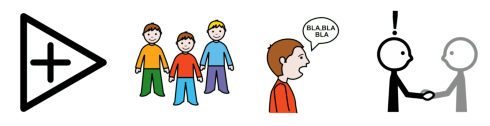

Prediction pict_7033_los pict_9819_lugar deben expresarse pict_7074_de forma respetuosa
7
['./imagenes_procesadas/pict_7033.png', './imagenes_procesadas/pict_9819.png', 'deben', 'expresarse', './imagenes_procesadas/pict_7074.png', 'forma', 'respetuosa']
Procesando: ./imagenes_procesadas/pict_7033.png
Procesando: ./imagenes_procesadas/pict_9819.png
Procesando: deben
Procesando: expresarse
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: forma
Procesando: respetuosa


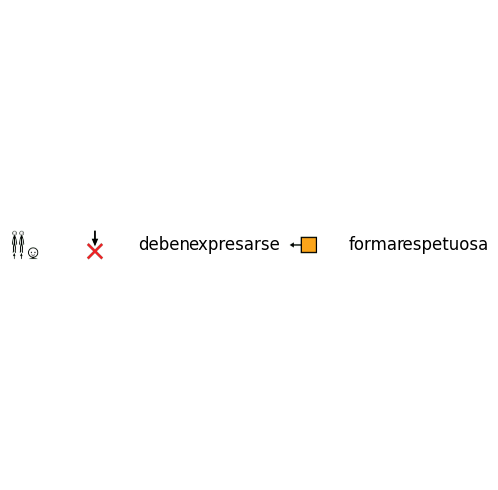

Oracion: pict_29594_Bolivia
1
Procesando: ./imagenes_procesadas/pict_29594.png


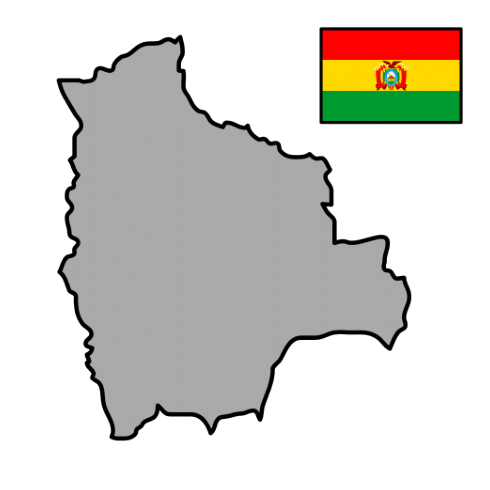

Prediction bolivia
1
['bolivia']
Procesando: bolivia


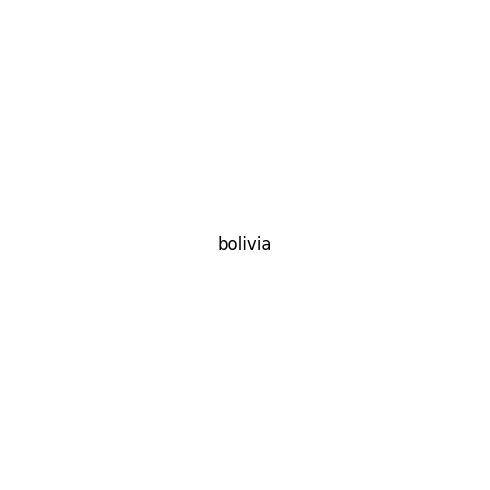

Oracion: pict_22007_obedecer pict_7041_a pict_8476_la pict_2458_mamá
4
Procesando: ./imagenes_procesadas/pict_22007.png
Procesando: ./imagenes_procesadas/pict_7041.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_2458.png


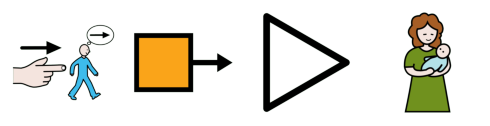

Prediction pict_9030_responder pict_3021_a pict_7029_la pict_11572_plantas
4
['./imagenes_procesadas/pict_9030.png', './imagenes_procesadas/pict_3021.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_11572.png']
Procesando: ./imagenes_procesadas/pict_9030.png
Procesando: ./imagenes_procesadas/pict_3021.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_11572.png


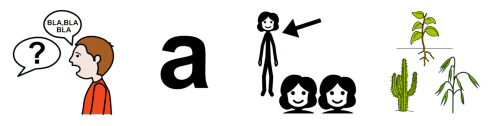

Oracion: pict_8107_escribir pict_8474_una pict_2688_carta
3
Procesando: ./imagenes_procesadas/pict_8107.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_2688.png


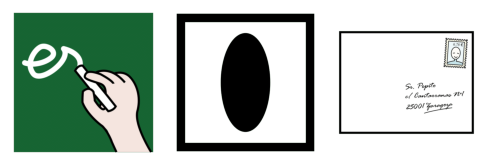

Prediction escriban pict_8474_una pict_9897_información
3
['escriban', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_9897.png']
Procesando: escriban
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_9897.png


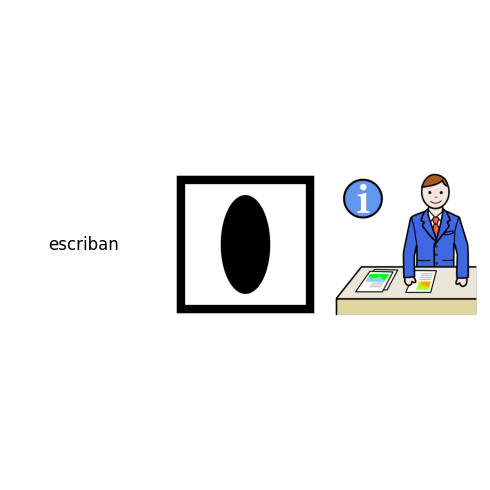

Oracion: pict_32560_danza_clásica
1
Procesando: ./imagenes_procesadas/pict_32560.png


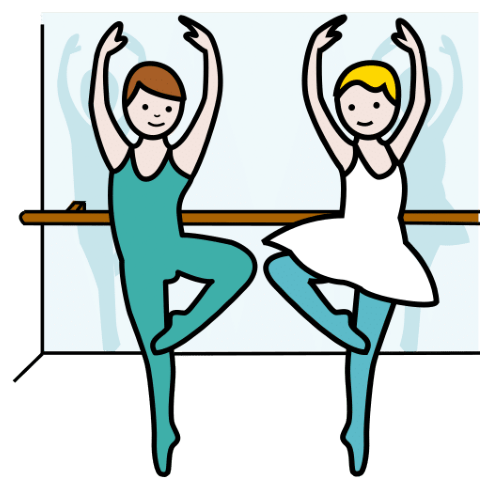

Prediction pict_4649_feria clásica
2
['./imagenes_procesadas/pict_4649.png', 'clásica']
Procesando: ./imagenes_procesadas/pict_4649.png
Procesando: clásica


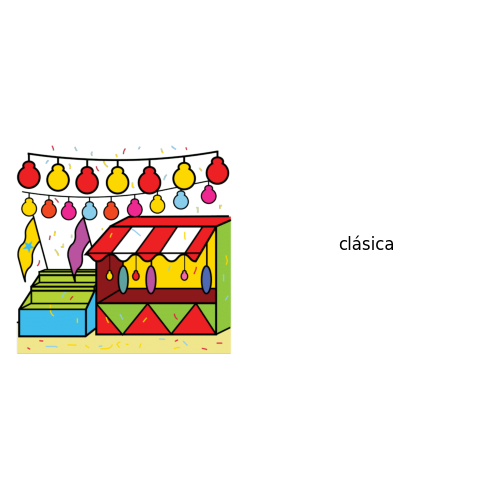

Oracion: pict_24769_trabajos_manuales
1
Procesando: ./imagenes_procesadas/pict_24769.png


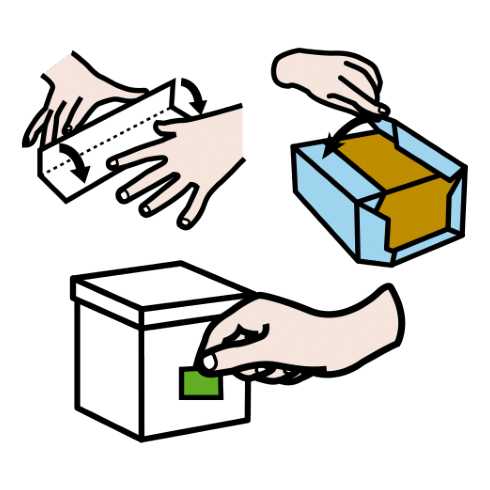

Prediction pict_37340_texto manuales
2
['./imagenes_procesadas/pict_37340.png', 'manuales']
Procesando: ./imagenes_procesadas/pict_37340.png
Procesando: manuales


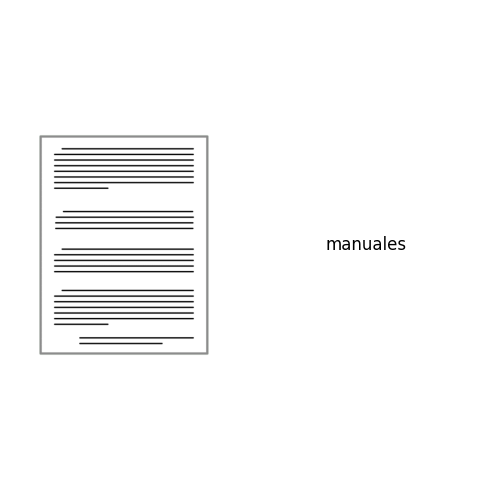

Oracion: pict_32872_¿dónde_está? pict_7033_ellos
2
Procesando: ./imagenes_procesadas/pict_32872.png
Procesando: ./imagenes_procesadas/pict_7033.png


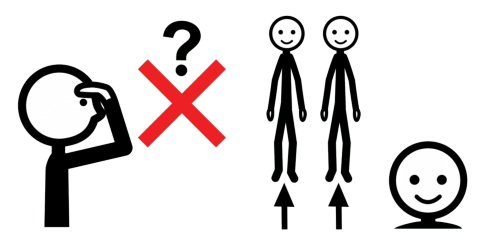

Prediction pict_11351_que pict_5581_ser pict_5526_no pict_5526_no
4
['./imagenes_procesadas/pict_11351.png', './imagenes_procesadas/pict_5581.png', './imagenes_procesadas/pict_5526.png', './imagenes_procesadas/pict_5526.png']
Procesando: ./imagenes_procesadas/pict_11351.png
Procesando: ./imagenes_procesadas/pict_5581.png
Procesando: ./imagenes_procesadas/pict_5526.png
Procesando: ./imagenes_procesadas/pict_5526.png


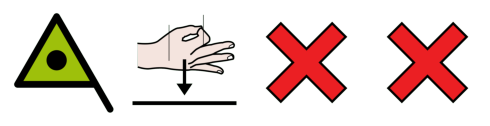

Oracion: pict_34633_extinción pict_7074_de pict_35853_animales_marinos
3
Procesando: ./imagenes_procesadas/pict_34633.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_35853.png


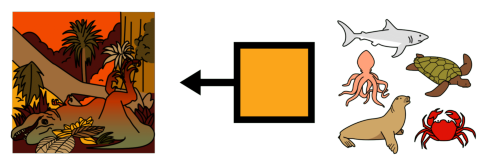

Prediction extincion pict_7074_de pict_2248_agua pict_11470_importante
4
['extincion', './imagenes_procesadas/pict_7074.png', './imagenes_procesadas/pict_2248.png', './imagenes_procesadas/pict_11470.png']
Procesando: extincion
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_2248.png
Procesando: ./imagenes_procesadas/pict_11470.png


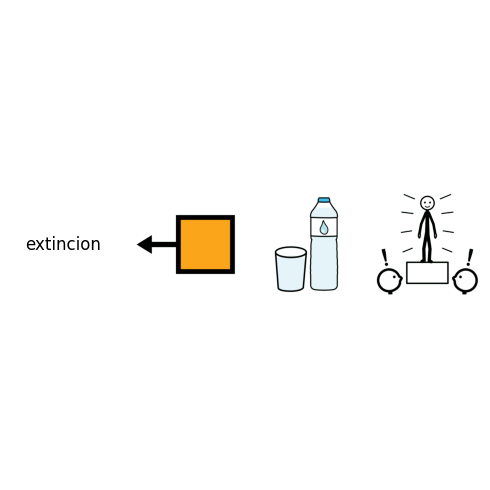

Oracion: pict_2511_pegar pict_32518_dibujo pict_7034_en pict_8476_la pict_2526_pizarra
5
Procesando: ./imagenes_procesadas/pict_2511.png
Procesando: ./imagenes_procesadas/pict_32518.png
Procesando: ./imagenes_procesadas/pict_7034.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_2526.png


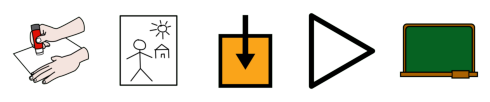

Prediction pict_35653_organizar pict_8476_el pict_37340_texto pict_7034_en pict_7029_la pict_22769_artesanía
6
['./imagenes_procesadas/pict_35653.png', './imagenes_procesadas/pict_8476.png', './imagenes_procesadas/pict_37340.png', './imagenes_procesadas/pict_7034.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_22769.png']
Procesando: ./imagenes_procesadas/pict_35653.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_37340.png
Procesando: ./imagenes_procesadas/pict_7034.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_22769.png


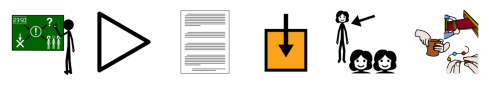

Oracion: pict_32665_estudiante pict_7074_de pict_26411_salida
3
Procesando: ./imagenes_procesadas/pict_32665.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_26411.png


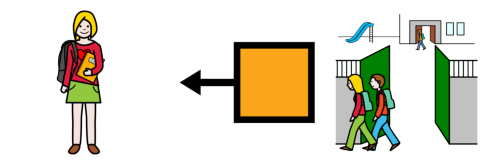

Prediction pict_9819_lugar pict_7074_de pict_35477_paso
3
['./imagenes_procesadas/pict_9819.png', './imagenes_procesadas/pict_7074.png', './imagenes_procesadas/pict_35477.png']
Procesando: ./imagenes_procesadas/pict_9819.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_35477.png


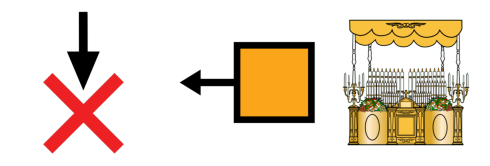

Oracion: pict_2474_observar pict_12264_mi pict_10310_ficha
3
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_12264.png
Procesando: ./imagenes_procesadas/pict_10310.png


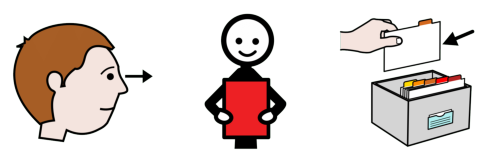

Prediction pict_12281_tu pict_9870_exposición pict_7217_pregunta
3
['./imagenes_procesadas/pict_12281.png', './imagenes_procesadas/pict_9870.png', './imagenes_procesadas/pict_7217.png']
Procesando: ./imagenes_procesadas/pict_12281.png
Procesando: ./imagenes_procesadas/pict_9870.png
Procesando: ./imagenes_procesadas/pict_7217.png


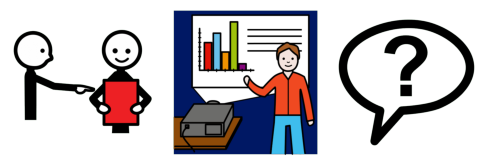

Oracion: pict_6998_revisar pict_6625_tú pict_38462_exámen
3
Procesando: ./imagenes_procesadas/pict_6998.png
Procesando: ./imagenes_procesadas/pict_6625.png
Procesando: ./imagenes_procesadas/pict_38462.png


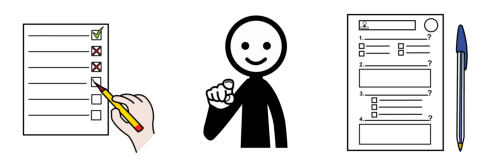

Prediction pict_2380_escribir pict_12281_tu pict_9870_exposición
3
['./imagenes_procesadas/pict_2380.png', './imagenes_procesadas/pict_12281.png', './imagenes_procesadas/pict_9870.png']
Procesando: ./imagenes_procesadas/pict_2380.png
Procesando: ./imagenes_procesadas/pict_12281.png
Procesando: ./imagenes_procesadas/pict_9870.png


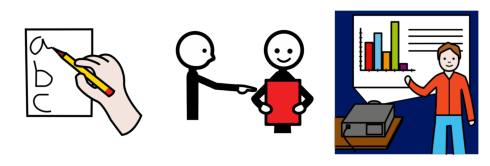

Oracion: pict_28667_desayunar pict_32848_antes_del_mediodía
2
Procesando: ./imagenes_procesadas/pict_28667.png
Procesando: ./imagenes_procesadas/pict_32848.png


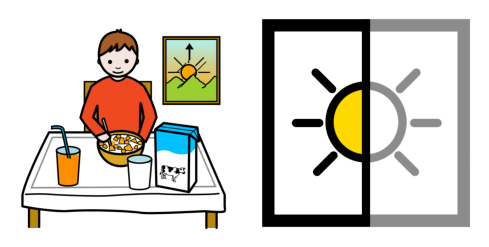

Prediction pict_11691_cuidar pict_11470_importante pict_11712_del pict_2359_cuaderno
4
['./imagenes_procesadas/pict_11691.png', './imagenes_procesadas/pict_11470.png', './imagenes_procesadas/pict_11712.png', './imagenes_procesadas/pict_2359.png']
Procesando: ./imagenes_procesadas/pict_11691.png
Procesando: ./imagenes_procesadas/pict_11470.png
Procesando: ./imagenes_procesadas/pict_11712.png
Procesando: ./imagenes_procesadas/pict_2359.png


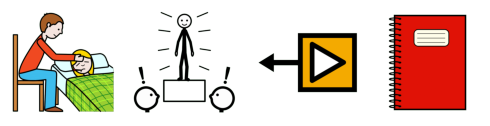

Oracion: pict_22620_qué pict_6901_animales pict_26150_veo_veo
3
Procesando: ./imagenes_procesadas/pict_22620.png
Procesando: ./imagenes_procesadas/pict_6901.png
Procesando: ./imagenes_procesadas/pict_26150.png


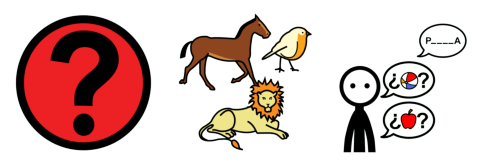

Prediction pict_3415_¿ pict_22624_qué pict_11351_que pict_7271_tener pict_11749_hacer pict_3418_?
6
['./imagenes_procesadas/pict_3415.png', './imagenes_procesadas/pict_22624.png', './imagenes_procesadas/pict_11351.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_11749.png', './imagenes_procesadas/pict_3418.png']
Procesando: ./imagenes_procesadas/pict_3415.png
Procesando: ./imagenes_procesadas/pict_22624.png
Procesando: ./imagenes_procesadas/pict_11351.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_11749.png
Procesando: ./imagenes_procesadas/pict_3418.png


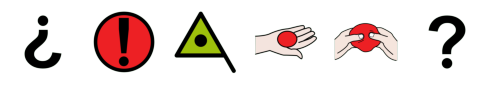

Oracion: pict_8476_la pict_32845_niña pict_2474_mirar
3
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_32845.png
Procesando: ./imagenes_procesadas/pict_2474.png


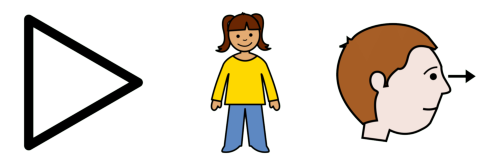

Prediction pict_7029_la pict_11572_plantas pict_8579_explicar
3
['./imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_11572.png', './imagenes_procesadas/pict_8579.png']
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_11572.png
Procesando: ./imagenes_procesadas/pict_8579.png


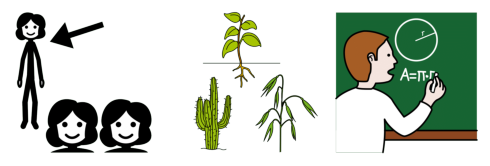

Oracion: pict_31674_nosotros pict_2381_oír
2
Procesando: ./imagenes_procesadas/pict_31674.png
Procesando: ./imagenes_procesadas/pict_2381.png


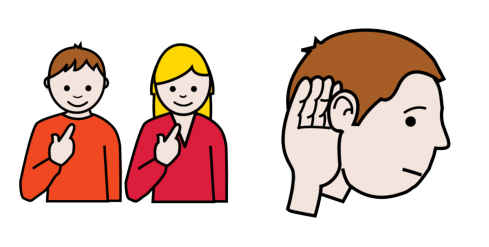

Prediction pict_5526_no pict_2380_escribir
2
['./imagenes_procesadas/pict_5526.png', './imagenes_procesadas/pict_2380.png']
Procesando: ./imagenes_procesadas/pict_5526.png
Procesando: ./imagenes_procesadas/pict_2380.png


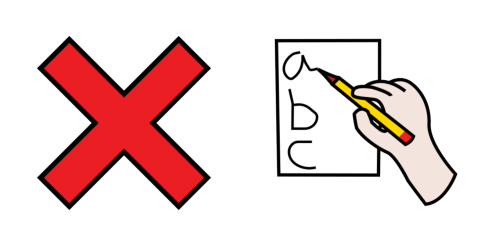

Oracion: pict_25618_cuidado pict_7064_con pict_8476_la pict_24798_electricidad
4
Procesando: ./imagenes_procesadas/pict_25618.png
Procesando: ./imagenes_procesadas/pict_7064.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_24798.png


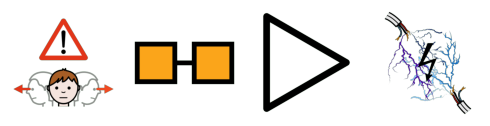

Prediction pict_9819_lugar pict_7064_con pict_7029_la pict_2248_agua electrica
5
['./imagenes_procesadas/pict_9819.png', './imagenes_procesadas/pict_7064.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_2248.png', 'electrica']
Procesando: ./imagenes_procesadas/pict_9819.png
Procesando: ./imagenes_procesadas/pict_7064.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_2248.png
Procesando: electrica


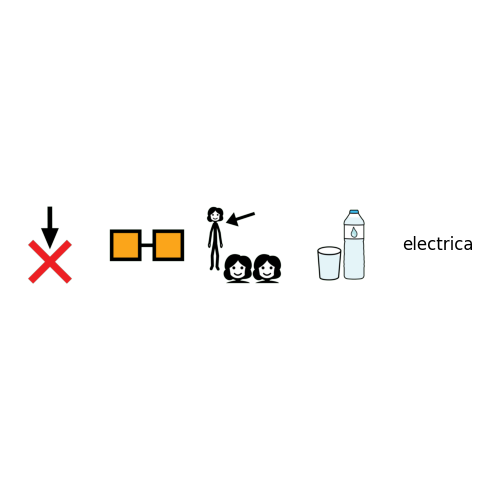

Oracion: pict_2406_gato pict_11399_y pict_2546_ratón
3
Procesando: ./imagenes_procesadas/pict_2406.png
Procesando: ./imagenes_procesadas/pict_11399.png
Procesando: ./imagenes_procesadas/pict_2546.png


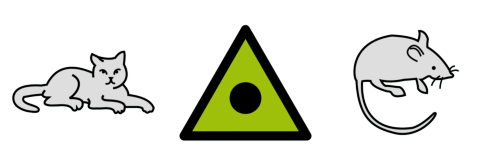

Prediction pict_6975_niños pict_3047_y pict_2359_cuaderno
3
['./imagenes_procesadas/pict_6975.png', './imagenes_procesadas/pict_3047.png', './imagenes_procesadas/pict_2359.png']
Procesando: ./imagenes_procesadas/pict_6975.png
Procesando: ./imagenes_procesadas/pict_3047.png
Procesando: ./imagenes_procesadas/pict_2359.png


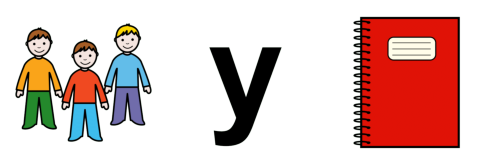

Oracion: pict_38580_reciclado_de_papel
1
Procesando: ./imagenes_procesadas/pict_38580.png


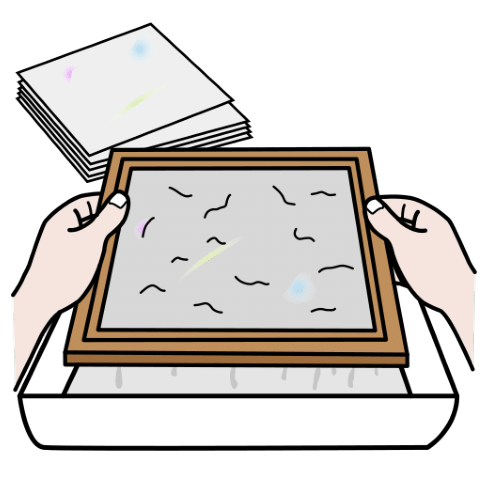

Prediction reciclado pict_7074_de pict_9819_lugar
3
['reciclado', './imagenes_procesadas/pict_7074.png', './imagenes_procesadas/pict_9819.png']
Procesando: reciclado
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_9819.png


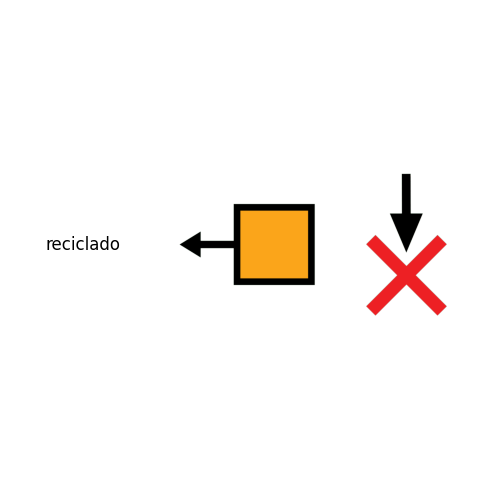

Oracion: pict_2474_mirar pict_8476_la pict_2239_abeja
3
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_2239.png


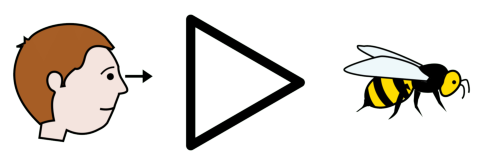

Prediction pict_8579_explicar pict_7029_la pict_11572_plantas
3
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_11572.png']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_11572.png


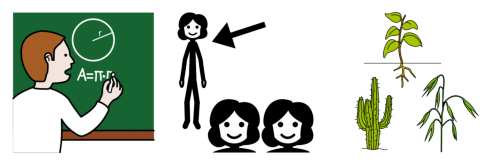

Oracion: pict_31807_yo pict_5441_quiero pict_10148_coger pict_8476_la pict_7107_foto
5
Procesando: ./imagenes_procesadas/pict_31807.png
Procesando: ./imagenes_procesadas/pict_5441.png
Procesando: ./imagenes_procesadas/pict_10148.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_7107.png


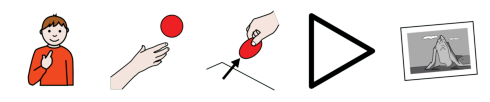

Prediction pict_15485_usar pict_7271_tener pict_11691_cuidar pict_7029_la pict_7217_pregunta
5
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_11691.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_7217.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_11691.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_7217.png


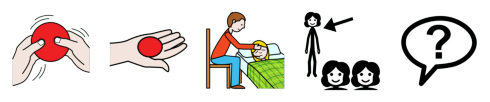

Oracion: pict_11717_descripción pict_8474_una pict_3241_pelota
3
Procesando: ./imagenes_procesadas/pict_11717.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_3241.png


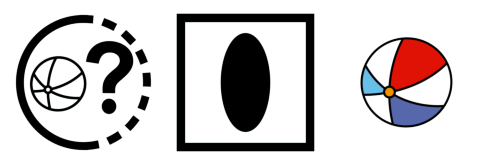

Prediction describir pict_8474_una pict_4649_feria
3
['describir', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_4649.png']
Procesando: describir
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_4649.png


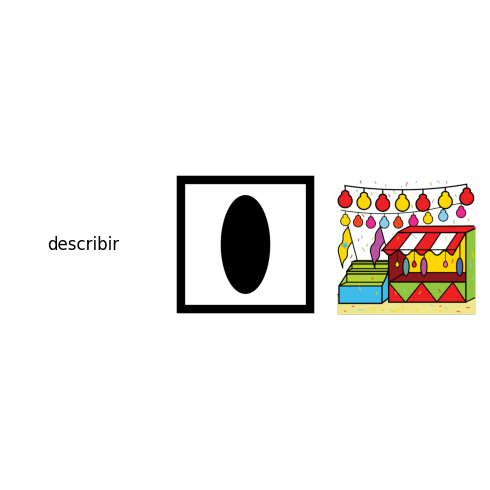

Oracion: pict_10154_dar_paso
1
Procesando: ./imagenes_procesadas/pict_10154.png


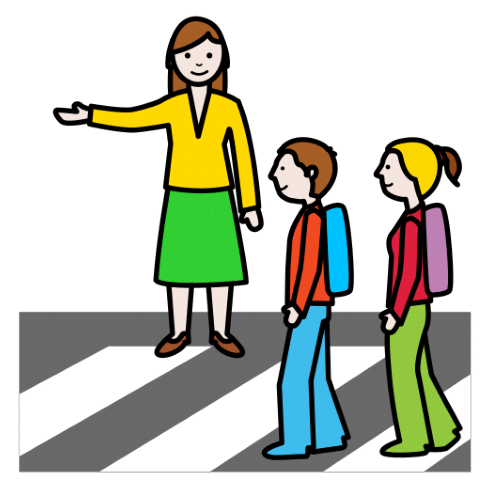

Prediction pict_15485_usar pict_7217_pregunta
2
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_7217.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_7217.png


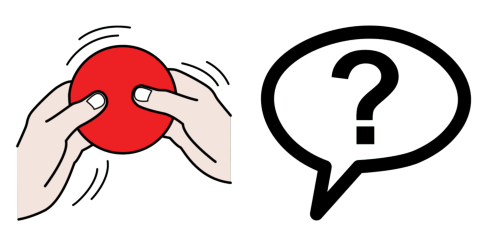

Oracion: pict_5441_yo_quiero pict_8107_escribir
2
Procesando: ./imagenes_procesadas/pict_5441.png
Procesando: ./imagenes_procesadas/pict_8107.png


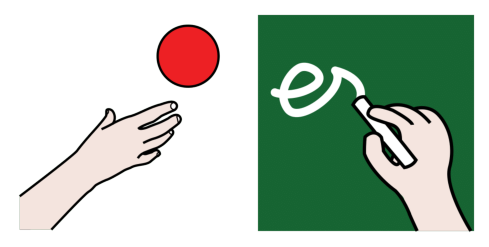

Prediction pict_15485_usar pict_7271_tener pict_2380_escribir
3
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_2380.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_2380.png


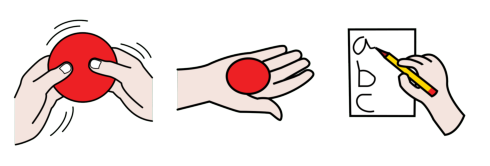

Oracion: pict_32874_cuándo pict_16807_llegar pict_37741_feria
3
Procesando: ./imagenes_procesadas/pict_32874.png
Procesando: ./imagenes_procesadas/pict_16807.png
Procesando: ./imagenes_procesadas/pict_37741.png


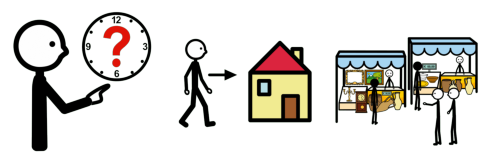

Prediction pict_22619_cómo pict_11691_cuidar pict_7029_la pict_9819_lugar
4
['./imagenes_procesadas/pict_22619.png', './imagenes_procesadas/pict_11691.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_9819.png']
Procesando: ./imagenes_procesadas/pict_22619.png
Procesando: ./imagenes_procesadas/pict_11691.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_9819.png


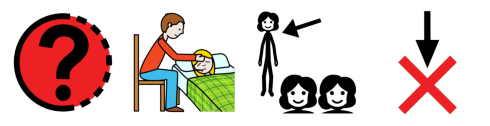

Oracion: pict_4691_marcar pict_11709_al pict_2586_celular
3
Procesando: ./imagenes_procesadas/pict_4691.png
Procesando: ./imagenes_procesadas/pict_11709.png
Procesando: ./imagenes_procesadas/pict_2586.png


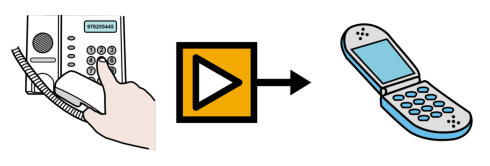

Prediction pict_35653_organizar pict_11709_al pict_2248_agua
3
['./imagenes_procesadas/pict_35653.png', './imagenes_procesadas/pict_11709.png', './imagenes_procesadas/pict_2248.png']
Procesando: ./imagenes_procesadas/pict_35653.png
Procesando: ./imagenes_procesadas/pict_11709.png
Procesando: ./imagenes_procesadas/pict_2248.png


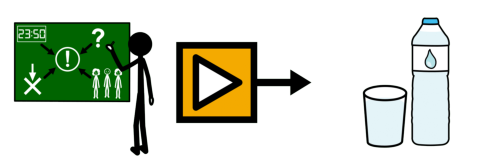

Oracion: pict_8476_el pict_2798_sol pict_35561_calor
3
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_2798.png
Procesando: ./imagenes_procesadas/pict_35561.png


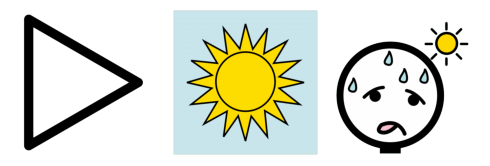

Prediction pict_8476_el pict_2248_agua pict_6481_se pict_2248_agua
4
['./imagenes_procesadas/pict_8476.png', './imagenes_procesadas/pict_2248.png', './imagenes_procesadas/pict_6481.png', './imagenes_procesadas/pict_2248.png']
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_2248.png
Procesando: ./imagenes_procesadas/pict_6481.png
Procesando: ./imagenes_procesadas/pict_2248.png


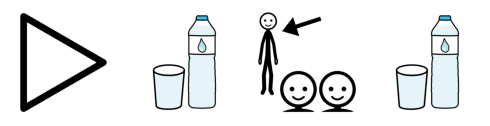

Oracion: pict_2474_observar pict_11709_al pict_6208_robot
3
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_11709.png
Procesando: ./imagenes_procesadas/pict_6208.png


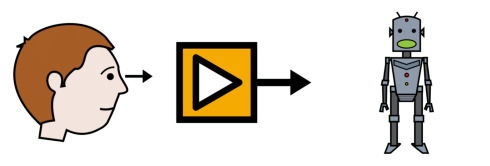

Prediction pict_8579_explicar pict_11709_al pict_6901_animales
3
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_11709.png', './imagenes_procesadas/pict_6901.png']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_11709.png
Procesando: ./imagenes_procesadas/pict_6901.png


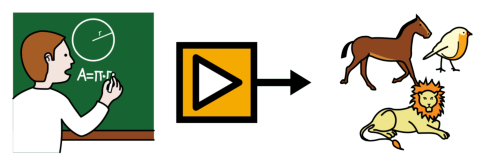

Oracion: pict_11698_elaborar pict_8474_una pict_25413_pintura
3
Procesando: ./imagenes_procesadas/pict_11698.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_25413.png


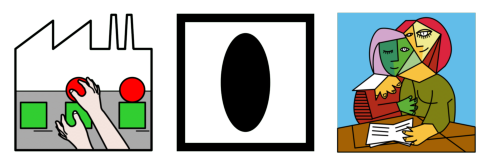

Prediction pict_35653_organizar pict_8474_una pict_9870_exposición
3
['./imagenes_procesadas/pict_35653.png', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_9870.png']
Procesando: ./imagenes_procesadas/pict_35653.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_9870.png


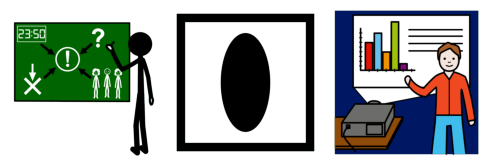

Oracion: pict_37866_trabajo_en_grupo pict_7064_con pict_8476_la pict_2392_familia
4
Procesando: ./imagenes_procesadas/pict_37866.png
Procesando: ./imagenes_procesadas/pict_7064.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_2392.png


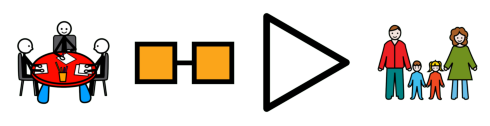

Prediction pict_9819_lugar pict_7034_en pict_9819_lugar
3
['./imagenes_procesadas/pict_9819.png', './imagenes_procesadas/pict_7034.png', './imagenes_procesadas/pict_9819.png']
Procesando: ./imagenes_procesadas/pict_9819.png
Procesando: ./imagenes_procesadas/pict_7034.png
Procesando: ./imagenes_procesadas/pict_9819.png


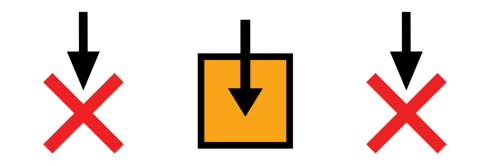

Oracion: pict_38575_¿cuál_es_tu_nombre?
1
Procesando: ./imagenes_procesadas/pict_38575.png


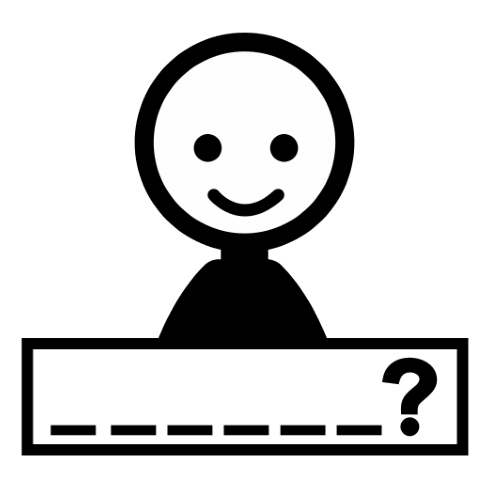

Prediction pict_3415_¿ pict_22619_cómo pict_5581_ser pict_12281_tu pict_37340_texto pict_3418_?
6
['./imagenes_procesadas/pict_3415.png', './imagenes_procesadas/pict_22619.png', './imagenes_procesadas/pict_5581.png', './imagenes_procesadas/pict_12281.png', './imagenes_procesadas/pict_37340.png', './imagenes_procesadas/pict_3418.png']
Procesando: ./imagenes_procesadas/pict_3415.png
Procesando: ./imagenes_procesadas/pict_22619.png
Procesando: ./imagenes_procesadas/pict_5581.png
Procesando: ./imagenes_procesadas/pict_12281.png
Procesando: ./imagenes_procesadas/pict_37340.png
Procesando: ./imagenes_procesadas/pict_3418.png


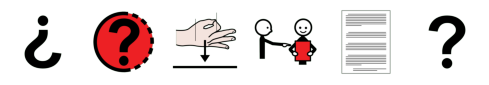

Oracion: pict_8107_escribir pict_37711_solución
2
Procesando: ./imagenes_procesadas/pict_8107.png
Procesando: ./imagenes_procesadas/pict_37711.png


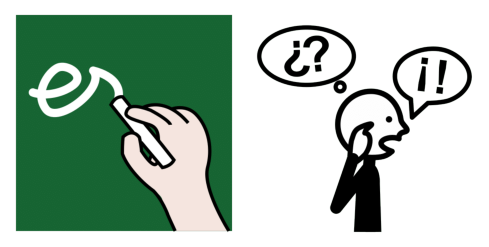

Prediction pict_2380_escribir pict_8474_una pict_7217_pregunta
3
['./imagenes_procesadas/pict_2380.png', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_7217.png']
Procesando: ./imagenes_procesadas/pict_2380.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_7217.png


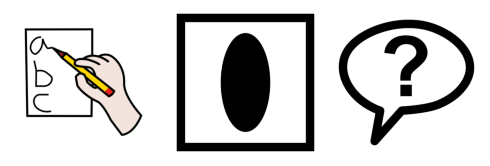

Oracion: pict_7207_pintar pict_36147_cerámica pict_2808_rojo pict_11399_y pict_2886_negro
5
Procesando: ./imagenes_procesadas/pict_7207.png
Procesando: ./imagenes_procesadas/pict_36147.png
Procesando: ./imagenes_procesadas/pict_2808.png
Procesando: ./imagenes_procesadas/pict_11399.png
Procesando: ./imagenes_procesadas/pict_2886.png


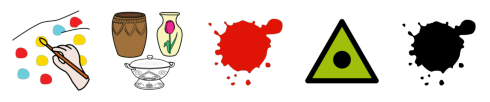

Prediction pict_8088_dibujar pict_9819_lugar pict_4604_claro pict_3047_y pict_2248_agua
5
['./imagenes_procesadas/pict_8088.png', './imagenes_procesadas/pict_9819.png', './imagenes_procesadas/pict_4604.png', './imagenes_procesadas/pict_3047.png', './imagenes_procesadas/pict_2248.png']
Procesando: ./imagenes_procesadas/pict_8088.png
Procesando: ./imagenes_procesadas/pict_9819.png
Procesando: ./imagenes_procesadas/pict_4604.png
Procesando: ./imagenes_procesadas/pict_3047.png
Procesando: ./imagenes_procesadas/pict_2248.png


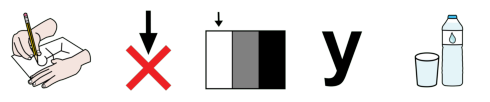

Oracion: pict_2617_yo pict_5441_quiero pict_31680_leer
3
Procesando: ./imagenes_procesadas/pict_2617.png
Procesando: ./imagenes_procesadas/pict_5441.png
Procesando: ./imagenes_procesadas/pict_31680.png


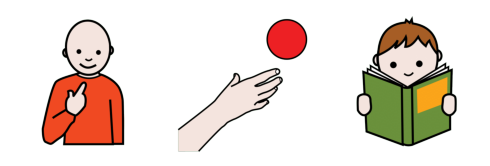

Prediction pict_15485_usar pict_7271_tener pict_7141_leer
3
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_7141.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_7141.png


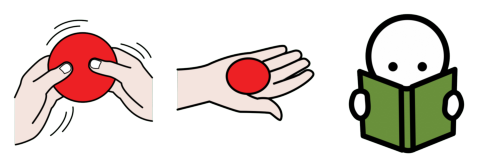

Oracion: pict_28643_leer pict_8474_un pict_8064_publicidad
3
Procesando: ./imagenes_procesadas/pict_28643.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_8064.png


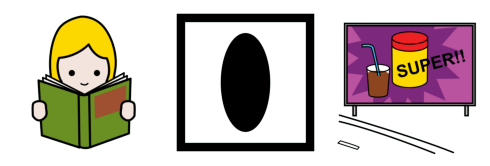

Prediction pict_7141_leer pict_8474_un pict_9819_lugar
3
['./imagenes_procesadas/pict_7141.png', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_9819.png']
Procesando: ./imagenes_procesadas/pict_7141.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_9819.png


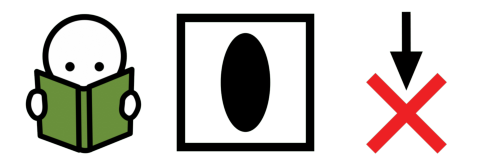

Oracion: pict_2474_observar pict_8476_el pict_35765_queso_de_cabra
3
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_35765.png


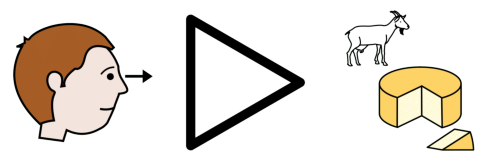

Prediction pict_8579_explicar pict_8476_el pict_5526_no pict_7074_de pict_6901_animales
5
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_8476.png', './imagenes_procesadas/pict_5526.png', './imagenes_procesadas/pict_7074.png', './imagenes_procesadas/pict_6901.png']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_5526.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_6901.png


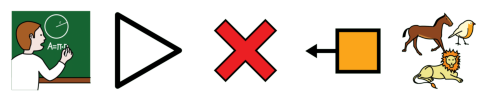

Oracion: pict_31807_yo pict_2349_comer pict_8477_los pict_4610_comida
4
Procesando: ./imagenes_procesadas/pict_31807.png
Procesando: ./imagenes_procesadas/pict_2349.png
Procesando: ./imagenes_procesadas/pict_8477.png
Procesando: ./imagenes_procesadas/pict_4610.png


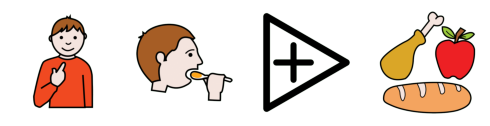

Prediction pict_15485_usar pict_3189_, pict_7033_los pict_2248_agua
4
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_3189.png', './imagenes_procesadas/pict_7033.png', './imagenes_procesadas/pict_2248.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_3189.png
Procesando: ./imagenes_procesadas/pict_7033.png
Procesando: ./imagenes_procesadas/pict_2248.png


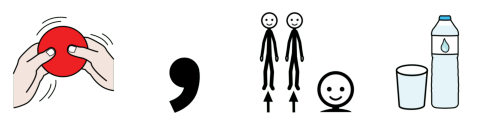

Oracion: pict_2617_yo pict_5441_quiero pict_2582_taza pict_2445_leche
4
Procesando: ./imagenes_procesadas/pict_2617.png
Procesando: ./imagenes_procesadas/pict_5441.png
Procesando: ./imagenes_procesadas/pict_2582.png
Procesando: ./imagenes_procesadas/pict_2445.png


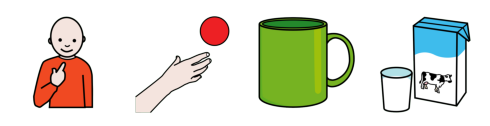

Prediction pict_6483_elegir pict_7271_tener pict_11709_al pict_4649_feria pict_3189_, pict_2248_agua
6
['./imagenes_procesadas/pict_6483.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_11709.png', './imagenes_procesadas/pict_4649.png', './imagenes_procesadas/pict_3189.png', './imagenes_procesadas/pict_2248.png']
Procesando: ./imagenes_procesadas/pict_6483.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_11709.png
Procesando: ./imagenes_procesadas/pict_4649.png
Procesando: ./imagenes_procesadas/pict_3189.png
Procesando: ./imagenes_procesadas/pict_2248.png


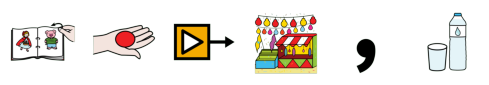

Oracion: pict_32775_¿Cuál_es_el_resultado?
1
Procesando: ./imagenes_procesadas/pict_32775.png


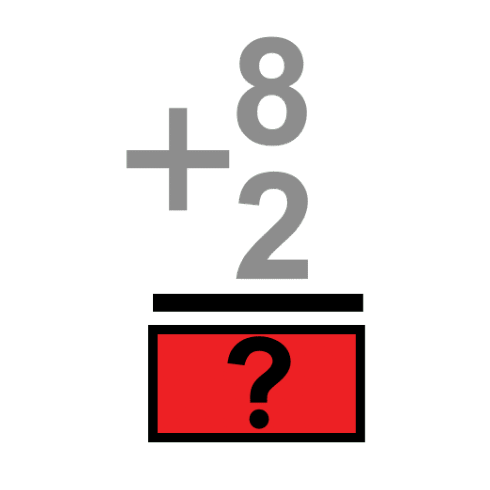

Prediction pict_3415_¿ pict_22619_cómo pict_5581_ser pict_8476_el pict_35477_paso pict_3418_?
6
['./imagenes_procesadas/pict_3415.png', './imagenes_procesadas/pict_22619.png', './imagenes_procesadas/pict_5581.png', './imagenes_procesadas/pict_8476.png', './imagenes_procesadas/pict_35477.png', './imagenes_procesadas/pict_3418.png']
Procesando: ./imagenes_procesadas/pict_3415.png
Procesando: ./imagenes_procesadas/pict_22619.png
Procesando: ./imagenes_procesadas/pict_5581.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_35477.png
Procesando: ./imagenes_procesadas/pict_3418.png


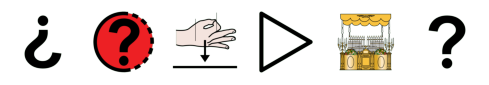

Oracion: pict_2474_mirar pict_8476_el pict_3175_amanecer
3
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_3175.png


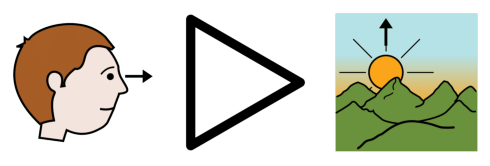

Prediction pict_8579_explicar pict_8476_el pict_8185_Perú
3
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_8476.png', './imagenes_procesadas/pict_8185.png']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_8185.png


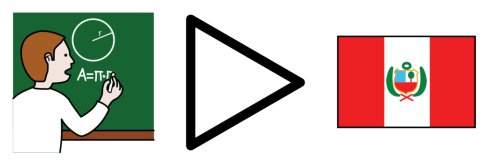

Oracion: pict_35371_jugar_a_la_pelota
1
Procesando: ./imagenes_procesadas/pict_35371.png


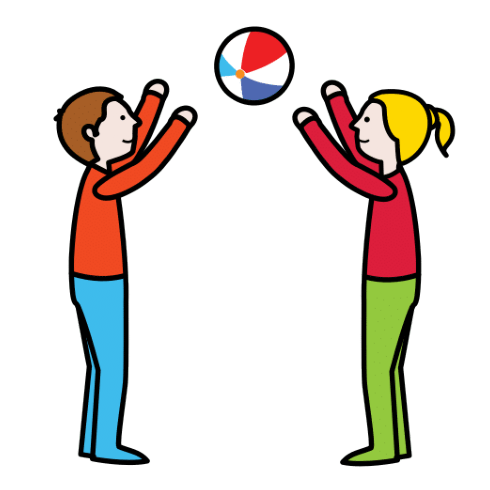

Prediction pict_3415_¿ pict_8029_aprender pict_3021_a pict_7029_la pict_4649_feria pict_3418_?
6
['./imagenes_procesadas/pict_3415.png', './imagenes_procesadas/pict_8029.png', './imagenes_procesadas/pict_3021.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_4649.png', './imagenes_procesadas/pict_3418.png']
Procesando: ./imagenes_procesadas/pict_3415.png
Procesando: ./imagenes_procesadas/pict_8029.png
Procesando: ./imagenes_procesadas/pict_3021.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_4649.png
Procesando: ./imagenes_procesadas/pict_3418.png


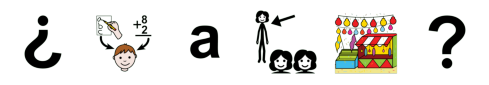

Oracion: pict_6537_jugar pict_7041_a pict_8477_las pict_24829_adivinanza
4
Procesando: ./imagenes_procesadas/pict_6537.png
Procesando: ./imagenes_procesadas/pict_7041.png
Procesando: ./imagenes_procesadas/pict_8477.png
Procesando: ./imagenes_procesadas/pict_24829.png


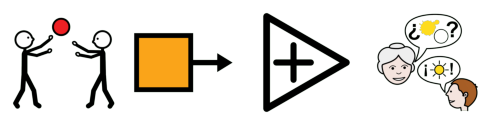

Prediction pict_35653_organizar pict_3021_a pict_7031_las pict_35477_paso
4
['./imagenes_procesadas/pict_35653.png', './imagenes_procesadas/pict_3021.png', './imagenes_procesadas/pict_7031.png', './imagenes_procesadas/pict_35477.png']
Procesando: ./imagenes_procesadas/pict_35653.png
Procesando: ./imagenes_procesadas/pict_3021.png
Procesando: ./imagenes_procesadas/pict_7031.png
Procesando: ./imagenes_procesadas/pict_35477.png


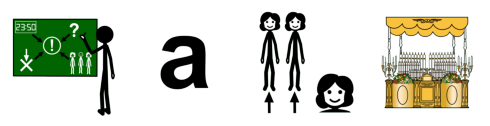

Oracion: pict_25355_prestar_atención
1
Procesando: ./imagenes_procesadas/pict_25355.png


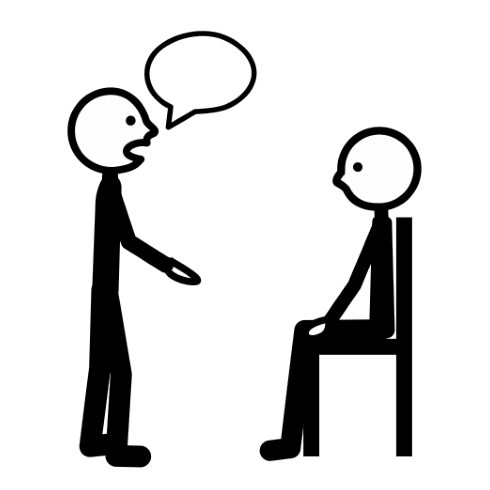

Prediction pict_9870_presentar pict_9819_lugar
2
['./imagenes_procesadas/pict_9870.png', './imagenes_procesadas/pict_9819.png']
Procesando: ./imagenes_procesadas/pict_9870.png
Procesando: ./imagenes_procesadas/pict_9819.png


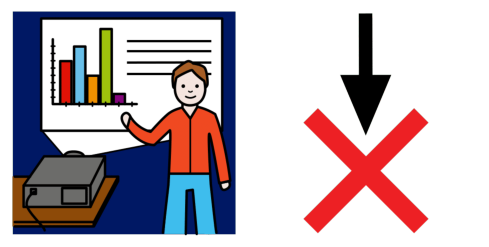

Oracion: pict_22619_cómo pict_26638_aprender_a_nadar
2
Procesando: ./imagenes_procesadas/pict_22619.png
Procesando: ./imagenes_procesadas/pict_26638.png


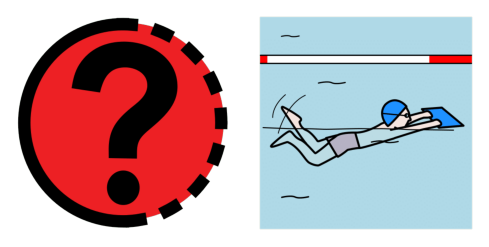

Prediction pict_3415_¿ pict_22619_cómo pict_11749_hacer pict_3021_a pict_5526_no pict_3418_?
6
['./imagenes_procesadas/pict_3415.png', './imagenes_procesadas/pict_22619.png', './imagenes_procesadas/pict_11749.png', './imagenes_procesadas/pict_3021.png', './imagenes_procesadas/pict_5526.png', './imagenes_procesadas/pict_3418.png']
Procesando: ./imagenes_procesadas/pict_3415.png
Procesando: ./imagenes_procesadas/pict_22619.png
Procesando: ./imagenes_procesadas/pict_11749.png
Procesando: ./imagenes_procesadas/pict_3021.png
Procesando: ./imagenes_procesadas/pict_5526.png
Procesando: ./imagenes_procesadas/pict_3418.png


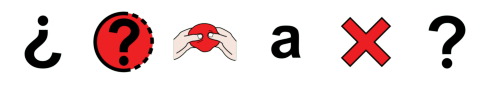

Oracion: pict_11717_descripción pict_7074_de pict_32598_lugar
3
Procesando: ./imagenes_procesadas/pict_11717.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_32598.png


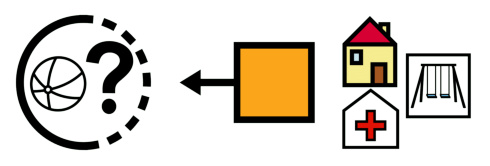

Prediction pict_37340_texto pict_7074_de pict_8474_un pict_37340_texto
4
['./imagenes_procesadas/pict_37340.png', './imagenes_procesadas/pict_7074.png', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_37340.png']
Procesando: ./imagenes_procesadas/pict_37340.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_37340.png


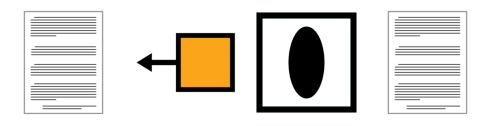

Oracion: pict_28643_leer pict_5936_silencio pict_5306_rápida
3
Procesando: ./imagenes_procesadas/pict_28643.png
Procesando: ./imagenes_procesadas/pict_5936.png
Procesando: ./imagenes_procesadas/pict_5306.png


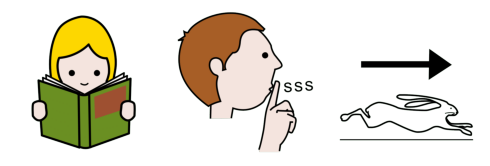

Prediction pict_7141_leer pict_7074_de manera pict_4604_claro pict_3047_y pict_4604_claro
6
['./imagenes_procesadas/pict_7141.png', './imagenes_procesadas/pict_7074.png', 'manera', './imagenes_procesadas/pict_4604.png', './imagenes_procesadas/pict_3047.png', './imagenes_procesadas/pict_4604.png']
Procesando: ./imagenes_procesadas/pict_7141.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: manera
Procesando: ./imagenes_procesadas/pict_4604.png
Procesando: ./imagenes_procesadas/pict_3047.png
Procesando: ./imagenes_procesadas/pict_4604.png


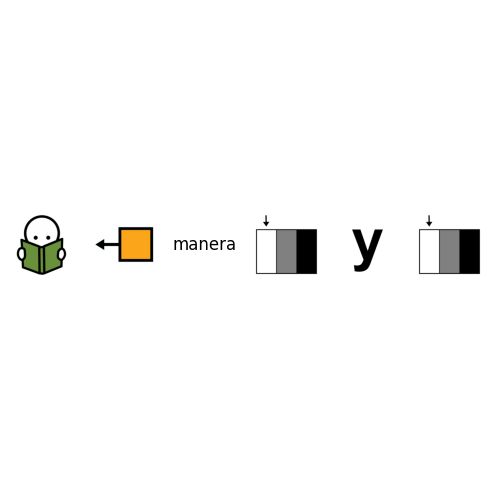

Oracion: pict_32940_vámonos_a_casa
1
Procesando: ./imagenes_procesadas/pict_32940.png


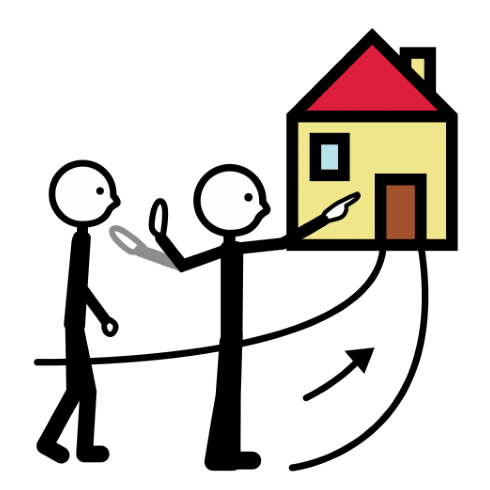

Prediction pict_11691_cuidar pict_3021_a pict_9819_lugar
3
['./imagenes_procesadas/pict_11691.png', './imagenes_procesadas/pict_3021.png', './imagenes_procesadas/pict_9819.png']
Procesando: ./imagenes_procesadas/pict_11691.png
Procesando: ./imagenes_procesadas/pict_3021.png
Procesando: ./imagenes_procesadas/pict_9819.png


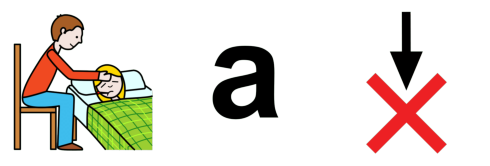

Oracion: pict_25618_cuidado pict_7064_con pict_8476_la pict_36147_cerámica
4
Procesando: ./imagenes_procesadas/pict_25618.png
Procesando: ./imagenes_procesadas/pict_7064.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_36147.png


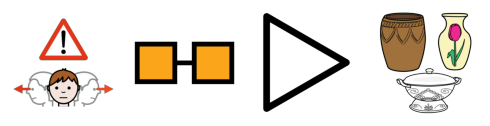

Prediction pict_9819_lugar pict_7064_con pict_7029_la pict_9870_exposición
4
['./imagenes_procesadas/pict_9819.png', './imagenes_procesadas/pict_7064.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_9870.png']
Procesando: ./imagenes_procesadas/pict_9819.png
Procesando: ./imagenes_procesadas/pict_7064.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_9870.png


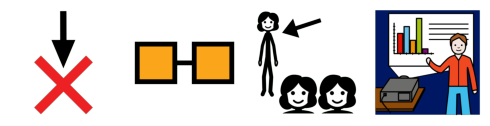

Oracion: pict_30194_sentidos pict_7074_de pict_2486_olfatear
3
Procesando: ./imagenes_procesadas/pict_30194.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_2486.png


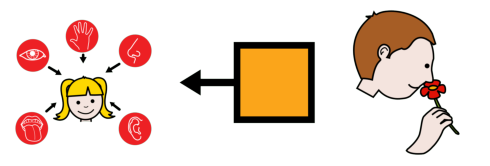

Prediction sentido pict_11712_del olfato
3
['sentido', './imagenes_procesadas/pict_11712.png', 'olfato']
Procesando: sentido
Procesando: ./imagenes_procesadas/pict_11712.png
Procesando: olfato


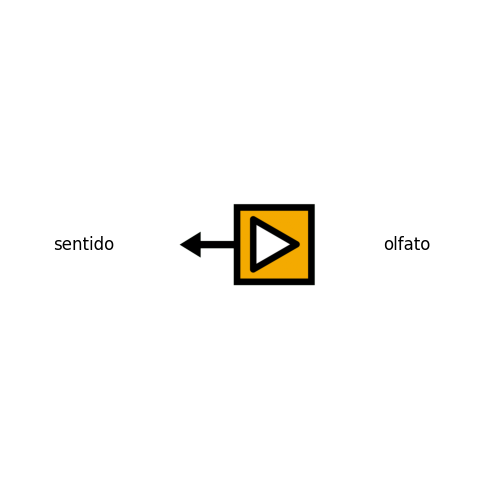

Oracion: pict_22620_qué pict_9043_cosechar
2
Procesando: ./imagenes_procesadas/pict_22620.png
Procesando: ./imagenes_procesadas/pict_9043.png


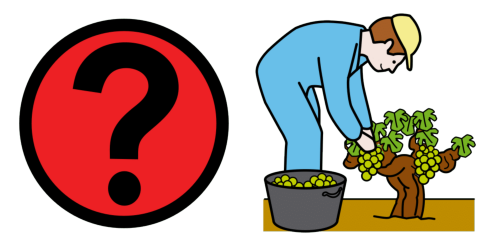

Prediction pict_22624_qué pict_11691_cuidar
2
['./imagenes_procesadas/pict_22624.png', './imagenes_procesadas/pict_11691.png']
Procesando: ./imagenes_procesadas/pict_22624.png
Procesando: ./imagenes_procesadas/pict_11691.png


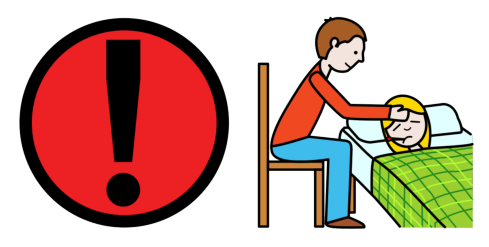

Oracion: pict_31807_yo pict_5441_quiero pict_8103_encender_la_luz
3
Procesando: ./imagenes_procesadas/pict_31807.png
Procesando: ./imagenes_procesadas/pict_5441.png
Procesando: ./imagenes_procesadas/pict_8103.png


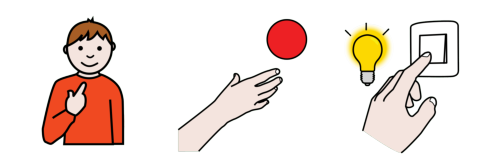

Prediction pict_35653_organizar pict_7271_tener pict_35653_organizar pict_7029_la pict_2248_agua
5
['./imagenes_procesadas/pict_35653.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_35653.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_2248.png']
Procesando: ./imagenes_procesadas/pict_35653.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_35653.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_2248.png


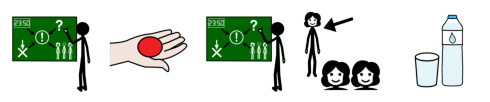

Oracion: pict_28689_salir pict_7064_con pict_2255_amigos
3
Procesando: ./imagenes_procesadas/pict_28689.png
Procesando: ./imagenes_procesadas/pict_7064.png
Procesando: ./imagenes_procesadas/pict_2255.png


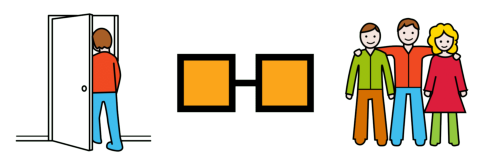

Prediction pict_8029_aprender pict_7064_con pict_9819_lugar
3
['./imagenes_procesadas/pict_8029.png', './imagenes_procesadas/pict_7064.png', './imagenes_procesadas/pict_9819.png']
Procesando: ./imagenes_procesadas/pict_8029.png
Procesando: ./imagenes_procesadas/pict_7064.png
Procesando: ./imagenes_procesadas/pict_9819.png


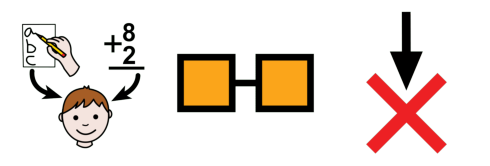

Oracion: pict_24943_carpa pict_7199_peces pict_2739_dorado
3
Procesando: ./imagenes_procesadas/pict_24943.png
Procesando: ./imagenes_procesadas/pict_7199.png
Procesando: ./imagenes_procesadas/pict_2739.png


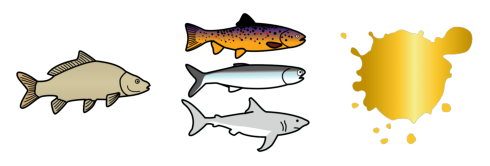

Prediction carpa pict_3189_, pict_6901_animales pict_22769_artesanía
4
['carpa', './imagenes_procesadas/pict_3189.png', './imagenes_procesadas/pict_6901.png', './imagenes_procesadas/pict_22769.png']
Procesando: carpa
Procesando: ./imagenes_procesadas/pict_3189.png
Procesando: ./imagenes_procesadas/pict_6901.png
Procesando: ./imagenes_procesadas/pict_22769.png


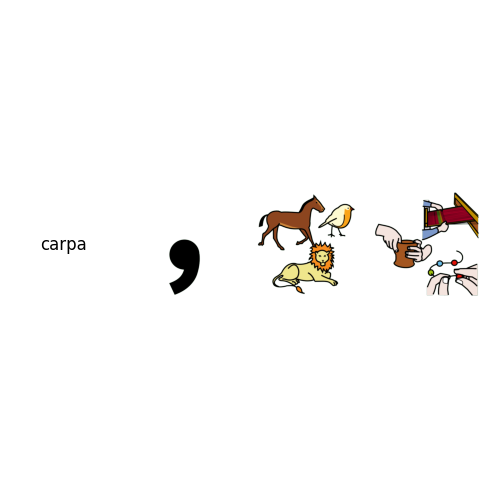

Oracion: pict_2617_yo pict_5441_quiero pict_8579_explicar
3
Procesando: ./imagenes_procesadas/pict_2617.png
Procesando: ./imagenes_procesadas/pict_5441.png
Procesando: ./imagenes_procesadas/pict_8579.png


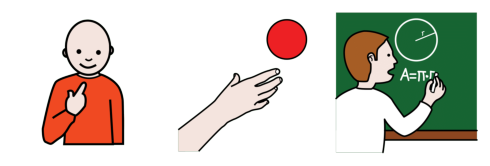

Prediction pict_15485_usar pict_7271_tener pict_2380_escribir
3
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_2380.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_2380.png


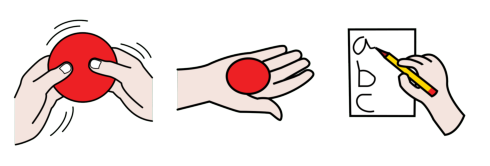

Oracion: pict_5441_quiero pict_8103_encender_la_luz
2
Procesando: ./imagenes_procesadas/pict_5441.png
Procesando: ./imagenes_procesadas/pict_8103.png


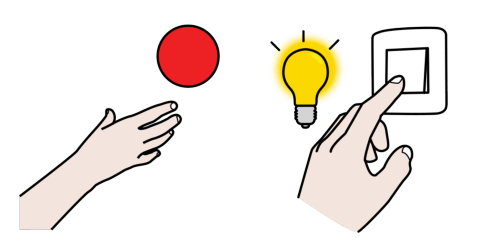

Prediction pict_35653_organizar pict_7271_tener pict_35653_organizar pict_7029_la pict_2248_agua
5
['./imagenes_procesadas/pict_35653.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_35653.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_2248.png']
Procesando: ./imagenes_procesadas/pict_35653.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_35653.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_2248.png


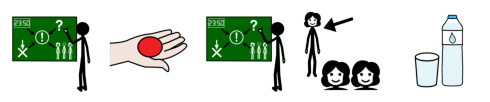

Oracion: pict_2474_observar pict_8476_la pict_4555_actriz
3
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_4555.png


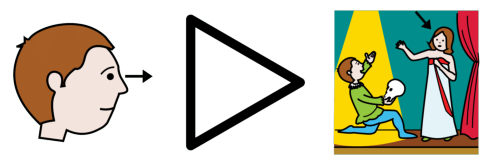

Prediction pict_8579_explicar pict_7029_la pict_22769_artesanía
3
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_22769.png']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_22769.png


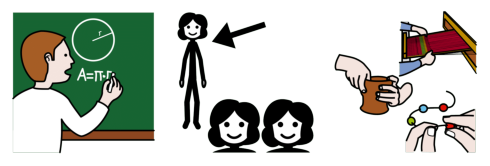

Oracion: pict_31807_yo pict_5441_quiero pict_9843_preguntar
3
Procesando: ./imagenes_procesadas/pict_31807.png
Procesando: ./imagenes_procesadas/pict_5441.png
Procesando: ./imagenes_procesadas/pict_9843.png


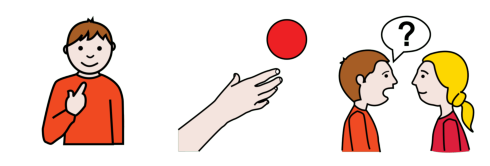

Prediction pict_15485_usar pict_7271_tener pict_3345_hablar
3
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_3345.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_3345.png


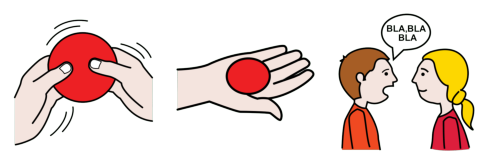

Oracion: pict_2474_ver pict_8476_el pict_38514_qr
3
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_38514.png


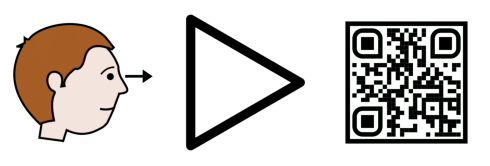

Prediction pict_8579_explicar pict_8476_el código qr
4
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_8476.png', 'código', 'qr']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: código
Procesando: qr


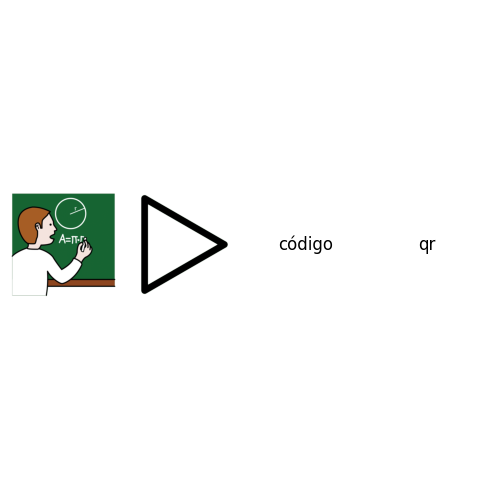

Oracion: pict_24721_clima pict_31845_caluroso
2
Procesando: ./imagenes_procesadas/pict_24721.png
Procesando: ./imagenes_procesadas/pict_31845.png


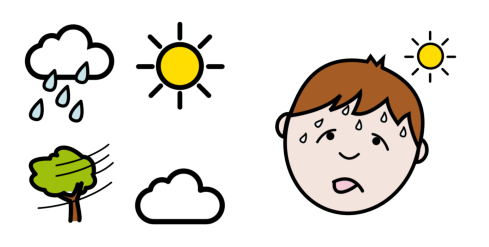

Prediction pict_9819_lugar caluroso
2
['./imagenes_procesadas/pict_9819.png', 'caluroso']
Procesando: ./imagenes_procesadas/pict_9819.png
Procesando: caluroso


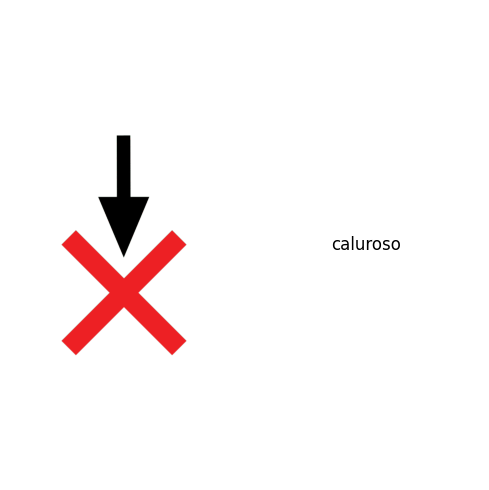

Oracion: pict_8142_ir pict_7041_a pict_8476_la pict_37569_mesa_del_congreso
4
Procesando: ./imagenes_procesadas/pict_8142.png
Procesando: ./imagenes_procesadas/pict_7041.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_37569.png


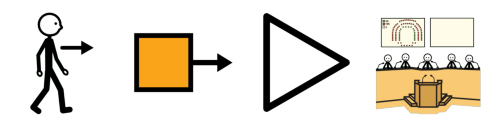

Prediction pict_3345_hablar pict_3021_a pict_7029_la pict_4649_feria pict_11712_del pict_9870_exposición
6
['./imagenes_procesadas/pict_3345.png', './imagenes_procesadas/pict_3021.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_4649.png', './imagenes_procesadas/pict_11712.png', './imagenes_procesadas/pict_9870.png']
Procesando: ./imagenes_procesadas/pict_3345.png
Procesando: ./imagenes_procesadas/pict_3021.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_4649.png
Procesando: ./imagenes_procesadas/pict_11712.png
Procesando: ./imagenes_procesadas/pict_9870.png


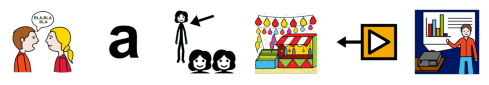

Oracion: pict_5896_adiós
1
Procesando: ./imagenes_procesadas/pict_5896.png


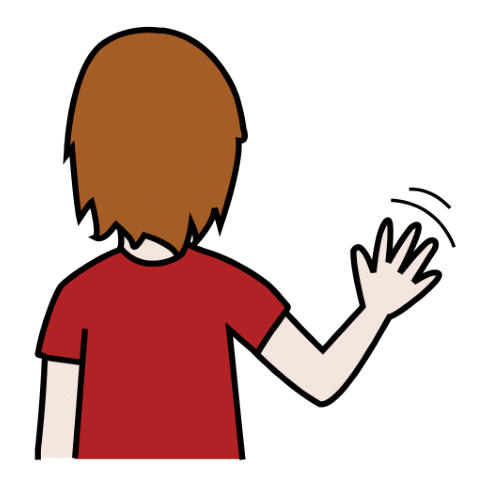

Prediction pict_7212_por pict_5526_no
2
['./imagenes_procesadas/pict_7212.png', './imagenes_procesadas/pict_5526.png']
Procesando: ./imagenes_procesadas/pict_7212.png
Procesando: ./imagenes_procesadas/pict_5526.png


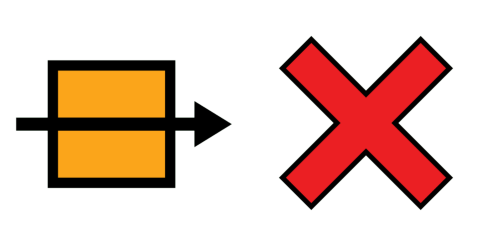

Oracion: pict_32340_rico
1
Procesando: ./imagenes_procesadas/pict_32340.png


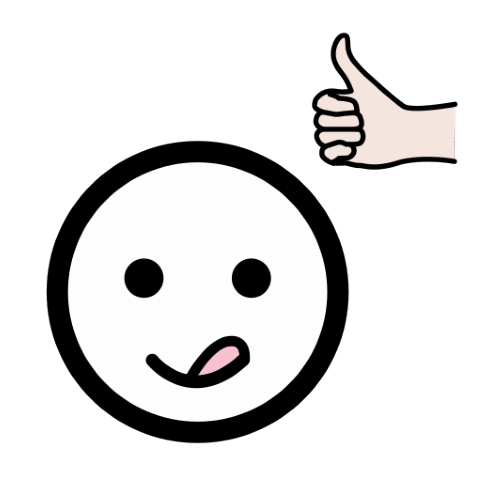

Prediction pict_4604_claro
1
['./imagenes_procesadas/pict_4604.png']
Procesando: ./imagenes_procesadas/pict_4604.png


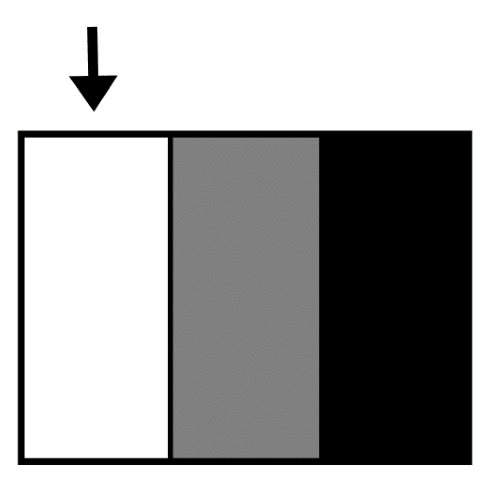

Oracion: pict_39101_plantas_aromáticas
1
Procesando: ./imagenes_procesadas/pict_39101.png


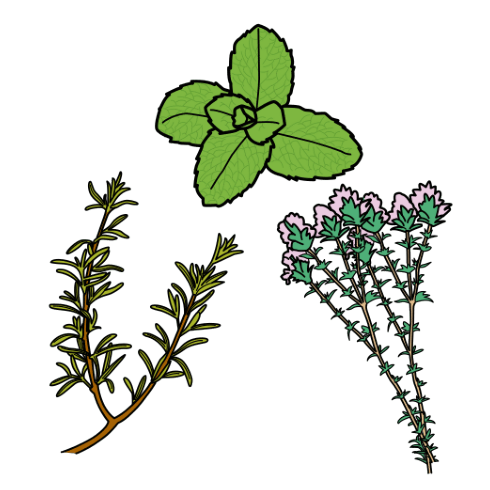

Prediction pict_11572_plantas aromáticas
2
['./imagenes_procesadas/pict_11572.png', 'aromáticas']
Procesando: ./imagenes_procesadas/pict_11572.png
Procesando: aromáticas


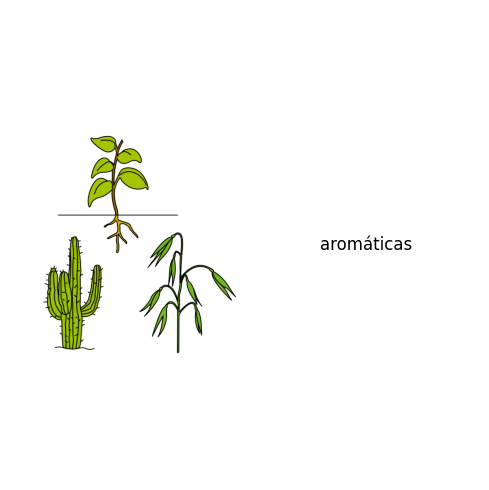

Oracion: pict_38249_botón_de_volver pict_7041_a pict_7141_leer
3
Procesando: ./imagenes_procesadas/pict_38249.png
Procesando: ./imagenes_procesadas/pict_7041.png
Procesando: ./imagenes_procesadas/pict_7141.png


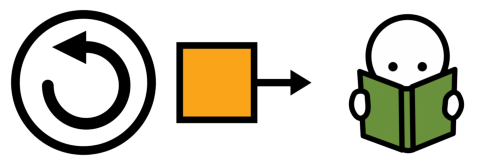

Prediction pict_9030_responder pict_3021_a pict_7141_leer pict_8476_el pict_37340_texto
5
['./imagenes_procesadas/pict_9030.png', './imagenes_procesadas/pict_3021.png', './imagenes_procesadas/pict_7141.png', './imagenes_procesadas/pict_8476.png', './imagenes_procesadas/pict_37340.png']
Procesando: ./imagenes_procesadas/pict_9030.png
Procesando: ./imagenes_procesadas/pict_3021.png
Procesando: ./imagenes_procesadas/pict_7141.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_37340.png


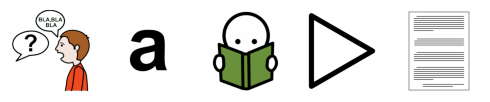

Oracion: pict_8490_anotar pict_7034_en pict_12264_mi pict_2359_cuaderno
4
Procesando: ./imagenes_procesadas/pict_8490.png
Procesando: ./imagenes_procesadas/pict_7034.png
Procesando: ./imagenes_procesadas/pict_12264.png
Procesando: ./imagenes_procesadas/pict_2359.png


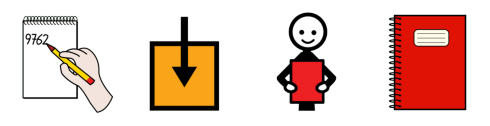

Prediction pict_7141_leer pict_7034_en pict_12281_tu pict_7141_leer
4
['./imagenes_procesadas/pict_7141.png', './imagenes_procesadas/pict_7034.png', './imagenes_procesadas/pict_12281.png', './imagenes_procesadas/pict_7141.png']
Procesando: ./imagenes_procesadas/pict_7141.png
Procesando: ./imagenes_procesadas/pict_7034.png
Procesando: ./imagenes_procesadas/pict_12281.png
Procesando: ./imagenes_procesadas/pict_7141.png


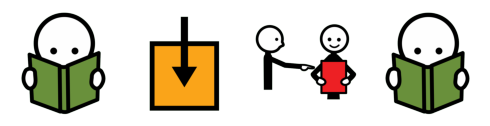

Oracion: pict_22007_obedecer pict_7041_a pict_7029_la pict_28003_maestra
4
Procesando: ./imagenes_procesadas/pict_22007.png
Procesando: ./imagenes_procesadas/pict_7041.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_28003.png


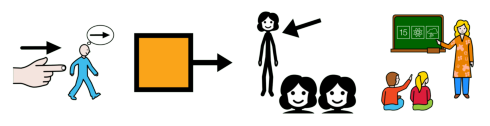

Prediction pict_9030_responder pict_3021_a pict_7029_la pict_35477_paso
4
['./imagenes_procesadas/pict_9030.png', './imagenes_procesadas/pict_3021.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_35477.png']
Procesando: ./imagenes_procesadas/pict_9030.png
Procesando: ./imagenes_procesadas/pict_3021.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_35477.png


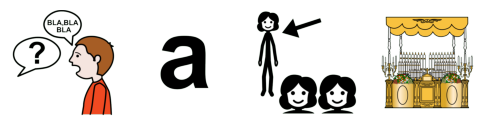

Oracion: pict_7006_cuerda
1
Procesando: ./imagenes_procesadas/pict_7006.png


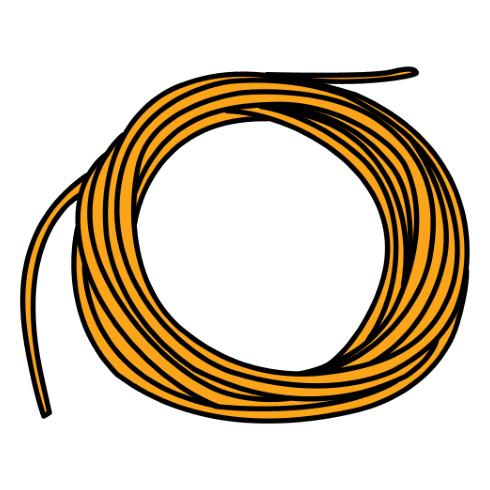

Prediction pict_35477_paso
1
['./imagenes_procesadas/pict_35477.png']
Procesando: ./imagenes_procesadas/pict_35477.png


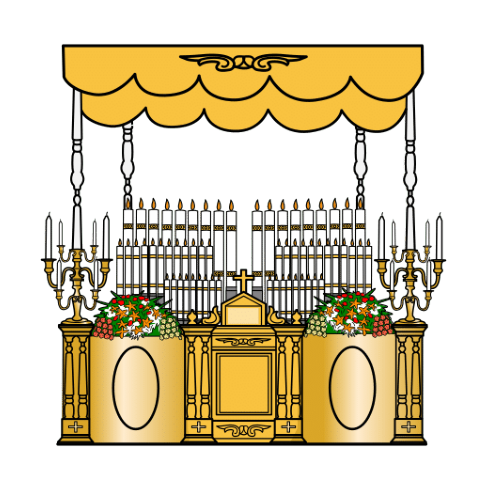

Oracion: pict_25618_cuidado pict_5976_cruzar pict_2811_río
3
Procesando: ./imagenes_procesadas/pict_25618.png
Procesando: ./imagenes_procesadas/pict_5976.png
Procesando: ./imagenes_procesadas/pict_2811.png


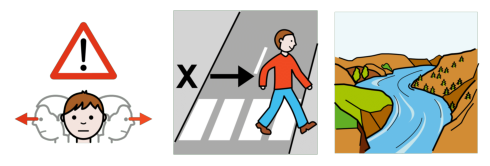

Prediction pict_9819_lugar pict_11709_al pict_11691_cuidar pict_8476_el pict_2248_agua
5
['./imagenes_procesadas/pict_9819.png', './imagenes_procesadas/pict_11709.png', './imagenes_procesadas/pict_11691.png', './imagenes_procesadas/pict_8476.png', './imagenes_procesadas/pict_2248.png']
Procesando: ./imagenes_procesadas/pict_9819.png
Procesando: ./imagenes_procesadas/pict_11709.png
Procesando: ./imagenes_procesadas/pict_11691.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_2248.png


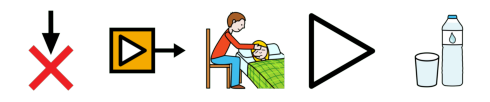

Oracion: pict_2349_comer pict_2519_pescado
2
Procesando: ./imagenes_procesadas/pict_2349.png
Procesando: ./imagenes_procesadas/pict_2519.png


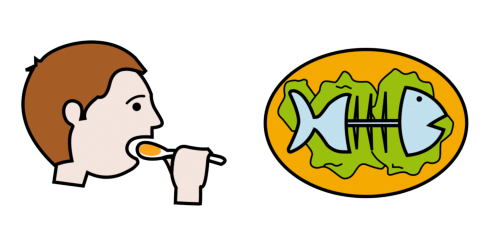

Prediction pict_7141_leer pict_9870_presentar pict_6901_animales#
3
['./imagenes_procesadas/pict_7141.png', './imagenes_procesadas/pict_9870.png', './imagenes_procesadas/pict_6901.png']
Procesando: ./imagenes_procesadas/pict_7141.png
Procesando: ./imagenes_procesadas/pict_9870.png
Procesando: ./imagenes_procesadas/pict_6901.png


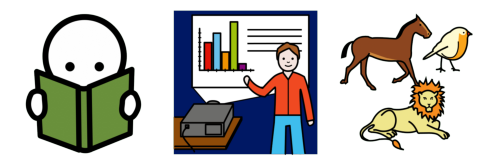

Oracion: pict_2474_ver pict_8476_la pict_2933_luna
3
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_2933.png


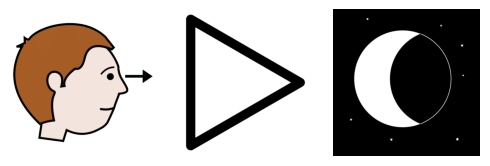

Prediction pict_8579_explicar pict_7029_la pict_2248_agua
3
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_2248.png']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_2248.png


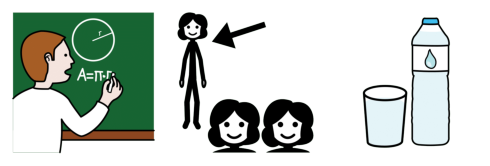

Oracion: pict_11318_objetos pict_4716_pequeño
2
Procesando: ./imagenes_procesadas/pict_11318.png
Procesando: ./imagenes_procesadas/pict_4716.png


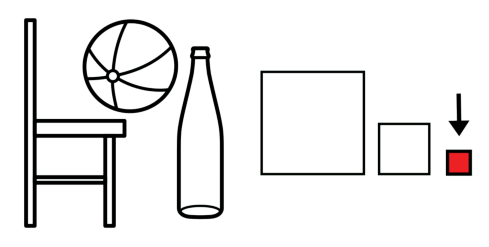

Prediction pict_9819_lugar pict_11470_importante
2
['./imagenes_procesadas/pict_9819.png', './imagenes_procesadas/pict_11470.png']
Procesando: ./imagenes_procesadas/pict_9819.png
Procesando: ./imagenes_procesadas/pict_11470.png


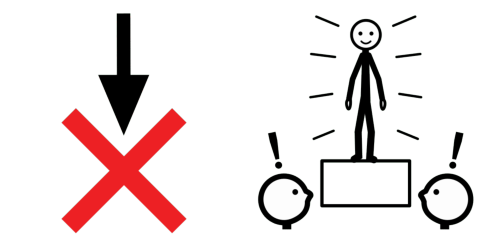

Oracion: pict_21800_diseñar pict_8474_un pict_21802_documento
3
Procesando: ./imagenes_procesadas/pict_21800.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_21802.png


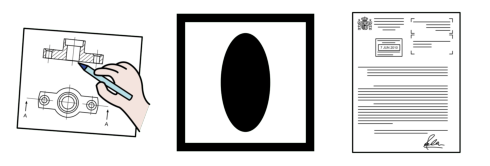

Prediction pict_15485_usar pict_8474_un documento
3
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_8474.png', 'documento']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: documento


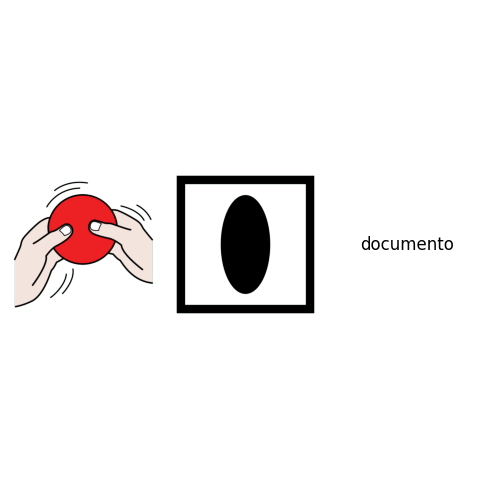

Oracion: pict_8476_el pict_2666_bosque pict_7168_muchas pict_11572_plantas
4
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_2666.png
Procesando: ./imagenes_procesadas/pict_7168.png
Procesando: ./imagenes_procesadas/pict_11572.png


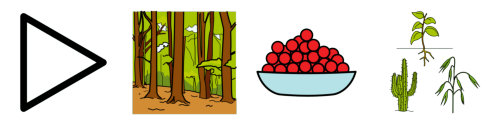

Prediction pict_8476_el pict_9819_lugar pict_7271_tener pict_12281_tu pict_9819_lugar
5
['./imagenes_procesadas/pict_8476.png', './imagenes_procesadas/pict_9819.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_12281.png', './imagenes_procesadas/pict_9819.png']
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_9819.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_12281.png
Procesando: ./imagenes_procesadas/pict_9819.png


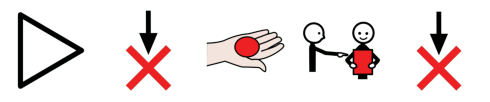

Oracion: pict_2474_observar pict_8476_el pict_2845_periódico
3
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_2845.png


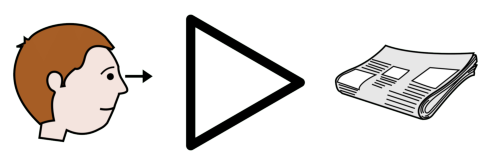

Prediction pict_8579_explicar pict_8476_el periodico
3
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_8476.png', 'periodico']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: periodico


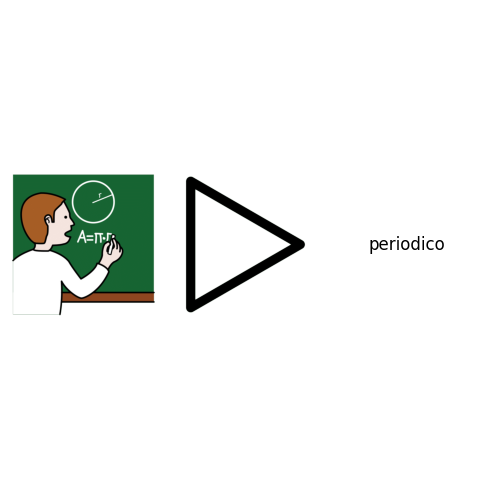

Oracion: pict_7158_mi_turno
1
Procesando: ./imagenes_procesadas/pict_7158.png


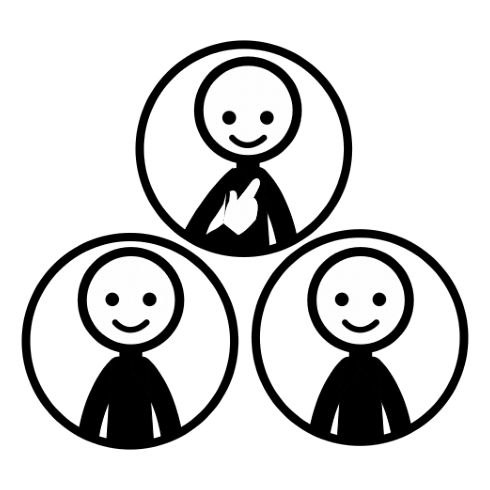

Prediction pict_7271_tener pict_11691_cuidar pict_3021_a pict_12281_tu
4
['./imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_11691.png', './imagenes_procesadas/pict_3021.png', './imagenes_procesadas/pict_12281.png']
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_11691.png
Procesando: ./imagenes_procesadas/pict_3021.png
Procesando: ./imagenes_procesadas/pict_12281.png


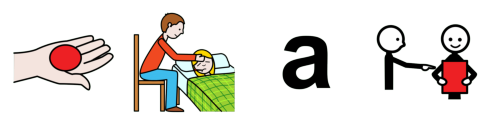

Oracion: pict_2474_mirar pict_11709_al pict_2477_mono
3
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_11709.png
Procesando: ./imagenes_procesadas/pict_2477.png


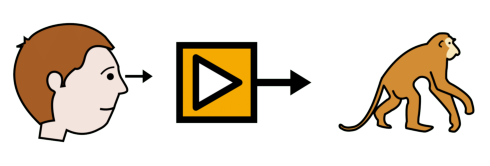

Prediction pict_8029_aprender pict_11709_al pict_4604_claro
3
['./imagenes_procesadas/pict_8029.png', './imagenes_procesadas/pict_11709.png', './imagenes_procesadas/pict_4604.png']
Procesando: ./imagenes_procesadas/pict_8029.png
Procesando: ./imagenes_procesadas/pict_11709.png
Procesando: ./imagenes_procesadas/pict_4604.png


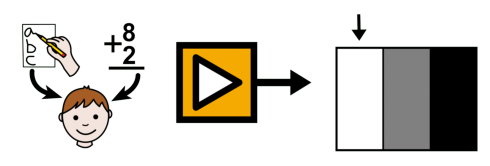

Oracion: pict_32814_terminar pict_7074_de pict_2836_pintar
3
Procesando: ./imagenes_procesadas/pict_32814.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_2836.png


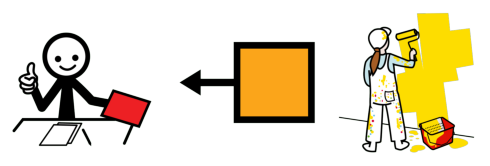

Prediction pict_11691_cuidar pict_7074_de pict_7141_leer
3
['./imagenes_procesadas/pict_11691.png', './imagenes_procesadas/pict_7074.png', './imagenes_procesadas/pict_7141.png']
Procesando: ./imagenes_procesadas/pict_11691.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_7141.png


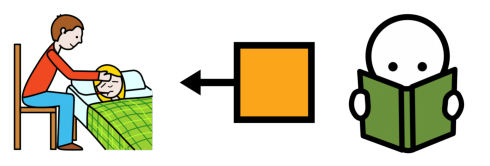

Oracion: pict_5441_yo_quiero pict_28727_lanzar_un_dardo
2
Procesando: ./imagenes_procesadas/pict_5441.png
Procesando: ./imagenes_procesadas/pict_28727.png


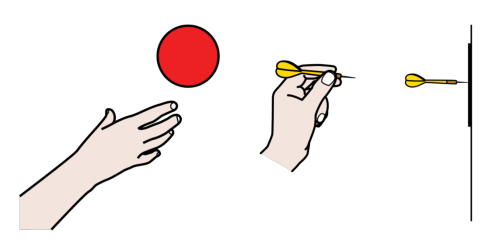

Prediction pict_5526_no pict_7271_tener pict_35653_organizar pict_8474_un dardo
5
['./imagenes_procesadas/pict_5526.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_35653.png', './imagenes_procesadas/pict_8474.png', 'dardo']
Procesando: ./imagenes_procesadas/pict_5526.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_35653.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: dardo


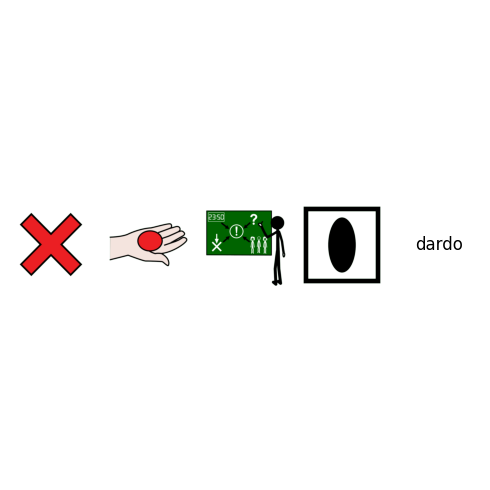

Oracion: pict_32771_qué_es? pict_2986_arco_iris
2
Procesando: ./imagenes_procesadas/pict_32771.png
Procesando: ./imagenes_procesadas/pict_2986.png


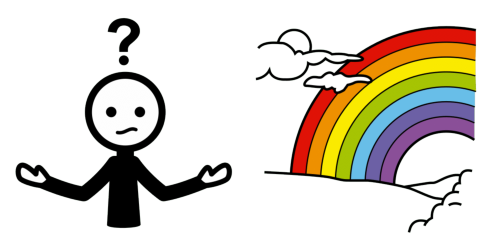

Prediction pict_22624_qué pict_5581_ser pict_8474_un pict_2248_agua iris
5
['./imagenes_procesadas/pict_22624.png', './imagenes_procesadas/pict_5581.png', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_2248.png', 'iris']
Procesando: ./imagenes_procesadas/pict_22624.png
Procesando: ./imagenes_procesadas/pict_5581.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_2248.png
Procesando: iris


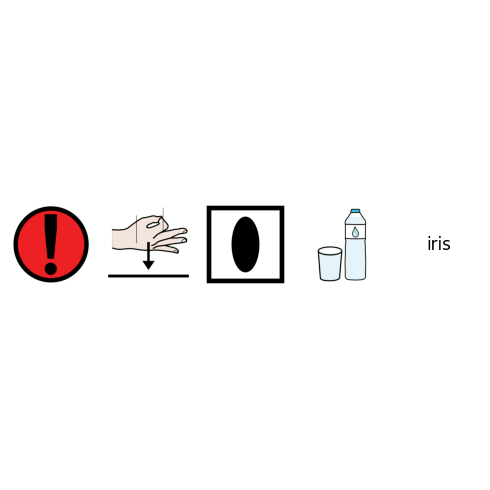

Oracion: pict_6190_preparar pict_29195_pollo_con_papas
2
Procesando: ./imagenes_procesadas/pict_6190.png
Procesando: ./imagenes_procesadas/pict_29195.png


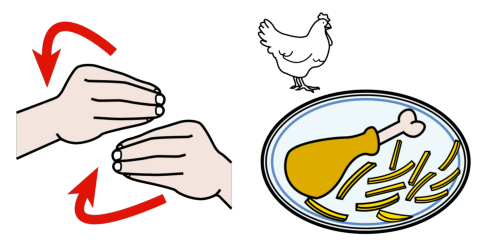

Prediction pict_35653_organizar pict_11572_plantas pict_7064_con pict_2248_agua
4
['./imagenes_procesadas/pict_35653.png', './imagenes_procesadas/pict_11572.png', './imagenes_procesadas/pict_7064.png', './imagenes_procesadas/pict_2248.png']
Procesando: ./imagenes_procesadas/pict_35653.png
Procesando: ./imagenes_procesadas/pict_11572.png
Procesando: ./imagenes_procesadas/pict_7064.png
Procesando: ./imagenes_procesadas/pict_2248.png


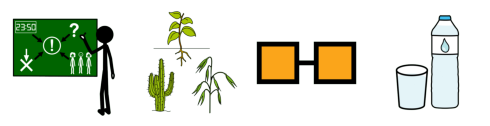

Oracion: pict_7074_de pict_22620_qué pict_11176_alimentar
3
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_22620.png
Procesando: ./imagenes_procesadas/pict_11176.png


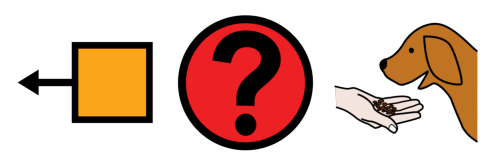

Prediction pict_3415_¿ pict_7074_de pict_22624_qué pict_6481_se pict_11691_cuidar pict_3418_?
6
['./imagenes_procesadas/pict_3415.png', './imagenes_procesadas/pict_7074.png', './imagenes_procesadas/pict_22624.png', './imagenes_procesadas/pict_6481.png', './imagenes_procesadas/pict_11691.png', './imagenes_procesadas/pict_3418.png']
Procesando: ./imagenes_procesadas/pict_3415.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_22624.png
Procesando: ./imagenes_procesadas/pict_6481.png
Procesando: ./imagenes_procesadas/pict_11691.png
Procesando: ./imagenes_procesadas/pict_3418.png


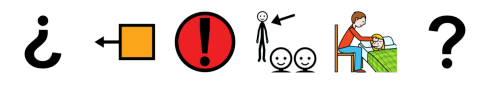

Oracion: pict_2617_yo pict_7180_yo_no_sé pict_32015_cantar
3
Procesando: ./imagenes_procesadas/pict_2617.png
Procesando: ./imagenes_procesadas/pict_7180.png
Procesando: ./imagenes_procesadas/pict_32015.png


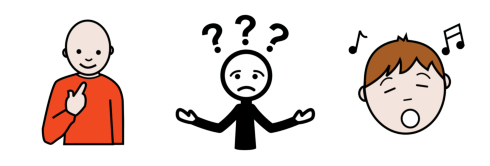

Prediction pict_7141_leer pict_5526_no pict_11749_hacer pict_35653_organizar
4
['./imagenes_procesadas/pict_7141.png', './imagenes_procesadas/pict_5526.png', './imagenes_procesadas/pict_11749.png', './imagenes_procesadas/pict_35653.png']
Procesando: ./imagenes_procesadas/pict_7141.png
Procesando: ./imagenes_procesadas/pict_5526.png
Procesando: ./imagenes_procesadas/pict_11749.png
Procesando: ./imagenes_procesadas/pict_35653.png


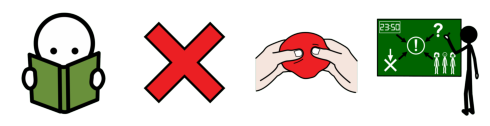

Oracion: pict_4772_visitar pict_8476_el pict_2823_pueblo pict_7074_de pict_8476_la pict_38527_quinua
6
Procesando: ./imagenes_procesadas/pict_4772.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_2823.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_38527.png


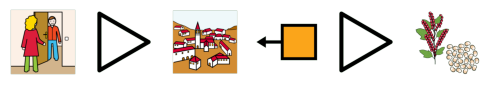

Prediction pict_3415_¿ pict_9030_responder pict_8476_el pict_9819_lugar pict_7074_de pict_7029_la pict_22769_artesanía pict_3418_?
8
['./imagenes_procesadas/pict_3415.png', './imagenes_procesadas/pict_9030.png', './imagenes_procesadas/pict_8476.png', './imagenes_procesadas/pict_9819.png', './imagenes_procesadas/pict_7074.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_22769.png', './imagenes_procesadas/pict_3418.png']
Procesando: ./imagenes_procesadas/pict_3415.png
Procesando: ./imagenes_procesadas/pict_9030.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_9819.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_22769.png
Procesando: ./imagenes_procesadas/pict_3418.png


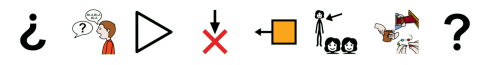

Oracion: pict_5515_mezclar pict_8476_la pict_4870_pintura
3
Procesando: ./imagenes_procesadas/pict_5515.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_4870.png


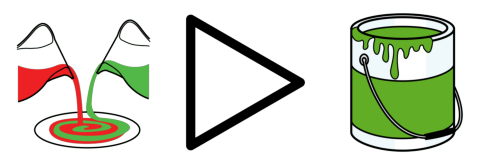

Prediction pict_11691_cuidar pict_7029_la pict_9870_exposición
3
['./imagenes_procesadas/pict_11691.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_9870.png']
Procesando: ./imagenes_procesadas/pict_11691.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_9870.png


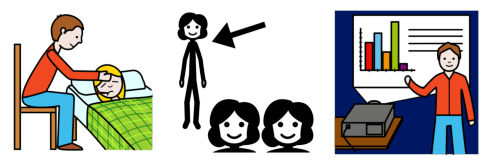

Oracion: pict_8579_explicar pict_22619_cómo pict_37038_funcionar
3
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_22619.png
Procesando: ./imagenes_procesadas/pict_37038.png


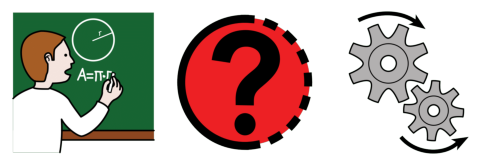

Prediction pict_2380_escribir pict_22619_cómo pict_7271_tener
3
['./imagenes_procesadas/pict_2380.png', './imagenes_procesadas/pict_22619.png', './imagenes_procesadas/pict_7271.png']
Procesando: ./imagenes_procesadas/pict_2380.png
Procesando: ./imagenes_procesadas/pict_22619.png
Procesando: ./imagenes_procesadas/pict_7271.png


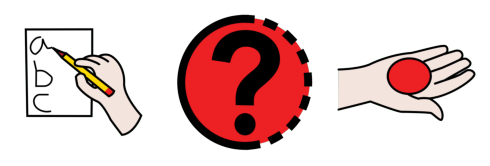

Oracion: 11619#¿lo ves?# pict_31888_difícil
3
Procesando: 11619#¿lo
Procesando: ves?#
Procesando: ./imagenes_procesadas/pict_31888.png


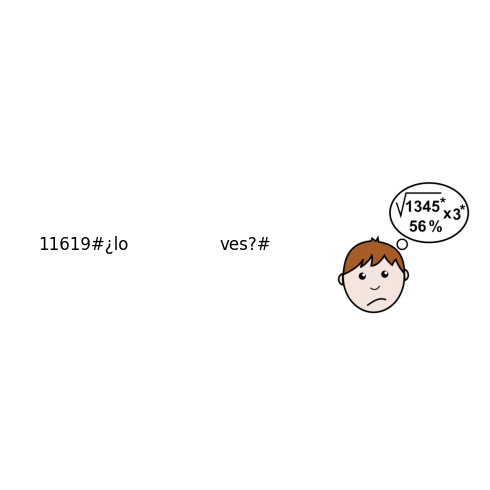

Prediction pict_3415_¿ pict_6481_lo pict_11749_hacer pict_11470_importante pict_3418_?
5
['./imagenes_procesadas/pict_3415.png', './imagenes_procesadas/pict_6481.png', './imagenes_procesadas/pict_11749.png', './imagenes_procesadas/pict_11470.png', './imagenes_procesadas/pict_3418.png']
Procesando: ./imagenes_procesadas/pict_3415.png
Procesando: ./imagenes_procesadas/pict_6481.png
Procesando: ./imagenes_procesadas/pict_11749.png
Procesando: ./imagenes_procesadas/pict_11470.png
Procesando: ./imagenes_procesadas/pict_3418.png


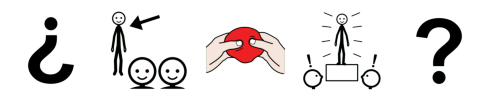

Oracion: pict_28643_leer pict_8476_la pict_38145_introducción
3
Procesando: ./imagenes_procesadas/pict_28643.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_38145.png


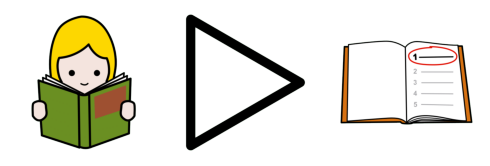

Prediction pict_7141_leer pict_7029_la pict_11238_dibujo
3
['./imagenes_procesadas/pict_7141.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_11238.png']
Procesando: ./imagenes_procesadas/pict_7141.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_11238.png


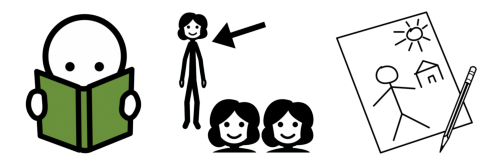

Oracion: pict_38817_adolescentes pict_31859_negar pict_6537_jugar pict_26238_muñeca
4
Procesando: ./imagenes_procesadas/pict_38817.png
Procesando: ./imagenes_procesadas/pict_31859.png
Procesando: ./imagenes_procesadas/pict_6537.png
Procesando: ./imagenes_procesadas/pict_26238.png


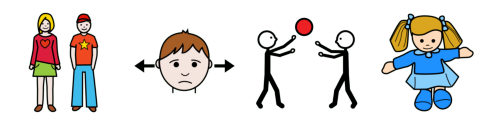

Prediction pict_7033_los pict_35477_paso pict_5526_no pict_35653_organizar pict_7064_con pict_22769_artesanía
6
['./imagenes_procesadas/pict_7033.png', './imagenes_procesadas/pict_35477.png', './imagenes_procesadas/pict_5526.png', './imagenes_procesadas/pict_35653.png', './imagenes_procesadas/pict_7064.png', './imagenes_procesadas/pict_22769.png']
Procesando: ./imagenes_procesadas/pict_7033.png
Procesando: ./imagenes_procesadas/pict_35477.png
Procesando: ./imagenes_procesadas/pict_5526.png
Procesando: ./imagenes_procesadas/pict_35653.png
Procesando: ./imagenes_procesadas/pict_7064.png
Procesando: ./imagenes_procesadas/pict_22769.png


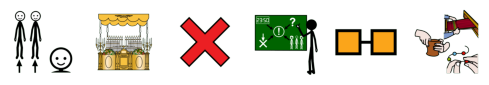

Oracion: pict_2617_yo pict_5441_quiero pict_36544_hablar
3
Procesando: ./imagenes_procesadas/pict_2617.png
Procesando: ./imagenes_procesadas/pict_5441.png
Procesando: ./imagenes_procesadas/pict_36544.png


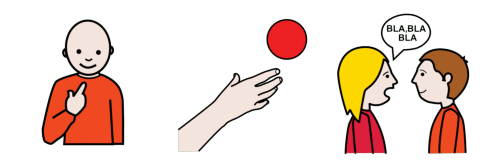

Prediction pict_15485_usar pict_7271_tener pict_3345_hablar
3
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_3345.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_3345.png


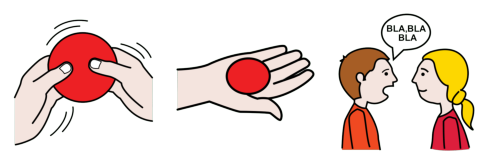

Oracion: pict_8476_la pict_7104_flor pict_23991_crecer pict_5306_rápido
4
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_7104.png
Procesando: ./imagenes_procesadas/pict_23991.png
Procesando: ./imagenes_procesadas/pict_5306.png


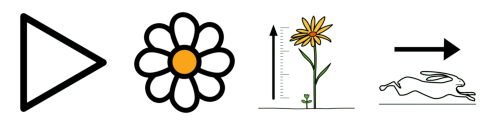

Prediction pict_7029_la pict_2248_agua pict_7271_tener pict_4604_claro
4
['./imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_2248.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_4604.png']
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_2248.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_4604.png


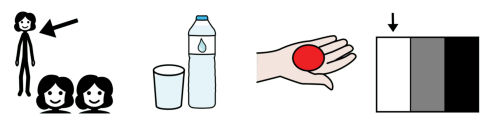

Oracion: pict_35060_padres pict_12283_tus pict_15994_cuidadores
3
Procesando: ./imagenes_procesadas/pict_35060.png
Procesando: ./imagenes_procesadas/pict_12283.png
Procesando: ./imagenes_procesadas/pict_15994.png


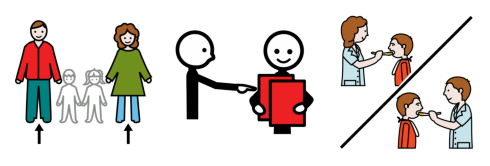

Prediction pict_4604_claro pict_5581_ser pict_12281_tu pict_35477_paso
4
['./imagenes_procesadas/pict_4604.png', './imagenes_procesadas/pict_5581.png', './imagenes_procesadas/pict_12281.png', './imagenes_procesadas/pict_35477.png']
Procesando: ./imagenes_procesadas/pict_4604.png
Procesando: ./imagenes_procesadas/pict_5581.png
Procesando: ./imagenes_procesadas/pict_12281.png
Procesando: ./imagenes_procesadas/pict_35477.png


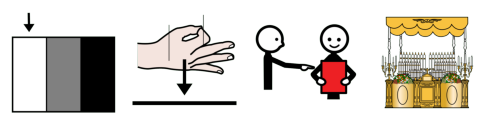

Oracion: pict_2474_observar pict_8474_una pict_7224_rama
3
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_7224.png


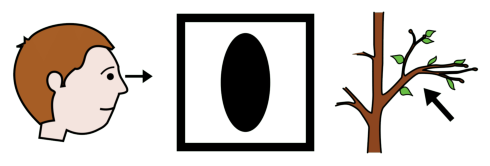

Prediction pict_15485_usar pict_8474_una pict_11572_plantas
3
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_11572.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_11572.png


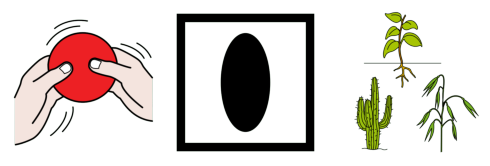

Oracion: pict_31382_crujirse_los_dedos
1
Procesando: ./imagenes_procesadas/pict_31382.png


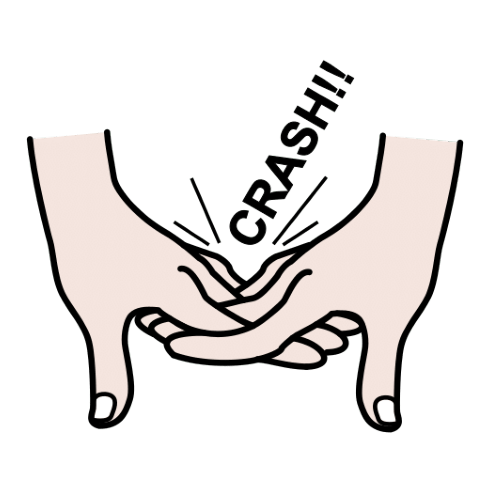

Prediction pict_3414_¡ pict_7033_los pict_4604_claro
3
['./imagenes_procesadas/pict_3414.png', './imagenes_procesadas/pict_7033.png', './imagenes_procesadas/pict_4604.png']
Procesando: ./imagenes_procesadas/pict_3414.png
Procesando: ./imagenes_procesadas/pict_7033.png
Procesando: ./imagenes_procesadas/pict_4604.png


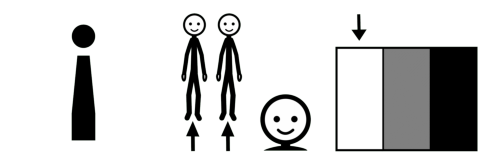

Oracion: pict_32872_¿dónde_está? pict_8476_la pict_3118_iglesia
3
Procesando: ./imagenes_procesadas/pict_32872.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_3118.png


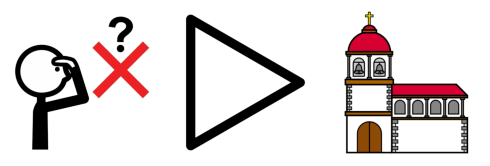

Prediction pict_22619_cómo pict_5581_ser pict_7029_la pict_2248_agua
4
['./imagenes_procesadas/pict_22619.png', './imagenes_procesadas/pict_5581.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_2248.png']
Procesando: ./imagenes_procesadas/pict_22619.png
Procesando: ./imagenes_procesadas/pict_5581.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_2248.png


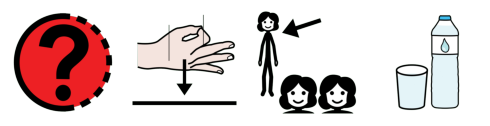

Oracion: pict_3082_escuela pict_2456_maestra pict_9844_preguntar pict_7199_peces
4
Procesando: ./imagenes_procesadas/pict_3082.png
Procesando: ./imagenes_procesadas/pict_2456.png
Procesando: ./imagenes_procesadas/pict_9844.png
Procesando: ./imagenes_procesadas/pict_7199.png


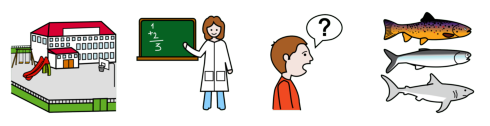

Prediction pict_7034_en pict_7029_la pict_9819_lugar pict_3189_, pict_7029_la pict_35477_paso pict_7217_pregunta pict_7814_sobre pict_7033_los pict_2248_agua
10
['./imagenes_procesadas/pict_7034.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_9819.png', './imagenes_procesadas/pict_3189.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_35477.png', './imagenes_procesadas/pict_7217.png', './imagenes_procesadas/pict_7814.png', './imagenes_procesadas/pict_7033.png', './imagenes_procesadas/pict_2248.png']
Procesando: ./imagenes_procesadas/pict_7034.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_9819.png
Procesando: ./imagenes_procesadas/pict_3189.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_35477.png
Procesando: ./imagenes_procesadas/pict_7217.png
Procesando: ./imagenes_procesadas/pict_7814.png
Procesando: ./imagenes_procesadas/pict_7033.png
Procesando: ./

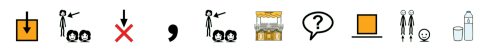

Oracion: pict_8476_la pict_2456_maestra pict_6998_corregir pict_8477_los pict_38462_exámen
5
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_2456.png
Procesando: ./imagenes_procesadas/pict_6998.png
Procesando: ./imagenes_procesadas/pict_8477.png
Procesando: ./imagenes_procesadas/pict_38462.png


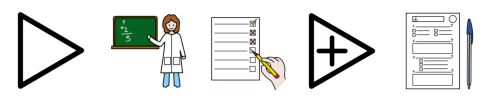

Prediction pict_7029_la pict_35477_paso pict_2474_observar pict_7033_los pict_9870_exposición
5
['./imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_35477.png', './imagenes_procesadas/pict_2474.png', './imagenes_procesadas/pict_7033.png', './imagenes_procesadas/pict_9870.png']
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_35477.png
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_7033.png
Procesando: ./imagenes_procesadas/pict_9870.png


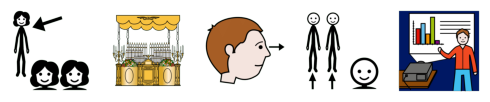

Oracion: pict_21514_carta_certificada
1
Procesando: ./imagenes_procesadas/pict_21514.png


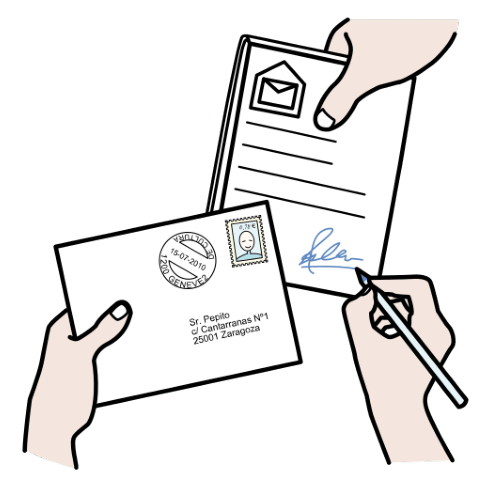

Prediction pict_9897_información certificada
2
['./imagenes_procesadas/pict_9897.png', 'certificada']
Procesando: ./imagenes_procesadas/pict_9897.png
Procesando: certificada


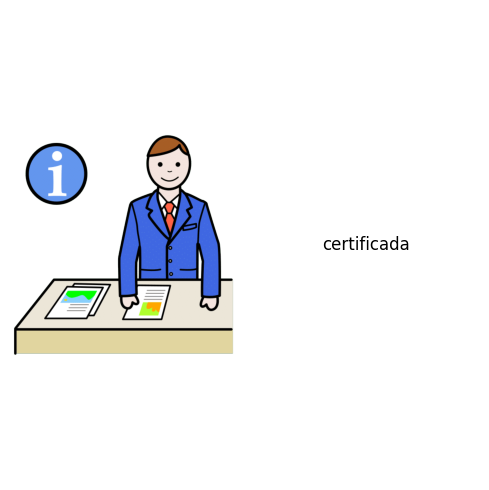

Oracion: pict_11238_dibujo pict_8474_un pict_7176_niño
3
Procesando: ./imagenes_procesadas/pict_11238.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_7176.png


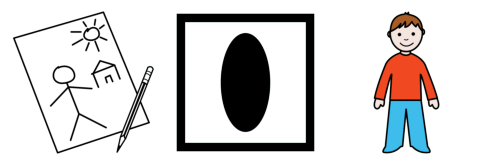

Prediction pict_2380_escribir pict_8474_un pict_9819_lugar
3
['./imagenes_procesadas/pict_2380.png', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_9819.png']
Procesando: ./imagenes_procesadas/pict_2380.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_9819.png


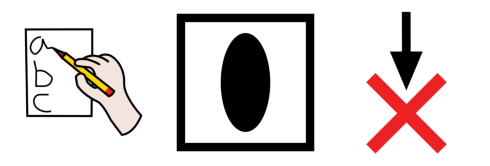

Oracion: pict_2381_oír pict_2456_maestra
2
Procesando: ./imagenes_procesadas/pict_2381.png
Procesando: ./imagenes_procesadas/pict_2456.png


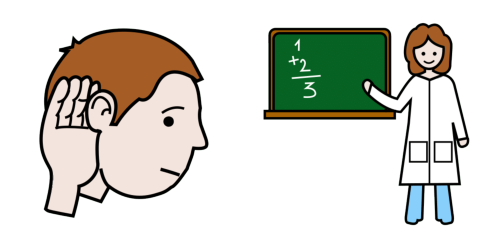

Prediction pict_3345_hablar pict_3021_a pict_7029_la pict_4649_feria
4
['./imagenes_procesadas/pict_3345.png', './imagenes_procesadas/pict_3021.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_4649.png']
Procesando: ./imagenes_procesadas/pict_3345.png
Procesando: ./imagenes_procesadas/pict_3021.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_4649.png


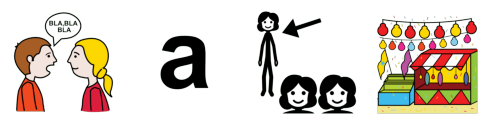

Oracion: pict_2811_río pict_11399_y pict_2925_mar
3
Procesando: ./imagenes_procesadas/pict_2811.png
Procesando: ./imagenes_procesadas/pict_11399.png
Procesando: ./imagenes_procesadas/pict_2925.png


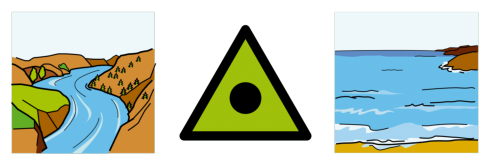

Prediction pict_2248_agua pict_3047_y pict_2248_agua
3
['./imagenes_procesadas/pict_2248.png', './imagenes_procesadas/pict_3047.png', './imagenes_procesadas/pict_2248.png']
Procesando: ./imagenes_procesadas/pict_2248.png
Procesando: ./imagenes_procesadas/pict_3047.png
Procesando: ./imagenes_procesadas/pict_2248.png


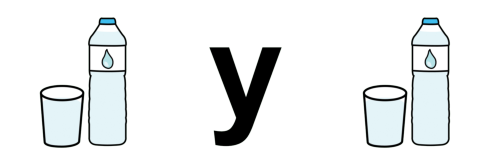

Oracion: pict_36720_respetar pict_8477_las pict_11473_ley
3
Procesando: ./imagenes_procesadas/pict_36720.png
Procesando: ./imagenes_procesadas/pict_8477.png
Procesando: ./imagenes_procesadas/pict_11473.png


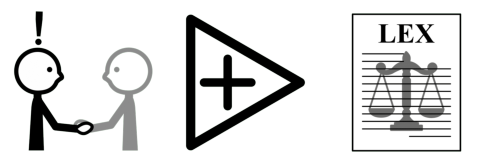

Prediction pict_11691_cuidar pict_7031_las leyes
3
['./imagenes_procesadas/pict_11691.png', './imagenes_procesadas/pict_7031.png', 'leyes']
Procesando: ./imagenes_procesadas/pict_11691.png
Procesando: ./imagenes_procesadas/pict_7031.png
Procesando: leyes


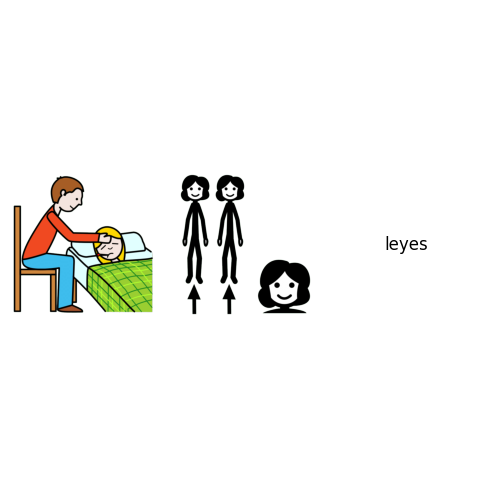

Oracion: pict_2381_escuchar pict_7064_con pict_24863_atención pict_8476_el pict_6470_cuento
5
Procesando: ./imagenes_procesadas/pict_2381.png
Procesando: ./imagenes_procesadas/pict_7064.png
Procesando: ./imagenes_procesadas/pict_24863.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_6470.png


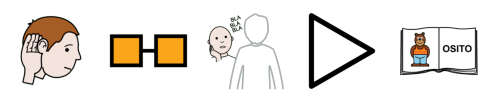

Prediction pict_2380_escribir pict_7064_con pict_7217_pregunta pict_8476_el pict_7217_pregunta
5
['./imagenes_procesadas/pict_2380.png', './imagenes_procesadas/pict_7064.png', './imagenes_procesadas/pict_7217.png', './imagenes_procesadas/pict_8476.png', './imagenes_procesadas/pict_7217.png']
Procesando: ./imagenes_procesadas/pict_2380.png
Procesando: ./imagenes_procesadas/pict_7064.png
Procesando: ./imagenes_procesadas/pict_7217.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_7217.png


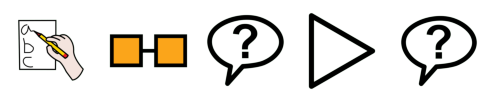

Oracion: pict_31807_yo pict_5441_quiero pict_11475_participar
3
Procesando: ./imagenes_procesadas/pict_31807.png
Procesando: ./imagenes_procesadas/pict_5441.png
Procesando: ./imagenes_procesadas/pict_11475.png


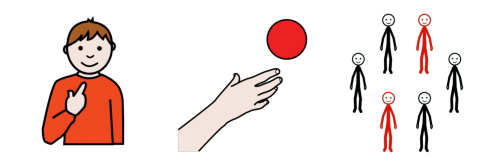

Prediction pict_5526_no pict_7271_tener pict_8029_aprender
3
['./imagenes_procesadas/pict_5526.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_8029.png']
Procesando: ./imagenes_procesadas/pict_5526.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_8029.png


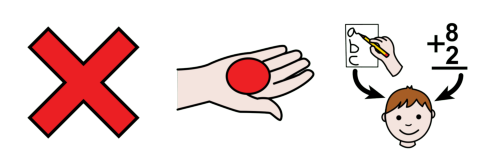

Oracion: pict_31807_yo pict_11238_dibujo pict_38613_planta
3
Procesando: ./imagenes_procesadas/pict_31807.png
Procesando: ./imagenes_procesadas/pict_11238.png
Procesando: ./imagenes_procesadas/pict_38613.png


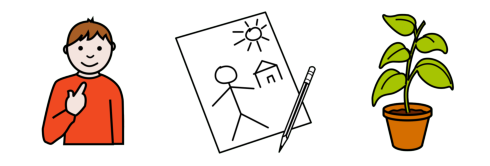

Prediction pict_15485_usar pict_2380_escribir pict_8474_una pict_9819_lugar
4
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_2380.png', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_9819.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_2380.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_9819.png


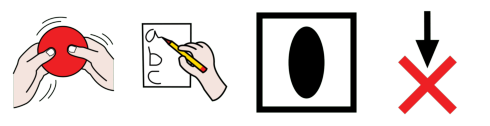

Oracion: pict_6156_yo_no_quiero pict_11475_participar
2
Procesando: ./imagenes_procesadas/pict_6156.png
Procesando: ./imagenes_procesadas/pict_11475.png


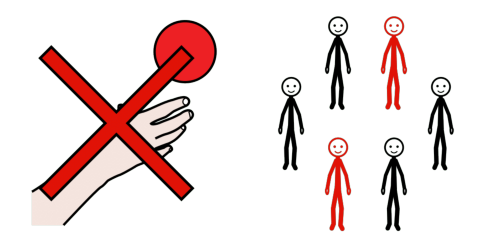

Prediction pict_3415_¿ pict_5526_no pict_5526_no pict_7271_tener pict_8029_aprender pict_3418_?
6
['./imagenes_procesadas/pict_3415.png', './imagenes_procesadas/pict_5526.png', './imagenes_procesadas/pict_5526.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_8029.png', './imagenes_procesadas/pict_3418.png']
Procesando: ./imagenes_procesadas/pict_3415.png
Procesando: ./imagenes_procesadas/pict_5526.png
Procesando: ./imagenes_procesadas/pict_5526.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_8029.png
Procesando: ./imagenes_procesadas/pict_3418.png


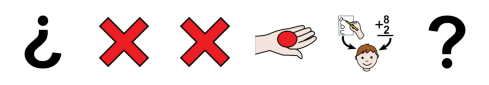

Oracion: pict_2381_escuchar pict_7064_con pict_24863_atención
3
Procesando: ./imagenes_procesadas/pict_2381.png
Procesando: ./imagenes_procesadas/pict_7064.png
Procesando: ./imagenes_procesadas/pict_24863.png


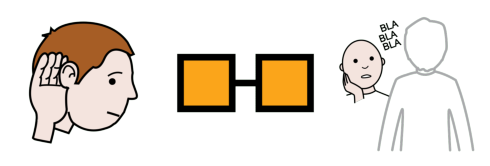

Prediction pict_3345_hablar pict_7064_con pict_7217_pregunta
3
['./imagenes_procesadas/pict_3345.png', './imagenes_procesadas/pict_7064.png', './imagenes_procesadas/pict_7217.png']
Procesando: ./imagenes_procesadas/pict_3345.png
Procesando: ./imagenes_procesadas/pict_7064.png
Procesando: ./imagenes_procesadas/pict_7217.png


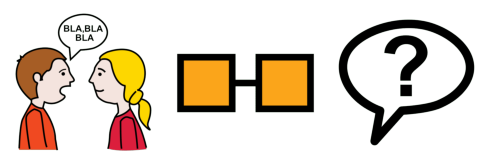

Oracion: pict_8476_el pict_38079_cultivo pict_36392_estar pict_32820_estoy_listo
4
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_38079.png
Procesando: ./imagenes_procesadas/pict_36392.png
Procesando: ./imagenes_procesadas/pict_32820.png


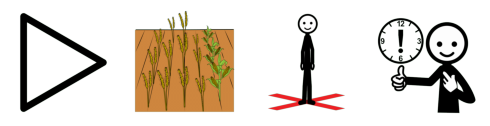

Prediction pict_8476_el pict_8185_Perú pict_5581_ser pict_4604_claro
4
['./imagenes_procesadas/pict_8476.png', './imagenes_procesadas/pict_8185.png', './imagenes_procesadas/pict_5581.png', './imagenes_procesadas/pict_4604.png']
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_8185.png
Procesando: ./imagenes_procesadas/pict_5581.png
Procesando: ./imagenes_procesadas/pict_4604.png


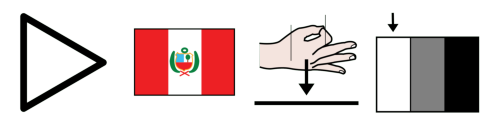

Oracion: pict_34341_negar pict_8107_escribir pict_2860_pared
3
Procesando: ./imagenes_procesadas/pict_34341.png
Procesando: ./imagenes_procesadas/pict_8107.png
Procesando: ./imagenes_procesadas/pict_2860.png


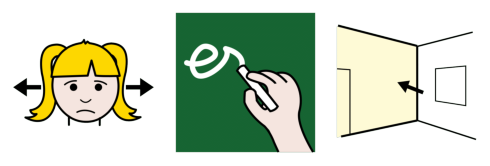

Prediction pict_5526_no pict_2380_escribir pict_7034_en pict_7029_la pict_4649_feria
5
['./imagenes_procesadas/pict_5526.png', './imagenes_procesadas/pict_2380.png', './imagenes_procesadas/pict_7034.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_4649.png']
Procesando: ./imagenes_procesadas/pict_5526.png
Procesando: ./imagenes_procesadas/pict_2380.png
Procesando: ./imagenes_procesadas/pict_7034.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_4649.png


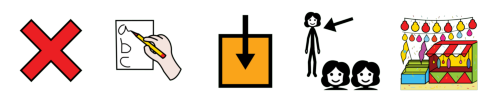

Oracion: pict_37143_descorrer_la_cortina
1
Procesando: ./imagenes_procesadas/pict_37143.png


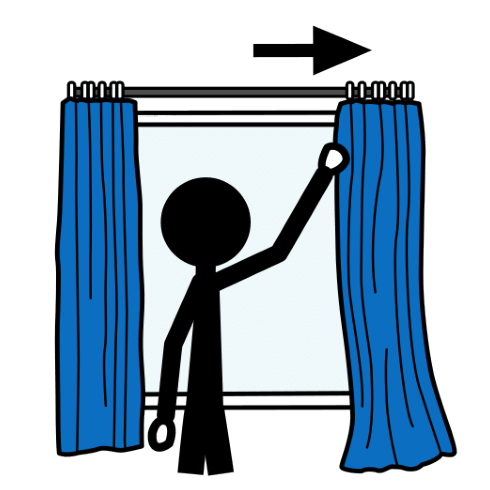

Prediction descorrer pict_7029_la pict_35477_paso
3
['descorrer', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_35477.png']
Procesando: descorrer
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_35477.png


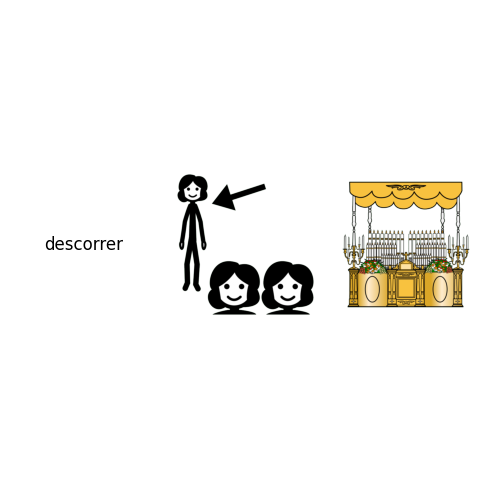

Oracion: pict_36081_todos pict_38580_reciclado_de_papel
2
Procesando: ./imagenes_procesadas/pict_36081.png
Procesando: ./imagenes_procesadas/pict_38580.png


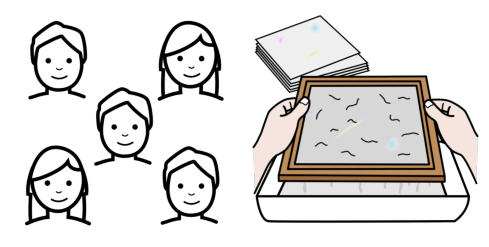

Prediction pict_7033_los reciclamos pict_8476_el pict_9819_lugar
4
['./imagenes_procesadas/pict_7033.png', 'reciclamos', './imagenes_procesadas/pict_8476.png', './imagenes_procesadas/pict_9819.png']
Procesando: ./imagenes_procesadas/pict_7033.png
Procesando: reciclamos
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_9819.png


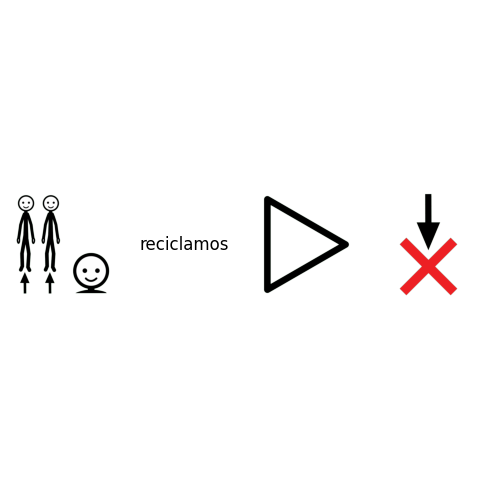

Oracion: pict_32598_lugares pict_7194_para pict_31839_pasear
3
Procesando: ./imagenes_procesadas/pict_32598.png
Procesando: ./imagenes_procesadas/pict_7194.png
Procesando: ./imagenes_procesadas/pict_31839.png


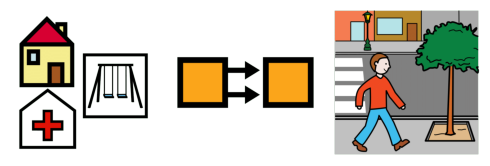

Prediction pict_9819_lugar pict_7194_para pict_11691_cuidar
3
['./imagenes_procesadas/pict_9819.png', './imagenes_procesadas/pict_7194.png', './imagenes_procesadas/pict_11691.png']
Procesando: ./imagenes_procesadas/pict_9819.png
Procesando: ./imagenes_procesadas/pict_7194.png
Procesando: ./imagenes_procesadas/pict_11691.png


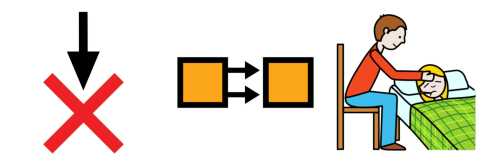

Oracion: pict_2474_mirar pict_8477_las pict_8229_noticias
3
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_8477.png
Procesando: ./imagenes_procesadas/pict_8229.png


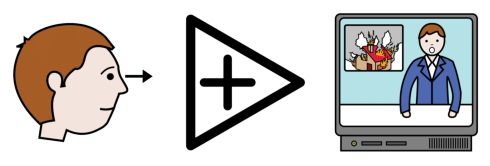

Prediction pict_8579_explicar pict_7031_las pict_7217_pregunta
3
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_7031.png', './imagenes_procesadas/pict_7217.png']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_7031.png
Procesando: ./imagenes_procesadas/pict_7217.png


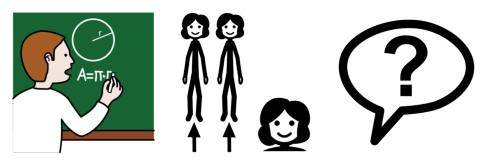

Oracion: pict_2474_observar pict_8477_las pict_39101_plantas_aromáticas
3
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_8477.png
Procesando: ./imagenes_procesadas/pict_39101.png


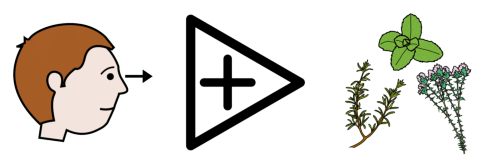

Prediction pict_8579_explicar pict_7031_las pict_11572_plantas
3
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_7031.png', './imagenes_procesadas/pict_11572.png']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_7031.png
Procesando: ./imagenes_procesadas/pict_11572.png


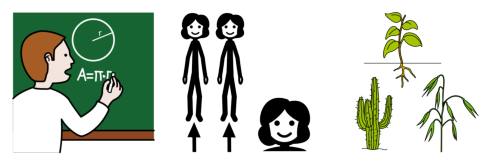

Oracion: pict_6517_hablar pict_7064_con pict_32584_adjetivos
3
Procesando: ./imagenes_procesadas/pict_6517.png
Procesando: ./imagenes_procesadas/pict_7064.png
Procesando: ./imagenes_procesadas/pict_32584.png


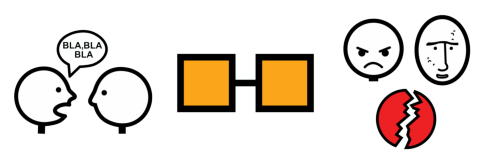

Prediction pict_3345_hablar pict_7064_con pict_7217_pregunta
3
['./imagenes_procesadas/pict_3345.png', './imagenes_procesadas/pict_7064.png', './imagenes_procesadas/pict_7217.png']
Procesando: ./imagenes_procesadas/pict_3345.png
Procesando: ./imagenes_procesadas/pict_7064.png
Procesando: ./imagenes_procesadas/pict_7217.png


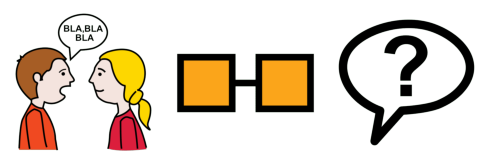

Oracion: pict_24783_público pict_24863_atención
2
Procesando: ./imagenes_procesadas/pict_24783.png
Procesando: ./imagenes_procesadas/pict_24863.png


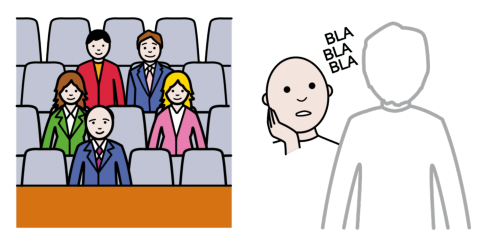

Prediction pict_9819_lugar atento
2
['./imagenes_procesadas/pict_9819.png', 'atento']
Procesando: ./imagenes_procesadas/pict_9819.png
Procesando: atento


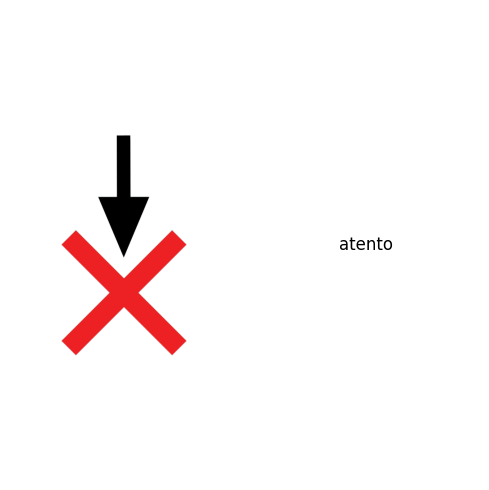

Oracion: pict_4556_ahorrar pict_4630_dinero
2
Procesando: ./imagenes_procesadas/pict_4556.png
Procesando: ./imagenes_procesadas/pict_4630.png


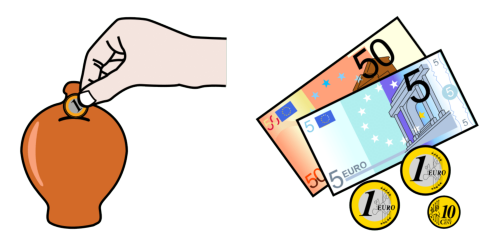

Prediction pict_11691_cuidar pict_2248_agua
2
['./imagenes_procesadas/pict_11691.png', './imagenes_procesadas/pict_2248.png']
Procesando: ./imagenes_procesadas/pict_11691.png
Procesando: ./imagenes_procesadas/pict_2248.png


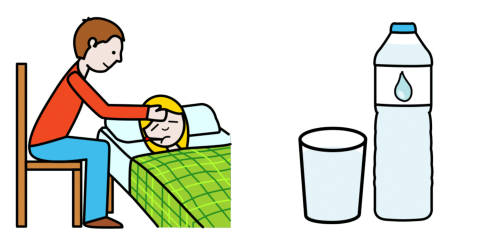

Oracion: pict_38809_proteger pict_8476_el pict_20389_medio_ambiente
3
Procesando: ./imagenes_procesadas/pict_38809.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_20389.png


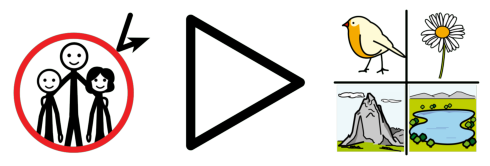

Prediction pict_11691_cuidar pict_8476_el pict_2248_agua
3
['./imagenes_procesadas/pict_11691.png', './imagenes_procesadas/pict_8476.png', './imagenes_procesadas/pict_2248.png']
Procesando: ./imagenes_procesadas/pict_11691.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_2248.png


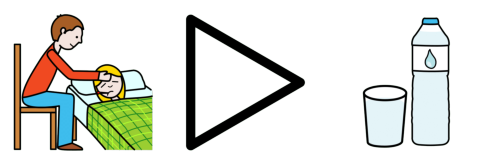

Oracion: pict_2474_observar pict_28301_subtítulo
2
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_28301.png


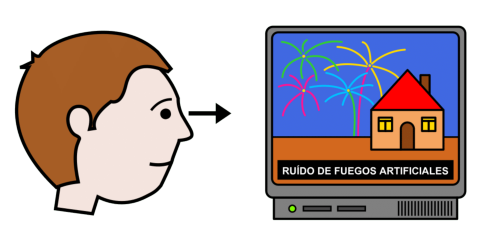

Prediction pict_8579_explicar pict_7033_los pict_11238_dibujo
3
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_7033.png', './imagenes_procesadas/pict_11238.png']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_7033.png
Procesando: ./imagenes_procesadas/pict_11238.png


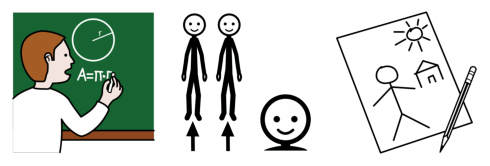

Oracion: pict_5436_1/4 pict_7074_de pict_7138_kilogramo pict_25898_calcio
4
Procesando: ./imagenes_procesadas/pict_5436.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_7138.png
Procesando: ./imagenes_procesadas/pict_25898.png


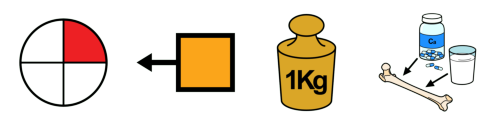

Prediction 1⁄4 pict_7074_de kilo pict_7074_de calcio
5
['1⁄4', './imagenes_procesadas/pict_7074.png', 'kilo', './imagenes_procesadas/pict_7074.png', 'calcio']
Procesando: 1⁄4
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: kilo
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: calcio


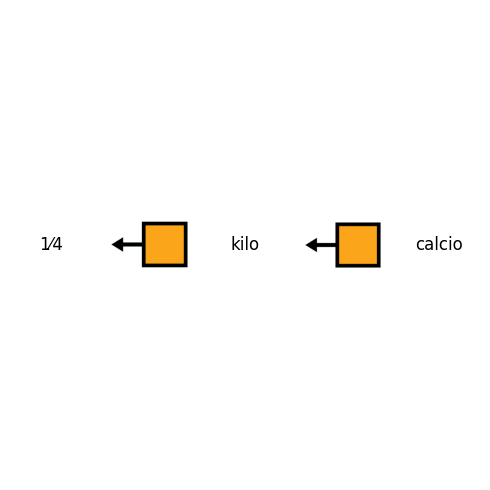

Oracion: pict_25082_estar_sentado
1
Procesando: ./imagenes_procesadas/pict_25082.png


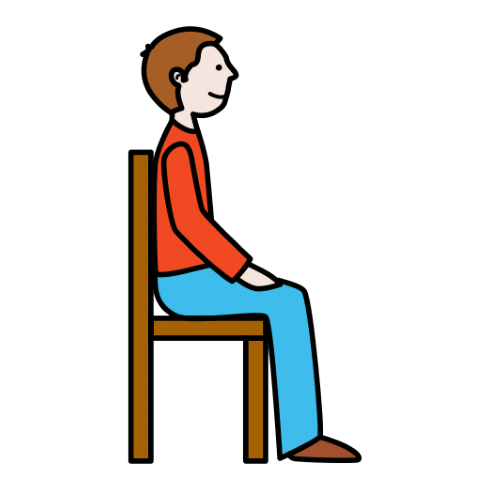

Prediction pict_7271_tener pict_35477_paso
2
['./imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_35477.png']
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_35477.png


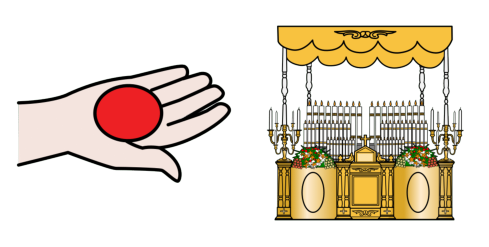

Oracion: pict_39101_plantas_aromáticas
1
Procesando: ./imagenes_procesadas/pict_39101.png


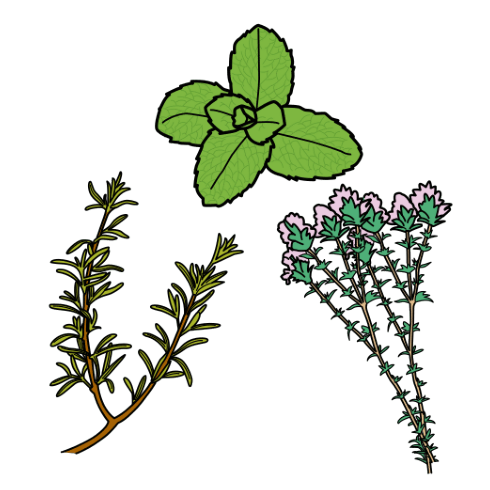

Prediction pict_11572_plantas aromáticas
2
['./imagenes_procesadas/pict_11572.png', 'aromáticas']
Procesando: ./imagenes_procesadas/pict_11572.png
Procesando: aromáticas


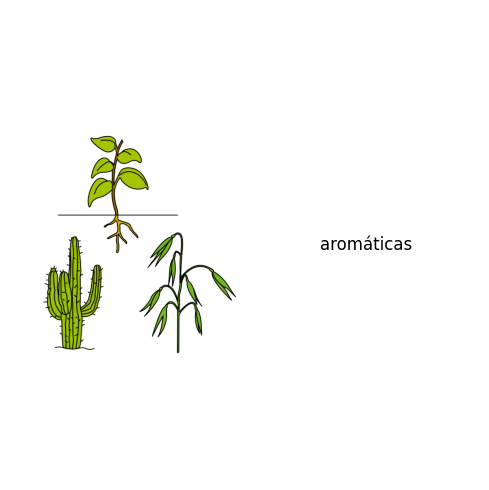

Oracion: pict_5441_yo_quiero pict_6052_bailar pict_2255_amigos
3
Procesando: ./imagenes_procesadas/pict_5441.png
Procesando: ./imagenes_procesadas/pict_6052.png
Procesando: ./imagenes_procesadas/pict_2255.png


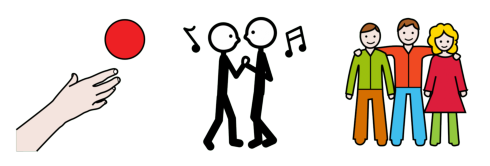

Prediction pict_15485_usar pict_7271_tener pict_11691_cuidar pict_7064_con pict_12281_tu pict_7217_pregunta
6
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_11691.png', './imagenes_procesadas/pict_7064.png', './imagenes_procesadas/pict_12281.png', './imagenes_procesadas/pict_7217.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_11691.png
Procesando: ./imagenes_procesadas/pict_7064.png
Procesando: ./imagenes_procesadas/pict_12281.png
Procesando: ./imagenes_procesadas/pict_7217.png


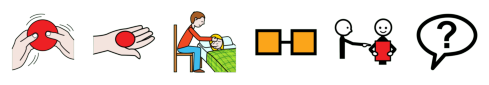

Oracion: pict_8476_la pict_6993_conocer
2
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_6993.png


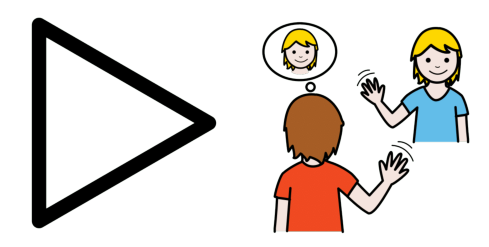

Prediction pict_3415_¿ pict_7029_la pict_7271_tener pict_3345_hablar pict_3418_?
5
['./imagenes_procesadas/pict_3415.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_3345.png', './imagenes_procesadas/pict_3418.png']
Procesando: ./imagenes_procesadas/pict_3415.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_3345.png
Procesando: ./imagenes_procesadas/pict_3418.png


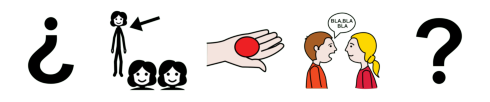

Oracion: pict_25654_mascota
1
Procesando: ./imagenes_procesadas/pict_25654.png


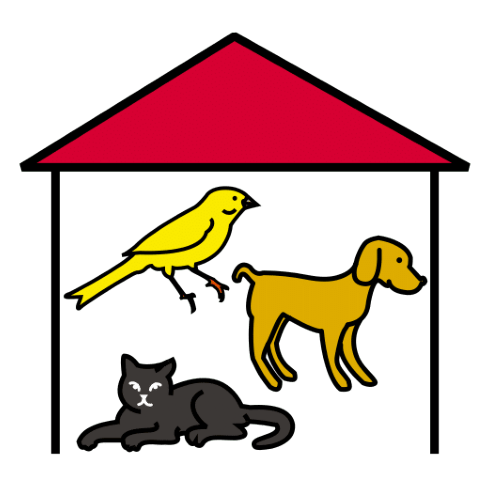

Prediction pict_22769_artesanía
1
['./imagenes_procesadas/pict_22769.png']
Procesando: ./imagenes_procesadas/pict_22769.png


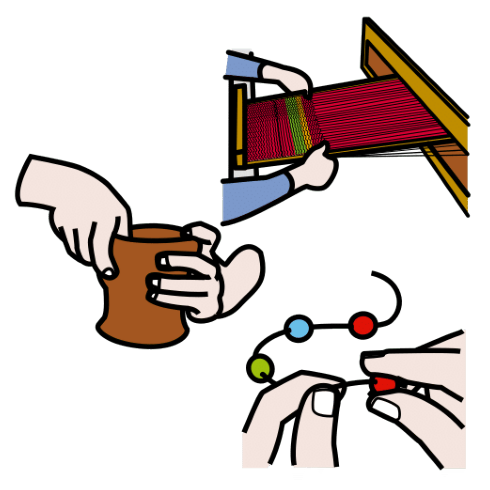

Oracion: pict_32800_fiestas pict_22627_importante
2
Procesando: ./imagenes_procesadas/pict_32800.png
Procesando: ./imagenes_procesadas/pict_22627.png


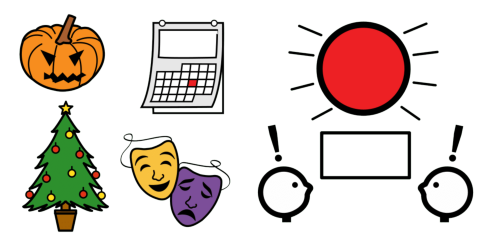

Prediction festividades pict_11470_importante
2
['festividades', './imagenes_procesadas/pict_11470.png']
Procesando: festividades
Procesando: ./imagenes_procesadas/pict_11470.png


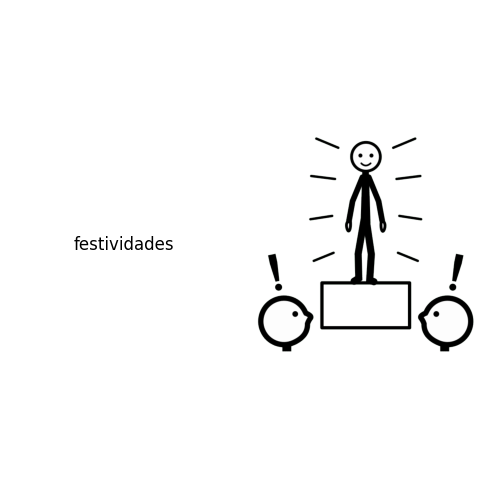

Oracion: pict_11749_hacer pict_8474_un pict_3149_regalo
3
Procesando: ./imagenes_procesadas/pict_11749.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_3149.png


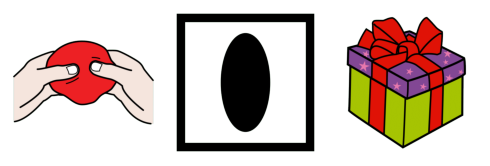

Prediction pict_11749_hacer pict_8474_un pict_35477_paso
3
['./imagenes_procesadas/pict_11749.png', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_35477.png']
Procesando: ./imagenes_procesadas/pict_11749.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_35477.png


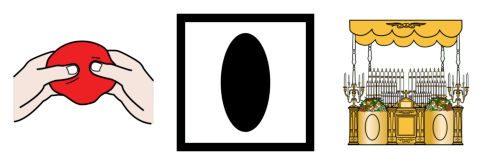

Oracion: pict_11194_hermoso
1
Procesando: ./imagenes_procesadas/pict_11194.png


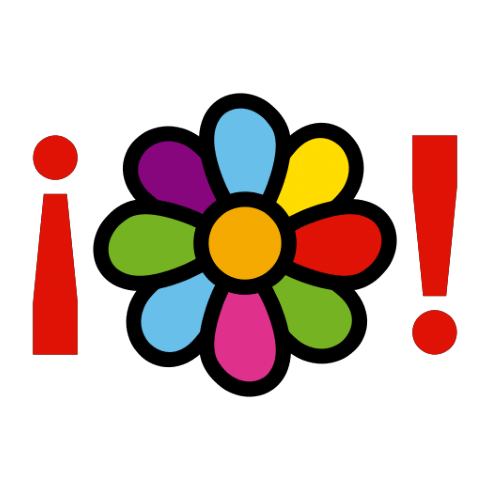

Prediction pict_11470_importante
1
['./imagenes_procesadas/pict_11470.png']
Procesando: ./imagenes_procesadas/pict_11470.png


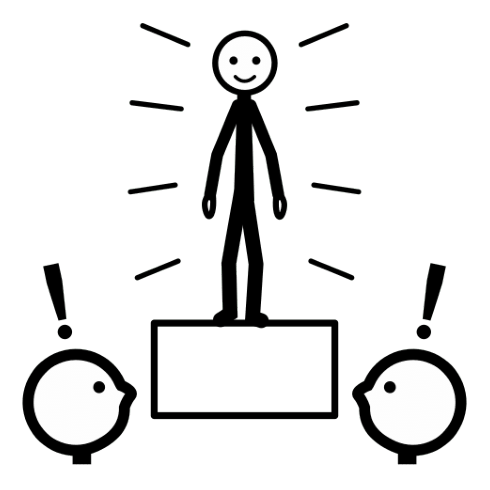

Oracion: pict_2617_me pict_2781_vestir pict_31758_ir pict_4649_feria
4
Procesando: ./imagenes_procesadas/pict_2617.png
Procesando: ./imagenes_procesadas/pict_2781.png
Procesando: ./imagenes_procesadas/pict_31758.png
Procesando: ./imagenes_procesadas/pict_4649.png


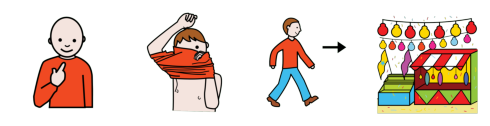

Prediction pict_7271_tener pict_8029_aprender pict_7194_para pict_3345_hablar pict_3021_a pict_7029_la pict_9819_lugar
7
['./imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_8029.png', './imagenes_procesadas/pict_7194.png', './imagenes_procesadas/pict_3345.png', './imagenes_procesadas/pict_3021.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_9819.png']
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_8029.png
Procesando: ./imagenes_procesadas/pict_7194.png
Procesando: ./imagenes_procesadas/pict_3345.png
Procesando: ./imagenes_procesadas/pict_3021.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_9819.png


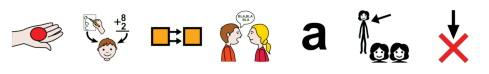

Oracion: pict_12349_tener_en_cuenta pict_8476_la pict_7217_pregunta
3
Procesando: ./imagenes_procesadas/pict_12349.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_7217.png


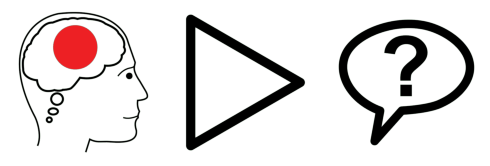

Prediction pict_7271_tener pict_7034_en pict_7217_pregunta pict_7029_la pict_7217_pregunta
5
['./imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_7034.png', './imagenes_procesadas/pict_7217.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_7217.png']
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_7034.png
Procesando: ./imagenes_procesadas/pict_7217.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_7217.png


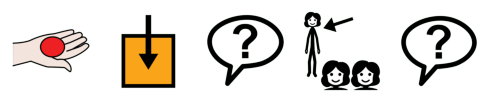

Oracion: pict_37361_clasificar pict_8476_el pict_36404_juego_de_las_sillas
3
Procesando: ./imagenes_procesadas/pict_37361.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_36404.png


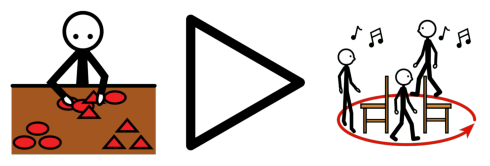

Prediction clasificar pict_8476_el pict_9819_lugar pict_11712_del pict_2248_agua
5
['clasificar', './imagenes_procesadas/pict_8476.png', './imagenes_procesadas/pict_9819.png', './imagenes_procesadas/pict_11712.png', './imagenes_procesadas/pict_2248.png']
Procesando: clasificar
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_9819.png
Procesando: ./imagenes_procesadas/pict_11712.png
Procesando: ./imagenes_procesadas/pict_2248.png


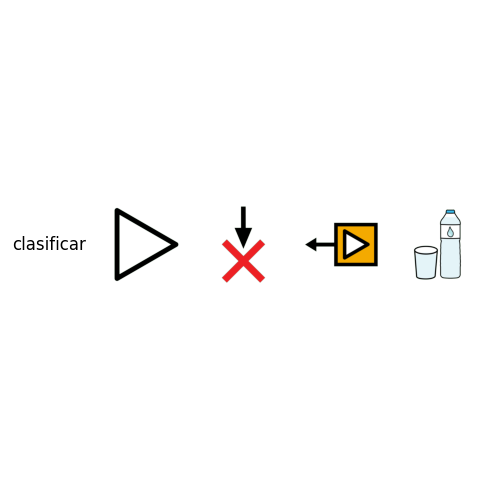

Oracion: pict_6009_hola pict_27353_¿cuál_es_tu_nombre?
2
Procesando: ./imagenes_procesadas/pict_6009.png
Procesando: ./imagenes_procesadas/pict_27353.png


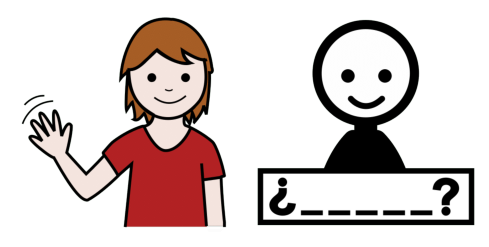

Prediction pict_11691_cuidar pict_3189_, cual pict_5581_ser pict_12281_tu pict_37340_texto
6
['./imagenes_procesadas/pict_11691.png', './imagenes_procesadas/pict_3189.png', 'cual', './imagenes_procesadas/pict_5581.png', './imagenes_procesadas/pict_12281.png', './imagenes_procesadas/pict_37340.png']
Procesando: ./imagenes_procesadas/pict_11691.png
Procesando: ./imagenes_procesadas/pict_3189.png
Procesando: cual
Procesando: ./imagenes_procesadas/pict_5581.png
Procesando: ./imagenes_procesadas/pict_12281.png
Procesando: ./imagenes_procesadas/pict_37340.png


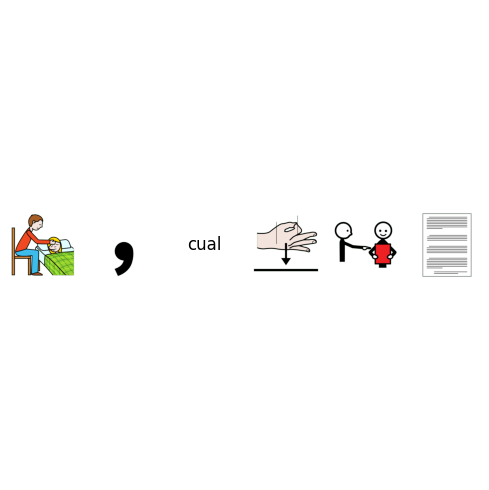

Oracion: pict_2474_mirar pict_8476_el pict_2886_negro
3
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_2886.png


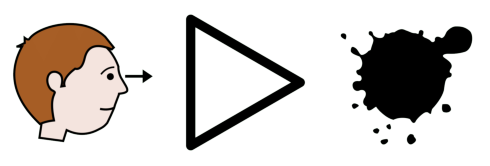

Prediction pict_8579_explicar pict_8476_el pict_9819_lugar pict_4604_claro
4
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_8476.png', './imagenes_procesadas/pict_9819.png', './imagenes_procesadas/pict_4604.png']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_9819.png
Procesando: ./imagenes_procesadas/pict_4604.png


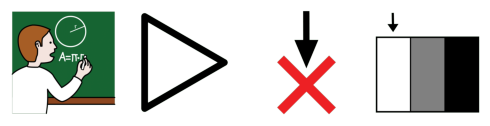

Oracion: pict_21800_diseñar pict_8474_una pict_34395_prenda
3
Procesando: ./imagenes_procesadas/pict_21800.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_34395.png


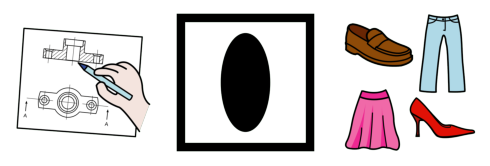

Prediction pict_15485_usar pict_8474_una pict_4649_feria
3
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_4649.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_4649.png


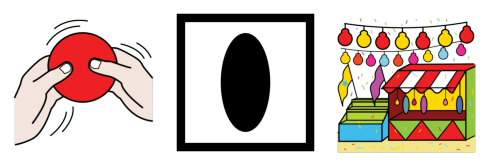

Oracion: pict_22007_obedecer pict_17322_siempre pict_2458_mamá
3
Procesando: ./imagenes_procesadas/pict_22007.png
Procesando: ./imagenes_procesadas/pict_17322.png
Procesando: ./imagenes_procesadas/pict_2458.png


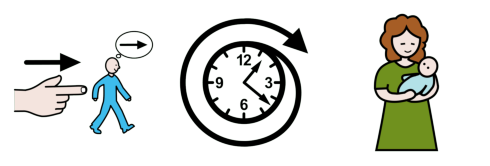

Prediction obedecer pict_5526_no pict_3021_a pict_11572_plantas
4
['obedecer', './imagenes_procesadas/pict_5526.png', './imagenes_procesadas/pict_3021.png', './imagenes_procesadas/pict_11572.png']
Procesando: obedecer
Procesando: ./imagenes_procesadas/pict_5526.png
Procesando: ./imagenes_procesadas/pict_3021.png
Procesando: ./imagenes_procesadas/pict_11572.png


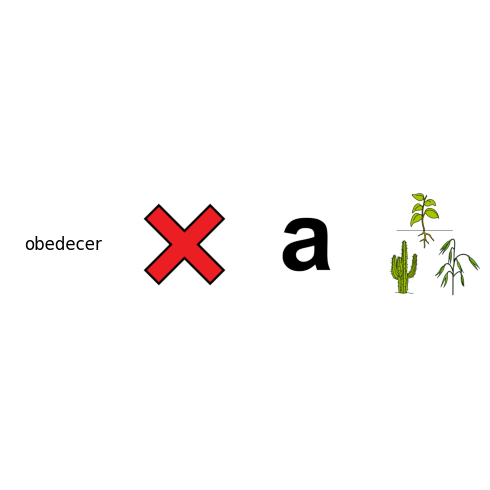

Oracion: pict_32745_antes pict_7074_de pict_31680_leer
3
Procesando: ./imagenes_procesadas/pict_32745.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_31680.png


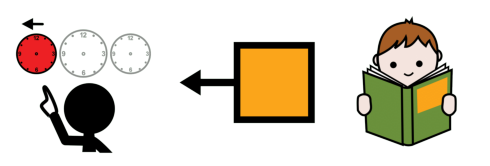

Prediction pict_3189_, pict_7074_de pict_7141_leer
3
['./imagenes_procesadas/pict_3189.png', './imagenes_procesadas/pict_7074.png', './imagenes_procesadas/pict_7141.png']
Procesando: ./imagenes_procesadas/pict_3189.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_7141.png


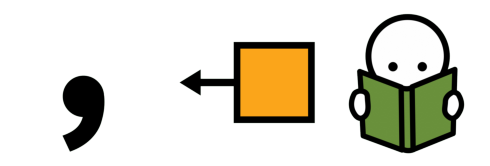

Oracion: pict_34709_clase_de_ética_y_valores
1
Procesando: ./imagenes_procesadas/pict_34709.png


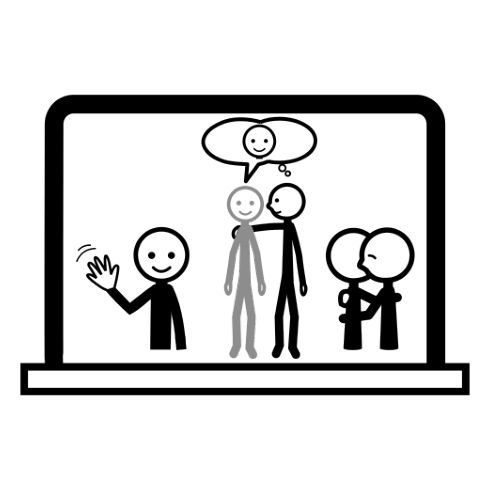

Prediction pict_9897_información pict_7074_de ética pict_3047_y valores
5
['./imagenes_procesadas/pict_9897.png', './imagenes_procesadas/pict_7074.png', 'ética', './imagenes_procesadas/pict_3047.png', 'valores']
Procesando: ./imagenes_procesadas/pict_9897.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ética
Procesando: ./imagenes_procesadas/pict_3047.png
Procesando: valores


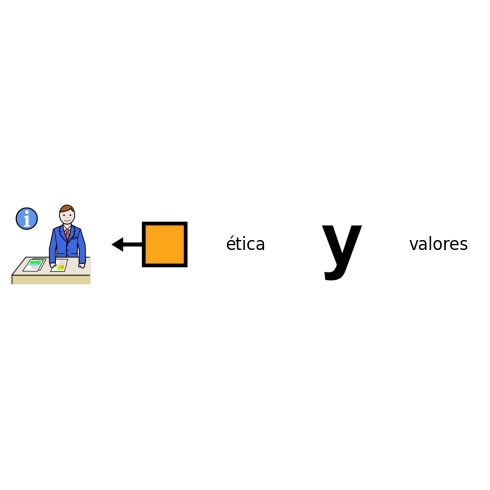

Oracion: pict_31807_yo pict_5441_quiero pict_8579_explicar
3
Procesando: ./imagenes_procesadas/pict_31807.png
Procesando: ./imagenes_procesadas/pict_5441.png
Procesando: ./imagenes_procesadas/pict_8579.png


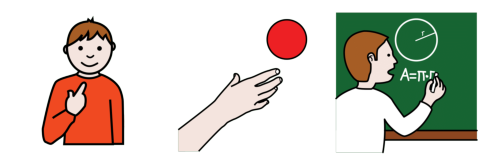

Prediction pict_15485_usar pict_7271_tener pict_2380_escribir
3
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_2380.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_2380.png


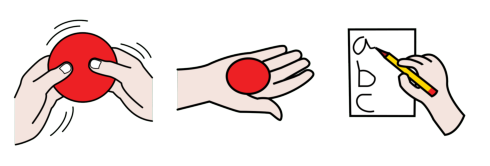

Oracion: pict_8476_el pict_37570_departamento_de_comunicación
2
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_37570.png


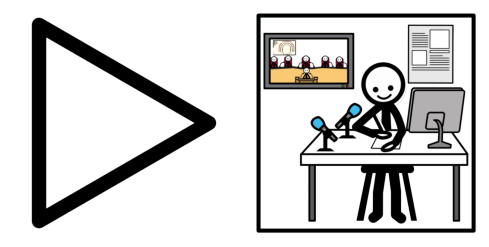

Prediction pict_8476_el departamento pict_7074_de pict_7217_pregunta
4
['./imagenes_procesadas/pict_8476.png', 'departamento', './imagenes_procesadas/pict_7074.png', './imagenes_procesadas/pict_7217.png']
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: departamento
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_7217.png


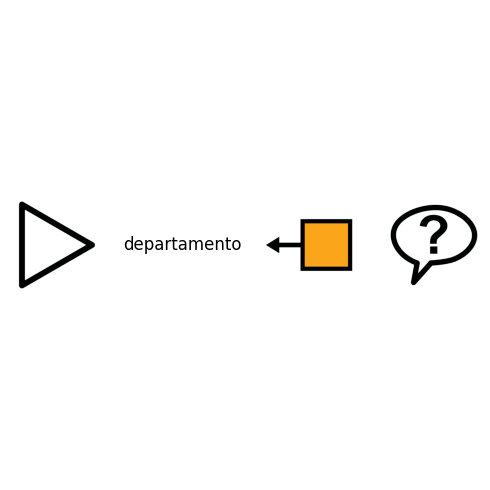

Oracion: pict_8682_reflejar
1
Procesando: ./imagenes_procesadas/pict_8682.png


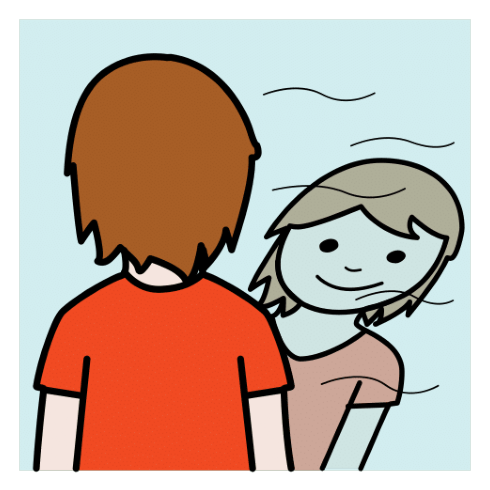

Prediction reflejo
1
['reflejo']
Procesando: reflejo


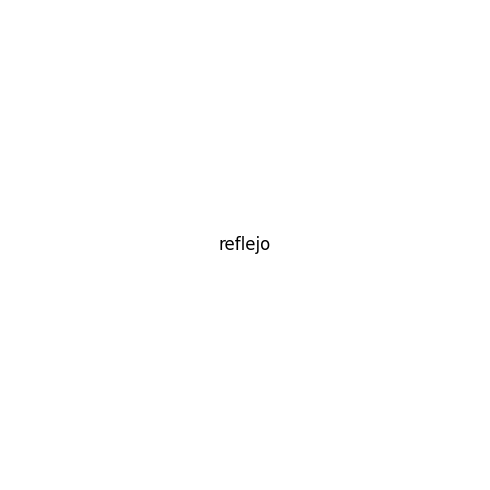

Oracion: pict_5574_pintar pict_7064_con pict_35793_témperas
3
Procesando: ./imagenes_procesadas/pict_5574.png
Procesando: ./imagenes_procesadas/pict_7064.png
Procesando: ./imagenes_procesadas/pict_35793.png


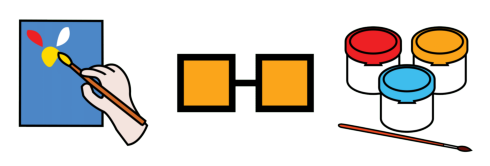

Prediction pict_8088_dibujar pict_7064_con temperas
3
['./imagenes_procesadas/pict_8088.png', './imagenes_procesadas/pict_7064.png', 'temperas']
Procesando: ./imagenes_procesadas/pict_8088.png
Procesando: ./imagenes_procesadas/pict_7064.png
Procesando: temperas


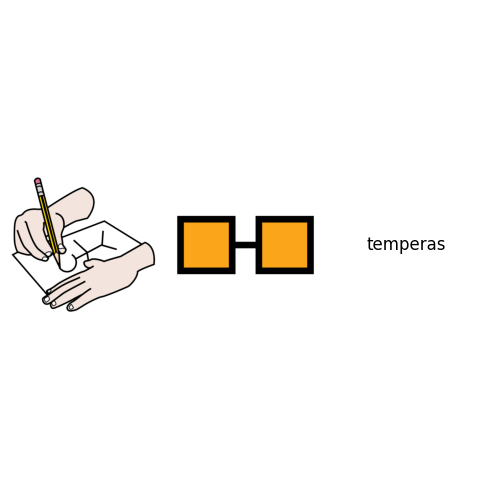

Oracion: pict_37718_goma_elástica
1
Procesando: ./imagenes_procesadas/pict_37718.png


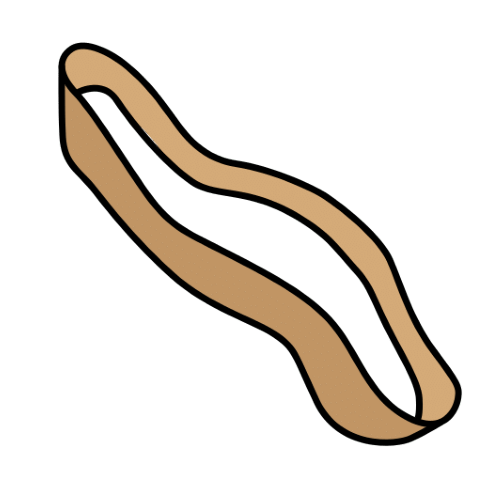

Prediction pict_22769_artesanía elástica
2
['./imagenes_procesadas/pict_22769.png', 'elástica']
Procesando: ./imagenes_procesadas/pict_22769.png
Procesando: elástica


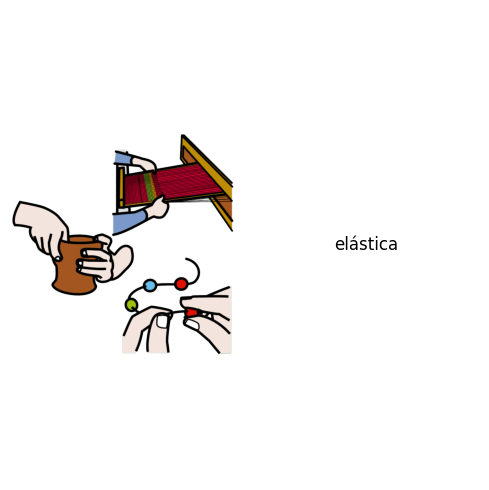

Oracion: pict_34799_fecha pict_7074_de pict_6016_inaugurar
3
Procesando: ./imagenes_procesadas/pict_34799.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_6016.png


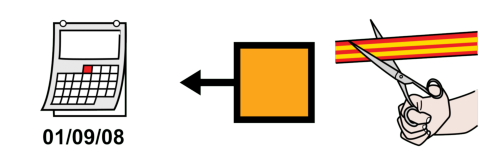

Prediction pict_2248_agua pict_7074_de inauguración
3
['./imagenes_procesadas/pict_2248.png', './imagenes_procesadas/pict_7074.png', 'inauguración']
Procesando: ./imagenes_procesadas/pict_2248.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: inauguración


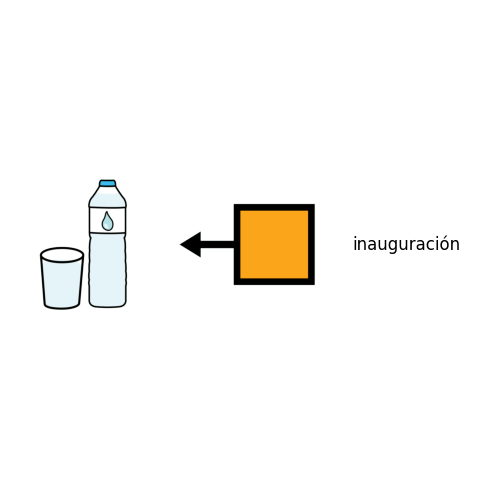

Oracion: pict_8109_esperar pict_7283_3 pict_38797_24h
3
Procesando: ./imagenes_procesadas/pict_8109.png
Procesando: ./imagenes_procesadas/pict_7283.png
Procesando: ./imagenes_procesadas/pict_38797.png


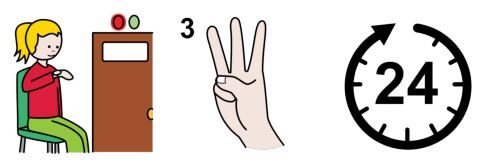

Prediction pict_11691_cuidar pict_11709_al pict_2248_agua
3
['./imagenes_procesadas/pict_11691.png', './imagenes_procesadas/pict_11709.png', './imagenes_procesadas/pict_2248.png']
Procesando: ./imagenes_procesadas/pict_11691.png
Procesando: ./imagenes_procesadas/pict_11709.png
Procesando: ./imagenes_procesadas/pict_2248.png


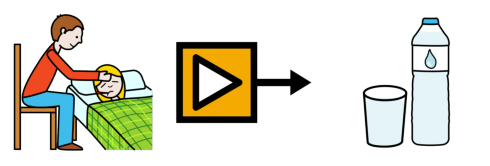

Oracion: pict_37340_texto pict_8098_educación
2
Procesando: ./imagenes_procesadas/pict_37340.png
Procesando: ./imagenes_procesadas/pict_8098.png


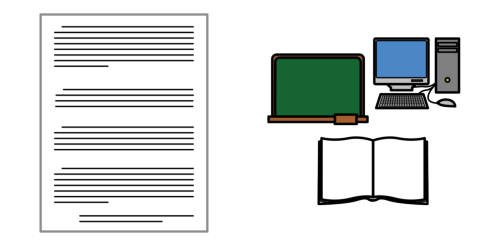

Prediction pict_37340_texto educativo
2
['./imagenes_procesadas/pict_37340.png', 'educativo']
Procesando: ./imagenes_procesadas/pict_37340.png
Procesando: educativo


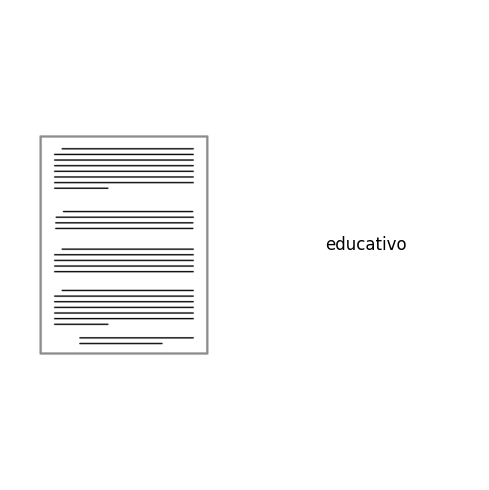

Oracion: pict_2474_observar pict_8476_la pict_20389_naturaleza
3
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_20389.png


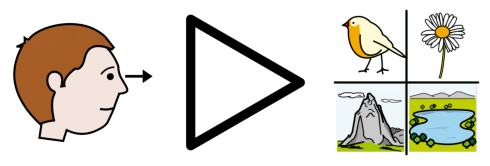

Prediction pict_8579_explicar pict_7029_la pict_9819_lugar
3
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_9819.png']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_9819.png


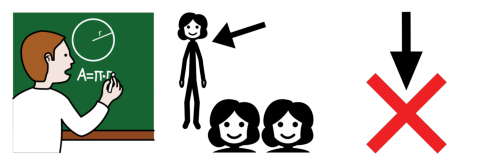

Oracion: pict_6483_elegir pict_8474_un pict_22763_poesía
3
Procesando: ./imagenes_procesadas/pict_6483.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_22763.png


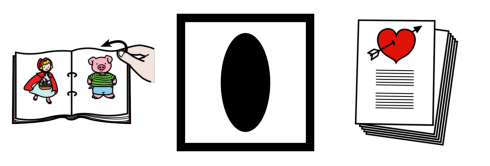

Prediction pict_15485_usar pict_8474_un poema
3
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_8474.png', 'poema']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: poema


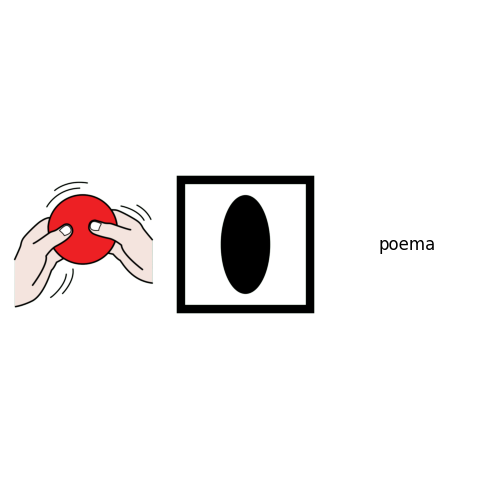

Oracion: pict_2474_observar pict_8474_un pict_38767_tienda_de_plantas
3
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_38767.png


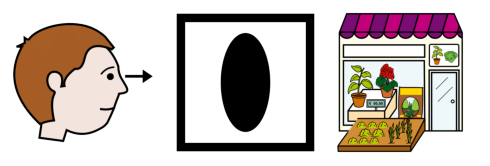

Prediction pict_15485_usar pict_8474_una pict_4649_feria pict_7074_de pict_11572_plantas
5
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_4649.png', './imagenes_procesadas/pict_7074.png', './imagenes_procesadas/pict_11572.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_4649.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_11572.png


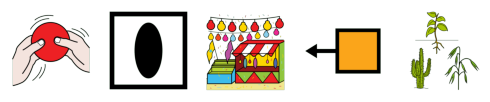

Oracion: pict_6517_conversar pict_7814_sobre pict_8476_la pict_7784_noticia
4
Procesando: ./imagenes_procesadas/pict_6517.png
Procesando: ./imagenes_procesadas/pict_7814.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_7784.png


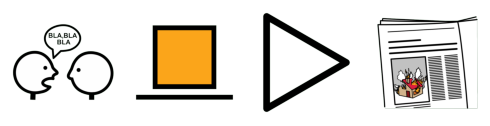

Prediction pict_9870_presentar pict_7814_sobre pict_7029_la pict_7217_pregunta
4
['./imagenes_procesadas/pict_9870.png', './imagenes_procesadas/pict_7814.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_7217.png']
Procesando: ./imagenes_procesadas/pict_9870.png
Procesando: ./imagenes_procesadas/pict_7814.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_7217.png


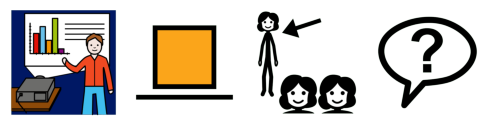

Oracion: pict_2474_observar pict_8476_la pict_9897_información
3
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_9897.png


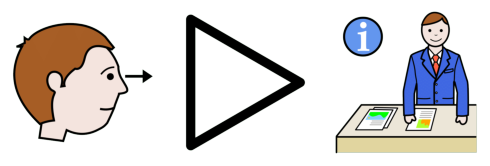

Prediction pict_8579_explicar pict_7029_la pict_37340_texto
3
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_37340.png']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_37340.png


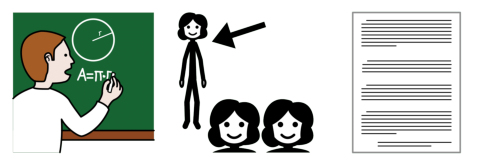

Oracion: pict_31807_yo pict_31847_pensar
2
Procesando: ./imagenes_procesadas/pict_31807.png
Procesando: ./imagenes_procesadas/pict_31847.png


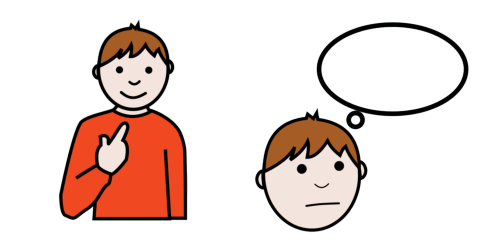

Prediction pict_7141_leer pienso
2
['./imagenes_procesadas/pict_7141.png', 'pienso']
Procesando: ./imagenes_procesadas/pict_7141.png
Procesando: pienso


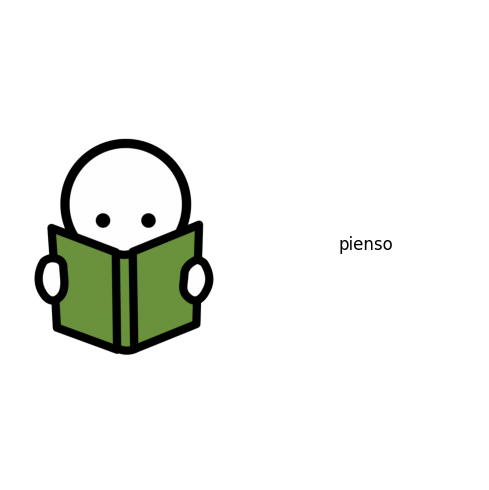

Oracion: pict_32954_vamos_a_la_tienda pict_32942_mercado pict_28665_comprar
3
Procesando: ./imagenes_procesadas/pict_32954.png
Procesando: ./imagenes_procesadas/pict_32942.png
Procesando: ./imagenes_procesadas/pict_28665.png


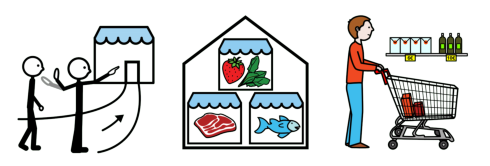

Prediction pict_7271_tener pict_11709_al pict_9819_lugar pict_3021_a pict_35653_organizar
5
['./imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_11709.png', './imagenes_procesadas/pict_9819.png', './imagenes_procesadas/pict_3021.png', './imagenes_procesadas/pict_35653.png']
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_11709.png
Procesando: ./imagenes_procesadas/pict_9819.png
Procesando: ./imagenes_procesadas/pict_3021.png
Procesando: ./imagenes_procesadas/pict_35653.png


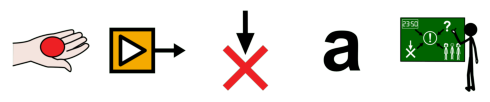

Oracion: pict_17050_mantener pict_12293_sano
2
Procesando: ./imagenes_procesadas/pict_17050.png
Procesando: ./imagenes_procesadas/pict_12293.png


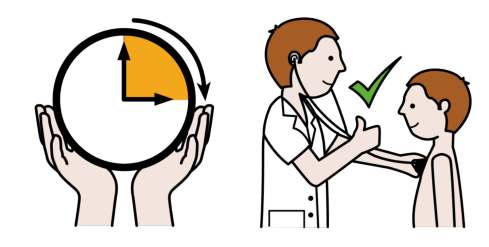

Prediction mantenerme sano
2
['mantenerme', 'sano']
Procesando: mantenerme
Procesando: sano


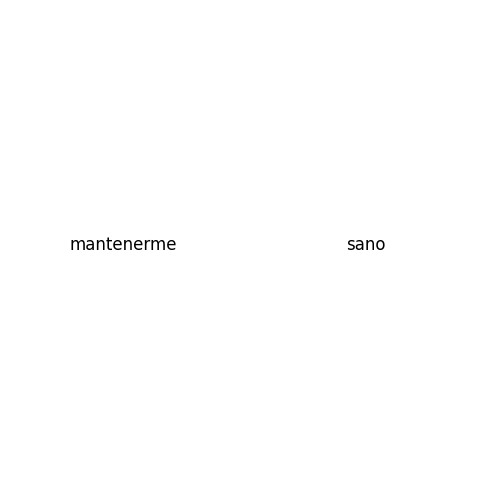

Oracion: pict_9870_exposición
1
Procesando: ./imagenes_procesadas/pict_9870.png


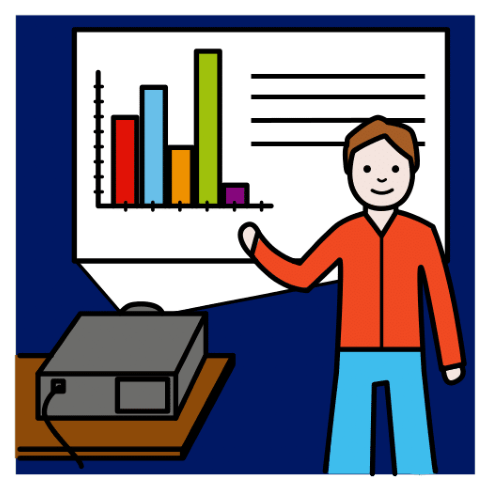

Prediction pict_37340_texto oral
2
['./imagenes_procesadas/pict_37340.png', 'oral']
Procesando: ./imagenes_procesadas/pict_37340.png
Procesando: oral


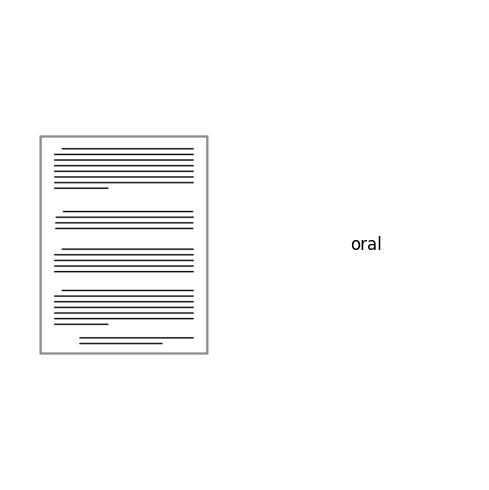

Oracion: pict_2474_observar pict_5936_silencio pict_9870_exposición
3
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_5936.png
Procesando: ./imagenes_procesadas/pict_9870.png


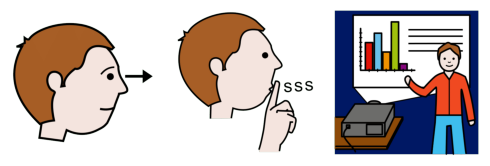

Prediction pict_8579_explicar pict_7034_en pict_9870_exposición pict_7029_la pict_37340_texto
5
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_7034.png', './imagenes_procesadas/pict_9870.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_37340.png']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_7034.png
Procesando: ./imagenes_procesadas/pict_9870.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_37340.png


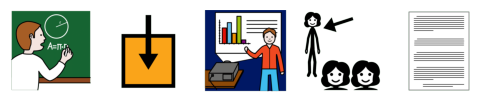

Oracion: pict_2474_observar pict_9857_quiénes
2
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_9857.png


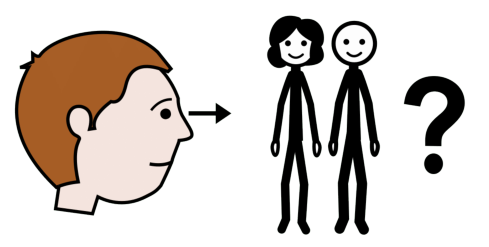

Prediction pict_8579_explicar pict_22619_cómo pict_5581_ser
3
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_22619.png', './imagenes_procesadas/pict_5581.png']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_22619.png
Procesando: ./imagenes_procesadas/pict_5581.png


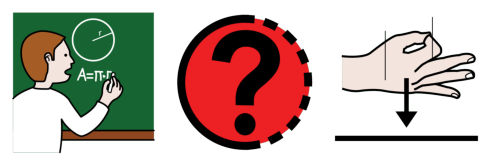

Oracion: pict_27411_escribir_una_fecha
1
Procesando: ./imagenes_procesadas/pict_27411.png


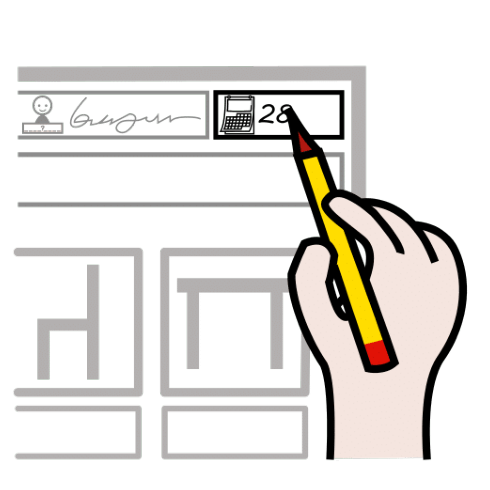

Prediction pict_2380_escribir pict_8474_una pict_2248_agua
3
['./imagenes_procesadas/pict_2380.png', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_2248.png']
Procesando: ./imagenes_procesadas/pict_2380.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_2248.png


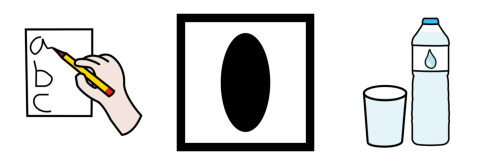

Oracion: pict_8107_escribir pict_6625_tú pict_9702_datos_personales
3
Procesando: ./imagenes_procesadas/pict_8107.png
Procesando: ./imagenes_procesadas/pict_6625.png
Procesando: ./imagenes_procesadas/pict_9702.png


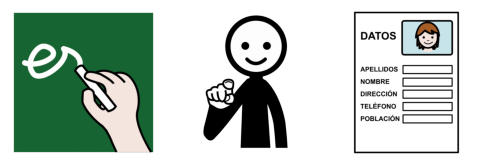

Prediction pict_2380_escribir pict_12281_tu datos pict_11470_importante
4
['./imagenes_procesadas/pict_2380.png', './imagenes_procesadas/pict_12281.png', 'datos', './imagenes_procesadas/pict_11470.png']
Procesando: ./imagenes_procesadas/pict_2380.png
Procesando: ./imagenes_procesadas/pict_12281.png
Procesando: datos
Procesando: ./imagenes_procesadas/pict_11470.png


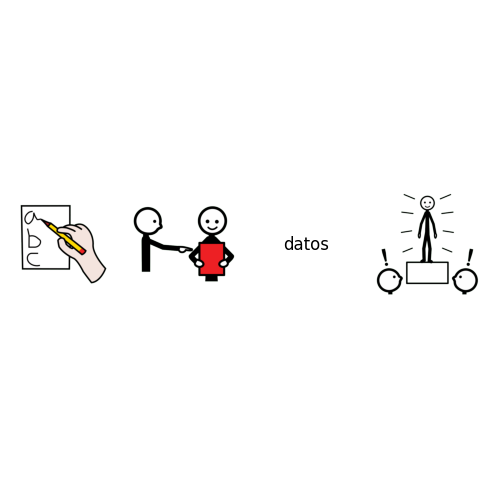

Oracion: pict_17044_recibir pict_8476_el pict_2494_pan
3
Procesando: ./imagenes_procesadas/pict_17044.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_2494.png


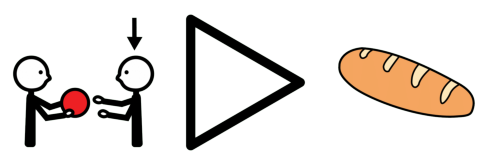

Prediction pict_15485_usar pict_8476_el pict_2248_agua
3
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_8476.png', './imagenes_procesadas/pict_2248.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_2248.png


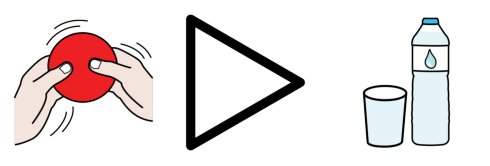

Oracion: pict_31807_yo pict_5441_quiero pict_27212_reciclar
3
Procesando: ./imagenes_procesadas/pict_31807.png
Procesando: ./imagenes_procesadas/pict_5441.png
Procesando: ./imagenes_procesadas/pict_27212.png


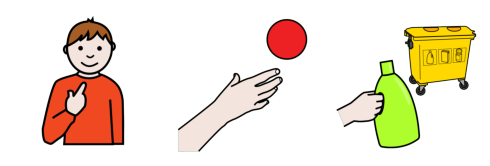

Prediction pict_15485_usar pict_7271_tener pict_11691_cuidar
3
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_11691.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_11691.png


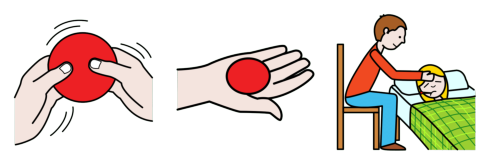

Oracion: pict_2474_observar pict_8476_la pict_34065_regla_y_compás
3
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_34065.png


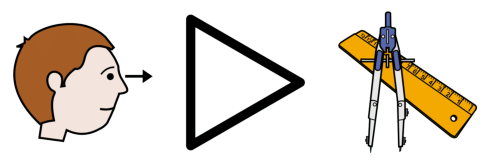

Prediction pict_8579_explicar pict_7029_la pict_11572_plantas pict_3047_y compas
5
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_11572.png', './imagenes_procesadas/pict_3047.png', 'compas']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_11572.png
Procesando: ./imagenes_procesadas/pict_3047.png
Procesando: compas


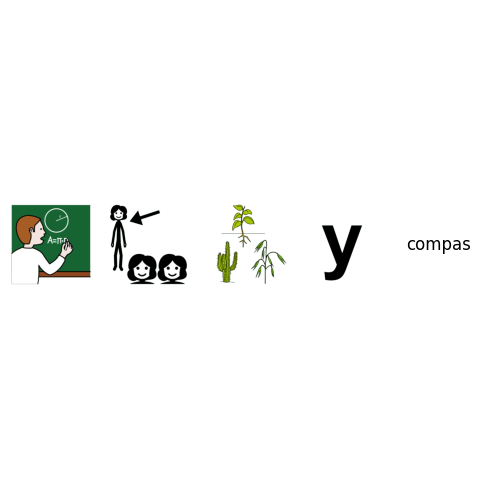

Oracion: pict_5441_yo_quiero pict_37486_escuchar_música
2
Procesando: ./imagenes_procesadas/pict_5441.png
Procesando: ./imagenes_procesadas/pict_37486.png


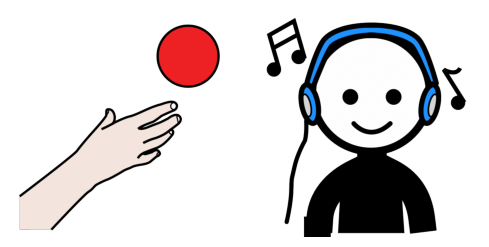

Prediction pict_15485_usar pict_7271_tener pict_8579_explicar musica
4
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_8579.png', 'musica']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: musica


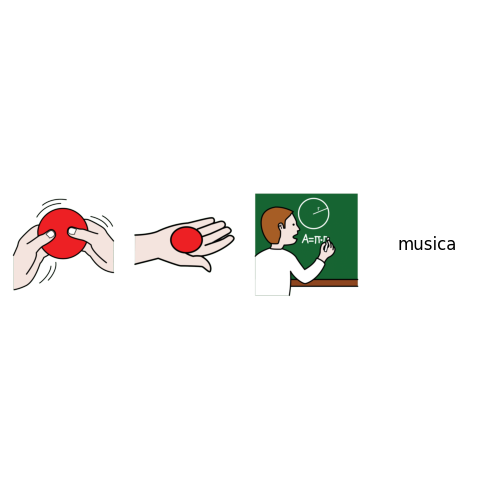

Oracion: pict_2474_observar pict_4768_vaso_de_agua
2
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_4768.png


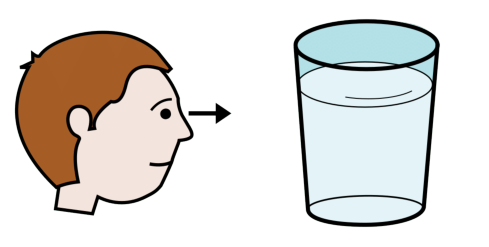

Prediction pict_15485_usar pict_8474_un pict_2248_agua pict_7074_de pict_8474_una
5
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_2248.png', './imagenes_procesadas/pict_7074.png', './imagenes_procesadas/pict_8474.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_2248.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_8474.png


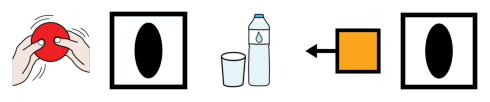

Oracion: pict_26176_completa pict_8477_las pict_9877_partes pict_3143_planta
4
Procesando: ./imagenes_procesadas/pict_26176.png
Procesando: ./imagenes_procesadas/pict_8477.png
Procesando: ./imagenes_procesadas/pict_9877.png
Procesando: ./imagenes_procesadas/pict_3143.png


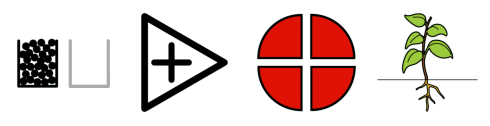

Prediction pict_35653_organizar pict_7031_las pict_9819_lugar pict_7074_de pict_7029_la pict_9819_lugar
6
['./imagenes_procesadas/pict_35653.png', './imagenes_procesadas/pict_7031.png', './imagenes_procesadas/pict_9819.png', './imagenes_procesadas/pict_7074.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_9819.png']
Procesando: ./imagenes_procesadas/pict_35653.png
Procesando: ./imagenes_procesadas/pict_7031.png
Procesando: ./imagenes_procesadas/pict_9819.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_9819.png


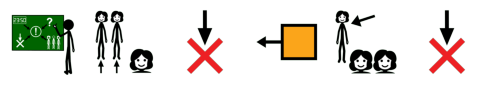

Oracion: pict_5441_yo_quiero pict_27212_reciclar
2
Procesando: ./imagenes_procesadas/pict_5441.png
Procesando: ./imagenes_procesadas/pict_27212.png


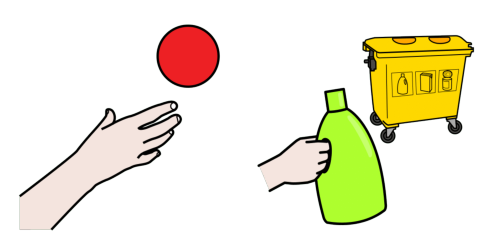

Prediction pict_15485_usar pict_7271_tener pict_11691_cuidar
3
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_11691.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_11691.png


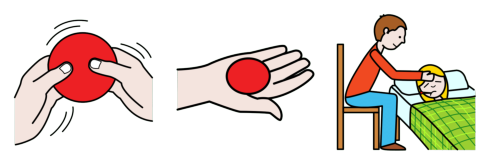

Oracion: pict_7141_leer pict_28433_responder pict_8476_la pict_7217_pregunta
4
Procesando: ./imagenes_procesadas/pict_7141.png
Procesando: ./imagenes_procesadas/pict_28433.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_7217.png


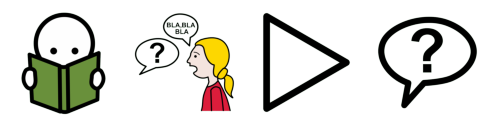

Prediction pict_7141_leer pict_3047_y pict_3345_hablar pict_7031_las pict_7217_pregunta
5
['./imagenes_procesadas/pict_7141.png', './imagenes_procesadas/pict_3047.png', './imagenes_procesadas/pict_3345.png', './imagenes_procesadas/pict_7031.png', './imagenes_procesadas/pict_7217.png']
Procesando: ./imagenes_procesadas/pict_7141.png
Procesando: ./imagenes_procesadas/pict_3047.png
Procesando: ./imagenes_procesadas/pict_3345.png
Procesando: ./imagenes_procesadas/pict_7031.png
Procesando: ./imagenes_procesadas/pict_7217.png


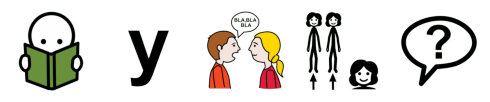

Oracion: pict_11715_descripción pict_11709_al pict_9062_colibrí
3
Procesando: ./imagenes_procesadas/pict_11715.png
Procesando: ./imagenes_procesadas/pict_11709.png
Procesando: ./imagenes_procesadas/pict_9062.png


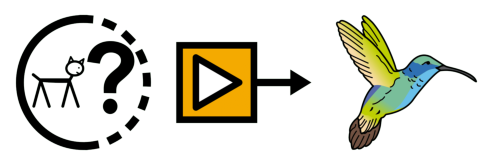

Prediction describe pict_11709_al colibri
3
['describe', './imagenes_procesadas/pict_11709.png', 'colibri']
Procesando: describe
Procesando: ./imagenes_procesadas/pict_11709.png
Procesando: colibri


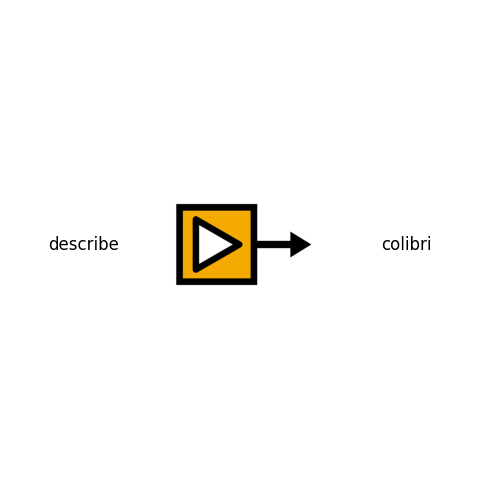

Oracion: pict_22619_cómo pict_16805_llegar
2
Procesando: ./imagenes_procesadas/pict_22619.png
Procesando: ./imagenes_procesadas/pict_16805.png


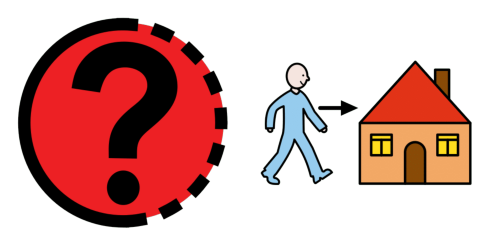

Prediction pict_22619_cómo pict_7271_tener
2
['./imagenes_procesadas/pict_22619.png', './imagenes_procesadas/pict_7271.png']
Procesando: ./imagenes_procesadas/pict_22619.png
Procesando: ./imagenes_procesadas/pict_7271.png


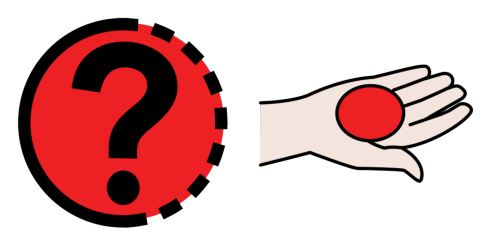

Oracion: pict_31148_madre pict_8474_un pict_9819_lugar pict_36759_lejos
4
Procesando: ./imagenes_procesadas/pict_31148.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_9819.png
Procesando: ./imagenes_procesadas/pict_36759.png


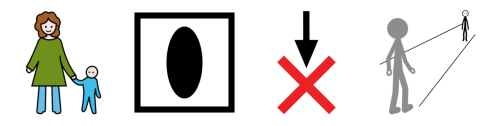

Prediction pict_5596_todos pict_3189_, pict_5581_ser pict_8474_un pict_37340_texto pict_4604_claro
6
['./imagenes_procesadas/pict_5596.png', './imagenes_procesadas/pict_3189.png', './imagenes_procesadas/pict_5581.png', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_37340.png', './imagenes_procesadas/pict_4604.png']
Procesando: ./imagenes_procesadas/pict_5596.png
Procesando: ./imagenes_procesadas/pict_3189.png
Procesando: ./imagenes_procesadas/pict_5581.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_37340.png
Procesando: ./imagenes_procesadas/pict_4604.png


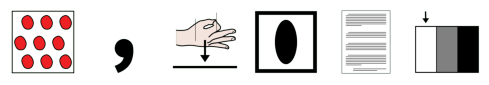

Oracion: pict_8107_escribir pict_8474_una pict_7784_noticia
3
Procesando: ./imagenes_procesadas/pict_8107.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_7784.png


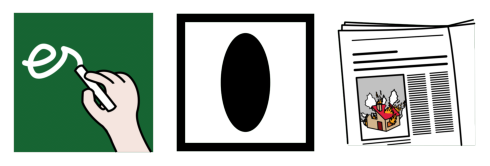

Prediction pict_2380_escribir pict_8474_una pict_7217_pregunta
3
['./imagenes_procesadas/pict_2380.png', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_7217.png']
Procesando: ./imagenes_procesadas/pict_2380.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_7217.png


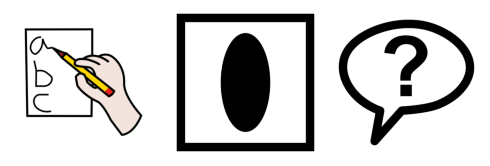

Oracion: pict_6009_hola pict_5441_quiero pict_8986_hacer_la_compra pict_7291_uno pict_2639_aguja
5
Procesando: ./imagenes_procesadas/pict_6009.png
Procesando: ./imagenes_procesadas/pict_5441.png
Procesando: ./imagenes_procesadas/pict_8986.png
Procesando: ./imagenes_procesadas/pict_7291.png
Procesando: ./imagenes_procesadas/pict_2639.png


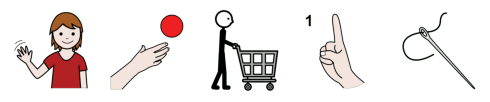

Prediction pict_11238_dibujo pict_6481_se pict_7271_tener pict_35653_organizar pict_11709_al pict_4649_feria
6
['./imagenes_procesadas/pict_11238.png', './imagenes_procesadas/pict_6481.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_35653.png', './imagenes_procesadas/pict_11709.png', './imagenes_procesadas/pict_4649.png']
Procesando: ./imagenes_procesadas/pict_11238.png
Procesando: ./imagenes_procesadas/pict_6481.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_35653.png
Procesando: ./imagenes_procesadas/pict_11709.png
Procesando: ./imagenes_procesadas/pict_4649.png


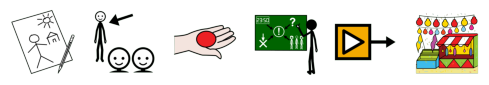

Oracion: pict_5553_primavera
1
Procesando: ./imagenes_procesadas/pict_5553.png


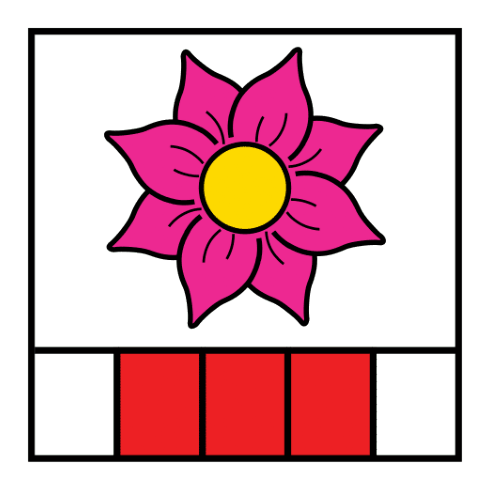

Prediction pict_4649_feria
1
['./imagenes_procesadas/pict_4649.png']
Procesando: ./imagenes_procesadas/pict_4649.png


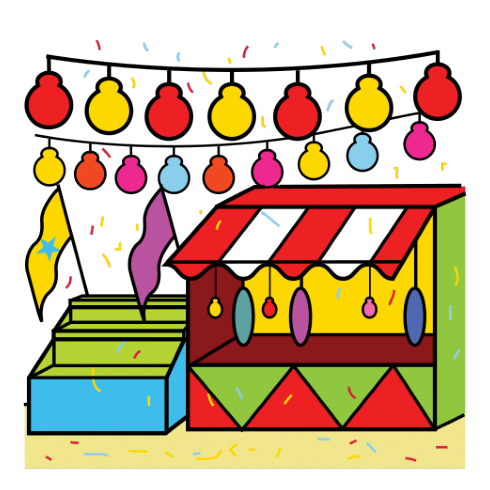

Oracion: pict_15485_usar pict_17275_mortero pict_7194_para pict_38077_moler pict_2641_ajo
5
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_17275.png
Procesando: ./imagenes_procesadas/pict_7194.png
Procesando: ./imagenes_procesadas/pict_38077.png
Procesando: ./imagenes_procesadas/pict_2641.png


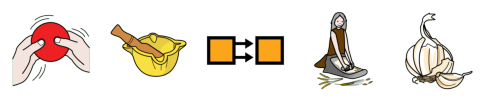

Prediction pict_15485_usar pict_8476_el mortero pict_7194_para pict_11691_cuidar pict_11709_al pict_22769_artesanía
7
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_8476.png', 'mortero', './imagenes_procesadas/pict_7194.png', './imagenes_procesadas/pict_11691.png', './imagenes_procesadas/pict_11709.png', './imagenes_procesadas/pict_22769.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: mortero
Procesando: ./imagenes_procesadas/pict_7194.png
Procesando: ./imagenes_procesadas/pict_11691.png
Procesando: ./imagenes_procesadas/pict_11709.png
Procesando: ./imagenes_procesadas/pict_22769.png


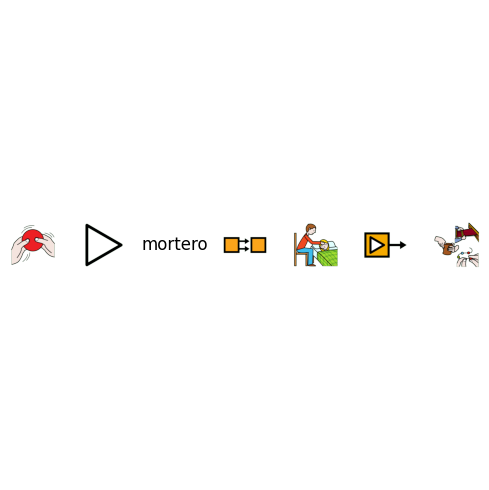

Oracion: pict_28433_responder pict_8476_el pict_4740_saludo
3
Procesando: ./imagenes_procesadas/pict_28433.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_4740.png


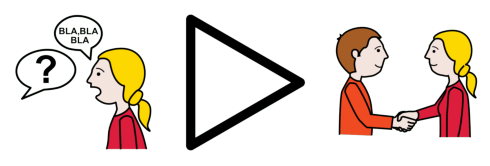

Prediction pict_3345_hablar pict_8476_el pict_11691_cuidar
3
['./imagenes_procesadas/pict_3345.png', './imagenes_procesadas/pict_8476.png', './imagenes_procesadas/pict_11691.png']
Procesando: ./imagenes_procesadas/pict_3345.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_11691.png


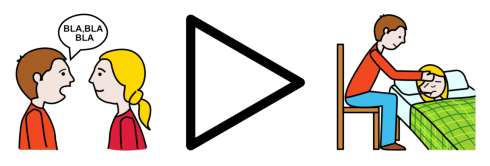

Oracion: pict_2474_ver pict_8476_el pict_8266_muro pict_4658_grande
4
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_8266.png
Procesando: ./imagenes_procesadas/pict_4658.png


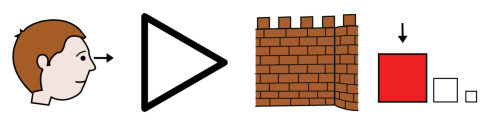

Prediction pict_8579_explicar pict_8476_el pict_2248_agua pict_11470_importante
4
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_8476.png', './imagenes_procesadas/pict_2248.png', './imagenes_procesadas/pict_11470.png']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_2248.png
Procesando: ./imagenes_procesadas/pict_11470.png


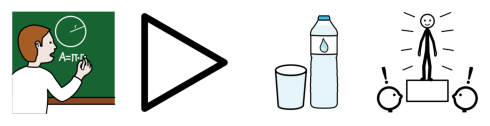

Oracion: pict_2474_observar pict_12266_mis pict_9826_dedos pict_26162_largo
4
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_12266.png
Procesando: ./imagenes_procesadas/pict_9826.png
Procesando: ./imagenes_procesadas/pict_26162.png


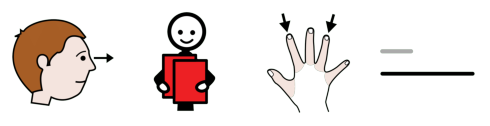

Prediction pict_8579_explicar pict_12281_tu pict_4604_claro pict_4604_claro
4
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_12281.png', './imagenes_procesadas/pict_4604.png', './imagenes_procesadas/pict_4604.png']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_12281.png
Procesando: ./imagenes_procesadas/pict_4604.png
Procesando: ./imagenes_procesadas/pict_4604.png


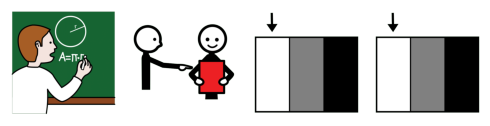

Oracion: pict_2474_observar pict_3171_y pict_9030_responder
3
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_3171.png
Procesando: ./imagenes_procesadas/pict_9030.png


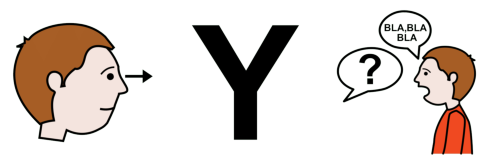

Prediction pict_15485_usar pict_3047_y pict_3345_hablar
3
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_3047.png', './imagenes_procesadas/pict_3345.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_3047.png
Procesando: ./imagenes_procesadas/pict_3345.png


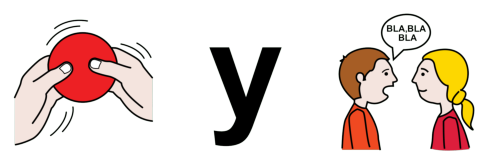

Oracion: pict_6625_te pict_37826_gustar pict_8476_el pict_6642_libros_de_poesia_y_arte
4
Procesando: ./imagenes_procesadas/pict_6625.png
Procesando: ./imagenes_procesadas/pict_37826.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_6642.png


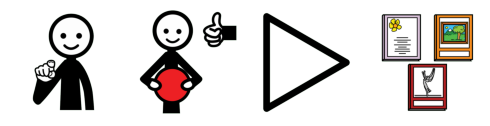

Prediction pict_7271_tener pict_17038_dar pict_8476_el pict_37340_texto pict_7074_de pict_2359_cuaderno pict_3047_y arte
8
['./imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_17038.png', './imagenes_procesadas/pict_8476.png', './imagenes_procesadas/pict_37340.png', './imagenes_procesadas/pict_7074.png', './imagenes_procesadas/pict_2359.png', './imagenes_procesadas/pict_3047.png', 'arte']
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_17038.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_37340.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_2359.png
Procesando: ./imagenes_procesadas/pict_3047.png
Procesando: arte


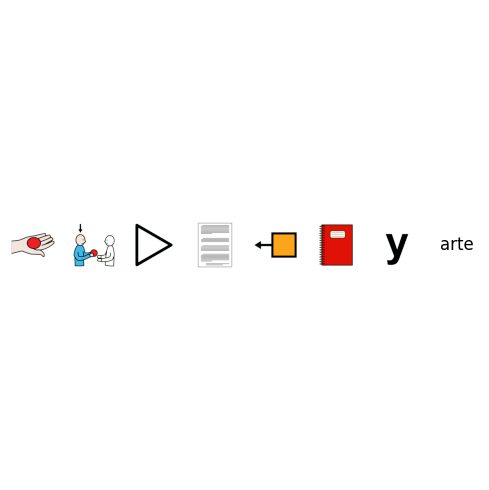

Oracion: pict_7194_para pict_22620_qué pict_9870_exponer
3
Procesando: ./imagenes_procesadas/pict_7194.png
Procesando: ./imagenes_procesadas/pict_22620.png
Procesando: ./imagenes_procesadas/pict_9870.png


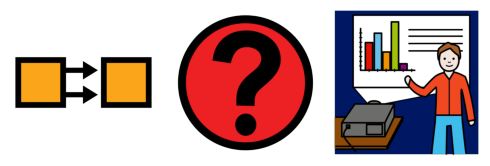

Prediction pict_3415_¿ pict_7194_para pict_22624_qué pict_11691_cuidar pict_3418_?
5
['./imagenes_procesadas/pict_3415.png', './imagenes_procesadas/pict_7194.png', './imagenes_procesadas/pict_22624.png', './imagenes_procesadas/pict_11691.png', './imagenes_procesadas/pict_3418.png']
Procesando: ./imagenes_procesadas/pict_3415.png
Procesando: ./imagenes_procesadas/pict_7194.png
Procesando: ./imagenes_procesadas/pict_22624.png
Procesando: ./imagenes_procesadas/pict_11691.png
Procesando: ./imagenes_procesadas/pict_3418.png


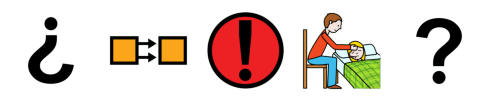

Oracion: pict_2387_estudiar pict_8476_la pict_23833_biblia
3
Procesando: ./imagenes_procesadas/pict_2387.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_23833.png


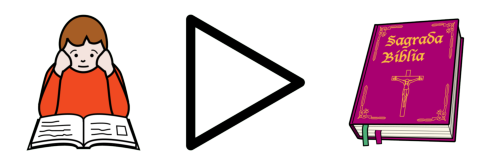

Prediction pict_2380_escribir pict_7029_la pict_9870_exposición
3
['./imagenes_procesadas/pict_2380.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_9870.png']
Procesando: ./imagenes_procesadas/pict_2380.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_9870.png


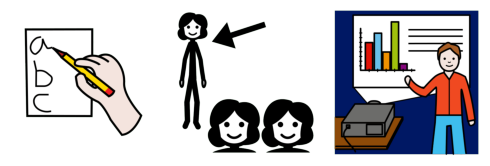

Oracion: pict_8490_anotar pict_8474_una pict_11576_sugerencia
3
Procesando: ./imagenes_procesadas/pict_8490.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_11576.png


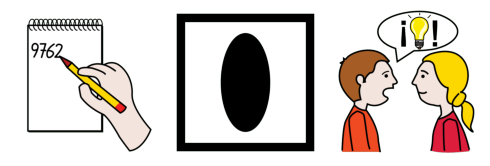

Prediction pict_2474_observar pict_7031_las pict_7217_pregunta
3
['./imagenes_procesadas/pict_2474.png', './imagenes_procesadas/pict_7031.png', './imagenes_procesadas/pict_7217.png']
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_7031.png
Procesando: ./imagenes_procesadas/pict_7217.png


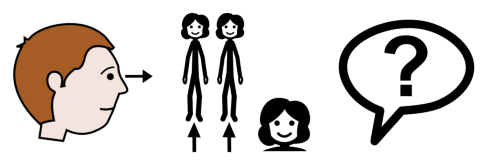

Oracion: pict_2348_colorear pict_8476_la pict_37948_caja pict_7194_para pict_16879_regalar
5
Procesando: ./imagenes_procesadas/pict_2348.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_37948.png
Procesando: ./imagenes_procesadas/pict_7194.png
Procesando: ./imagenes_procesadas/pict_16879.png


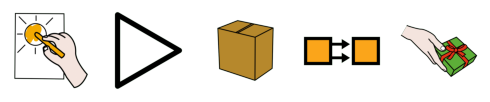

Prediction colorear pict_7029_la pict_4649_feria pict_7194_para pict_11691_cuidar
5
['colorear', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_4649.png', './imagenes_procesadas/pict_7194.png', './imagenes_procesadas/pict_11691.png']
Procesando: colorear
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_4649.png
Procesando: ./imagenes_procesadas/pict_7194.png
Procesando: ./imagenes_procesadas/pict_11691.png


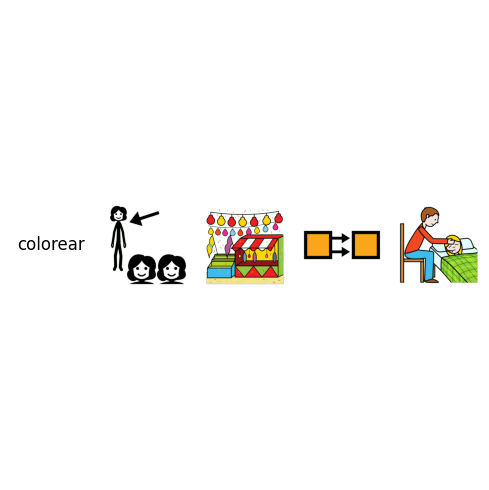

Oracion: pict_38631_narrar_una_historia pict_24733_divertido
2
Procesando: ./imagenes_procesadas/pict_38631.png
Procesando: ./imagenes_procesadas/pict_24733.png


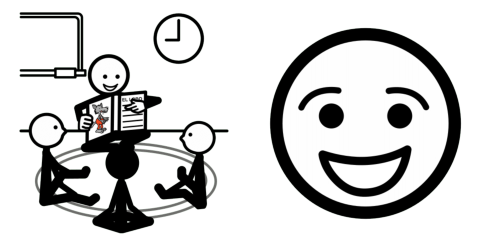

Prediction pict_35653_organizar pict_8474_una pict_37340_texto pict_22769_artesanía
4
['./imagenes_procesadas/pict_35653.png', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_37340.png', './imagenes_procesadas/pict_22769.png']
Procesando: ./imagenes_procesadas/pict_35653.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_37340.png
Procesando: ./imagenes_procesadas/pict_22769.png


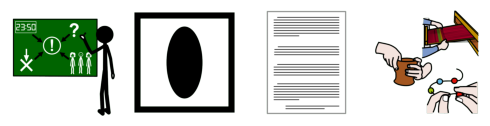

Oracion: pict_36441_reutilizar pict_11318_objetos
2
Procesando: ./imagenes_procesadas/pict_36441.png
Procesando: ./imagenes_procesadas/pict_11318.png


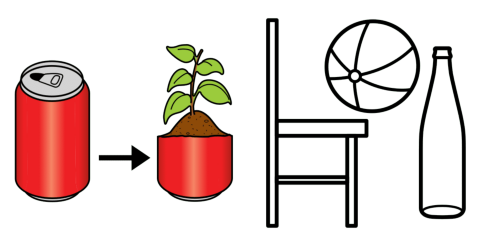

Prediction pict_7141_leer pict_6901_animales
2
['./imagenes_procesadas/pict_7141.png', './imagenes_procesadas/pict_6901.png']
Procesando: ./imagenes_procesadas/pict_7141.png
Procesando: ./imagenes_procesadas/pict_6901.png


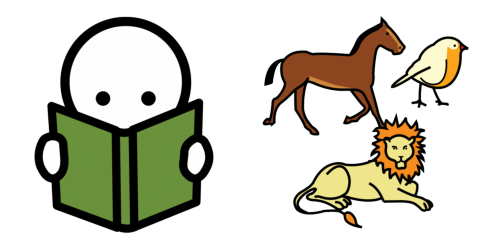

Oracion: pict_35669_explicar pict_8476_el pict_31882_tablero_de_comunicación
3
Procesando: ./imagenes_procesadas/pict_35669.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_31882.png


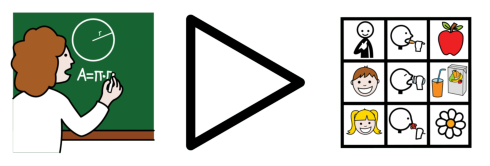

Prediction pict_2380_escribir pict_8476_el pict_7141_leer pict_7074_de pict_9870_exposición
5
['./imagenes_procesadas/pict_2380.png', './imagenes_procesadas/pict_8476.png', './imagenes_procesadas/pict_7141.png', './imagenes_procesadas/pict_7074.png', './imagenes_procesadas/pict_9870.png']
Procesando: ./imagenes_procesadas/pict_2380.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_7141.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_9870.png


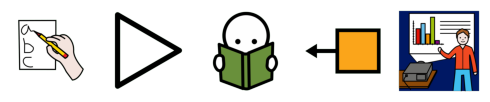

Oracion: pict_6936_bienvenido pict_5553_primavera
2
Procesando: ./imagenes_procesadas/pict_6936.png
Procesando: ./imagenes_procesadas/pict_5553.png


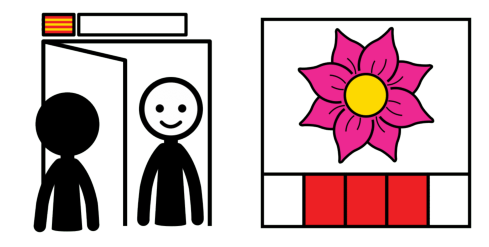

Prediction bienvenida pict_2248_agua
2
['bienvenida', './imagenes_procesadas/pict_2248.png']
Procesando: bienvenida
Procesando: ./imagenes_procesadas/pict_2248.png


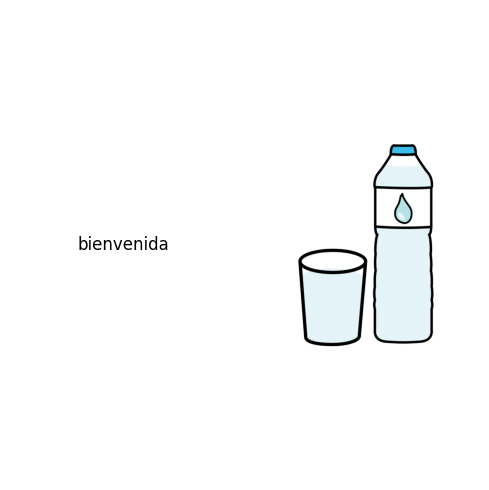

Oracion: pict_35653_organizar pict_12264_mi pict_7217_pregunta pict_9870_exposición
4
Procesando: ./imagenes_procesadas/pict_35653.png
Procesando: ./imagenes_procesadas/pict_12264.png
Procesando: ./imagenes_procesadas/pict_7217.png
Procesando: ./imagenes_procesadas/pict_9870.png


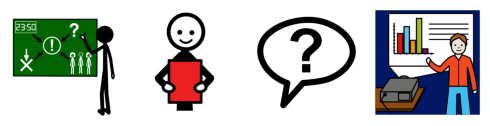

Prediction pict_15485_usar pict_12281_tu pict_7217_pregunta pict_7194_para pict_7029_la pict_37340_texto
6
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_12281.png', './imagenes_procesadas/pict_7217.png', './imagenes_procesadas/pict_7194.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_37340.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_12281.png
Procesando: ./imagenes_procesadas/pict_7217.png
Procesando: ./imagenes_procesadas/pict_7194.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_37340.png


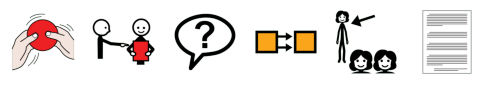

Oracion: pict_6461_contar pict_8476_el pict_8346_cuento
3
Procesando: ./imagenes_procesadas/pict_6461.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_8346.png


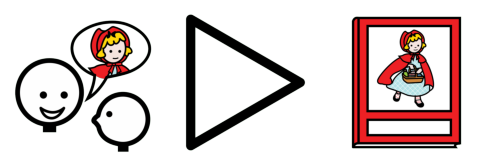

Prediction pict_7217_pregunta pict_8476_el pict_7217_pregunta
3
['./imagenes_procesadas/pict_7217.png', './imagenes_procesadas/pict_8476.png', './imagenes_procesadas/pict_7217.png']
Procesando: ./imagenes_procesadas/pict_7217.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_7217.png


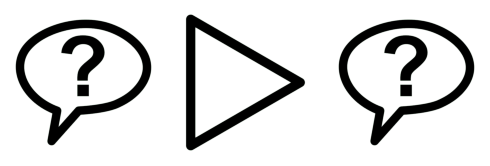

Oracion: pict_37407_escribir_el_nombre
1
Procesando: ./imagenes_procesadas/pict_37407.png


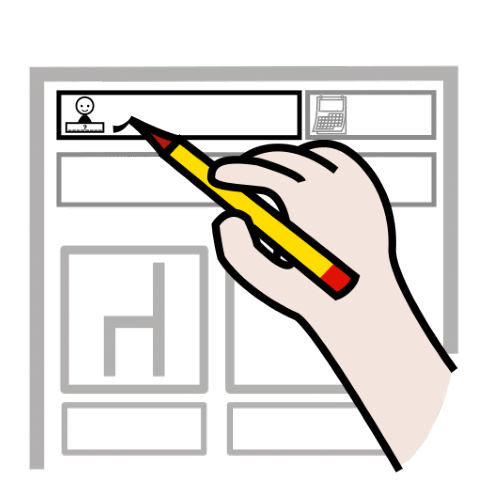

Prediction pict_2380_escribir pict_12281_tu pict_37340_texto
3
['./imagenes_procesadas/pict_2380.png', './imagenes_procesadas/pict_12281.png', './imagenes_procesadas/pict_37340.png']
Procesando: ./imagenes_procesadas/pict_2380.png
Procesando: ./imagenes_procesadas/pict_12281.png
Procesando: ./imagenes_procesadas/pict_37340.png


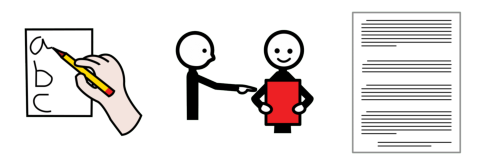

Oracion: pict_2474_observar pict_8477_los pict_3057_árbol pict_11712_del pict_2683_campo
5
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_8477.png
Procesando: ./imagenes_procesadas/pict_3057.png
Procesando: ./imagenes_procesadas/pict_11712.png
Procesando: ./imagenes_procesadas/pict_2683.png


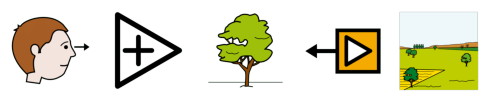

Prediction pict_8579_explicar pict_7033_los pict_2248_agua pict_11712_del pict_9819_lugar
5
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_7033.png', './imagenes_procesadas/pict_2248.png', './imagenes_procesadas/pict_11712.png', './imagenes_procesadas/pict_9819.png']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_7033.png
Procesando: ./imagenes_procesadas/pict_2248.png
Procesando: ./imagenes_procesadas/pict_11712.png
Procesando: ./imagenes_procesadas/pict_9819.png


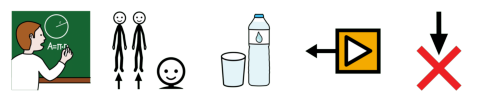

Oracion: pict_2474_mirar pict_12283_tus pict_36539_fortaleza
3
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_12283.png
Procesando: ./imagenes_procesadas/pict_36539.png


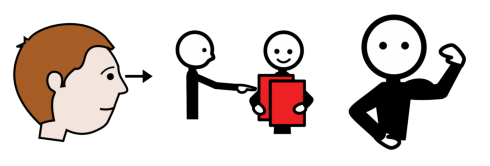

Prediction pict_8579_explicar pict_12281_tu pict_11572_plantas
3
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_12281.png', './imagenes_procesadas/pict_11572.png']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_12281.png
Procesando: ./imagenes_procesadas/pict_11572.png


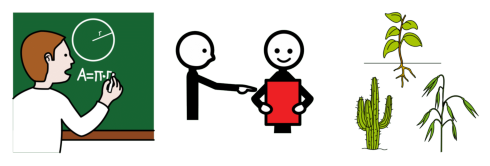

Oracion: pict_11698_elaborar pict_8474_un pict_8065_cartel
3
Procesando: ./imagenes_procesadas/pict_11698.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_8065.png


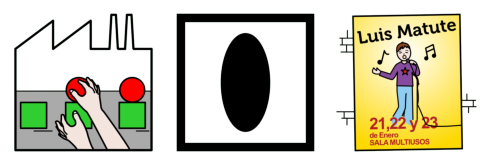

Prediction pict_15485_usar pict_8474_un pict_9819_lugar
3
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_9819.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_9819.png


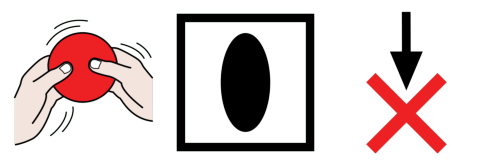

Oracion: pict_2872_ordenar pict_8476_la pict_11297_maleta
3
Procesando: ./imagenes_procesadas/pict_2872.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_11297.png


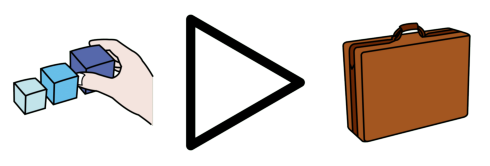

Prediction pict_35653_organizar pict_7029_la pict_22769_artesanía
3
['./imagenes_procesadas/pict_35653.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_22769.png']
Procesando: ./imagenes_procesadas/pict_35653.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_22769.png


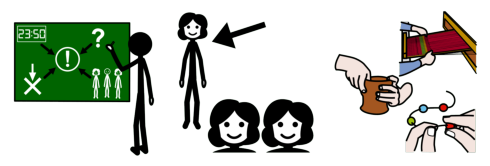

Oracion: pict_32067_acciones pict_7813_sin pict_38796_pensar
3
Procesando: ./imagenes_procesadas/pict_32067.png
Procesando: ./imagenes_procesadas/pict_7813.png
Procesando: ./imagenes_procesadas/pict_38796.png


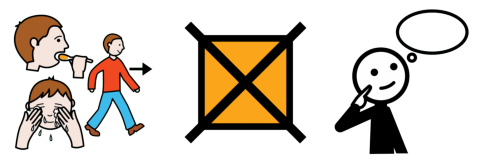

Prediction pict_11572_plantas pict_7064_con pict_11749_hacer
3
['./imagenes_procesadas/pict_11572.png', './imagenes_procesadas/pict_7064.png', './imagenes_procesadas/pict_11749.png']
Procesando: ./imagenes_procesadas/pict_11572.png
Procesando: ./imagenes_procesadas/pict_7064.png
Procesando: ./imagenes_procesadas/pict_11749.png


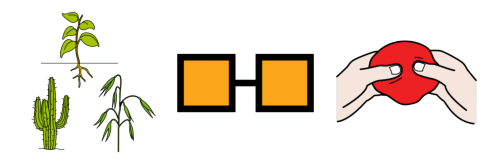

Oracion: pict_11749_hacer pict_8474_un pict_8088_dibujar
3
Procesando: ./imagenes_procesadas/pict_11749.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_8088.png


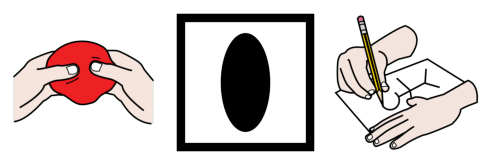

Prediction pict_11749_hacer pict_8474_un pict_37340_texto
3
['./imagenes_procesadas/pict_11749.png', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_37340.png']
Procesando: ./imagenes_procesadas/pict_11749.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_37340.png


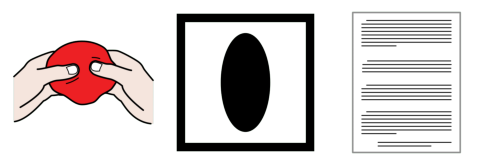

Oracion: pict_2474_observar pict_4896_8 pict_37947_platos
3
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_4896.png
Procesando: ./imagenes_procesadas/pict_37947.png


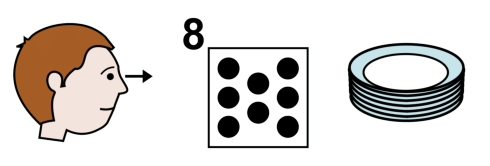

Prediction pict_2474_observar pict_7033_los pict_11709_al pict_11572_plantas pict_9819_lugar
5
['./imagenes_procesadas/pict_2474.png', './imagenes_procesadas/pict_7033.png', './imagenes_procesadas/pict_11709.png', './imagenes_procesadas/pict_11572.png', './imagenes_procesadas/pict_9819.png']
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_7033.png
Procesando: ./imagenes_procesadas/pict_11709.png
Procesando: ./imagenes_procesadas/pict_11572.png
Procesando: ./imagenes_procesadas/pict_9819.png


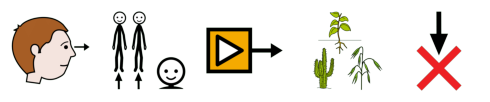

Oracion: pict_2474_observar pict_8476_la pict_17208_cartulina pict_2808_rojo
4
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_17208.png
Procesando: ./imagenes_procesadas/pict_2808.png


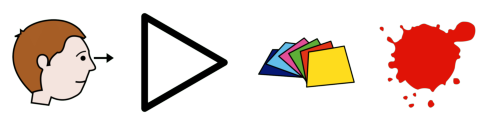

Prediction pict_8579_explicar pict_7029_la pict_2248_agua pict_7074_de pict_9819_lugar pict_4604_claro
6
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_2248.png', './imagenes_procesadas/pict_7074.png', './imagenes_procesadas/pict_9819.png', './imagenes_procesadas/pict_4604.png']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_2248.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_9819.png
Procesando: ./imagenes_procesadas/pict_4604.png


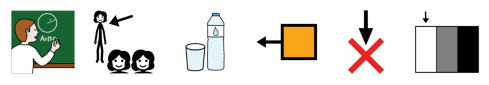

Oracion: pict_37870_registro_de_la_propiedad
1
Procesando: ./imagenes_procesadas/pict_37870.png


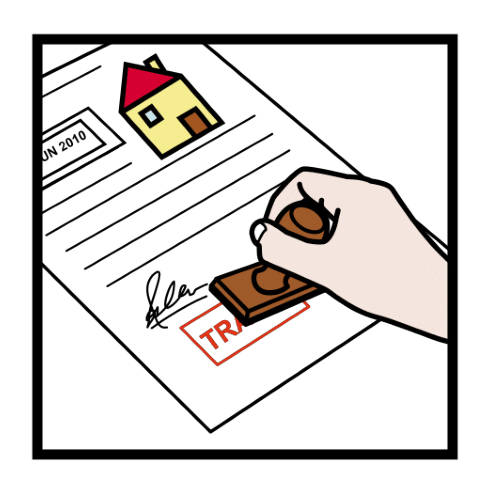

Prediction registros pict_7074_de pict_7029_la propiedad
4
['registros', './imagenes_procesadas/pict_7074.png', './imagenes_procesadas/pict_7029.png', 'propiedad']
Procesando: registros
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: propiedad


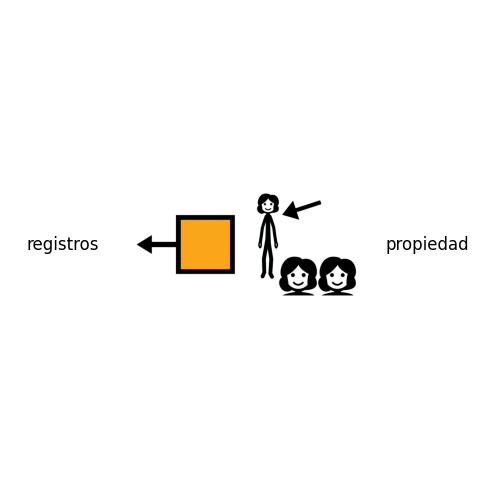

Oracion: pict_32602_alimentos_y_bebidas
1
Procesando: ./imagenes_procesadas/pict_32602.png


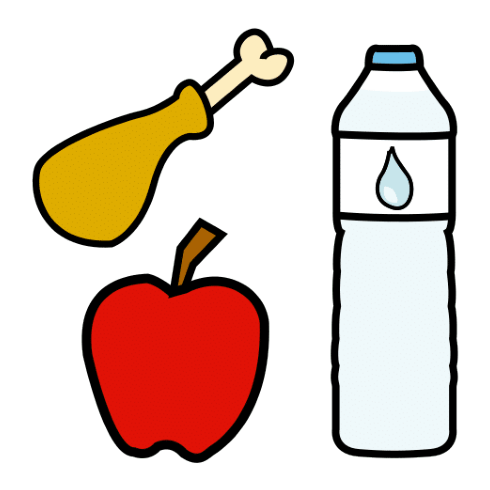

Prediction pict_2248_agua pict_3047_y pict_11572_plantas
3
['./imagenes_procesadas/pict_2248.png', './imagenes_procesadas/pict_3047.png', './imagenes_procesadas/pict_11572.png']
Procesando: ./imagenes_procesadas/pict_2248.png
Procesando: ./imagenes_procesadas/pict_3047.png
Procesando: ./imagenes_procesadas/pict_11572.png


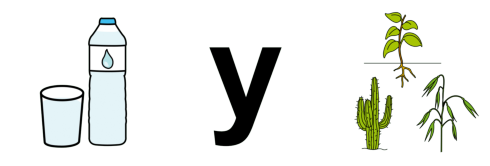

Oracion: pict_11698_crear pict_11316_nueva pict_9899_información
3
Procesando: ./imagenes_procesadas/pict_11698.png
Procesando: ./imagenes_procesadas/pict_11316.png
Procesando: ./imagenes_procesadas/pict_9899.png


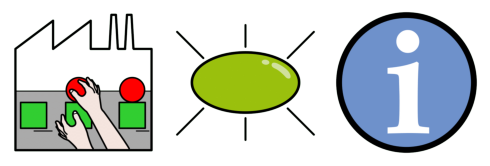

Prediction pict_15485_usar pict_8474_una pict_37340_texto
3
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_37340.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_37340.png


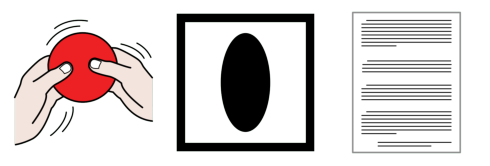

Oracion: pict_9847_preguntar
1
Procesando: ./imagenes_procesadas/pict_9847.png


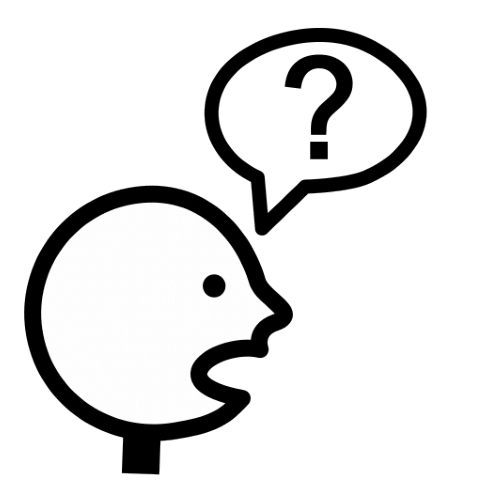

Prediction pict_3345_hablar
1
['./imagenes_procesadas/pict_3345.png']
Procesando: ./imagenes_procesadas/pict_3345.png


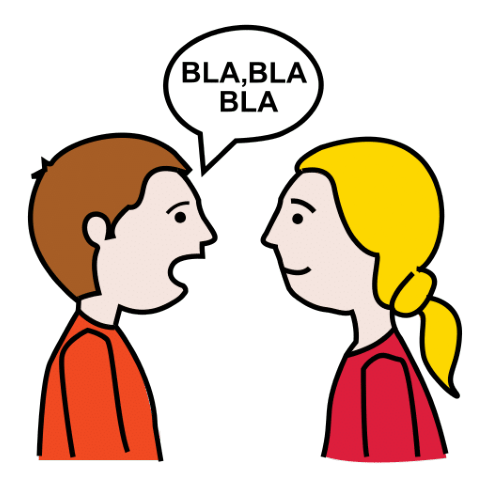

Oracion: pict_5441_yo_quiero pict_15320_investigar
2
Procesando: ./imagenes_procesadas/pict_5441.png
Procesando: ./imagenes_procesadas/pict_15320.png


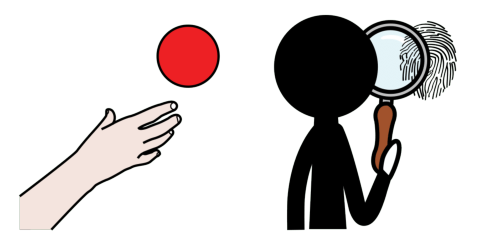

Prediction pict_15485_usar pict_7271_tener pict_2380_escribir
3
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_2380.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_2380.png


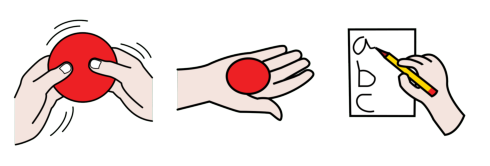

Oracion: pict_31807_yo pict_3241_pelota pict_4658_grande
3
Procesando: ./imagenes_procesadas/pict_31807.png
Procesando: ./imagenes_procesadas/pict_3241.png
Procesando: ./imagenes_procesadas/pict_4658.png


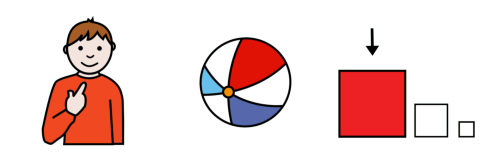

Prediction pict_12281_tu pict_22769_artesanía pict_11470_importante
3
['./imagenes_procesadas/pict_12281.png', './imagenes_procesadas/pict_22769.png', './imagenes_procesadas/pict_11470.png']
Procesando: ./imagenes_procesadas/pict_12281.png
Procesando: ./imagenes_procesadas/pict_22769.png
Procesando: ./imagenes_procesadas/pict_11470.png


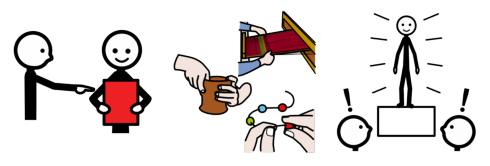

Oracion: pict_11745_colocar_la_toalla pict_7041_a pict_8476_la pict_4672_izquierda
4
Procesando: ./imagenes_procesadas/pict_11745.png
Procesando: ./imagenes_procesadas/pict_7041.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_4672.png


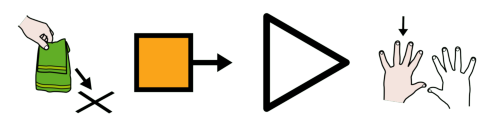

Prediction pict_35653_organizar pict_7029_la pict_22769_artesanía pict_3021_a pict_7029_la pict_35477_paso
6
['./imagenes_procesadas/pict_35653.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_22769.png', './imagenes_procesadas/pict_3021.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_35477.png']
Procesando: ./imagenes_procesadas/pict_35653.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_22769.png
Procesando: ./imagenes_procesadas/pict_3021.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_35477.png


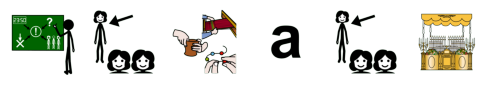

Oracion: pict_2380_escribir pict_8474_un pict_36356_carta_a_papá_noel
3
Procesando: ./imagenes_procesadas/pict_2380.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_36356.png


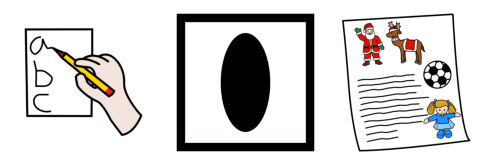

Prediction pict_2380_escribir pict_8474_una pict_9897_información
3
['./imagenes_procesadas/pict_2380.png', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_9897.png']
Procesando: ./imagenes_procesadas/pict_2380.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_9897.png


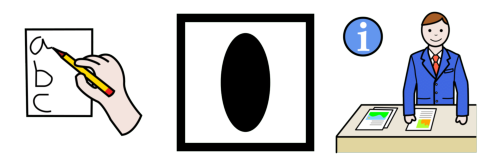

Oracion: pict_37217_conversar pict_7813_sin pict_7120_gritar
3
Procesando: ./imagenes_procesadas/pict_37217.png
Procesando: ./imagenes_procesadas/pict_7813.png
Procesando: ./imagenes_procesadas/pict_7120.png


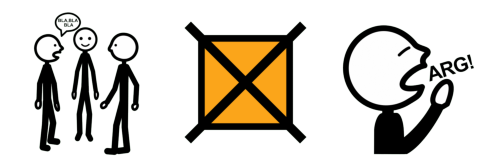

Prediction pict_3345_hablar pict_7212_por pict_11691_cuidar
3
['./imagenes_procesadas/pict_3345.png', './imagenes_procesadas/pict_7212.png', './imagenes_procesadas/pict_11691.png']
Procesando: ./imagenes_procesadas/pict_3345.png
Procesando: ./imagenes_procesadas/pict_7212.png
Procesando: ./imagenes_procesadas/pict_11691.png


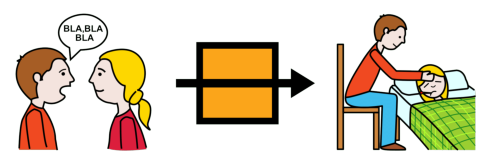

Oracion: pict_2474_observar pict_8476_la pict_2529_plastilina
3
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_2529.png


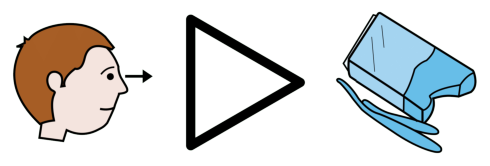

Prediction pict_8579_explicar pict_7029_la plastilina
3
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_7029.png', 'plastilina']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: plastilina


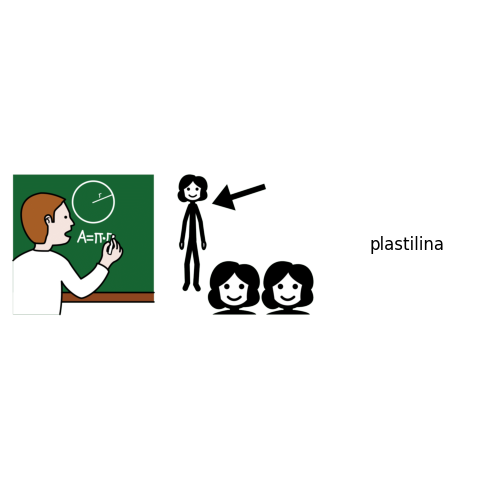

Oracion: pict_2369_dormir pict_12266_mis pict_4896_8 pict_38797_24_horas
4
Procesando: ./imagenes_procesadas/pict_2369.png
Procesando: ./imagenes_procesadas/pict_12266.png
Procesando: ./imagenes_procesadas/pict_4896.png
Procesando: ./imagenes_procesadas/pict_38797.png


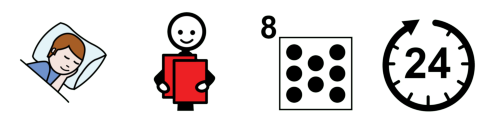

Prediction pict_11691_cuidar pict_12281_tu pict_2628_dos pict_2248_agua
4
['./imagenes_procesadas/pict_11691.png', './imagenes_procesadas/pict_12281.png', './imagenes_procesadas/pict_2628.png', './imagenes_procesadas/pict_2248.png']
Procesando: ./imagenes_procesadas/pict_11691.png
Procesando: ./imagenes_procesadas/pict_12281.png
Procesando: ./imagenes_procesadas/pict_2628.png
Procesando: ./imagenes_procesadas/pict_2248.png


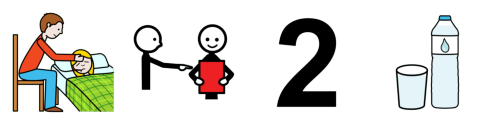

Oracion: pict_22620_qué pict_11719_descripción
2
Procesando: ./imagenes_procesadas/pict_22620.png
Procesando: ./imagenes_procesadas/pict_11719.png


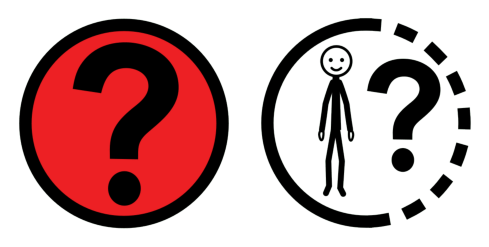

Prediction pict_3415_¿ pict_22624_qué describiré pict_3418_?
4
['./imagenes_procesadas/pict_3415.png', './imagenes_procesadas/pict_22624.png', 'describiré', './imagenes_procesadas/pict_3418.png']
Procesando: ./imagenes_procesadas/pict_3415.png
Procesando: ./imagenes_procesadas/pict_22624.png
Procesando: describiré
Procesando: ./imagenes_procesadas/pict_3418.png


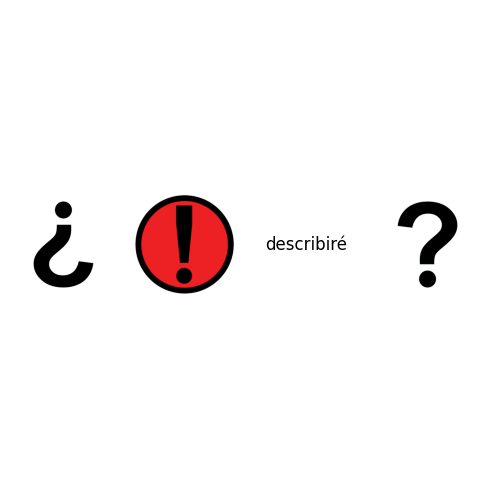

Oracion: pict_8476_la pict_7066_contaminación
2
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_7066.png


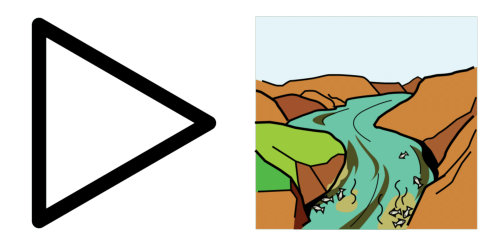

Prediction pict_7029_la pict_2248_agua
2
['./imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_2248.png']
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_2248.png


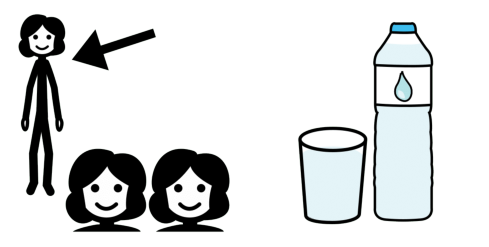

Oracion: pict_22619_cómo pict_3429_hacer_pis
2
Procesando: ./imagenes_procesadas/pict_22619.png
Procesando: ./imagenes_procesadas/pict_3429.png


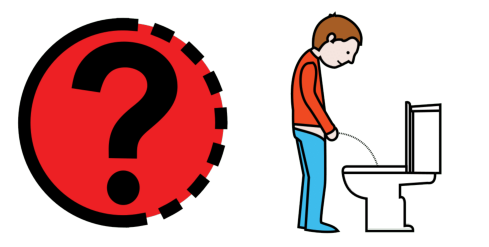

Prediction pict_22619_cómo pict_11749_hacer pict_35477_paso
3
['./imagenes_procesadas/pict_22619.png', './imagenes_procesadas/pict_11749.png', './imagenes_procesadas/pict_35477.png']
Procesando: ./imagenes_procesadas/pict_22619.png
Procesando: ./imagenes_procesadas/pict_11749.png
Procesando: ./imagenes_procesadas/pict_35477.png


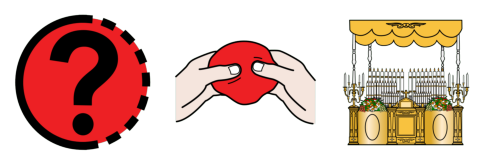

Oracion: pict_5441_quiero pict_6492_entrevistar
2
Procesando: ./imagenes_procesadas/pict_5441.png
Procesando: ./imagenes_procesadas/pict_6492.png


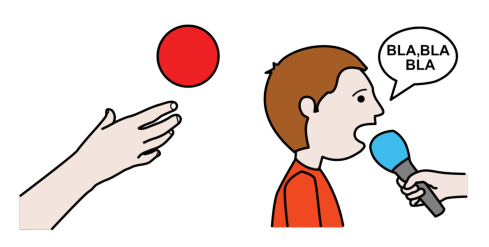

Prediction pict_15485_usar pict_7271_tener pict_9030_responder
3
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_9030.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_9030.png


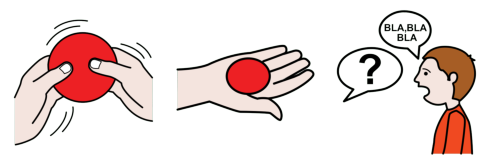

Oracion: pict_2474_observar pict_8476_la pict_16980_tienda_de_animales
3
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_16980.png


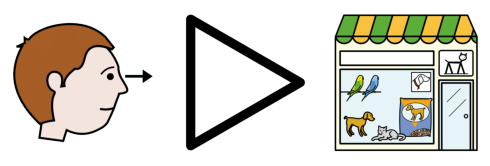

Prediction observen pict_7029_la pict_4649_feria pict_7074_de pict_11351_que
5
['observen', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_4649.png', './imagenes_procesadas/pict_7074.png', './imagenes_procesadas/pict_11351.png']
Procesando: observen
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_4649.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_11351.png


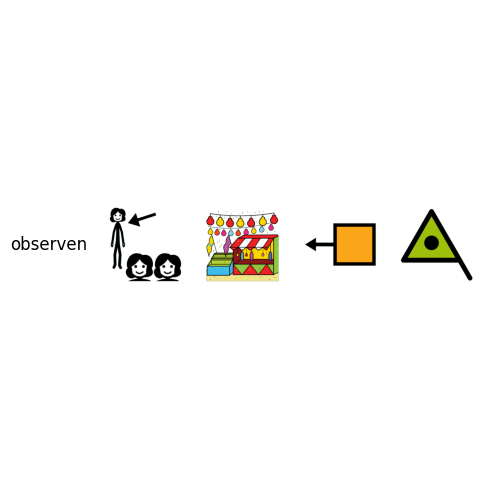

Oracion: pict_2474_observar pict_8476_la pict_24408_sinagoga
3
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_24408.png


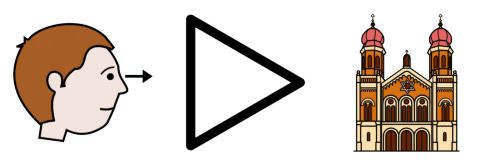

Prediction pict_2474_observar pict_7029_la sinagoga
3
['./imagenes_procesadas/pict_2474.png', './imagenes_procesadas/pict_7029.png', 'sinagoga']
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: sinagoga


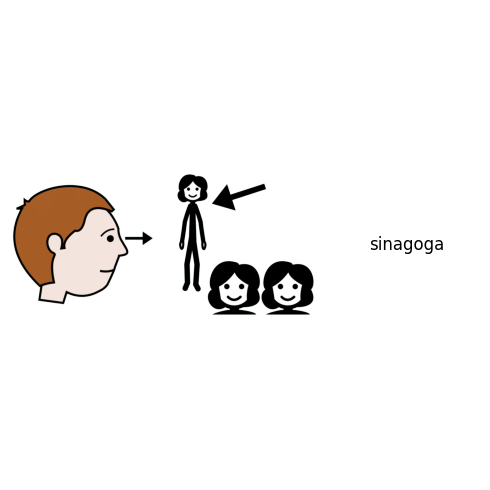

Oracion: pict_35669_explicar pict_5306_rápido
2
Procesando: ./imagenes_procesadas/pict_35669.png
Procesando: ./imagenes_procesadas/pict_5306.png


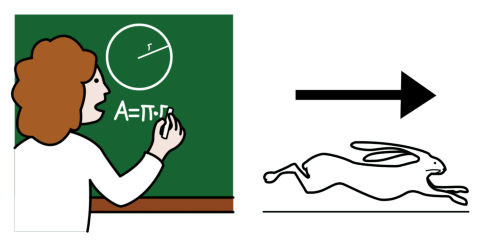

Prediction pict_2380_escribir pict_11470_importante
2
['./imagenes_procesadas/pict_2380.png', './imagenes_procesadas/pict_11470.png']
Procesando: ./imagenes_procesadas/pict_2380.png
Procesando: ./imagenes_procesadas/pict_11470.png


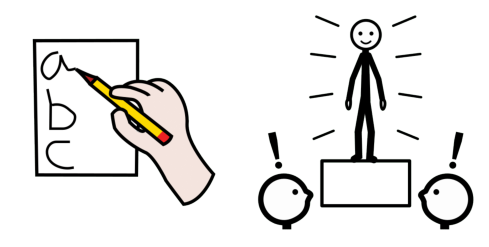

Oracion: pict_35653_organizar pict_8476_la pict_9870_exponer
3
Procesando: ./imagenes_procesadas/pict_35653.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_9870.png


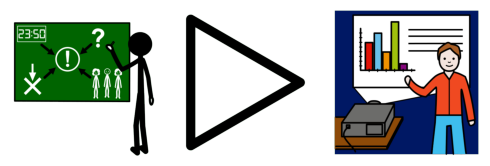

Prediction pict_15485_usar pict_7029_la pict_37340_texto
3
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_37340.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_37340.png


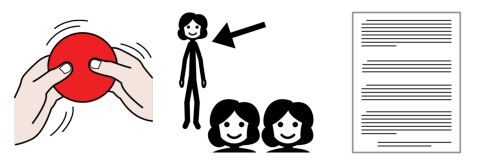

Oracion: pict_17042_recibir pict_8476_el pict_27724_diploma
3
Procesando: ./imagenes_procesadas/pict_17042.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_27724.png


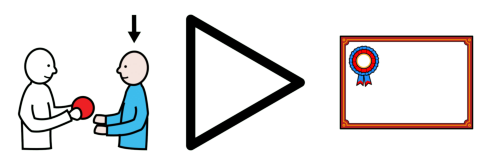

Prediction pict_11691_cuidar pict_8476_el pict_8185_Perú
3
['./imagenes_procesadas/pict_11691.png', './imagenes_procesadas/pict_8476.png', './imagenes_procesadas/pict_8185.png']
Procesando: ./imagenes_procesadas/pict_11691.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_8185.png


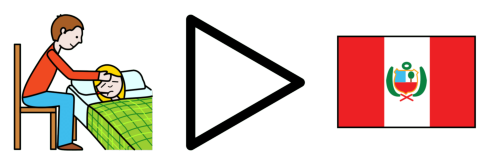

Oracion: pict_22620_qué pict_6901_animales pict_30510_escoger
3
Procesando: ./imagenes_procesadas/pict_22620.png
Procesando: ./imagenes_procesadas/pict_6901.png
Procesando: ./imagenes_procesadas/pict_30510.png


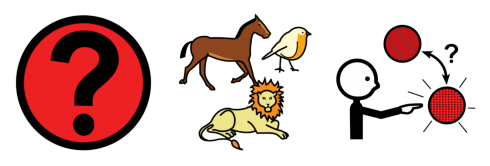

Prediction pict_3415_¿ pict_22624_qué pict_6901_animales pict_35653_organizar pict_3418_?
5
['./imagenes_procesadas/pict_3415.png', './imagenes_procesadas/pict_22624.png', './imagenes_procesadas/pict_6901.png', './imagenes_procesadas/pict_35653.png', './imagenes_procesadas/pict_3418.png']
Procesando: ./imagenes_procesadas/pict_3415.png
Procesando: ./imagenes_procesadas/pict_22624.png
Procesando: ./imagenes_procesadas/pict_6901.png
Procesando: ./imagenes_procesadas/pict_35653.png
Procesando: ./imagenes_procesadas/pict_3418.png


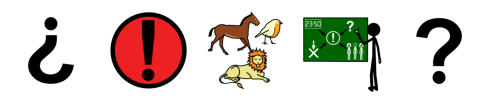

Oracion: pict_37407_escribir_el_nombre pict_11712_del pict_7176_niño
3
Procesando: ./imagenes_procesadas/pict_37407.png
Procesando: ./imagenes_procesadas/pict_11712.png
Procesando: ./imagenes_procesadas/pict_7176.png


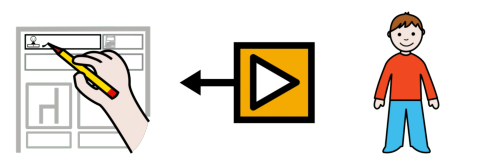

Prediction pict_2380_escribir pict_8476_el pict_37340_texto pict_11712_del pict_9819_lugar
5
['./imagenes_procesadas/pict_2380.png', './imagenes_procesadas/pict_8476.png', './imagenes_procesadas/pict_37340.png', './imagenes_procesadas/pict_11712.png', './imagenes_procesadas/pict_9819.png']
Procesando: ./imagenes_procesadas/pict_2380.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_37340.png
Procesando: ./imagenes_procesadas/pict_11712.png
Procesando: ./imagenes_procesadas/pict_9819.png


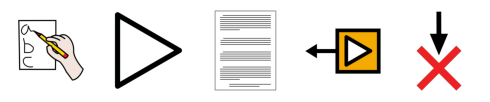

Oracion: pict_34707_orientador pict_6632_mí pict_38917_camino_escolar
3
Procesando: ./imagenes_procesadas/pict_34707.png
Procesando: ./imagenes_procesadas/pict_6632.png
Procesando: ./imagenes_procesadas/pict_38917.png


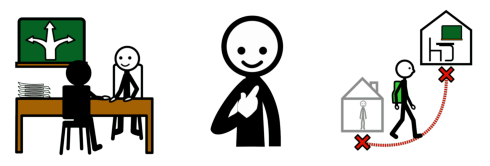

Prediction reforzar pict_12281_tu pict_9870_exposición pict_3021_a pict_9819_lugar
5
['reforzar', './imagenes_procesadas/pict_12281.png', './imagenes_procesadas/pict_9870.png', './imagenes_procesadas/pict_3021.png', './imagenes_procesadas/pict_9819.png']
Procesando: reforzar
Procesando: ./imagenes_procesadas/pict_12281.png
Procesando: ./imagenes_procesadas/pict_9870.png
Procesando: ./imagenes_procesadas/pict_3021.png
Procesando: ./imagenes_procesadas/pict_9819.png


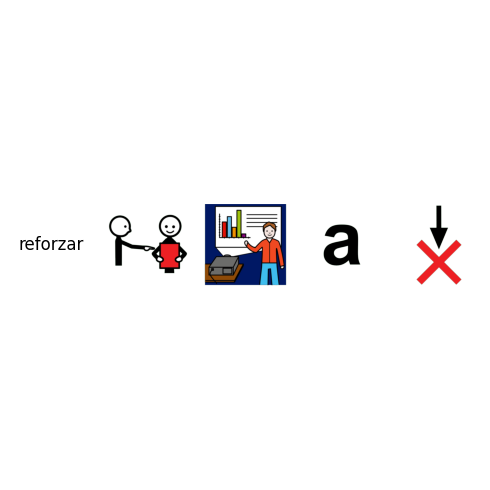

Oracion: pict_6979_5 pict_7138_kilogramo pict_7074_de pict_25560_azúcar
4
Procesando: ./imagenes_procesadas/pict_6979.png
Procesando: ./imagenes_procesadas/pict_7138.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_25560.png


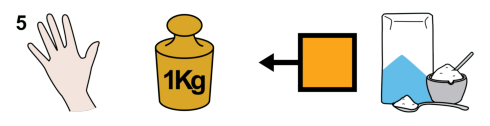

Prediction pict_11709_al kilogramos pict_7074_de pict_2248_agua
4
['./imagenes_procesadas/pict_11709.png', 'kilogramos', './imagenes_procesadas/pict_7074.png', './imagenes_procesadas/pict_2248.png']
Procesando: ./imagenes_procesadas/pict_11709.png
Procesando: kilogramos
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_2248.png


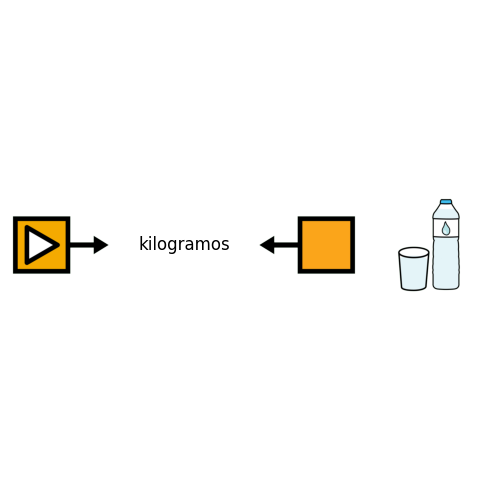

Oracion: pict_36964_señalar pict_8477_los pict_24214_órganos
3
Procesando: ./imagenes_procesadas/pict_36964.png
Procesando: ./imagenes_procesadas/pict_8477.png
Procesando: ./imagenes_procesadas/pict_24214.png


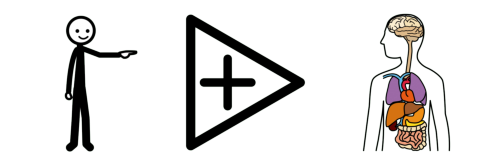

Prediction pict_9030_responder pict_7033_los pict_11572_plantas
3
['./imagenes_procesadas/pict_9030.png', './imagenes_procesadas/pict_7033.png', './imagenes_procesadas/pict_11572.png']
Procesando: ./imagenes_procesadas/pict_9030.png
Procesando: ./imagenes_procesadas/pict_7033.png
Procesando: ./imagenes_procesadas/pict_11572.png


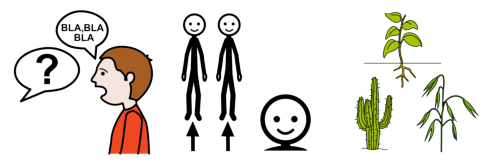

Oracion: pict_8477_las pict_6923_aves pict_32761_tener pict_8477_las pict_5477_garra pict_4658_grande
6
Procesando: ./imagenes_procesadas/pict_8477.png
Procesando: ./imagenes_procesadas/pict_6923.png
Procesando: ./imagenes_procesadas/pict_32761.png
Procesando: ./imagenes_procesadas/pict_8477.png
Procesando: ./imagenes_procesadas/pict_5477.png
Procesando: ./imagenes_procesadas/pict_4658.png


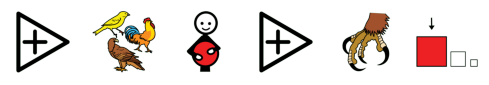

Prediction pict_7031_las pict_2248_agua pict_7271_tener pict_7031_las pict_22769_artesanía pict_11470_importante
6
['./imagenes_procesadas/pict_7031.png', './imagenes_procesadas/pict_2248.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_7031.png', './imagenes_procesadas/pict_22769.png', './imagenes_procesadas/pict_11470.png']
Procesando: ./imagenes_procesadas/pict_7031.png
Procesando: ./imagenes_procesadas/pict_2248.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_7031.png
Procesando: ./imagenes_procesadas/pict_22769.png
Procesando: ./imagenes_procesadas/pict_11470.png


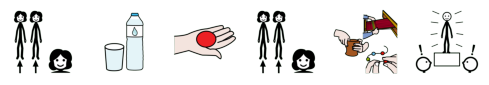

Oracion: pict_31750_tímido
1
Procesando: ./imagenes_procesadas/pict_31750.png


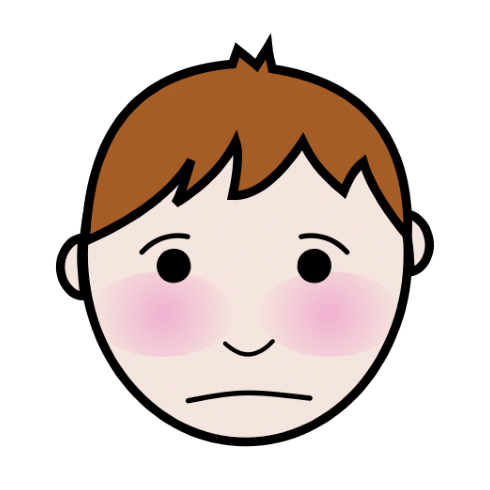

Prediction pict_5581_ser pict_4604_claro
2
['./imagenes_procesadas/pict_5581.png', './imagenes_procesadas/pict_4604.png']
Procesando: ./imagenes_procesadas/pict_5581.png
Procesando: ./imagenes_procesadas/pict_4604.png


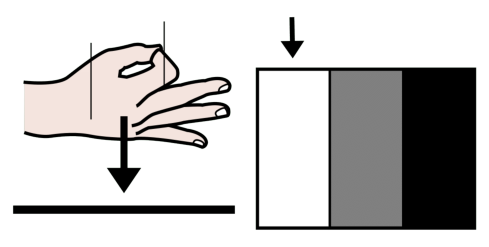

Oracion: pict_35653_organizar pict_8477_los pict_32586_colores_y_formas
3
Procesando: ./imagenes_procesadas/pict_35653.png
Procesando: ./imagenes_procesadas/pict_8477.png
Procesando: ./imagenes_procesadas/pict_32586.png


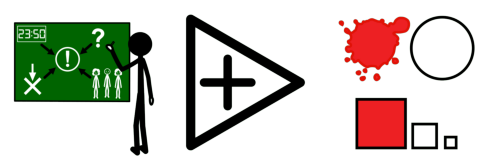

Prediction pict_15485_usar pict_7033_los pict_9819_lugar pict_3047_y pict_3189_,
5
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_7033.png', './imagenes_procesadas/pict_9819.png', './imagenes_procesadas/pict_3047.png', './imagenes_procesadas/pict_3189.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_7033.png
Procesando: ./imagenes_procesadas/pict_9819.png
Procesando: ./imagenes_procesadas/pict_3047.png
Procesando: ./imagenes_procesadas/pict_3189.png


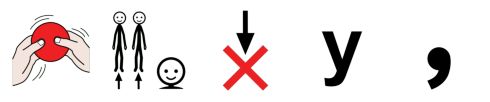

Oracion: pict_11698_elaborar pict_8474_un pict_21800_diseñar
3
Procesando: ./imagenes_procesadas/pict_11698.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_21800.png


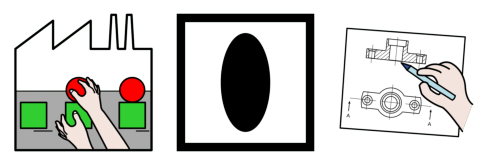

Prediction pict_15485_usar pict_8474_un diseño
3
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_8474.png', 'diseño']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: diseño


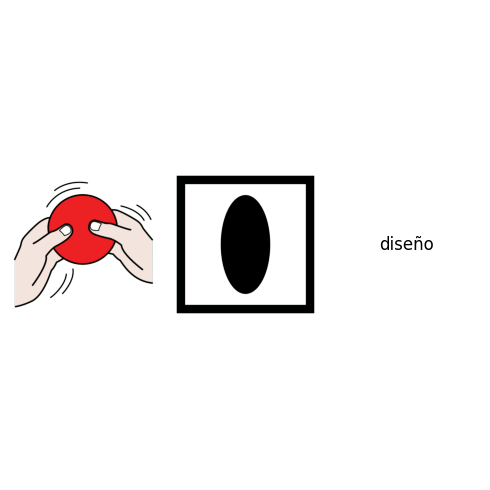

Oracion: pict_17040_dar pict_8474_una pict_30231_dirección
3
Procesando: ./imagenes_procesadas/pict_17040.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_30231.png


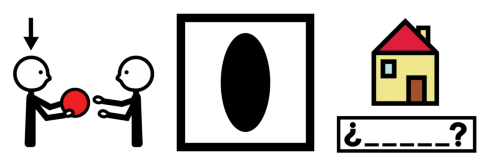

Prediction pict_7271_tener pict_8474_una pict_9870_exposición
3
['./imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_9870.png']
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_9870.png


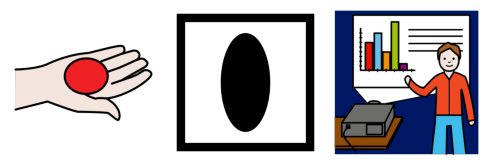

Oracion: pict_5526_no pict_6248_volver
2
Procesando: ./imagenes_procesadas/pict_5526.png
Procesando: ./imagenes_procesadas/pict_6248.png


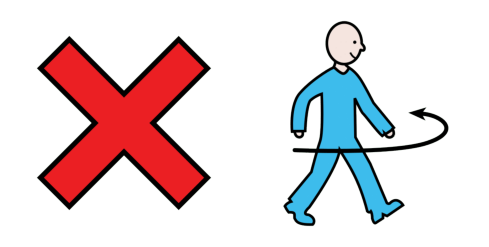

Prediction pict_5526_no pict_7271_tener
2
['./imagenes_procesadas/pict_5526.png', './imagenes_procesadas/pict_7271.png']
Procesando: ./imagenes_procesadas/pict_5526.png
Procesando: ./imagenes_procesadas/pict_7271.png


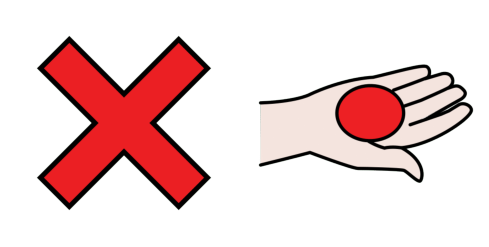

Oracion: pict_11308_mostrar pict_6625_tú pict_2359_cuaderno
3
Procesando: ./imagenes_procesadas/pict_11308.png
Procesando: ./imagenes_procesadas/pict_6625.png
Procesando: ./imagenes_procesadas/pict_2359.png


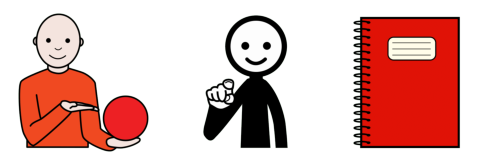

Prediction pict_8579_explicar pict_12281_tu pict_7141_leer
3
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_12281.png', './imagenes_procesadas/pict_7141.png']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_12281.png
Procesando: ./imagenes_procesadas/pict_7141.png


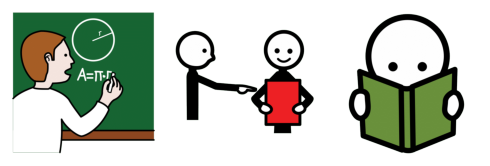

Oracion: pict_17040_dar pict_38021_educación
2
Procesando: ./imagenes_procesadas/pict_17040.png
Procesando: ./imagenes_procesadas/pict_38021.png


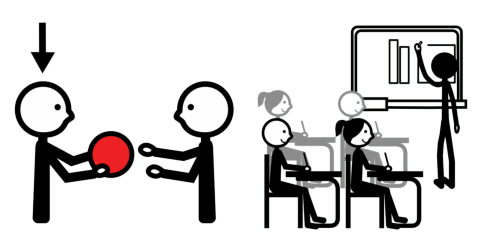

Prediction pict_7271_tener pict_2248_agua
2
['./imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_2248.png']
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_2248.png


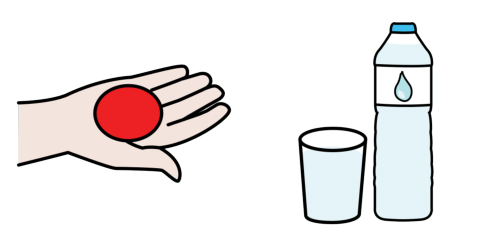

Oracion: pict_11599_muy_bien
1
Procesando: ./imagenes_procesadas/pict_11599.png


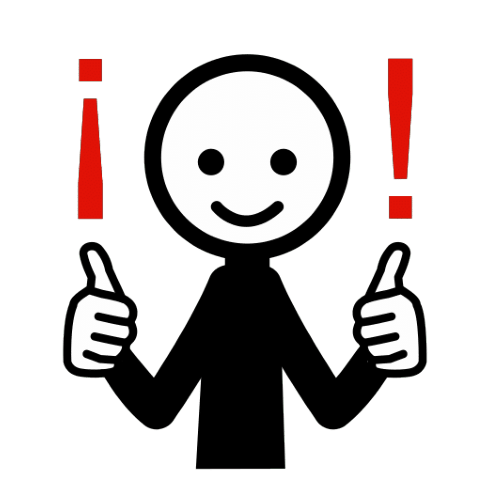

Prediction pict_3415_¿ vaya pict_3189_, pict_3189_,
4
['./imagenes_procesadas/pict_3415.png', 'vaya', './imagenes_procesadas/pict_3189.png', './imagenes_procesadas/pict_3189.png']
Procesando: ./imagenes_procesadas/pict_3415.png
Procesando: vaya
Procesando: ./imagenes_procesadas/pict_3189.png
Procesando: ./imagenes_procesadas/pict_3189.png


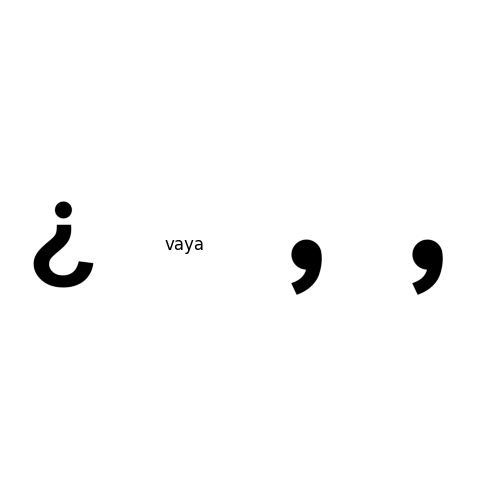

Oracion: pict_5441_yo_quiero pict_35979_estudiar pict_9870_exposición
3
Procesando: ./imagenes_procesadas/pict_5441.png
Procesando: ./imagenes_procesadas/pict_35979.png
Procesando: ./imagenes_procesadas/pict_9870.png


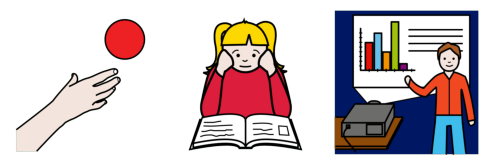

Prediction pict_6483_elegir pict_7271_tener pict_35653_organizar pict_7194_para pict_7029_la pict_37340_texto
6
['./imagenes_procesadas/pict_6483.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_35653.png', './imagenes_procesadas/pict_7194.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_37340.png']
Procesando: ./imagenes_procesadas/pict_6483.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_35653.png
Procesando: ./imagenes_procesadas/pict_7194.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_37340.png


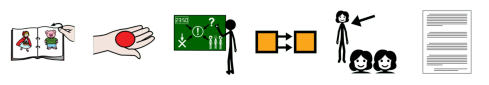

Oracion: pict_13358_quiénes pict_21385_asistir
2
Procesando: ./imagenes_procesadas/pict_13358.png
Procesando: ./imagenes_procesadas/pict_21385.png


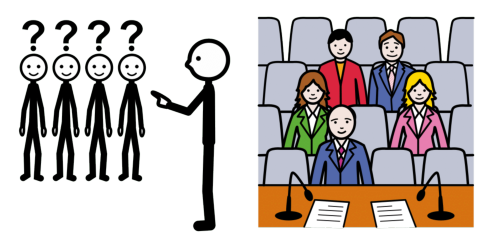

Prediction pict_3415_¿ pict_22619_cómo pict_11691_cuidar pict_3418_?
4
['./imagenes_procesadas/pict_3415.png', './imagenes_procesadas/pict_22619.png', './imagenes_procesadas/pict_11691.png', './imagenes_procesadas/pict_3418.png']
Procesando: ./imagenes_procesadas/pict_3415.png
Procesando: ./imagenes_procesadas/pict_22619.png
Procesando: ./imagenes_procesadas/pict_11691.png
Procesando: ./imagenes_procesadas/pict_3418.png


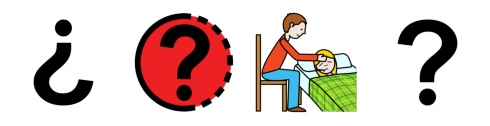

Oracion: pict_2474_observar pict_8476_la pict_36691_carne_envasada_de_pavo
3
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_36691.png


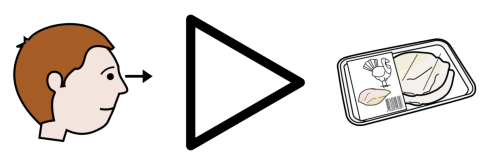

Prediction pict_8579_explicar pict_7029_la pict_2248_agua envasada pict_7074_de pict_11572_plantas
6
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_2248.png', 'envasada', './imagenes_procesadas/pict_7074.png', './imagenes_procesadas/pict_11572.png']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_2248.png
Procesando: envasada
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_11572.png


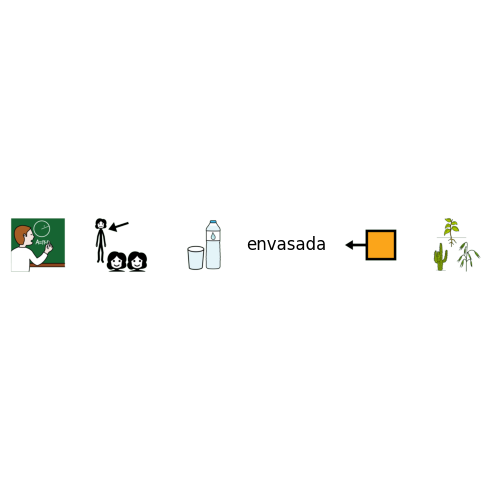

Oracion: pict_2474_observar pict_8477_los pict_12347_medios_de_comunicación
3
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_8477.png
Procesando: ./imagenes_procesadas/pict_12347.png


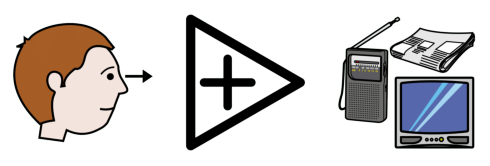

Prediction pict_2380_escribir pict_7033_los pict_2248_agua pict_7074_de comunicacion
5
['./imagenes_procesadas/pict_2380.png', './imagenes_procesadas/pict_7033.png', './imagenes_procesadas/pict_2248.png', './imagenes_procesadas/pict_7074.png', 'comunicacion']
Procesando: ./imagenes_procesadas/pict_2380.png
Procesando: ./imagenes_procesadas/pict_7033.png
Procesando: ./imagenes_procesadas/pict_2248.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: comunicacion


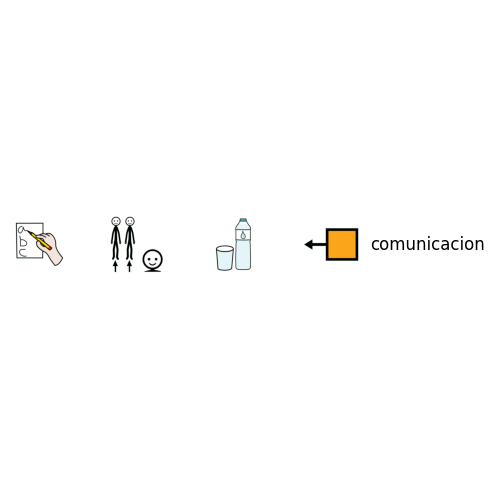

Oracion: pict_37870_registro_de_la_propiedad
1
Procesando: ./imagenes_procesadas/pict_37870.png


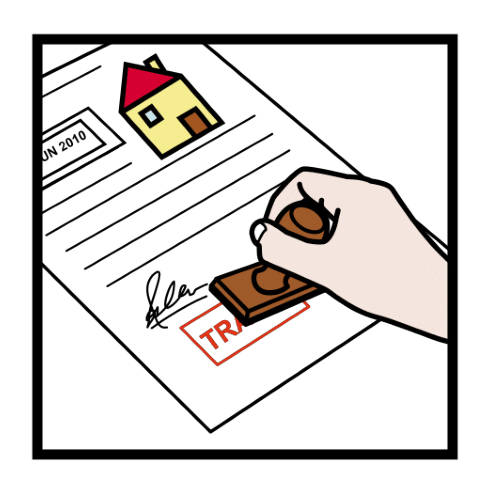

Prediction registros pict_7074_de pict_7029_la propiedad
4
['registros', './imagenes_procesadas/pict_7074.png', './imagenes_procesadas/pict_7029.png', 'propiedad']
Procesando: registros
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: propiedad


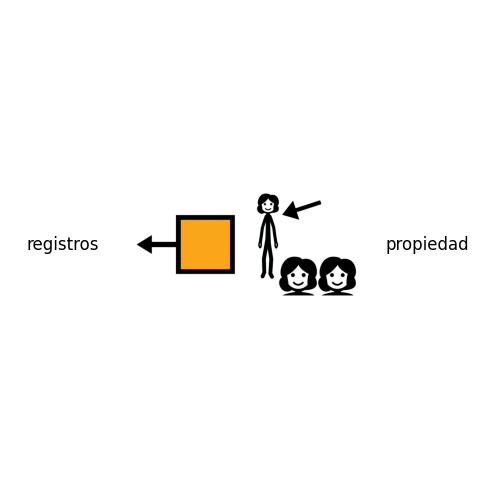

Oracion: pict_21800_diseñar pict_8474_un pict_2339_auto
3
Procesando: ./imagenes_procesadas/pict_21800.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_2339.png


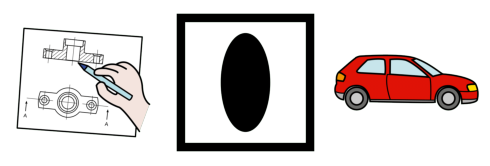

Prediction diseño pict_8474_un pict_2248_agua
3
['diseño', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_2248.png']
Procesando: diseño
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_2248.png


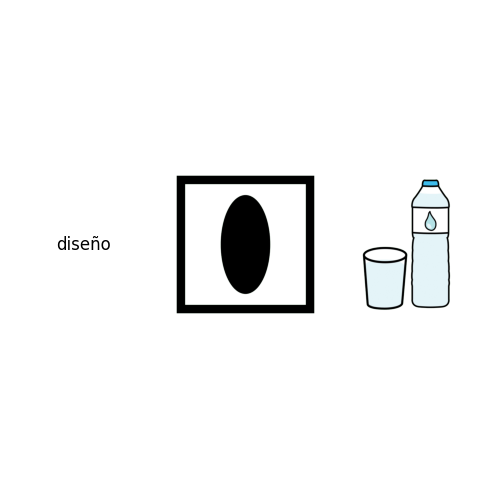

Oracion: pict_12266_mis pict_36539_fortaleza
2
Procesando: ./imagenes_procesadas/pict_12266.png
Procesando: ./imagenes_procesadas/pict_36539.png


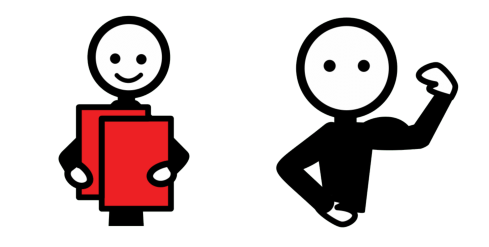

Prediction pict_7031_las pict_11572_plantas
2
['./imagenes_procesadas/pict_7031.png', './imagenes_procesadas/pict_11572.png']
Procesando: ./imagenes_procesadas/pict_7031.png
Procesando: ./imagenes_procesadas/pict_11572.png


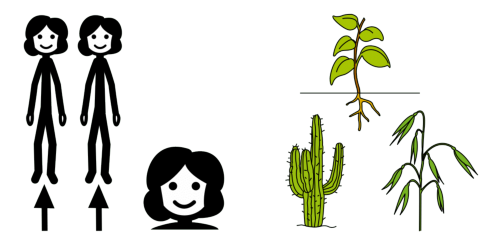

Oracion: pict_2813_revista
1
Procesando: ./imagenes_procesadas/pict_2813.png


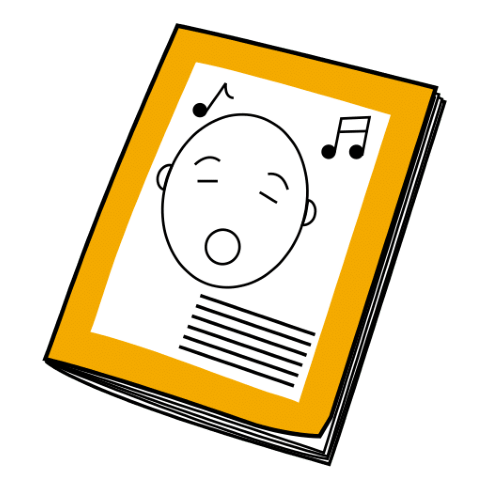

Prediction publicacion
1
['publicacion']
Procesando: publicacion


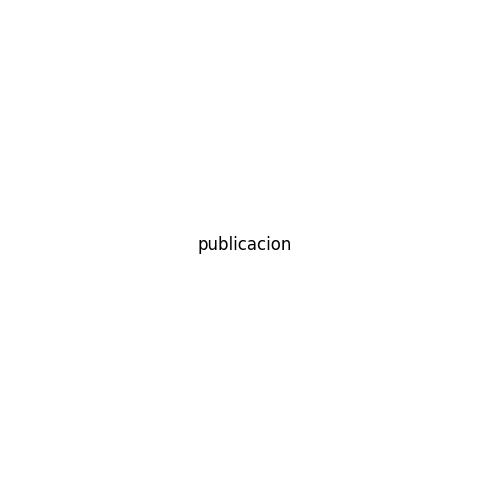

Oracion: pict_15485_usar pict_21568_protector_solar pict_6192_proteger pict_11712_del pict_7252_Sol
5
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_21568.png
Procesando: ./imagenes_procesadas/pict_6192.png
Procesando: ./imagenes_procesadas/pict_11712.png
Procesando: ./imagenes_procesadas/pict_7252.png


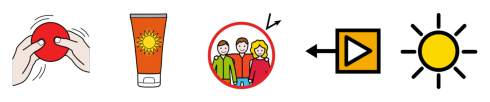

Prediction pict_15485_usar pict_2248_agua solar pict_7194_para pict_11691_cuidar pict_11712_del pict_2248_agua
7
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_2248.png', 'solar', './imagenes_procesadas/pict_7194.png', './imagenes_procesadas/pict_11691.png', './imagenes_procesadas/pict_11712.png', './imagenes_procesadas/pict_2248.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_2248.png
Procesando: solar
Procesando: ./imagenes_procesadas/pict_7194.png
Procesando: ./imagenes_procesadas/pict_11691.png
Procesando: ./imagenes_procesadas/pict_11712.png
Procesando: ./imagenes_procesadas/pict_2248.png


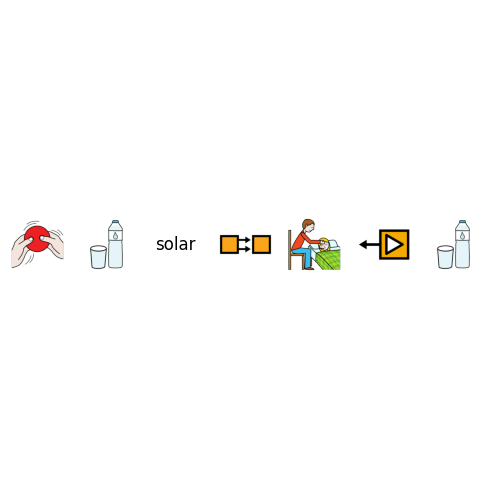

Oracion: pict_27357_nombre pict_11712_del pict_10203_famoso
3
Procesando: ./imagenes_procesadas/pict_27357.png
Procesando: ./imagenes_procesadas/pict_11712.png
Procesando: ./imagenes_procesadas/pict_10203.png


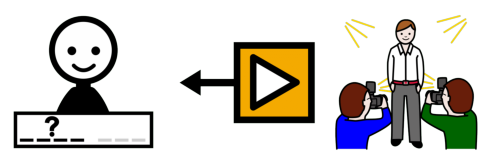

Prediction pict_37340_texto pict_11712_del pict_4604_claro
3
['./imagenes_procesadas/pict_37340.png', './imagenes_procesadas/pict_11712.png', './imagenes_procesadas/pict_4604.png']
Procesando: ./imagenes_procesadas/pict_37340.png
Procesando: ./imagenes_procesadas/pict_11712.png
Procesando: ./imagenes_procesadas/pict_4604.png


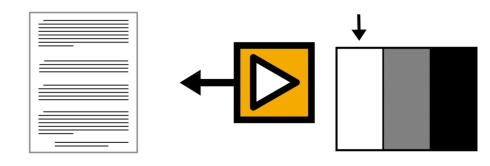

Oracion: pict_22007_obedecer pict_8476_el pict_34779_reglamento
3
Procesando: ./imagenes_procesadas/pict_22007.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_34779.png


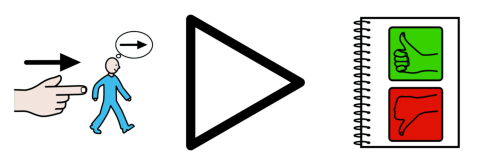

Prediction obedecer pict_8476_el reglamento
3
['obedecer', './imagenes_procesadas/pict_8476.png', 'reglamento']
Procesando: obedecer
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: reglamento


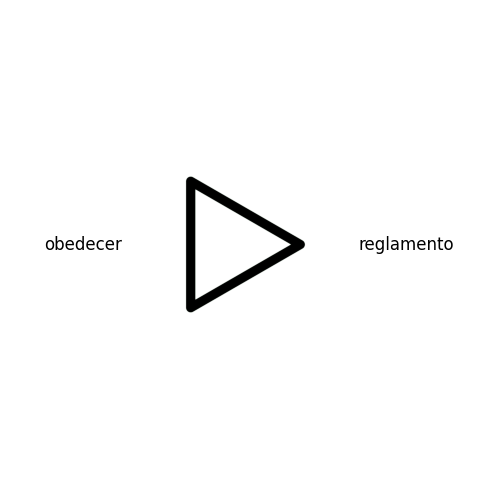

Oracion: pict_6009_hola pict_27363_no_entiendo
2
Procesando: ./imagenes_procesadas/pict_6009.png
Procesando: ./imagenes_procesadas/pict_27363.png


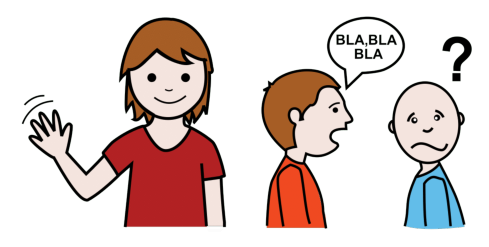

Prediction pict_11691_cuidar pict_3189_, pict_5526_no pict_11749_hacer
4
['./imagenes_procesadas/pict_11691.png', './imagenes_procesadas/pict_3189.png', './imagenes_procesadas/pict_5526.png', './imagenes_procesadas/pict_11749.png']
Procesando: ./imagenes_procesadas/pict_11691.png
Procesando: ./imagenes_procesadas/pict_3189.png
Procesando: ./imagenes_procesadas/pict_5526.png
Procesando: ./imagenes_procesadas/pict_11749.png


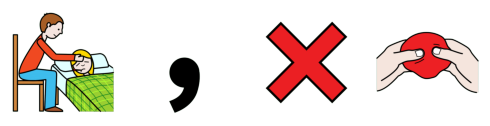

Oracion: pict_6557_martes
1
Procesando: ./imagenes_procesadas/pict_6557.png


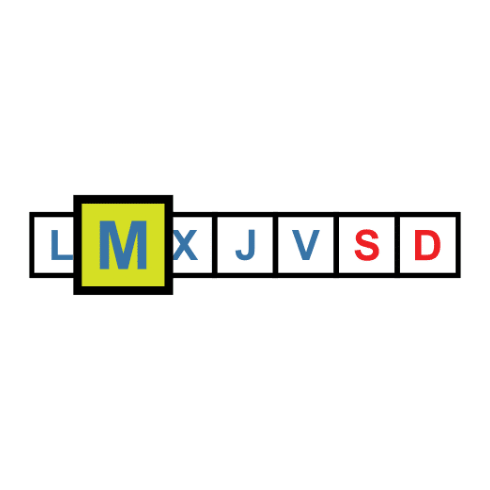

Prediction pict_2359_cuaderno
1
['./imagenes_procesadas/pict_2359.png']
Procesando: ./imagenes_procesadas/pict_2359.png


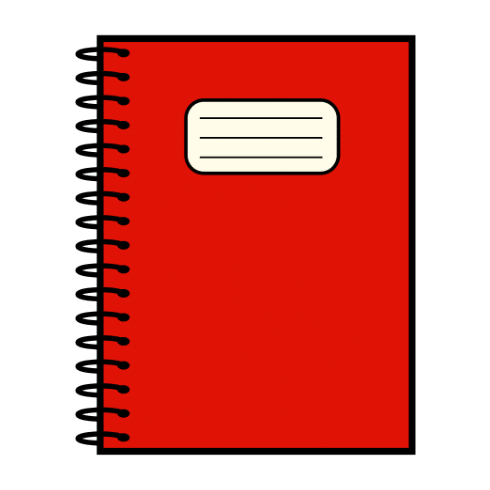

Oracion: pict_35069_Dios pict_7074_de pict_8477_los pict_2811_río pict_11399_y pict_6022_lago
6
Procesando: ./imagenes_procesadas/pict_35069.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_8477.png
Procesando: ./imagenes_procesadas/pict_2811.png
Procesando: ./imagenes_procesadas/pict_11399.png
Procesando: ./imagenes_procesadas/pict_6022.png


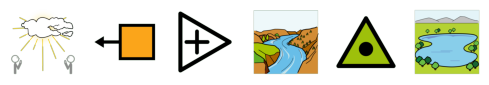

Prediction pict_6901_animales pict_7074_de pict_7033_los pict_2248_agua pict_3047_y pict_7033_los pict_2248_agua
7
['./imagenes_procesadas/pict_6901.png', './imagenes_procesadas/pict_7074.png', './imagenes_procesadas/pict_7033.png', './imagenes_procesadas/pict_2248.png', './imagenes_procesadas/pict_3047.png', './imagenes_procesadas/pict_7033.png', './imagenes_procesadas/pict_2248.png']
Procesando: ./imagenes_procesadas/pict_6901.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_7033.png
Procesando: ./imagenes_procesadas/pict_2248.png
Procesando: ./imagenes_procesadas/pict_3047.png
Procesando: ./imagenes_procesadas/pict_7033.png
Procesando: ./imagenes_procesadas/pict_2248.png


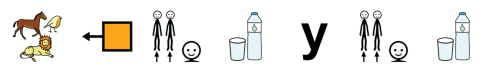

Oracion: pict_31807_yo pict_7221_puedo? pict_7264_tapar pict_39042_botella
4
Procesando: ./imagenes_procesadas/pict_31807.png
Procesando: ./imagenes_procesadas/pict_7221.png
Procesando: ./imagenes_procesadas/pict_7264.png
Procesando: ./imagenes_procesadas/pict_39042.png


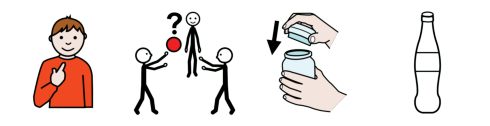

Prediction pict_15485_usar pict_7271_tener pict_11691_cuidar pict_7029_la pict_2248_agua
5
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_11691.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_2248.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_11691.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_2248.png


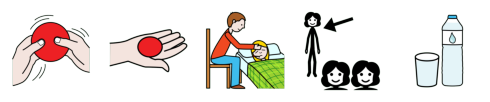

Oracion: pict_31807_yo pict_5441_quiero pict_37453_buscar_huevos_de_Pascua
3
Procesando: ./imagenes_procesadas/pict_31807.png
Procesando: ./imagenes_procesadas/pict_5441.png
Procesando: ./imagenes_procesadas/pict_37453.png


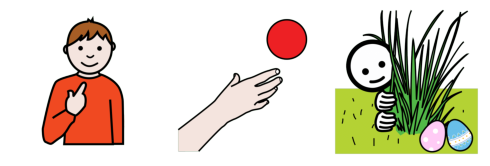

Prediction pict_15485_usar pict_7271_tener pict_11749_hacer pict_2248_agua pict_7074_de pict_4649_feria
6
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_11749.png', './imagenes_procesadas/pict_2248.png', './imagenes_procesadas/pict_7074.png', './imagenes_procesadas/pict_4649.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_11749.png
Procesando: ./imagenes_procesadas/pict_2248.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_4649.png


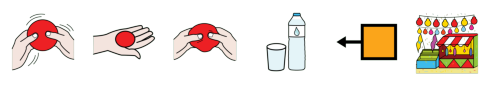

Oracion: pict_2474_observar pict_8477_las pict_6923_aves
3
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_8477.png
Procesando: ./imagenes_procesadas/pict_6923.png


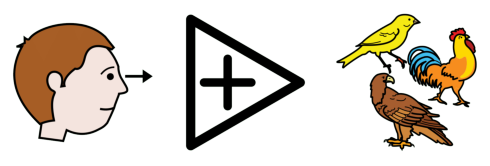

Prediction pict_8579_explicar pict_7031_las pict_2248_agua
3
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_7031.png', './imagenes_procesadas/pict_2248.png']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_7031.png
Procesando: ./imagenes_procesadas/pict_2248.png


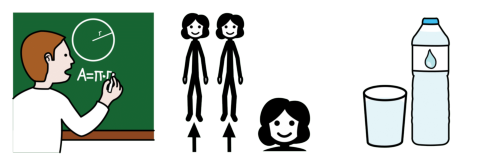

Oracion: pict_32757_poner pict_2409_goma pict_8349_papel
3
Procesando: ./imagenes_procesadas/pict_32757.png
Procesando: ./imagenes_procesadas/pict_2409.png
Procesando: ./imagenes_procesadas/pict_8349.png


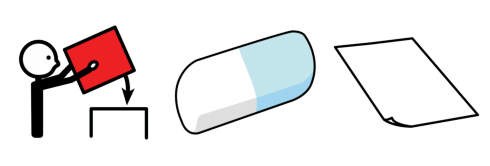

Prediction pict_11308_mostrar pict_22769_artesanía pict_7034_en pict_7029_la pict_9870_exposición
5
['./imagenes_procesadas/pict_11308.png', './imagenes_procesadas/pict_22769.png', './imagenes_procesadas/pict_7034.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_9870.png']
Procesando: ./imagenes_procesadas/pict_11308.png
Procesando: ./imagenes_procesadas/pict_22769.png
Procesando: ./imagenes_procesadas/pict_7034.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_9870.png


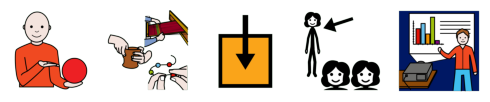

Oracion: pict_8107_escribir pict_8474_una pict_7187_nota
3
Procesando: ./imagenes_procesadas/pict_8107.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_7187.png


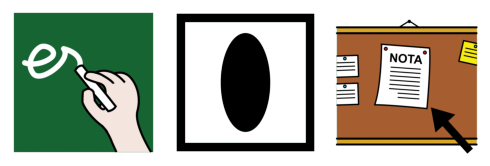

Prediction pict_2380_escribir pict_8474_una pict_7217_pregunta
3
['./imagenes_procesadas/pict_2380.png', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_7217.png']
Procesando: ./imagenes_procesadas/pict_2380.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_7217.png


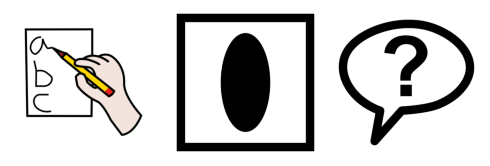

Oracion: pict_31801_tú pict_6481_lo pict_32814_terminar
3
Procesando: ./imagenes_procesadas/pict_31801.png
Procesando: ./imagenes_procesadas/pict_6481.png
Procesando: ./imagenes_procesadas/pict_32814.png


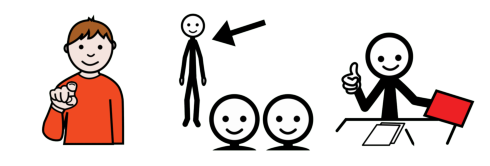

Prediction pict_22619_cómo pict_6481_lo pict_8029_aprender
3
['./imagenes_procesadas/pict_22619.png', './imagenes_procesadas/pict_6481.png', './imagenes_procesadas/pict_8029.png']
Procesando: ./imagenes_procesadas/pict_22619.png
Procesando: ./imagenes_procesadas/pict_6481.png
Procesando: ./imagenes_procesadas/pict_8029.png


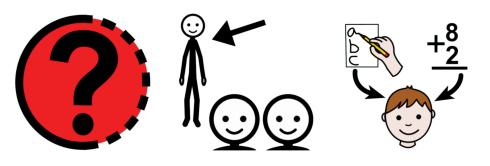

Oracion: pict_2617_yo pict_5441_quiero pict_17016_pinturas_de_colores
3
Procesando: ./imagenes_procesadas/pict_2617.png
Procesando: ./imagenes_procesadas/pict_5441.png
Procesando: ./imagenes_procesadas/pict_17016.png


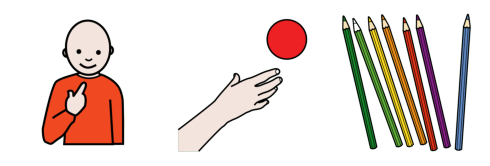

Prediction pict_15485_usar pict_11749_hacer pict_8474_una pict_11572_plantas pict_7074_de pict_9819_lugar
6
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_11749.png', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_11572.png', './imagenes_procesadas/pict_7074.png', './imagenes_procesadas/pict_9819.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_11749.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_11572.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_9819.png


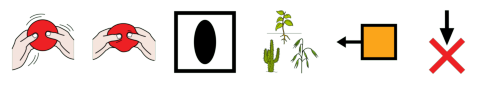

Oracion: pict_2474_ver pict_9068_puma
2
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_9068.png


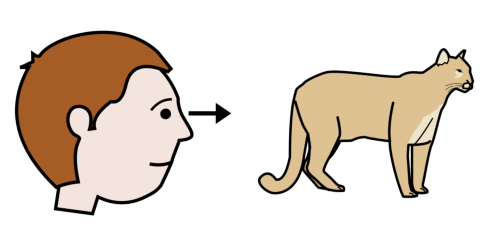

Prediction pict_11749_hacer pict_8474_un pict_22769_artesanía
3
['./imagenes_procesadas/pict_11749.png', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_22769.png']
Procesando: ./imagenes_procesadas/pict_11749.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_22769.png


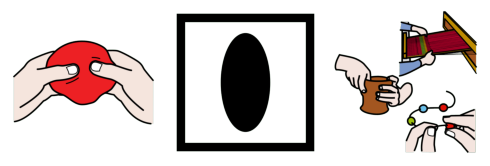

Oracion: pict_29145_partes_del_cuerpo
1
Procesando: ./imagenes_procesadas/pict_29145.png


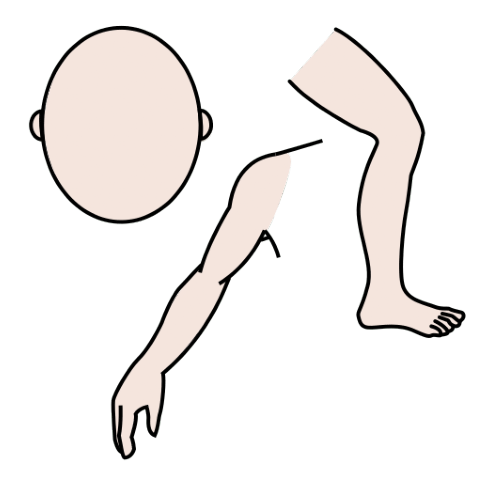

Prediction pict_3415_¿ partes pict_11712_del pict_9819_lugar pict_3418_?
5
['./imagenes_procesadas/pict_3415.png', 'partes', './imagenes_procesadas/pict_11712.png', './imagenes_procesadas/pict_9819.png', './imagenes_procesadas/pict_3418.png']
Procesando: ./imagenes_procesadas/pict_3415.png
Procesando: partes
Procesando: ./imagenes_procesadas/pict_11712.png
Procesando: ./imagenes_procesadas/pict_9819.png
Procesando: ./imagenes_procesadas/pict_3418.png


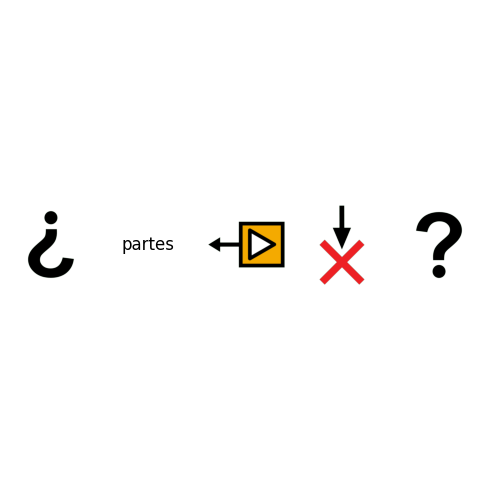

Oracion: pict_35631_5 pict_37374_minuto
2
Procesando: ./imagenes_procesadas/pict_35631.png
Procesando: ./imagenes_procesadas/pict_37374.png


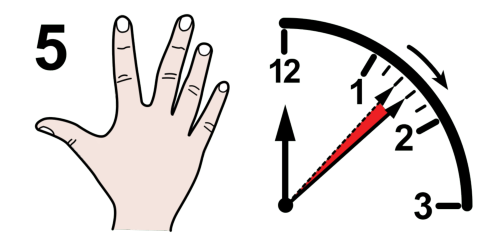

Prediction pict_11709_al pict_4604_claro
2
['./imagenes_procesadas/pict_11709.png', './imagenes_procesadas/pict_4604.png']
Procesando: ./imagenes_procesadas/pict_11709.png
Procesando: ./imagenes_procesadas/pict_4604.png


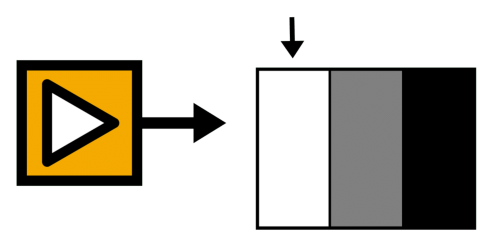

Oracion: pict_32872_¿dónde_está? pict_8476_el pict_6188_polo_sur
3
Procesando: ./imagenes_procesadas/pict_32872.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_6188.png


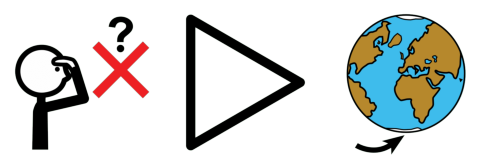

Prediction pict_22619_cómo pict_5581_ser pict_8476_el pict_6901_animales pict_9819_lugar
5
['./imagenes_procesadas/pict_22619.png', './imagenes_procesadas/pict_5581.png', './imagenes_procesadas/pict_8476.png', './imagenes_procesadas/pict_6901.png', './imagenes_procesadas/pict_9819.png']
Procesando: ./imagenes_procesadas/pict_22619.png
Procesando: ./imagenes_procesadas/pict_5581.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_6901.png
Procesando: ./imagenes_procesadas/pict_9819.png


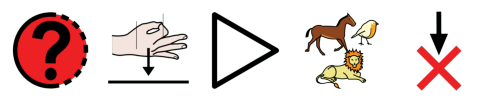

Oracion: pict_28433_responder pict_33994_amable
2
Procesando: ./imagenes_procesadas/pict_28433.png
Procesando: ./imagenes_procesadas/pict_33994.png


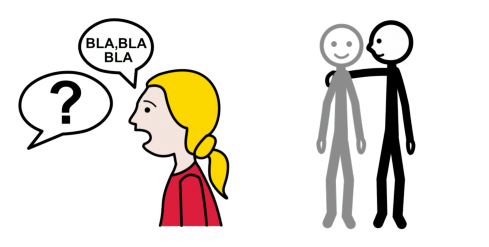

Prediction respondo amablemente
2
['respondo', 'amablemente']
Procesando: respondo
Procesando: amablemente


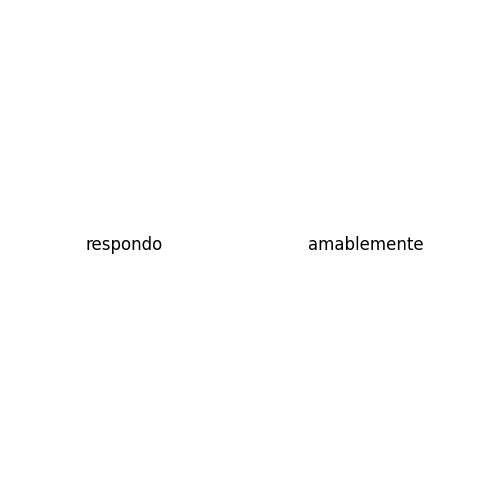

Oracion: pict_10261_miedo pict_7041_a pict_8476_la pict_8643_oscuridad
4
Procesando: ./imagenes_procesadas/pict_10261.png
Procesando: ./imagenes_procesadas/pict_7041.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_8643.png


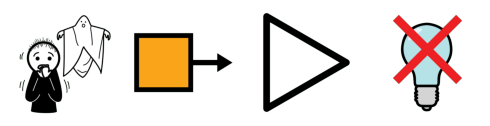

Prediction pict_35477_paso pict_3021_a pict_7029_la pict_4649_feria
4
['./imagenes_procesadas/pict_35477.png', './imagenes_procesadas/pict_3021.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_4649.png']
Procesando: ./imagenes_procesadas/pict_35477.png
Procesando: ./imagenes_procesadas/pict_3021.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_4649.png


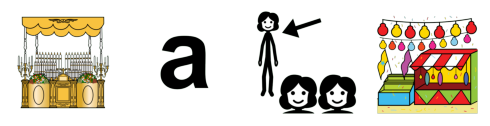

Oracion: pict_2474_observar pict_8476_la pict_16913_página_web
3
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_16913.png


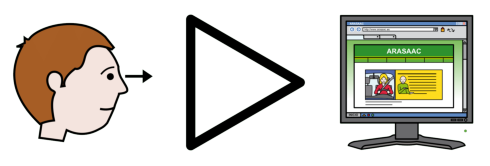

Prediction pict_8579_explicar pict_7029_la pagina web
4
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_7029.png', 'pagina', 'web']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: pagina
Procesando: web


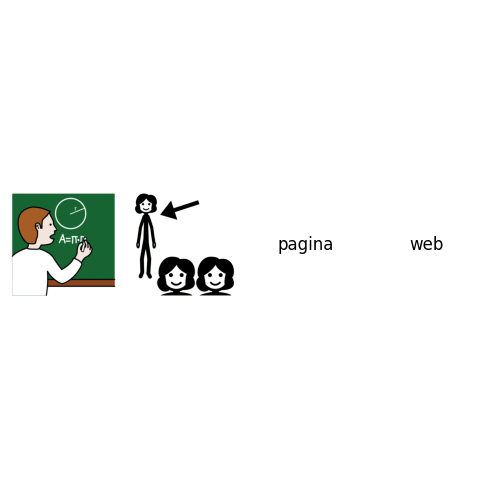

Oracion: pict_38889_gustar pict_8476_la pict_22763_poesía
3
Procesando: ./imagenes_procesadas/pict_38889.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_22763.png


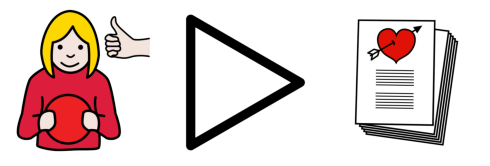

Prediction pict_7271_tener pict_7271_tener pict_7029_la pict_2359_cuaderno
4
['./imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_2359.png']
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_2359.png


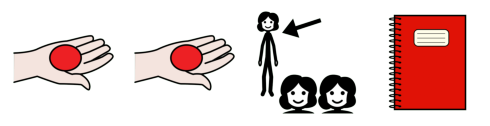

Oracion: pict_24598_abrir_la_puerta
1
Procesando: ./imagenes_procesadas/pict_24598.png


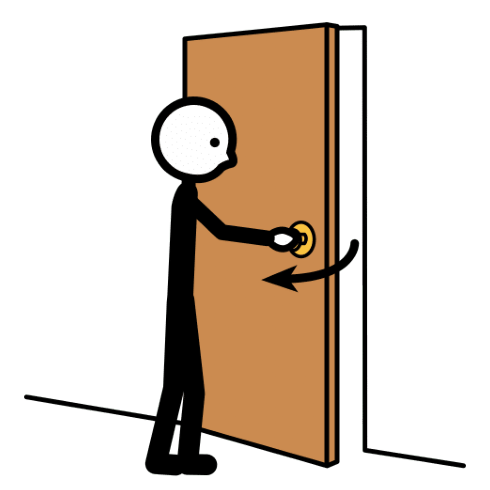

Prediction pict_35653_organizar pict_7031_las pict_2248_agua
3
['./imagenes_procesadas/pict_35653.png', './imagenes_procesadas/pict_7031.png', './imagenes_procesadas/pict_2248.png']
Procesando: ./imagenes_procesadas/pict_35653.png
Procesando: ./imagenes_procesadas/pict_7031.png
Procesando: ./imagenes_procesadas/pict_2248.png


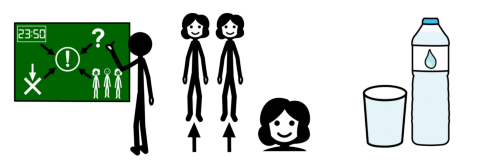

Oracion: pict_32773_agarrar pict_6664_tijera
2
Procesando: ./imagenes_procesadas/pict_32773.png
Procesando: ./imagenes_procesadas/pict_6664.png


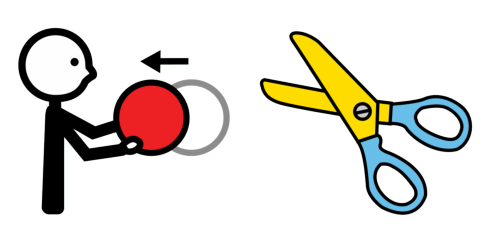

Prediction pict_11691_cuidar pict_5596_todos
2
['./imagenes_procesadas/pict_11691.png', './imagenes_procesadas/pict_5596.png']
Procesando: ./imagenes_procesadas/pict_11691.png
Procesando: ./imagenes_procesadas/pict_5596.png


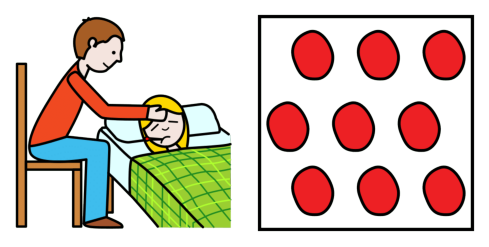

Oracion: pict_31807_yo pict_5441_quiero pict_25181_jugar_al_ajedrez
3
Procesando: ./imagenes_procesadas/pict_31807.png
Procesando: ./imagenes_procesadas/pict_5441.png
Procesando: ./imagenes_procesadas/pict_25181.png


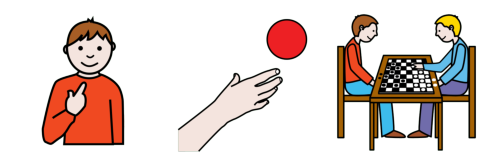

Prediction pict_5526_no pict_7271_tener pict_11691_cuidar pict_11709_al pict_22769_artesanía
5
['./imagenes_procesadas/pict_5526.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_11691.png', './imagenes_procesadas/pict_11709.png', './imagenes_procesadas/pict_22769.png']
Procesando: ./imagenes_procesadas/pict_5526.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_11691.png
Procesando: ./imagenes_procesadas/pict_11709.png
Procesando: ./imagenes_procesadas/pict_22769.png


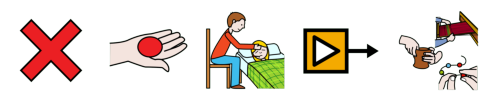

Oracion: pict_22619_cómo pict_26380_reproducirse
2
Procesando: ./imagenes_procesadas/pict_22619.png
Procesando: ./imagenes_procesadas/pict_26380.png


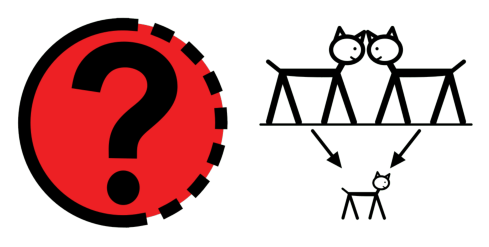

Prediction pict_22619_cómo pict_6481_se reproducen
3
['./imagenes_procesadas/pict_22619.png', './imagenes_procesadas/pict_6481.png', 'reproducen']
Procesando: ./imagenes_procesadas/pict_22619.png
Procesando: ./imagenes_procesadas/pict_6481.png
Procesando: reproducen


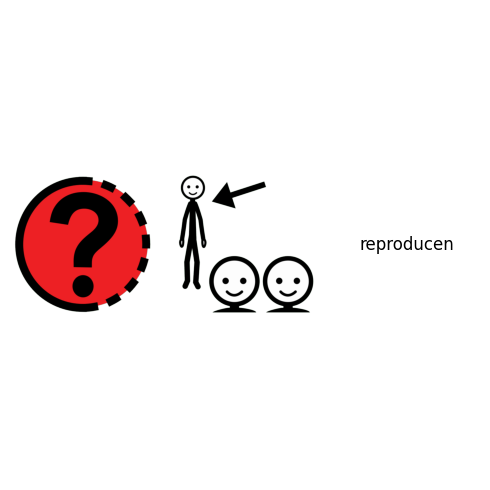

Oracion: pict_11708_acudir pict_11709_al pict_24680_taller_de_memoria
3
Procesando: ./imagenes_procesadas/pict_11708.png
Procesando: ./imagenes_procesadas/pict_11709.png
Procesando: ./imagenes_procesadas/pict_24680.png


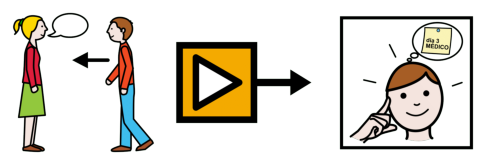

Prediction pict_11691_cuidar pict_11709_al pict_9870_exposición pict_7074_de pict_9870_exposición
5
['./imagenes_procesadas/pict_11691.png', './imagenes_procesadas/pict_11709.png', './imagenes_procesadas/pict_9870.png', './imagenes_procesadas/pict_7074.png', './imagenes_procesadas/pict_9870.png']
Procesando: ./imagenes_procesadas/pict_11691.png
Procesando: ./imagenes_procesadas/pict_11709.png
Procesando: ./imagenes_procesadas/pict_9870.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_9870.png


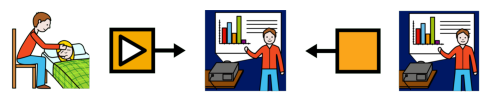

Oracion: pict_32771_qué_es?
1
Procesando: ./imagenes_procesadas/pict_32771.png


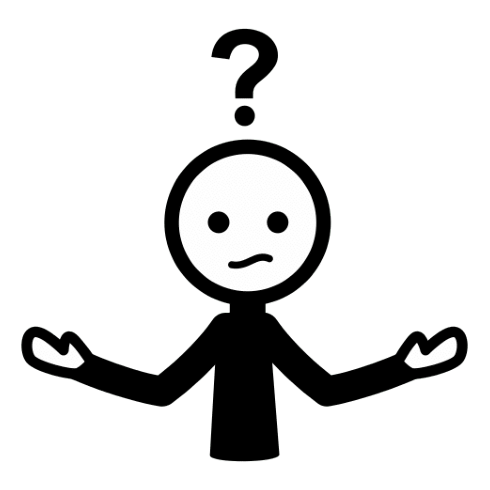

Prediction pict_3415_¿ pict_22624_qué pict_5581_ser pict_3418_?
4
['./imagenes_procesadas/pict_3415.png', './imagenes_procesadas/pict_22624.png', './imagenes_procesadas/pict_5581.png', './imagenes_procesadas/pict_3418.png']
Procesando: ./imagenes_procesadas/pict_3415.png
Procesando: ./imagenes_procesadas/pict_22624.png
Procesando: ./imagenes_procesadas/pict_5581.png
Procesando: ./imagenes_procesadas/pict_3418.png


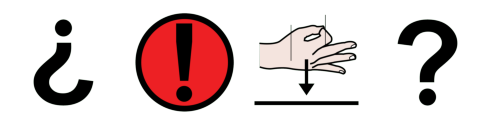

Oracion: pict_38796_pensar pict_7064_con pict_36688_calmar
3
Procesando: ./imagenes_procesadas/pict_38796.png
Procesando: ./imagenes_procesadas/pict_7064.png
Procesando: ./imagenes_procesadas/pict_36688.png


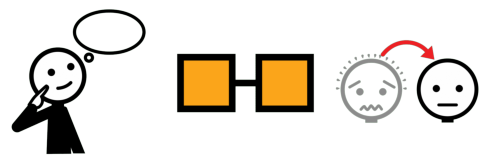

Prediction pict_11749_hacer pict_7064_con pict_4604_claro
3
['./imagenes_procesadas/pict_11749.png', './imagenes_procesadas/pict_7064.png', './imagenes_procesadas/pict_4604.png']
Procesando: ./imagenes_procesadas/pict_11749.png
Procesando: ./imagenes_procesadas/pict_7064.png
Procesando: ./imagenes_procesadas/pict_4604.png


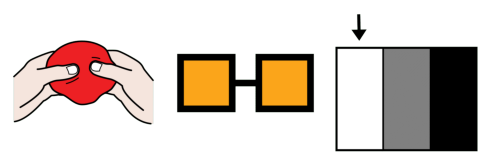

Oracion: pict_6564_ver
1
Procesando: ./imagenes_procesadas/pict_6564.png


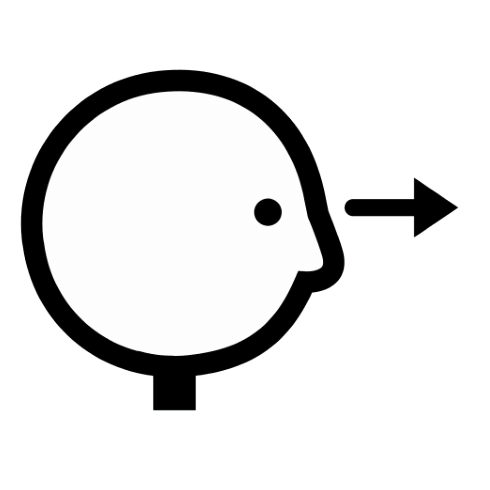

Prediction pict_3345_hablar
1
['./imagenes_procesadas/pict_3345.png']
Procesando: ./imagenes_procesadas/pict_3345.png


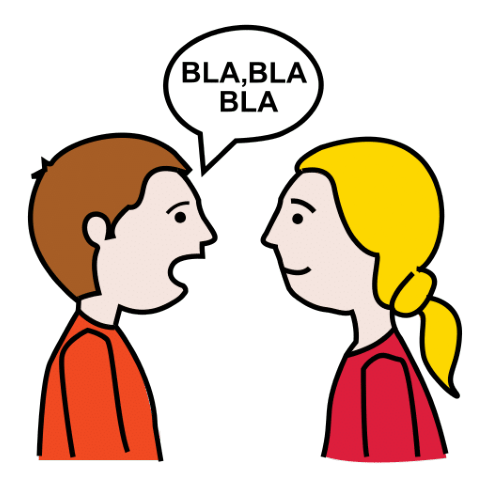

Oracion: pict_2474_observar pict_8476_la pict_6158_nutria
3
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_6158.png


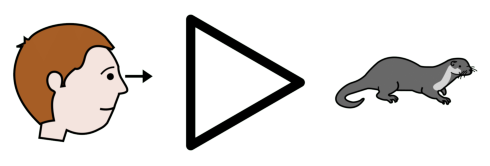

Prediction pict_8579_explicar pict_7029_la nutria
3
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_7029.png', 'nutria']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: nutria


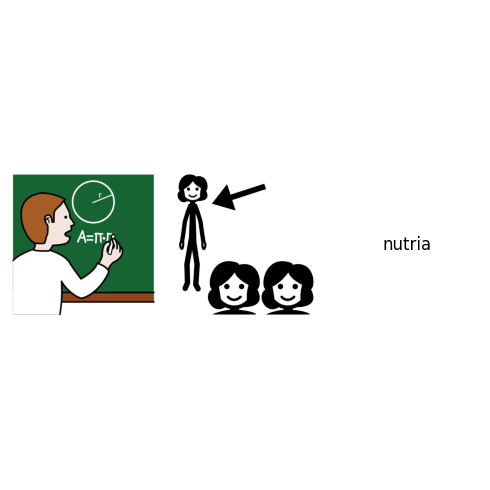

Oracion: pict_22620_qué pict_6456_comer pict_8476_el pict_2533_pollo
4
Procesando: ./imagenes_procesadas/pict_22620.png
Procesando: ./imagenes_procesadas/pict_6456.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_2533.png


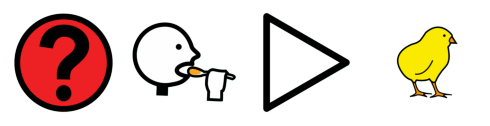

Prediction pict_22624_qué pict_11691_cuidar pict_8476_el pict_6901_animales
4
['./imagenes_procesadas/pict_22624.png', './imagenes_procesadas/pict_11691.png', './imagenes_procesadas/pict_8476.png', './imagenes_procesadas/pict_6901.png']
Procesando: ./imagenes_procesadas/pict_22624.png
Procesando: ./imagenes_procesadas/pict_11691.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_6901.png


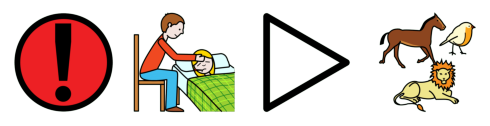

Oracion: pict_7141_leer pict_3171_y pict_9031_responder pict_8477_los pict_7217_pregunta
5
Procesando: ./imagenes_procesadas/pict_7141.png
Procesando: ./imagenes_procesadas/pict_3171.png
Procesando: ./imagenes_procesadas/pict_9031.png
Procesando: ./imagenes_procesadas/pict_8477.png
Procesando: ./imagenes_procesadas/pict_7217.png


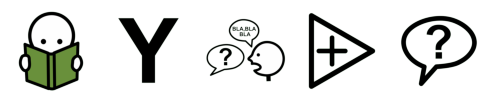

Prediction pict_7141_leer pict_3047_y pict_3345_hablar pict_7031_las pict_7217_pregunta
5
['./imagenes_procesadas/pict_7141.png', './imagenes_procesadas/pict_3047.png', './imagenes_procesadas/pict_3345.png', './imagenes_procesadas/pict_7031.png', './imagenes_procesadas/pict_7217.png']
Procesando: ./imagenes_procesadas/pict_7141.png
Procesando: ./imagenes_procesadas/pict_3047.png
Procesando: ./imagenes_procesadas/pict_3345.png
Procesando: ./imagenes_procesadas/pict_7031.png
Procesando: ./imagenes_procesadas/pict_7217.png


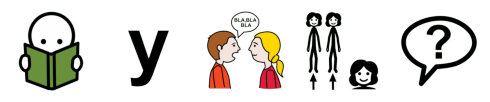

Oracion: pict_32749_luego pict_2380_escribir
2
Procesando: ./imagenes_procesadas/pict_32749.png
Procesando: ./imagenes_procesadas/pict_2380.png


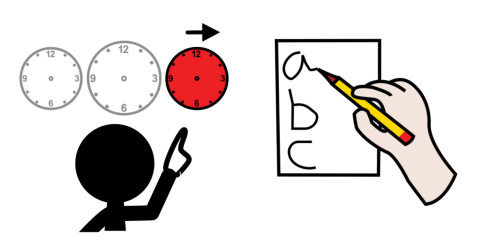

Prediction pict_8029_aprender pict_3189_, pict_2380_escribir
3
['./imagenes_procesadas/pict_8029.png', './imagenes_procesadas/pict_3189.png', './imagenes_procesadas/pict_2380.png']
Procesando: ./imagenes_procesadas/pict_8029.png
Procesando: ./imagenes_procesadas/pict_3189.png
Procesando: ./imagenes_procesadas/pict_2380.png


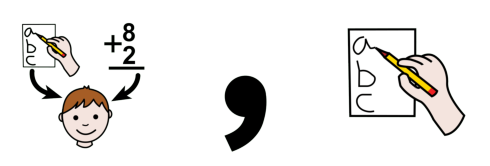

Oracion: pict_31807_yo pict_5441_quiero pict_5391_amarrar
3
Procesando: ./imagenes_procesadas/pict_31807.png
Procesando: ./imagenes_procesadas/pict_5441.png
Procesando: ./imagenes_procesadas/pict_5391.png


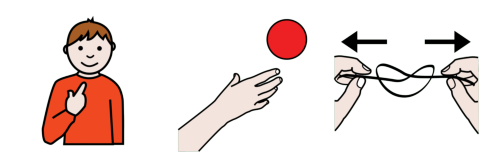

Prediction pict_15485_usar pict_7271_tener amarrar
3
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_7271.png', 'amarrar']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: amarrar


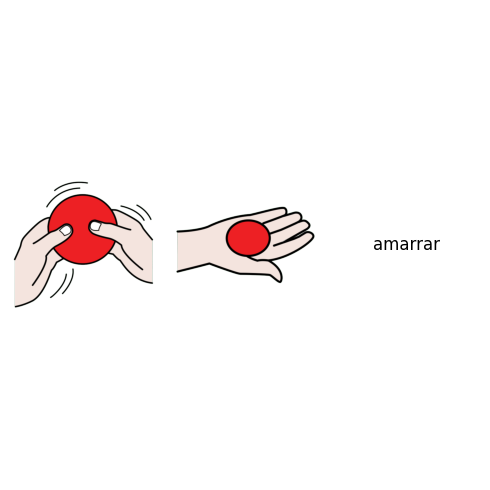

Oracion: pict_10155_ganar pict_8476_la pict_3128_medalla
3
Procesando: ./imagenes_procesadas/pict_10155.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_3128.png


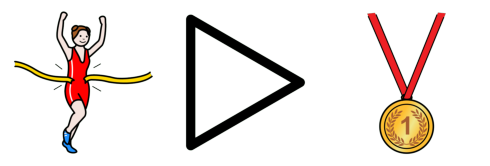

Prediction pict_11691_cuidar pict_7029_la pict_35477_paso
3
['./imagenes_procesadas/pict_11691.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_35477.png']
Procesando: ./imagenes_procesadas/pict_11691.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_35477.png


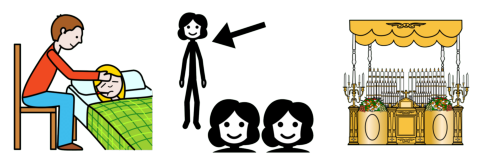

Oracion: pict_8476_el pict_24721_clima pict_7034_en pict_8476_la pict_30014_tierra
5
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_24721.png
Procesando: ./imagenes_procesadas/pict_7034.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_30014.png


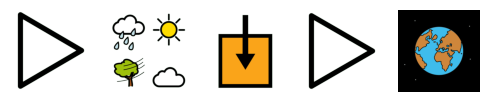

Prediction pict_8476_el pict_2248_agua pict_7034_en pict_7029_la pict_9819_lugar
5
['./imagenes_procesadas/pict_8476.png', './imagenes_procesadas/pict_2248.png', './imagenes_procesadas/pict_7034.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_9819.png']
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_2248.png
Procesando: ./imagenes_procesadas/pict_7034.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_9819.png


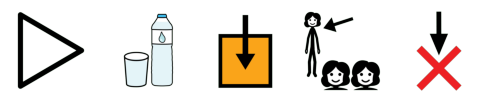

Oracion: pict_28429_terminar pict_8476_la pict_36374_clase_de_química
3
Procesando: ./imagenes_procesadas/pict_28429.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_36374.png


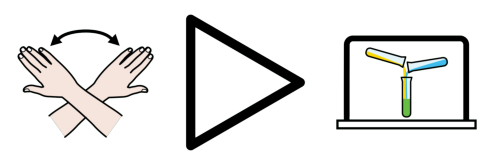

Prediction pict_11691_cuidar pict_7029_la pict_9819_lugar pict_7074_de pict_2248_agua
5
['./imagenes_procesadas/pict_11691.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_9819.png', './imagenes_procesadas/pict_7074.png', './imagenes_procesadas/pict_2248.png']
Procesando: ./imagenes_procesadas/pict_11691.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_9819.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_2248.png


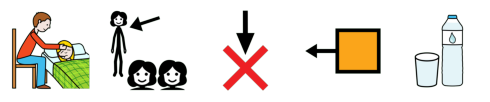

Oracion: pict_31680_leer pict_36928_historia_del_arte
2
Procesando: ./imagenes_procesadas/pict_31680.png
Procesando: ./imagenes_procesadas/pict_36928.png


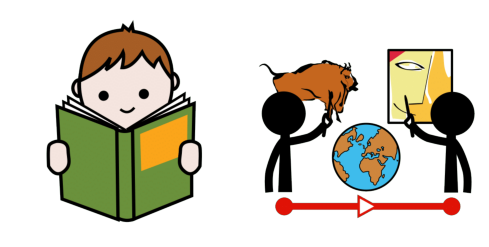

Prediction pict_7141_leer pict_37340_texto pict_11712_del arte
4
['./imagenes_procesadas/pict_7141.png', './imagenes_procesadas/pict_37340.png', './imagenes_procesadas/pict_11712.png', 'arte']
Procesando: ./imagenes_procesadas/pict_7141.png
Procesando: ./imagenes_procesadas/pict_37340.png
Procesando: ./imagenes_procesadas/pict_11712.png
Procesando: arte


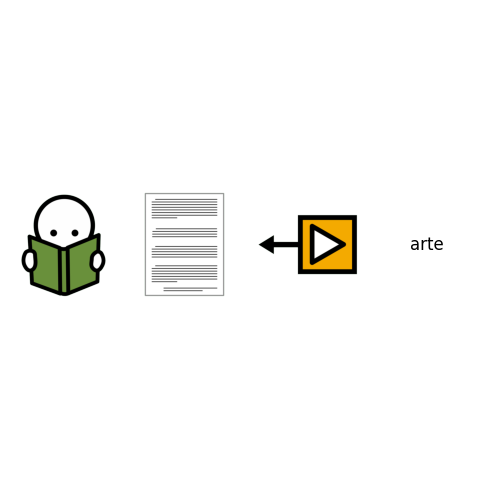

Oracion: pict_11698_producir pict_27319_anterior
2
Procesando: ./imagenes_procesadas/pict_11698.png
Procesando: ./imagenes_procesadas/pict_27319.png


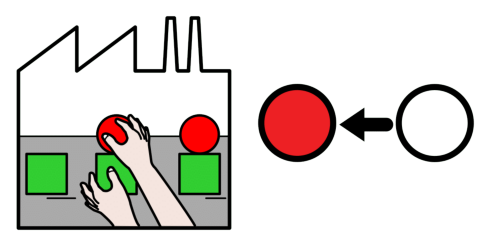

Prediction pict_15485_usar pict_6481_lo pict_11470_importante
3
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_6481.png', './imagenes_procesadas/pict_11470.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_6481.png
Procesando: ./imagenes_procesadas/pict_11470.png


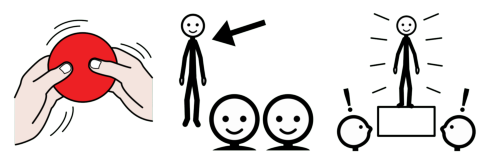

Oracion: pict_2474_mirar pict_8476_el pict_37867_chatear
3
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_37867.png


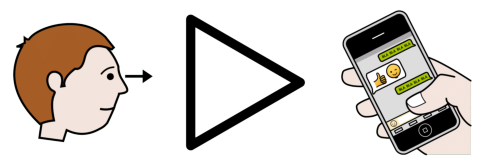

Prediction pict_8579_explicar pict_8476_el mensaje pict_7074_de whatapp
5
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_8476.png', 'mensaje', './imagenes_procesadas/pict_7074.png', 'whatapp']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: mensaje
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: whatapp


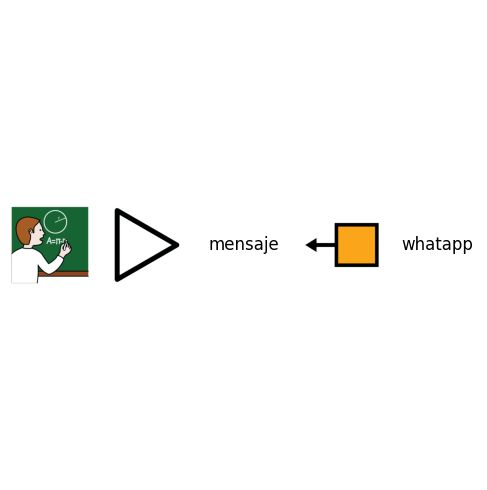

Oracion: pict_31807_yo pict_16087_trabajo pict_38601_familia
3
Procesando: ./imagenes_procesadas/pict_31807.png
Procesando: ./imagenes_procesadas/pict_16087.png
Procesando: ./imagenes_procesadas/pict_38601.png


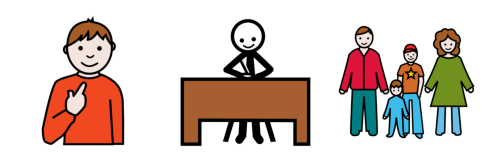

Prediction pict_15485_usar pict_37340_texto pict_7034_en pict_9819_lugar
4
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_37340.png', './imagenes_procesadas/pict_7034.png', './imagenes_procesadas/pict_9819.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_37340.png
Procesando: ./imagenes_procesadas/pict_7034.png
Procesando: ./imagenes_procesadas/pict_9819.png


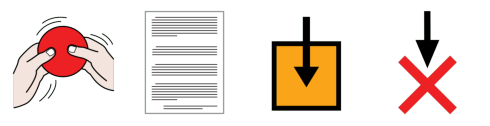

Oracion: pict_11287_invitar pict_7041_a pict_12264_mi pict_37363_cumpleaños
4
Procesando: ./imagenes_procesadas/pict_11287.png
Procesando: ./imagenes_procesadas/pict_7041.png
Procesando: ./imagenes_procesadas/pict_12264.png
Procesando: ./imagenes_procesadas/pict_37363.png


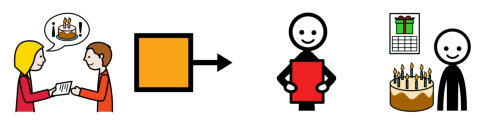

Prediction pict_7271_tener pict_11691_cuidar pict_3021_a pict_12281_tu pict_9819_lugar
5
['./imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_11691.png', './imagenes_procesadas/pict_3021.png', './imagenes_procesadas/pict_12281.png', './imagenes_procesadas/pict_9819.png']
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_11691.png
Procesando: ./imagenes_procesadas/pict_3021.png
Procesando: ./imagenes_procesadas/pict_12281.png
Procesando: ./imagenes_procesadas/pict_9819.png


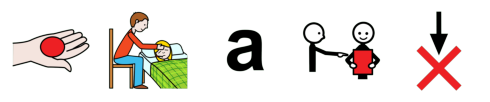

Oracion: pict_36151_adivinar pict_8476_el pict_6472_cuento
3
Procesando: ./imagenes_procesadas/pict_36151.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_6472.png


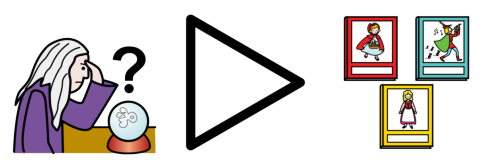

Prediction pict_8579_explicar pict_8476_el pict_7217_pregunta
3
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_8476.png', './imagenes_procesadas/pict_7217.png']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_7217.png


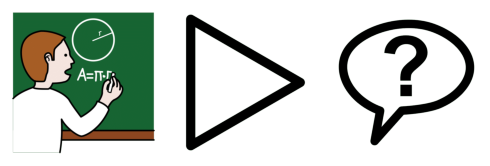

Oracion: pict_31807_yo pict_16125_¿puedo_ayudarte?
2
Procesando: ./imagenes_procesadas/pict_31807.png
Procesando: ./imagenes_procesadas/pict_16125.png


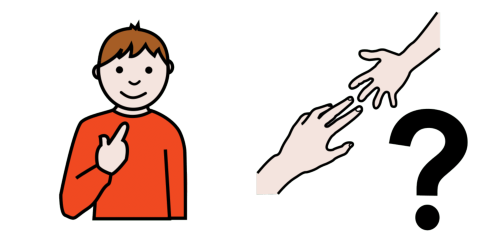

Prediction pict_3415_¿ pict_5526_no pict_7271_tener pict_8029_aprender pict_3418_?
5
['./imagenes_procesadas/pict_3415.png', './imagenes_procesadas/pict_5526.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_8029.png', './imagenes_procesadas/pict_3418.png']
Procesando: ./imagenes_procesadas/pict_3415.png
Procesando: ./imagenes_procesadas/pict_5526.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_8029.png
Procesando: ./imagenes_procesadas/pict_3418.png


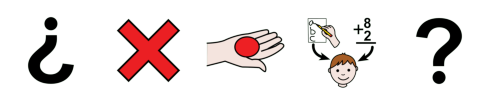

Oracion: pict_28643_leer pict_9877_partes pict_11712_del pict_8064_cartel
4
Procesando: ./imagenes_procesadas/pict_28643.png
Procesando: ./imagenes_procesadas/pict_9877.png
Procesando: ./imagenes_procesadas/pict_11712.png
Procesando: ./imagenes_procesadas/pict_8064.png


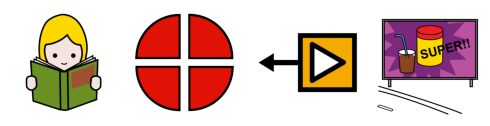

Prediction pict_7141_leer pict_9819_lugar pict_11712_del pict_9819_lugar
4
['./imagenes_procesadas/pict_7141.png', './imagenes_procesadas/pict_9819.png', './imagenes_procesadas/pict_11712.png', './imagenes_procesadas/pict_9819.png']
Procesando: ./imagenes_procesadas/pict_7141.png
Procesando: ./imagenes_procesadas/pict_9819.png
Procesando: ./imagenes_procesadas/pict_11712.png
Procesando: ./imagenes_procesadas/pict_9819.png


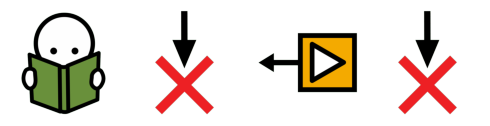

Oracion: pict_22620_qué pict_2474_observar pict_7034_en pict_8476_la pict_28099_tableta
5
Procesando: ./imagenes_procesadas/pict_22620.png
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_7034.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_28099.png


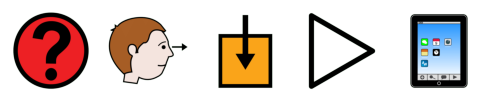

Prediction pict_22624_qué pict_8579_explicar pict_7034_en pict_7029_la pict_22769_artesanía
5
['./imagenes_procesadas/pict_22624.png', './imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_7034.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_22769.png']
Procesando: ./imagenes_procesadas/pict_22624.png
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_7034.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_22769.png


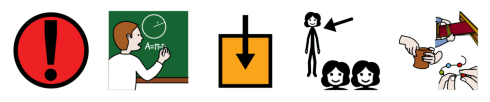

Oracion: pict_4772_visitar pict_38083_hospital pict_28742_enfermo
3
Procesando: ./imagenes_procesadas/pict_4772.png
Procesando: ./imagenes_procesadas/pict_38083.png
Procesando: ./imagenes_procesadas/pict_28742.png


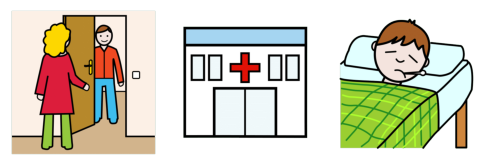

Prediction pict_35653_organizar pict_8474_un pict_2248_agua pict_5526_no pict_5581_ser pict_4604_claro
6
['./imagenes_procesadas/pict_35653.png', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_2248.png', './imagenes_procesadas/pict_5526.png', './imagenes_procesadas/pict_5581.png', './imagenes_procesadas/pict_4604.png']
Procesando: ./imagenes_procesadas/pict_35653.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_2248.png
Procesando: ./imagenes_procesadas/pict_5526.png
Procesando: ./imagenes_procesadas/pict_5581.png
Procesando: ./imagenes_procesadas/pict_4604.png


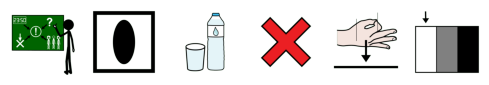

Oracion: pict_28643_leer pict_3171_y pict_26405_saber
3
Procesando: ./imagenes_procesadas/pict_28643.png
Procesando: ./imagenes_procesadas/pict_3171.png
Procesando: ./imagenes_procesadas/pict_26405.png


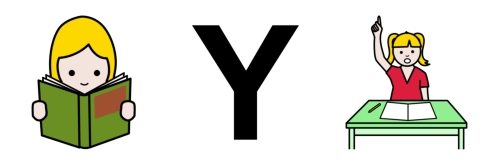

Prediction pict_7141_leer pict_3047_y pict_11749_hacer
3
['./imagenes_procesadas/pict_7141.png', './imagenes_procesadas/pict_3047.png', './imagenes_procesadas/pict_11749.png']
Procesando: ./imagenes_procesadas/pict_7141.png
Procesando: ./imagenes_procesadas/pict_3047.png
Procesando: ./imagenes_procesadas/pict_11749.png


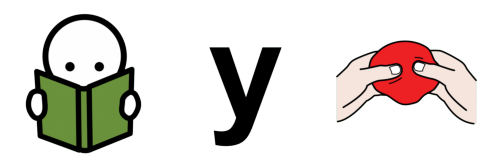

Oracion: pict_6009_hola pict_5441_quiero pict_8107_escribir pict_8474_una pict_22763_poesía
5
Procesando: ./imagenes_procesadas/pict_6009.png
Procesando: ./imagenes_procesadas/pict_5441.png
Procesando: ./imagenes_procesadas/pict_8107.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_22763.png


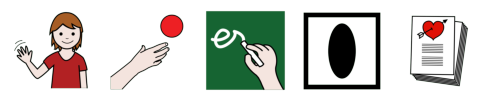

Prediction pict_11238_dibujo pict_6481_se pict_7271_tener pict_2380_escribir pict_8474_un pict_2359_cuaderno
6
['./imagenes_procesadas/pict_11238.png', './imagenes_procesadas/pict_6481.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_2380.png', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_2359.png']
Procesando: ./imagenes_procesadas/pict_11238.png
Procesando: ./imagenes_procesadas/pict_6481.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_2380.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_2359.png


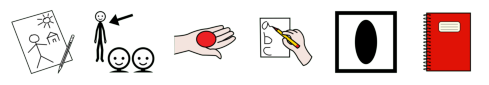

Oracion: pict_8476_el pict_2823_pueblo
2
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_2823.png


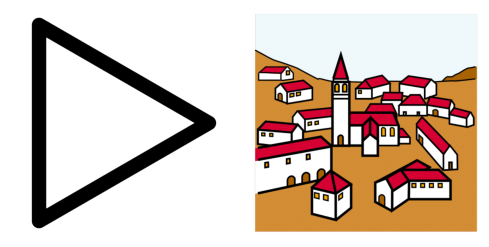

Prediction pict_8476_el pict_9819_lugar
2
['./imagenes_procesadas/pict_8476.png', './imagenes_procesadas/pict_9819.png']
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_9819.png


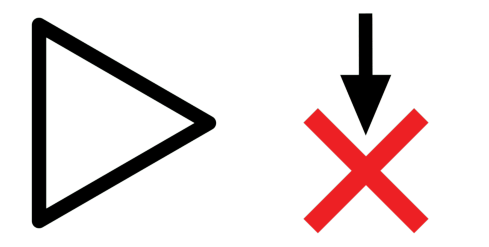

Oracion: pict_32366_prohibido pict_22088_robar
2
Procesando: ./imagenes_procesadas/pict_32366.png
Procesando: ./imagenes_procesadas/pict_22088.png


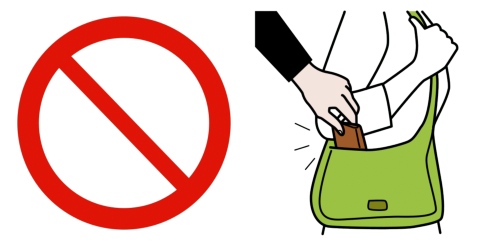

Prediction pict_5526_no pict_35653_organizar
2
['./imagenes_procesadas/pict_5526.png', './imagenes_procesadas/pict_35653.png']
Procesando: ./imagenes_procesadas/pict_5526.png
Procesando: ./imagenes_procesadas/pict_35653.png


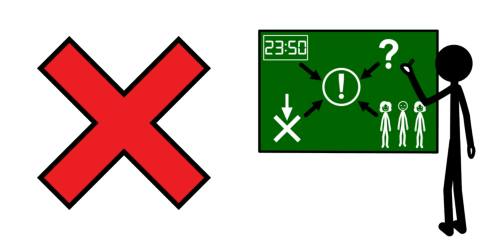

Oracion: pict_7091_eso pict_25708_muy pict_32340_rico
3
Procesando: ./imagenes_procesadas/pict_7091.png
Procesando: ./imagenes_procesadas/pict_25708.png
Procesando: ./imagenes_procesadas/pict_32340.png


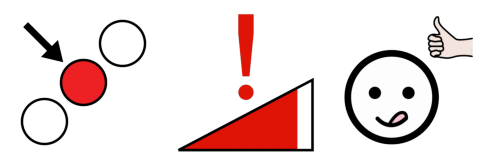

Prediction pict_7217_pregunta pict_5581_ser pict_11351_que pict_4604_claro
4
['./imagenes_procesadas/pict_7217.png', './imagenes_procesadas/pict_5581.png', './imagenes_procesadas/pict_11351.png', './imagenes_procesadas/pict_4604.png']
Procesando: ./imagenes_procesadas/pict_7217.png
Procesando: ./imagenes_procesadas/pict_5581.png
Procesando: ./imagenes_procesadas/pict_11351.png
Procesando: ./imagenes_procesadas/pict_4604.png


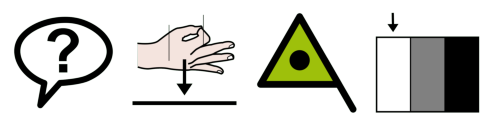

Oracion: pict_32940_vámonos_a_casa
1
Procesando: ./imagenes_procesadas/pict_32940.png


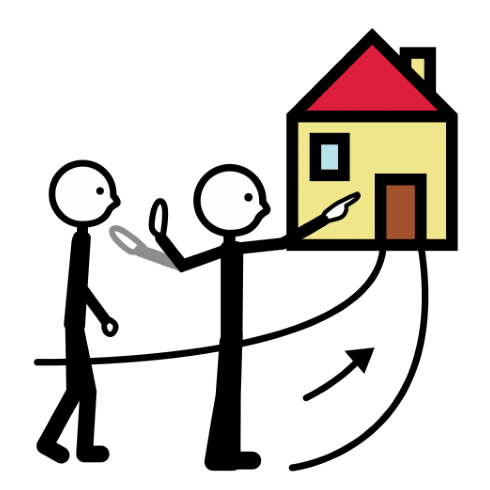

Prediction pict_11691_cuidar pict_3021_a pict_9819_lugar
3
['./imagenes_procesadas/pict_11691.png', './imagenes_procesadas/pict_3021.png', './imagenes_procesadas/pict_9819.png']
Procesando: ./imagenes_procesadas/pict_11691.png
Procesando: ./imagenes_procesadas/pict_3021.png
Procesando: ./imagenes_procesadas/pict_9819.png


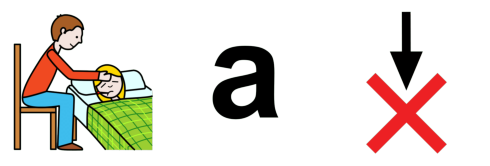

Oracion: pict_37776_aprender pict_27214_reciclar
2
Procesando: ./imagenes_procesadas/pict_37776.png
Procesando: ./imagenes_procesadas/pict_27214.png


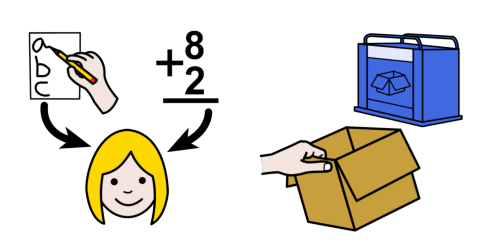

Prediction pict_3345_hablar pict_3021_a pict_11691_cuidar
3
['./imagenes_procesadas/pict_3345.png', './imagenes_procesadas/pict_3021.png', './imagenes_procesadas/pict_11691.png']
Procesando: ./imagenes_procesadas/pict_3345.png
Procesando: ./imagenes_procesadas/pict_3021.png
Procesando: ./imagenes_procesadas/pict_11691.png


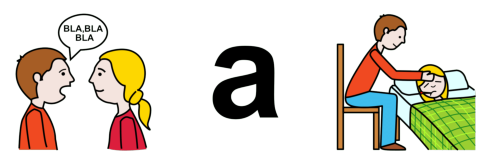

Oracion: pict_32771_qué_es? pict_8474_una pict_22763_poesía
3
Procesando: ./imagenes_procesadas/pict_32771.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_22763.png


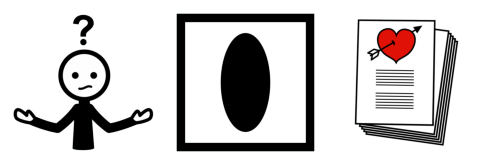

Prediction pict_22624_qué pict_8474_una poesia
3
['./imagenes_procesadas/pict_22624.png', './imagenes_procesadas/pict_8474.png', 'poesia']
Procesando: ./imagenes_procesadas/pict_22624.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: poesia


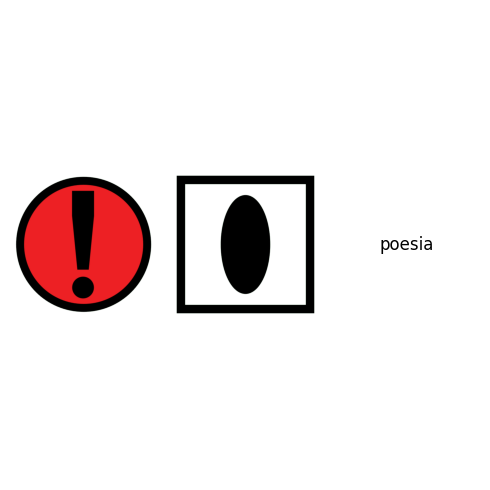

Oracion: pict_6009_hola pict_10273_¿cómo_estás?
2
Procesando: ./imagenes_procesadas/pict_6009.png
Procesando: ./imagenes_procesadas/pict_10273.png


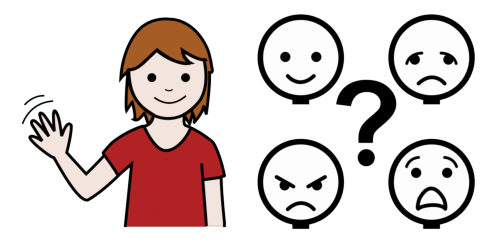

Prediction pict_3414_¡ pict_3189_, pict_3415_¿ pict_22619_cómo pict_5581_ser pict_3418_?
6
['./imagenes_procesadas/pict_3414.png', './imagenes_procesadas/pict_3189.png', './imagenes_procesadas/pict_3415.png', './imagenes_procesadas/pict_22619.png', './imagenes_procesadas/pict_5581.png', './imagenes_procesadas/pict_3418.png']
Procesando: ./imagenes_procesadas/pict_3414.png
Procesando: ./imagenes_procesadas/pict_3189.png
Procesando: ./imagenes_procesadas/pict_3415.png
Procesando: ./imagenes_procesadas/pict_22619.png
Procesando: ./imagenes_procesadas/pict_5581.png
Procesando: ./imagenes_procesadas/pict_3418.png


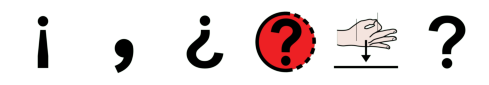

Oracion: pict_2474_observar pict_36986_cóndor
2
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_36986.png


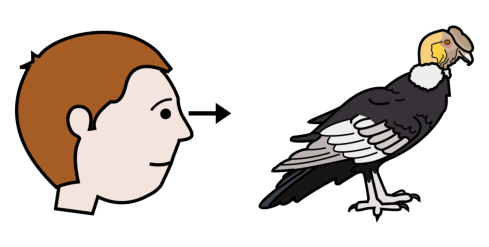

Prediction pict_8579_explicar pict_11709_al condor
3
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_11709.png', 'condor']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_11709.png
Procesando: condor


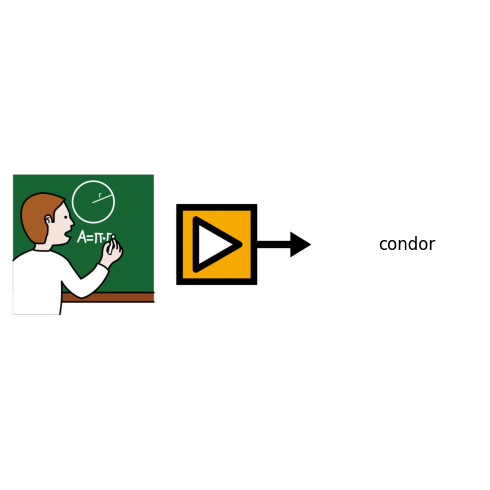

Oracion: pict_7309_yo pict_8107_escribir pict_7034_en pict_8474_un pict_8349_papel
5
Procesando: ./imagenes_procesadas/pict_7309.png
Procesando: ./imagenes_procesadas/pict_8107.png
Procesando: ./imagenes_procesadas/pict_7034.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_8349.png


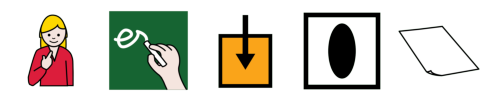

Prediction pict_7141_leer pict_2380_escribir pict_7034_en pict_8474_un pict_9819_lugar
5
['./imagenes_procesadas/pict_7141.png', './imagenes_procesadas/pict_2380.png', './imagenes_procesadas/pict_7034.png', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_9819.png']
Procesando: ./imagenes_procesadas/pict_7141.png
Procesando: ./imagenes_procesadas/pict_2380.png
Procesando: ./imagenes_procesadas/pict_7034.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_9819.png


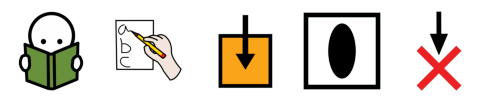

Oracion: pict_6625_te pict_7124_gustar
2
Procesando: ./imagenes_procesadas/pict_6625.png
Procesando: ./imagenes_procesadas/pict_7124.png


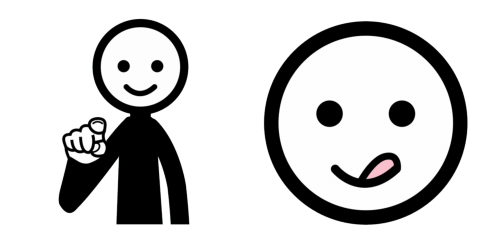

Prediction pict_7271_tener gusto
2
['./imagenes_procesadas/pict_7271.png', 'gusto']
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: gusto


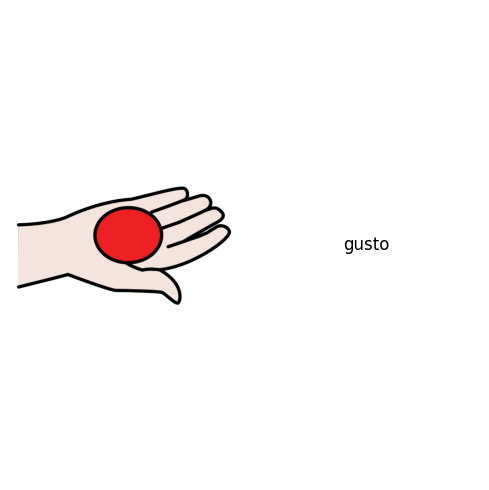

Oracion: pict_24420_perforadora pict_8474_un pict_32656_corcho pict_11399_y pict_32757_colocar pict_7064_con pict_2929_manguera
7
Procesando: ./imagenes_procesadas/pict_24420.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_32656.png
Procesando: ./imagenes_procesadas/pict_11399.png
Procesando: ./imagenes_procesadas/pict_32757.png
Procesando: ./imagenes_procesadas/pict_7064.png
Procesando: ./imagenes_procesadas/pict_2929.png


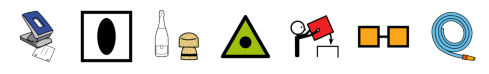

Prediction perforamos pict_8474_un pict_8185_Perú pict_3047_y pict_6481_lo pict_35653_organizar pict_7064_con pict_7029_la pict_22769_artesanía
9
['perforamos', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_8185.png', './imagenes_procesadas/pict_3047.png', './imagenes_procesadas/pict_6481.png', './imagenes_procesadas/pict_35653.png', './imagenes_procesadas/pict_7064.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_22769.png']
Procesando: perforamos
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_8185.png
Procesando: ./imagenes_procesadas/pict_3047.png
Procesando: ./imagenes_procesadas/pict_6481.png
Procesando: ./imagenes_procesadas/pict_35653.png
Procesando: ./imagenes_procesadas/pict_7064.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_22769.png


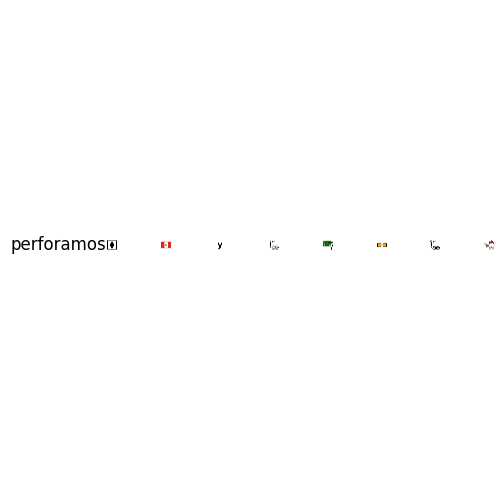

Oracion: pict_5441_quiero pict_15320_investigar pict_8476_el pict_8209_robo
4
Procesando: ./imagenes_procesadas/pict_5441.png
Procesando: ./imagenes_procesadas/pict_15320.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_8209.png


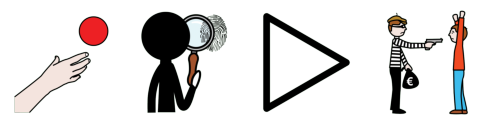

Prediction pict_15485_usar pict_7271_tener pict_8579_explicar pict_8476_el pict_22769_artesanía
5
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_8476.png', './imagenes_procesadas/pict_22769.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_22769.png


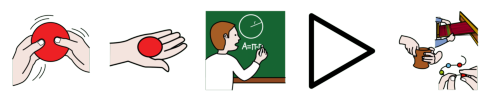

Oracion: pict_2474_ver pict_2403_gallina
2
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_2403.png


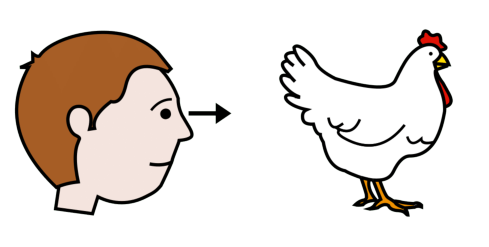

Prediction pict_11749_hacer pict_8474_una pict_11572_plantas
3
['./imagenes_procesadas/pict_11749.png', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_11572.png']
Procesando: ./imagenes_procesadas/pict_11749.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_11572.png


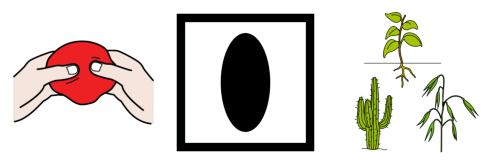

Oracion: pict_10276_quién pict_8476_el pict_11258_escritor
3
Procesando: ./imagenes_procesadas/pict_10276.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_11258.png


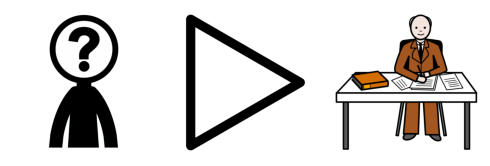

Prediction pict_22619_cómo pict_5581_ser pict_8476_el pict_4649_feria
4
['./imagenes_procesadas/pict_22619.png', './imagenes_procesadas/pict_5581.png', './imagenes_procesadas/pict_8476.png', './imagenes_procesadas/pict_4649.png']
Procesando: ./imagenes_procesadas/pict_22619.png
Procesando: ./imagenes_procesadas/pict_5581.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_4649.png


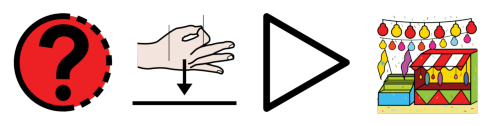

Oracion: pict_8975_lavar_las_manos pict_32745_antes pict_6456_comer
3
Procesando: ./imagenes_procesadas/pict_8975.png
Procesando: ./imagenes_procesadas/pict_32745.png
Procesando: ./imagenes_procesadas/pict_6456.png


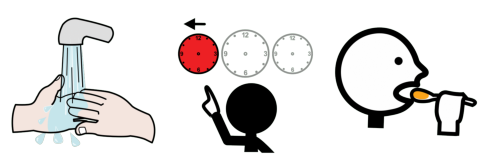

Prediction pict_7141_leer pict_7031_las pict_11572_plantas pict_11470_importante pict_7074_de pict_11691_cuidar
6
['./imagenes_procesadas/pict_7141.png', './imagenes_procesadas/pict_7031.png', './imagenes_procesadas/pict_11572.png', './imagenes_procesadas/pict_11470.png', './imagenes_procesadas/pict_7074.png', './imagenes_procesadas/pict_11691.png']
Procesando: ./imagenes_procesadas/pict_7141.png
Procesando: ./imagenes_procesadas/pict_7031.png
Procesando: ./imagenes_procesadas/pict_11572.png
Procesando: ./imagenes_procesadas/pict_11470.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_11691.png


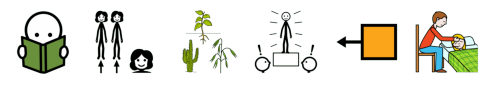

Oracion: pict_38459_recoger_basura
1
Procesando: ./imagenes_procesadas/pict_38459.png


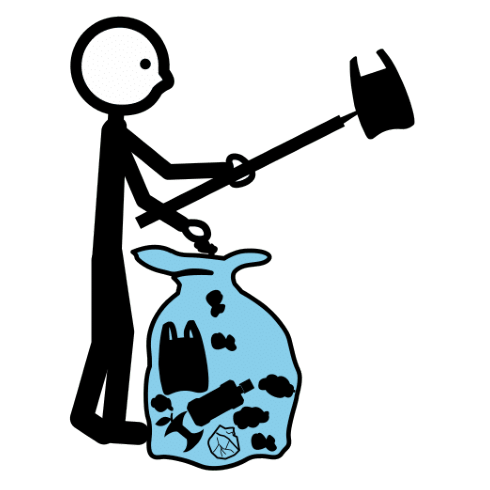

Prediction pict_2474_observar pict_7029_la pict_2248_agua
3
['./imagenes_procesadas/pict_2474.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_2248.png']
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_2248.png


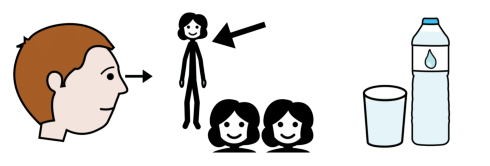

Oracion: pict_5441_yo_quiero pict_4772_visitar pict_10194_abuela
3
Procesando: ./imagenes_procesadas/pict_5441.png
Procesando: ./imagenes_procesadas/pict_4772.png
Procesando: ./imagenes_procesadas/pict_10194.png


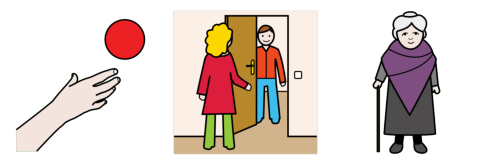

Prediction pict_35653_organizar pict_7271_tener pict_35653_organizar pict_3021_a pict_7029_la pict_35477_paso
6
['./imagenes_procesadas/pict_35653.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_35653.png', './imagenes_procesadas/pict_3021.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_35477.png']
Procesando: ./imagenes_procesadas/pict_35653.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_35653.png
Procesando: ./imagenes_procesadas/pict_3021.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_35477.png


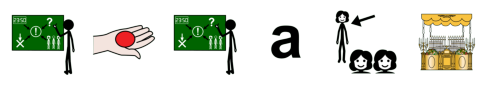

Oracion: pict_2474_observar #9180#nudo
2
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: #9180#nudo


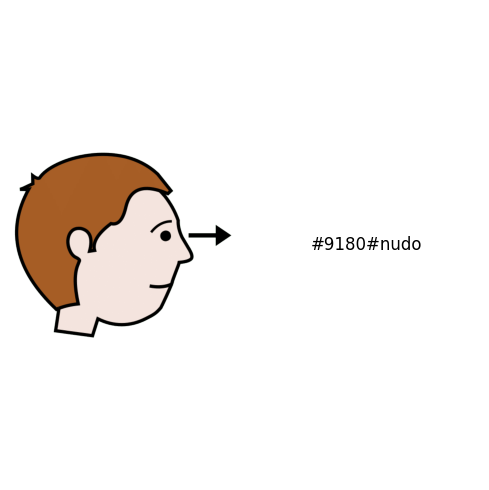

Prediction pict_8579_explicar pict_8476_el nudo
3
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_8476.png', 'nudo']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: nudo


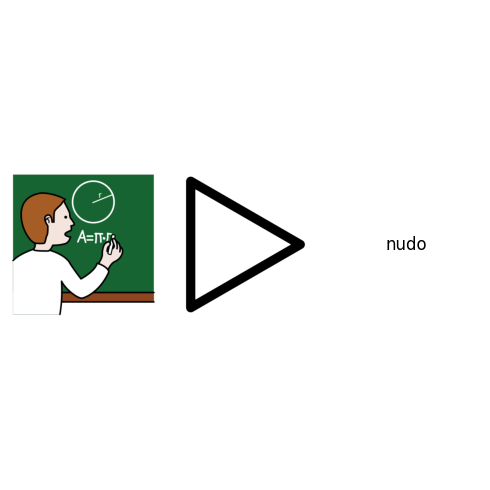

Oracion: pict_2474_observar pict_8476_la pict_38604_botella_de_metal
3
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_38604.png


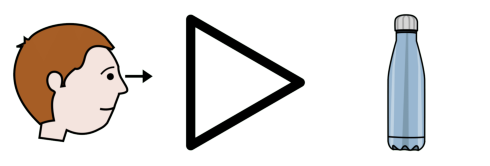

Prediction pict_8579_explicar pict_7029_la pict_2248_agua pict_7074_de pict_2248_agua
5
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_2248.png', './imagenes_procesadas/pict_7074.png', './imagenes_procesadas/pict_2248.png']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_2248.png
Procesando: ./imagenes_procesadas/pict_7074.png
Procesando: ./imagenes_procesadas/pict_2248.png


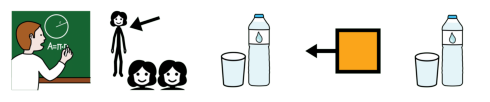

Oracion: pict_2617_yo pict_5441_quiero pict_4671_viajar pict_25207_Machu_picchu
4
Procesando: ./imagenes_procesadas/pict_2617.png
Procesando: ./imagenes_procesadas/pict_5441.png
Procesando: ./imagenes_procesadas/pict_4671.png
Procesando: ./imagenes_procesadas/pict_25207.png


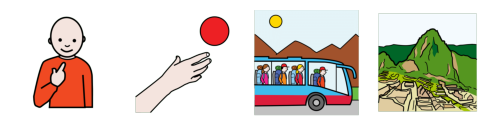

Prediction pict_5526_no pict_7271_tener pict_11691_cuidar machu picchu
5
['./imagenes_procesadas/pict_5526.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_11691.png', 'machu', 'picchu']
Procesando: ./imagenes_procesadas/pict_5526.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_11691.png
Procesando: machu
Procesando: picchu


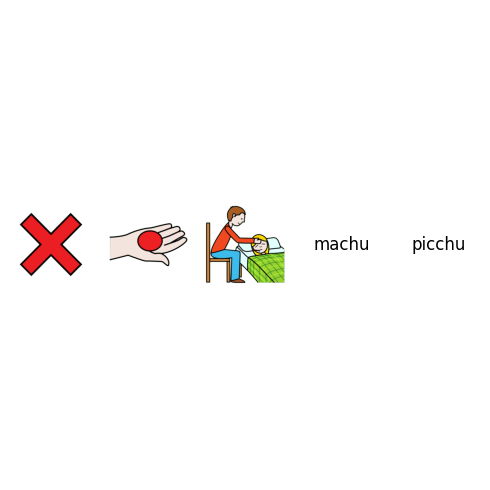

Oracion: pict_2474_observar pict_8476_la pict_7805_receta pict_11712_del pict_7216_postre
5
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_7805.png
Procesando: ./imagenes_procesadas/pict_11712.png
Procesando: ./imagenes_procesadas/pict_7216.png


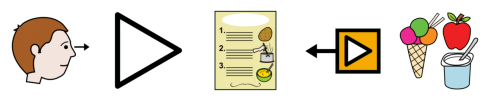

Prediction pict_15485_usar pict_7029_la pict_9870_exposición pict_11712_del pict_35477_paso
5
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_9870.png', './imagenes_procesadas/pict_11712.png', './imagenes_procesadas/pict_35477.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_9870.png
Procesando: ./imagenes_procesadas/pict_11712.png
Procesando: ./imagenes_procesadas/pict_35477.png


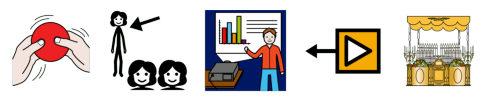

Oracion: pict_27331_seguir pict_31680_leer
2
Procesando: ./imagenes_procesadas/pict_27331.png
Procesando: ./imagenes_procesadas/pict_31680.png


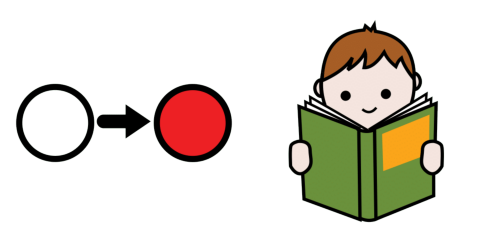

Prediction pict_11749_hacer pict_2380_escribir
2
['./imagenes_procesadas/pict_11749.png', './imagenes_procesadas/pict_2380.png']
Procesando: ./imagenes_procesadas/pict_11749.png
Procesando: ./imagenes_procesadas/pict_2380.png


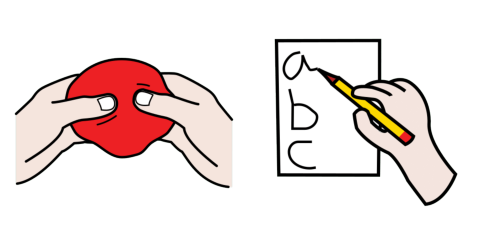

Oracion: pict_35653_organizar pict_3065_biblioteca pict_11712_del pict_3082_colegio
4
Procesando: ./imagenes_procesadas/pict_35653.png
Procesando: ./imagenes_procesadas/pict_3065.png
Procesando: ./imagenes_procesadas/pict_11712.png
Procesando: ./imagenes_procesadas/pict_3082.png


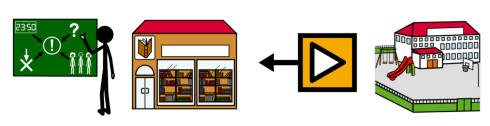

Prediction pict_15485_usar pict_7029_la pict_9870_exposición pict_11712_del pict_9819_lugar
5
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_9870.png', './imagenes_procesadas/pict_11712.png', './imagenes_procesadas/pict_9819.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_9870.png
Procesando: ./imagenes_procesadas/pict_11712.png
Procesando: ./imagenes_procesadas/pict_9819.png


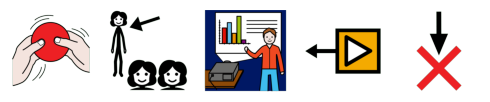

Oracion: pict_3379_pulpo
1
Procesando: ./imagenes_procesadas/pict_3379.png


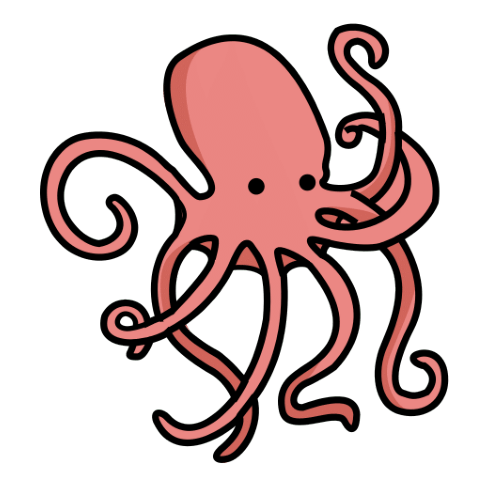

Prediction kraken
1
['kraken']
Procesando: kraken


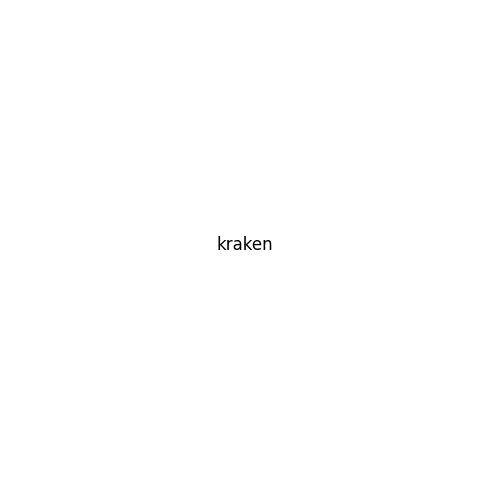

Oracion: pict_9857_quiénes pict_11475_participar
2
Procesando: ./imagenes_procesadas/pict_9857.png
Procesando: ./imagenes_procesadas/pict_11475.png


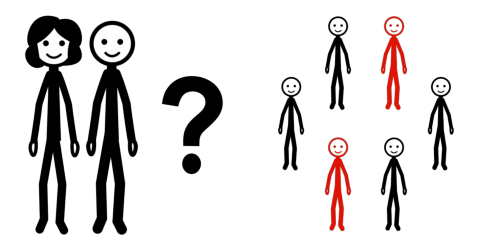

Prediction pict_3415_¿ pict_22619_cómo pict_8029_aprender pict_3418_?
4
['./imagenes_procesadas/pict_3415.png', './imagenes_procesadas/pict_22619.png', './imagenes_procesadas/pict_8029.png', './imagenes_procesadas/pict_3418.png']
Procesando: ./imagenes_procesadas/pict_3415.png
Procesando: ./imagenes_procesadas/pict_22619.png
Procesando: ./imagenes_procesadas/pict_8029.png
Procesando: ./imagenes_procesadas/pict_3418.png


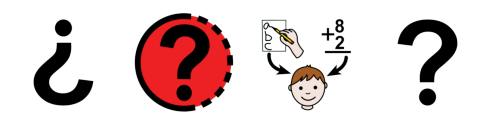

Oracion: pict_2474_observar pict_6632_yo pict_2871_oreja
3
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_6632.png
Procesando: ./imagenes_procesadas/pict_2871.png


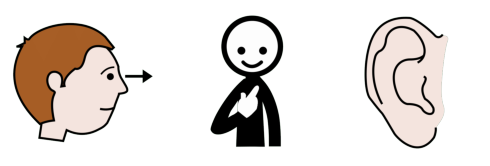

Prediction pict_8579_explicar pict_12281_tu pict_22769_artesanía
3
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_12281.png', './imagenes_procesadas/pict_22769.png']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_12281.png
Procesando: ./imagenes_procesadas/pict_22769.png


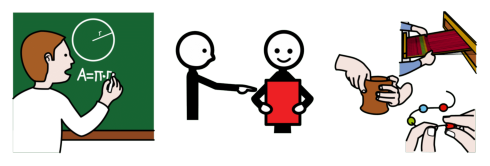

Oracion: pict_37711_resolver pict_8476_el pict_38462_exámen
3
Procesando: ./imagenes_procesadas/pict_37711.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_38462.png


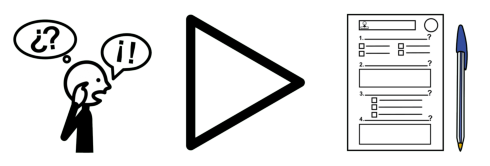

Prediction pict_35653_organizar pict_8476_el pict_9870_exposición
3
['./imagenes_procesadas/pict_35653.png', './imagenes_procesadas/pict_8476.png', './imagenes_procesadas/pict_9870.png']
Procesando: ./imagenes_procesadas/pict_35653.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_9870.png


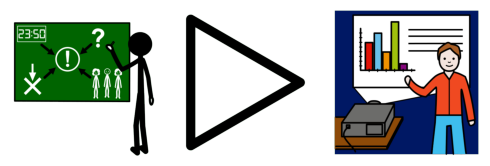

Oracion: pict_8476_la pict_2609_vaca pict_28431_dar pict_2445_leche
4
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_2609.png
Procesando: ./imagenes_procesadas/pict_28431.png
Procesando: ./imagenes_procesadas/pict_2445.png


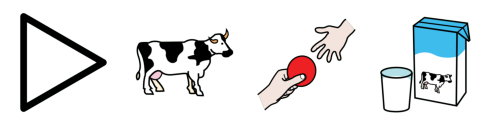

Prediction pict_7029_la pict_6901_animales pict_6481_se pict_2248_agua
4
['./imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_6901.png', './imagenes_procesadas/pict_6481.png', './imagenes_procesadas/pict_2248.png']
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_6901.png
Procesando: ./imagenes_procesadas/pict_6481.png
Procesando: ./imagenes_procesadas/pict_2248.png


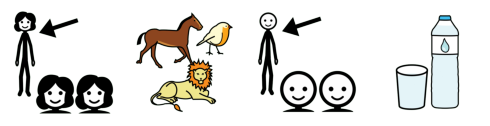

Oracion: pict_6219_subrayar pict_8476_la pict_39235_letra
3
Procesando: ./imagenes_procesadas/pict_6219.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_39235.png


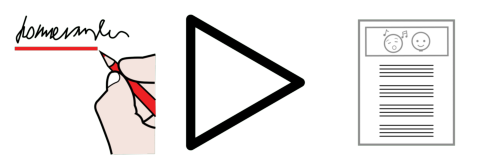

Prediction pict_9870_presentar pict_7029_la pict_9870_exposición
3
['./imagenes_procesadas/pict_9870.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_9870.png']
Procesando: ./imagenes_procesadas/pict_9870.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_9870.png


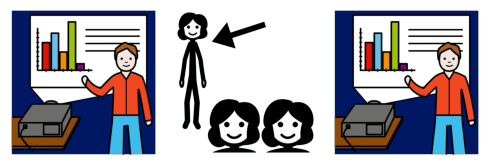

Oracion: pict_2978_hilo pict_11399_y pict_2639_aguja
3
Procesando: ./imagenes_procesadas/pict_2978.png
Procesando: ./imagenes_procesadas/pict_11399.png
Procesando: ./imagenes_procesadas/pict_2639.png


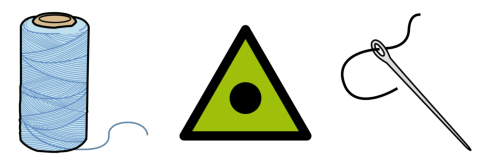

Prediction pict_35477_paso pict_3047_y pict_35477_paso
3
['./imagenes_procesadas/pict_35477.png', './imagenes_procesadas/pict_3047.png', './imagenes_procesadas/pict_35477.png']
Procesando: ./imagenes_procesadas/pict_35477.png
Procesando: ./imagenes_procesadas/pict_3047.png
Procesando: ./imagenes_procesadas/pict_35477.png


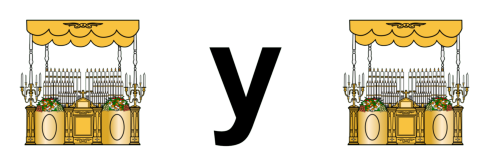

Oracion: pict_11316_nueva pict_16037_información
2
Procesando: ./imagenes_procesadas/pict_11316.png
Procesando: ./imagenes_procesadas/pict_16037.png


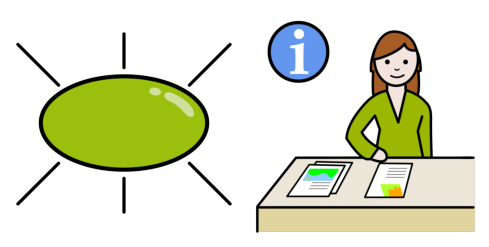

Prediction pict_12264_mi pict_37340_texto
2
['./imagenes_procesadas/pict_12264.png', './imagenes_procesadas/pict_37340.png']
Procesando: ./imagenes_procesadas/pict_12264.png
Procesando: ./imagenes_procesadas/pict_37340.png


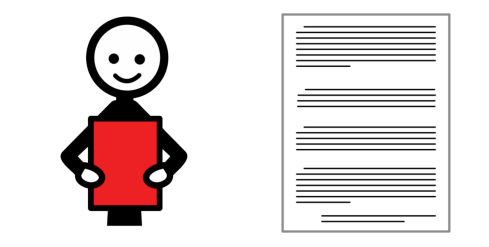

Oracion: pict_24863_atención pict_7041_a pict_8476_la pict_2456_profesora
4
Procesando: ./imagenes_procesadas/pict_24863.png
Procesando: ./imagenes_procesadas/pict_7041.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_2456.png


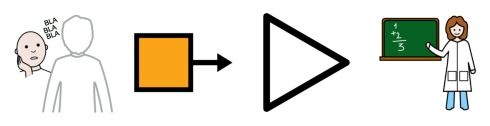

Prediction pict_9819_lugar pict_3021_a pict_7029_la pict_9870_exposición
4
['./imagenes_procesadas/pict_9819.png', './imagenes_procesadas/pict_3021.png', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_9870.png']
Procesando: ./imagenes_procesadas/pict_9819.png
Procesando: ./imagenes_procesadas/pict_3021.png
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_9870.png


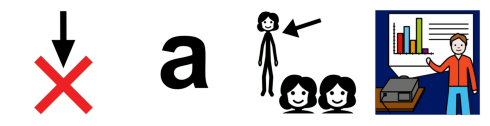

Oracion: pict_31807_yo pict_25033_cristiano
2
Procesando: ./imagenes_procesadas/pict_31807.png
Procesando: ./imagenes_procesadas/pict_25033.png


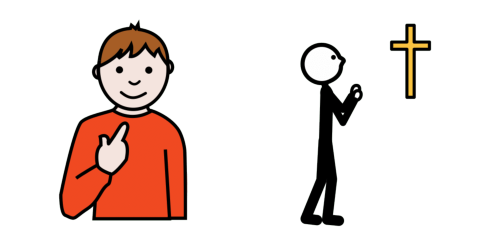

Prediction pict_15485_usar pict_5581_ser cristiano
3
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_5581.png', 'cristiano']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_5581.png
Procesando: cristiano


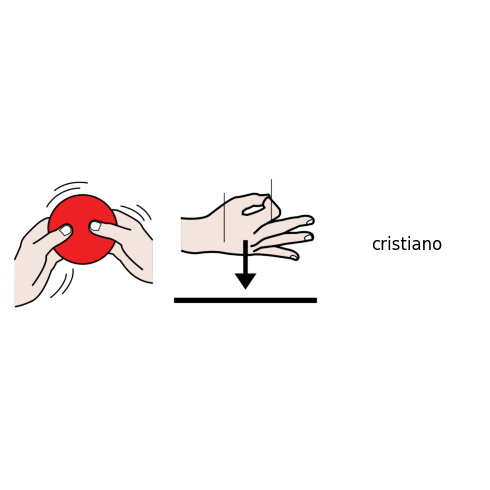

Oracion: pict_9870_exponer pict_8474_una pict_11696_duda
3
Procesando: ./imagenes_procesadas/pict_9870.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_11696.png


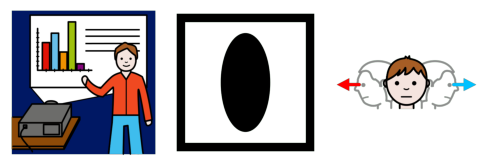

Prediction pict_8579_explicar pict_8474_una duda
3
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_8474.png', 'duda']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: duda


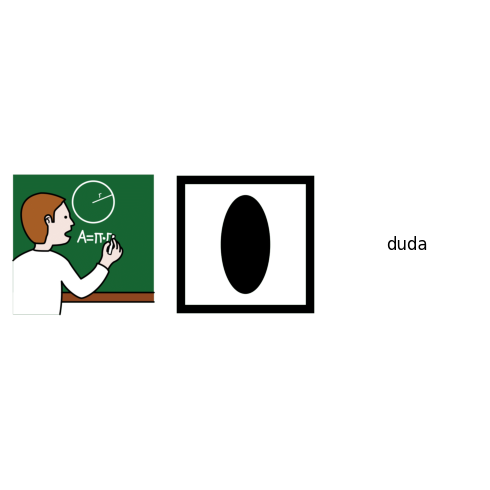

Oracion: pict_4691_marcar pict_7041_a pict_31146_papá
3
Procesando: ./imagenes_procesadas/pict_4691.png
Procesando: ./imagenes_procesadas/pict_7041.png
Procesando: ./imagenes_procesadas/pict_31146.png


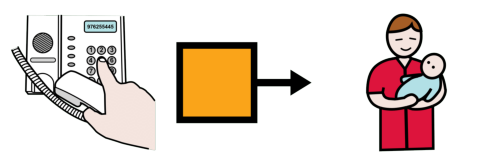

Prediction pict_35653_organizar pict_3021_a pict_6901_animales
3
['./imagenes_procesadas/pict_35653.png', './imagenes_procesadas/pict_3021.png', './imagenes_procesadas/pict_6901.png']
Procesando: ./imagenes_procesadas/pict_35653.png
Procesando: ./imagenes_procesadas/pict_3021.png
Procesando: ./imagenes_procesadas/pict_6901.png


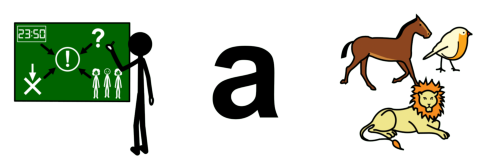

Oracion: pict_22619_cómo pict_5431_empezar
2
Procesando: ./imagenes_procesadas/pict_22619.png
Procesando: ./imagenes_procesadas/pict_5431.png


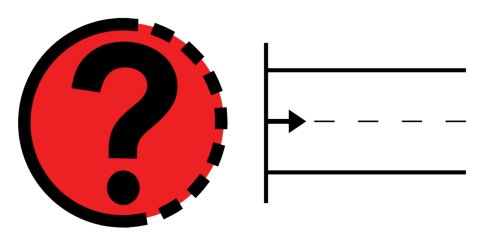

Prediction pict_3415_¿ pict_22619_cómo pict_8029_aprender pict_3418_?
4
['./imagenes_procesadas/pict_3415.png', './imagenes_procesadas/pict_22619.png', './imagenes_procesadas/pict_8029.png', './imagenes_procesadas/pict_3418.png']
Procesando: ./imagenes_procesadas/pict_3415.png
Procesando: ./imagenes_procesadas/pict_22619.png
Procesando: ./imagenes_procesadas/pict_8029.png
Procesando: ./imagenes_procesadas/pict_3418.png


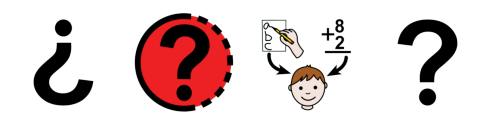

Oracion: pict_37779_alguien pict_6632_me pict_2381_escuchar
3
Procesando: ./imagenes_procesadas/pict_37779.png
Procesando: ./imagenes_procesadas/pict_6632.png
Procesando: ./imagenes_procesadas/pict_2381.png


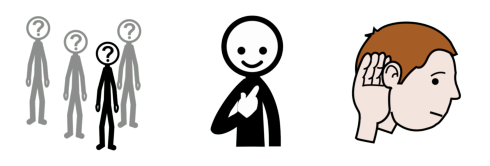

Prediction pict_3415_¿ pict_22619_cómo pict_7271_tener pict_3345_hablar pict_3418_?
5
['./imagenes_procesadas/pict_3415.png', './imagenes_procesadas/pict_22619.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_3345.png', './imagenes_procesadas/pict_3418.png']
Procesando: ./imagenes_procesadas/pict_3415.png
Procesando: ./imagenes_procesadas/pict_22619.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_3345.png
Procesando: ./imagenes_procesadas/pict_3418.png


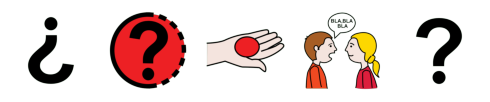

Oracion: pict_28659_escuchar pict_8477_los pict_21537_chiste
3
Procesando: ./imagenes_procesadas/pict_28659.png
Procesando: ./imagenes_procesadas/pict_8477.png
Procesando: ./imagenes_procesadas/pict_21537.png


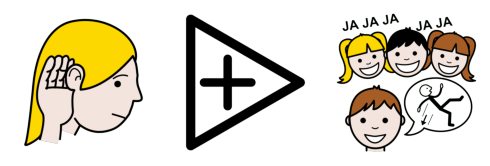

Prediction pict_2380_escribir pict_7033_los pict_4604_claro
3
['./imagenes_procesadas/pict_2380.png', './imagenes_procesadas/pict_7033.png', './imagenes_procesadas/pict_4604.png']
Procesando: ./imagenes_procesadas/pict_2380.png
Procesando: ./imagenes_procesadas/pict_7033.png
Procesando: ./imagenes_procesadas/pict_4604.png


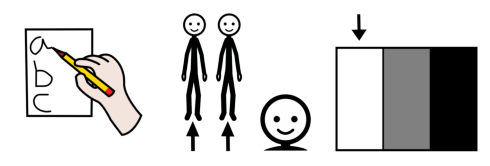

Oracion: pict_33065_patio pict_11712_del pict_3082_colegio
3
Procesando: ./imagenes_procesadas/pict_33065.png
Procesando: ./imagenes_procesadas/pict_11712.png
Procesando: ./imagenes_procesadas/pict_3082.png


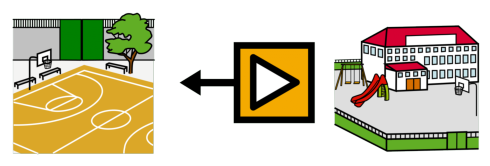

Prediction pict_8185_Perú pict_11712_del pict_4649_feria
3
['./imagenes_procesadas/pict_8185.png', './imagenes_procesadas/pict_11712.png', './imagenes_procesadas/pict_4649.png']
Procesando: ./imagenes_procesadas/pict_8185.png
Procesando: ./imagenes_procesadas/pict_11712.png
Procesando: ./imagenes_procesadas/pict_4649.png


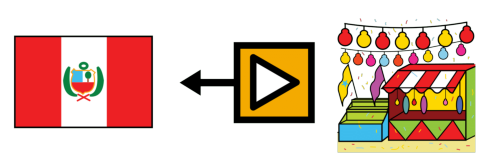

Oracion: pict_5441_quiero pict_7141_leer pict_8474_un pict_6469_cuento
4
Procesando: ./imagenes_procesadas/pict_5441.png
Procesando: ./imagenes_procesadas/pict_7141.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_6469.png


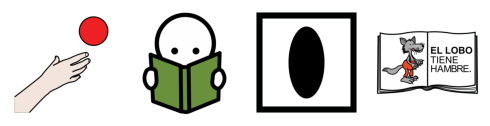

Prediction pict_15485_usar pict_7271_tener pict_7141_leer pict_8474_un pict_7217_pregunta
5
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_7141.png', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_7217.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_7141.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_7217.png


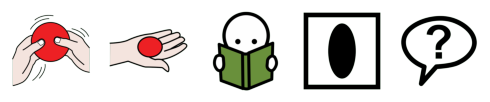

Oracion: pict_31807_yo pict_4655_fuerte
2
Procesando: ./imagenes_procesadas/pict_31807.png
Procesando: ./imagenes_procesadas/pict_4655.png


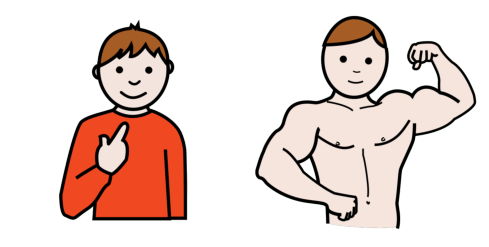

Prediction pict_15485_usar pict_5581_ser pict_11470_importante
3
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_5581.png', './imagenes_procesadas/pict_11470.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_5581.png
Procesando: ./imagenes_procesadas/pict_11470.png


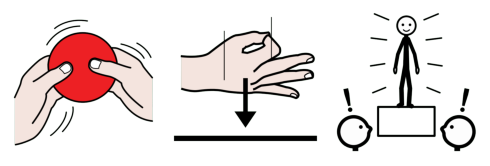

Oracion: pict_2381_escuchar pict_8476_la pict_38211_botón_de_radio
3
Procesando: ./imagenes_procesadas/pict_2381.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_38211.png


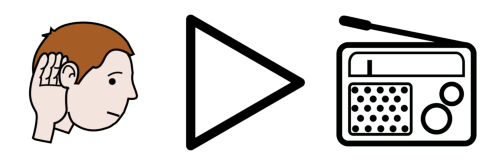

Prediction escuchen pict_7029_la pict_2248_agua
3
['escuchen', './imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_2248.png']
Procesando: escuchen
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_2248.png


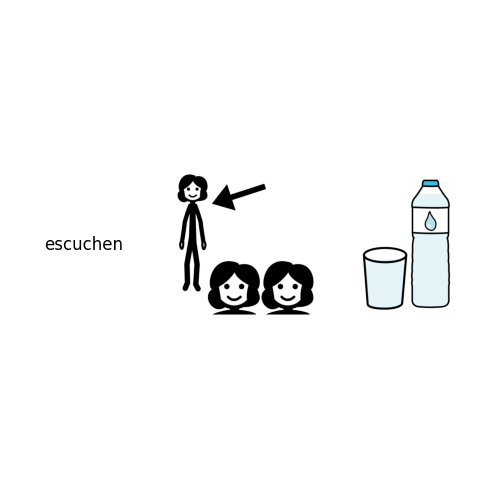

Oracion: pict_7820_trucha
1
Procesando: ./imagenes_procesadas/pict_7820.png


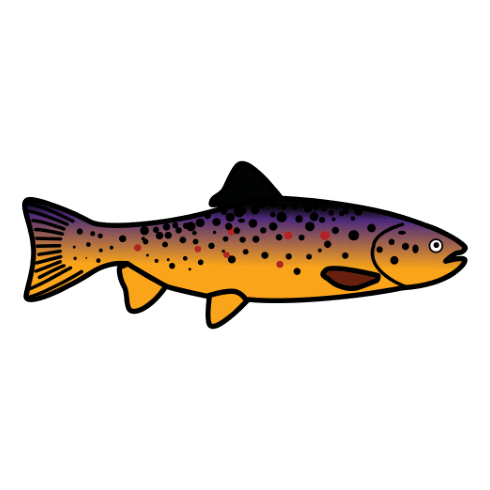

Prediction trucha
1
['trucha']
Procesando: trucha


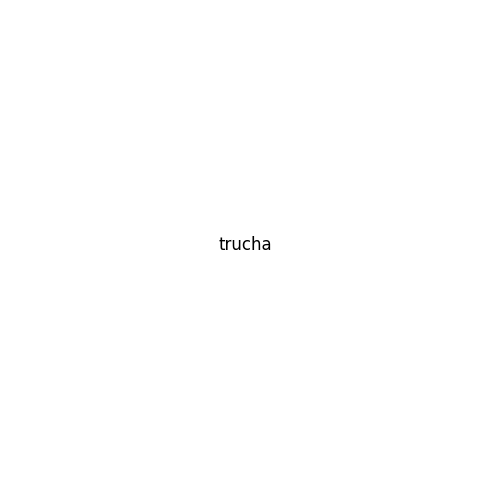

Oracion: pict_11247_derechos pict_11712_del pict_7176_niño
3
Procesando: ./imagenes_procesadas/pict_11247.png
Procesando: ./imagenes_procesadas/pict_11712.png
Procesando: ./imagenes_procesadas/pict_7176.png


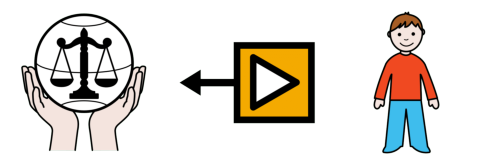

Prediction pict_7033_los pict_11572_plantas pict_11712_del pict_9819_lugar
4
['./imagenes_procesadas/pict_7033.png', './imagenes_procesadas/pict_11572.png', './imagenes_procesadas/pict_11712.png', './imagenes_procesadas/pict_9819.png']
Procesando: ./imagenes_procesadas/pict_7033.png
Procesando: ./imagenes_procesadas/pict_11572.png
Procesando: ./imagenes_procesadas/pict_11712.png
Procesando: ./imagenes_procesadas/pict_9819.png


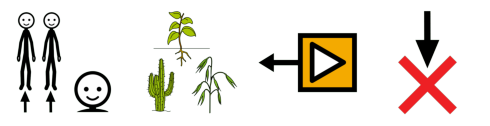

Oracion: pict_8476_la pict_28003_maestra pict_6632_me pict_6998_corregir
4
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_28003.png
Procesando: ./imagenes_procesadas/pict_6632.png
Procesando: ./imagenes_procesadas/pict_6998.png


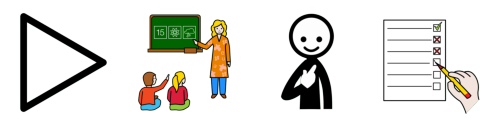

Prediction pict_7029_la pict_35477_paso pict_7271_tener pict_11691_cuidar
4
['./imagenes_procesadas/pict_7029.png', './imagenes_procesadas/pict_35477.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_11691.png']
Procesando: ./imagenes_procesadas/pict_7029.png
Procesando: ./imagenes_procesadas/pict_35477.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_11691.png


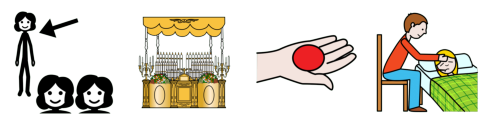

Oracion: pict_13358_quiénes pict_6481_lo pict_32751_hacer
3
Procesando: ./imagenes_procesadas/pict_13358.png
Procesando: ./imagenes_procesadas/pict_6481.png
Procesando: ./imagenes_procesadas/pict_32751.png


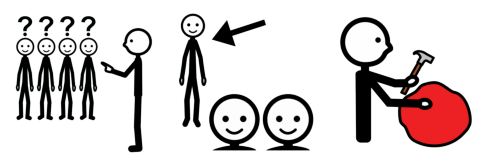

Prediction pict_3415_¿ pict_22619_cómo pict_6481_lo pict_11749_hacer pict_3418_?
5
['./imagenes_procesadas/pict_3415.png', './imagenes_procesadas/pict_22619.png', './imagenes_procesadas/pict_6481.png', './imagenes_procesadas/pict_11749.png', './imagenes_procesadas/pict_3418.png']
Procesando: ./imagenes_procesadas/pict_3415.png
Procesando: ./imagenes_procesadas/pict_22619.png
Procesando: ./imagenes_procesadas/pict_6481.png
Procesando: ./imagenes_procesadas/pict_11749.png
Procesando: ./imagenes_procesadas/pict_3418.png


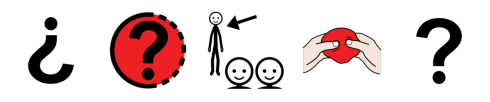

Oracion: pict_7065_contaminar pict_8476_el pict_38586_pueblo
3
Procesando: ./imagenes_procesadas/pict_7065.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_38586.png


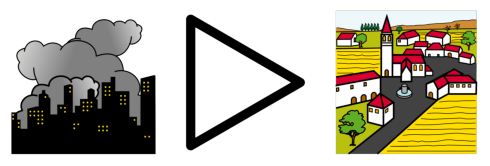

Prediction pict_11691_cuidar pict_8476_el pict_9819_lugar
3
['./imagenes_procesadas/pict_11691.png', './imagenes_procesadas/pict_8476.png', './imagenes_procesadas/pict_9819.png']
Procesando: ./imagenes_procesadas/pict_11691.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_9819.png


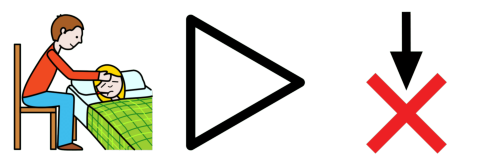

Oracion: pict_6022_lago pict_11399_y pict_10306_ríos
3
Procesando: ./imagenes_procesadas/pict_6022.png
Procesando: ./imagenes_procesadas/pict_11399.png
Procesando: ./imagenes_procesadas/pict_10306.png


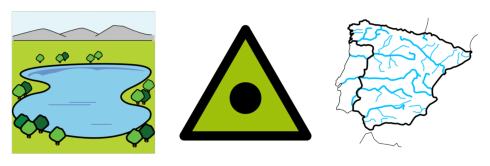

Prediction pict_2248_agua pict_3047_y pict_2248_agua
3
['./imagenes_procesadas/pict_2248.png', './imagenes_procesadas/pict_3047.png', './imagenes_procesadas/pict_2248.png']
Procesando: ./imagenes_procesadas/pict_2248.png
Procesando: ./imagenes_procesadas/pict_3047.png
Procesando: ./imagenes_procesadas/pict_2248.png


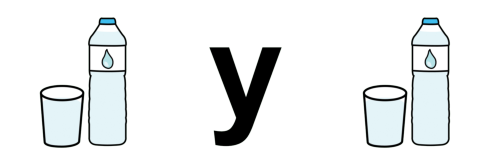

Oracion: pict_21828_enviar pict_37340_mensaje_escrito pict_32302_fácil pict_11399_y pict_26002_corto
5
Procesando: ./imagenes_procesadas/pict_21828.png
Procesando: ./imagenes_procesadas/pict_37340.png
Procesando: ./imagenes_procesadas/pict_32302.png
Procesando: ./imagenes_procesadas/pict_11399.png
Procesando: ./imagenes_procesadas/pict_26002.png


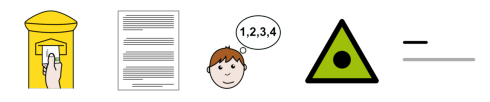

Prediction enviamos pict_8474_un mensaje pict_11470_importante pict_3047_y pict_4604_claro
6
['enviamos', './imagenes_procesadas/pict_8474.png', 'mensaje', './imagenes_procesadas/pict_11470.png', './imagenes_procesadas/pict_3047.png', './imagenes_procesadas/pict_4604.png']
Procesando: enviamos
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: mensaje
Procesando: ./imagenes_procesadas/pict_11470.png
Procesando: ./imagenes_procesadas/pict_3047.png
Procesando: ./imagenes_procesadas/pict_4604.png


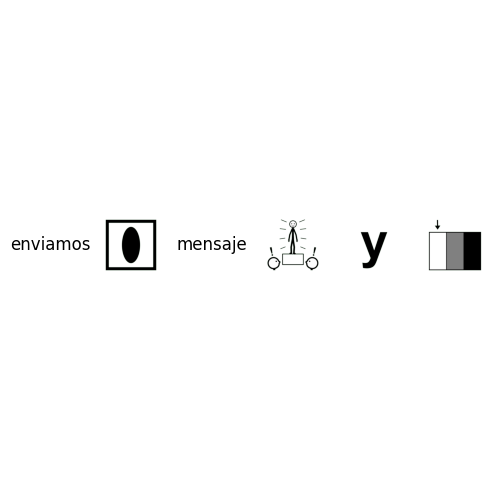

Oracion: pict_32862_compartir_una_idea
1
Procesando: ./imagenes_procesadas/pict_32862.png


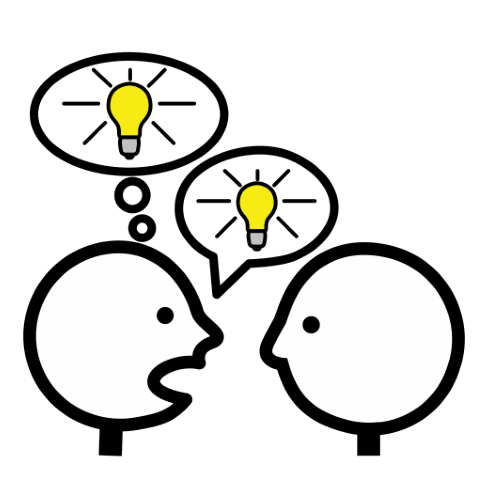

Prediction pict_8579_explicar pict_8474_una idea
3
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_8474.png', 'idea']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: idea


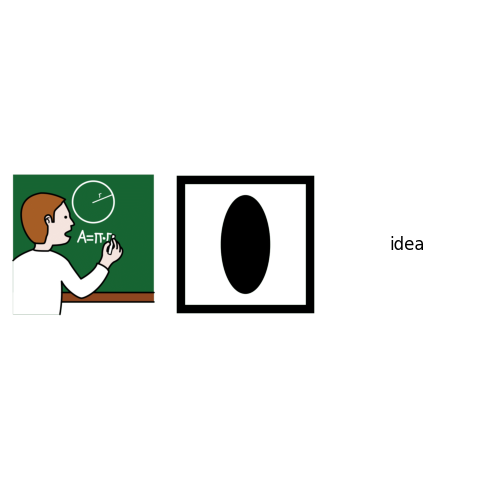

Oracion: pict_31807_yo pict_5441_quiero pict_9870_exponer
3
Procesando: ./imagenes_procesadas/pict_31807.png
Procesando: ./imagenes_procesadas/pict_5441.png
Procesando: ./imagenes_procesadas/pict_9870.png


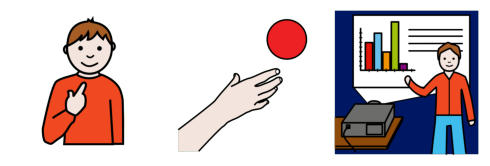

Prediction pict_15485_usar pict_7271_tener pict_8579_explicar
3
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_8579.png']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_8579.png


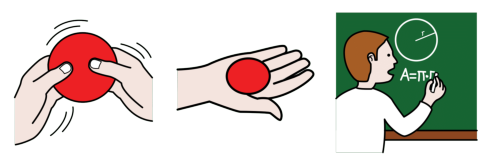

Oracion: pict_5441_yo_quiero pict_4880_hacer_pis
2
Procesando: ./imagenes_procesadas/pict_5441.png
Procesando: ./imagenes_procesadas/pict_4880.png


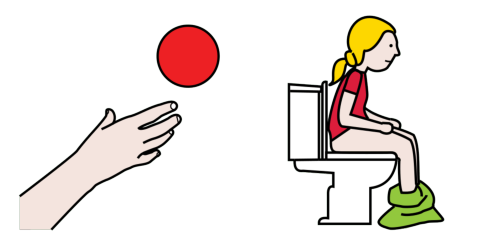

Prediction pict_15485_usar pict_7271_tener pict_11749_hacer pis
4
['./imagenes_procesadas/pict_15485.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_11749.png', 'pis']
Procesando: ./imagenes_procesadas/pict_15485.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_11749.png
Procesando: pis


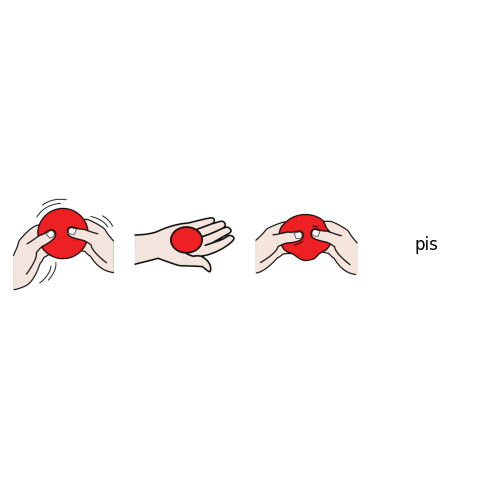

Oracion: pict_2474_observar pict_8476_el pict_2322_cd
3
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_2322.png


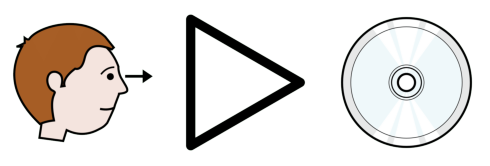

Prediction pict_8579_explicar pict_8476_el cd
3
['./imagenes_procesadas/pict_8579.png', './imagenes_procesadas/pict_8476.png', 'cd']
Procesando: ./imagenes_procesadas/pict_8579.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: cd


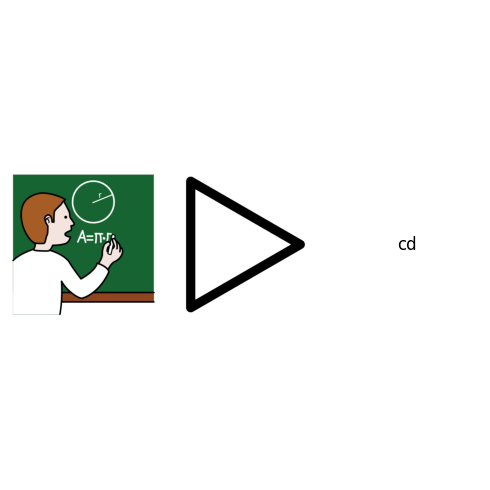

Oracion: pict_38442_masa
1
Procesando: ./imagenes_procesadas/pict_38442.png


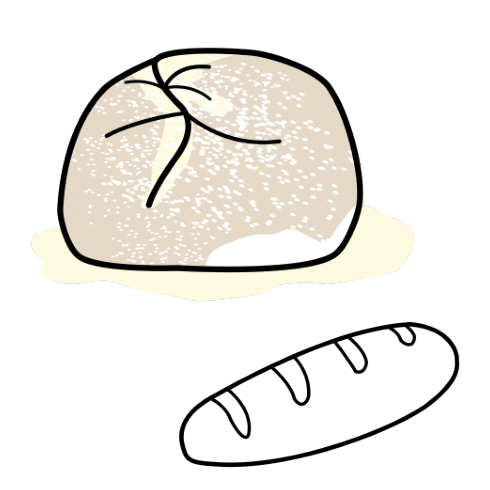

Prediction pict_11572_plantas
1
['./imagenes_procesadas/pict_11572.png']
Procesando: ./imagenes_procesadas/pict_11572.png


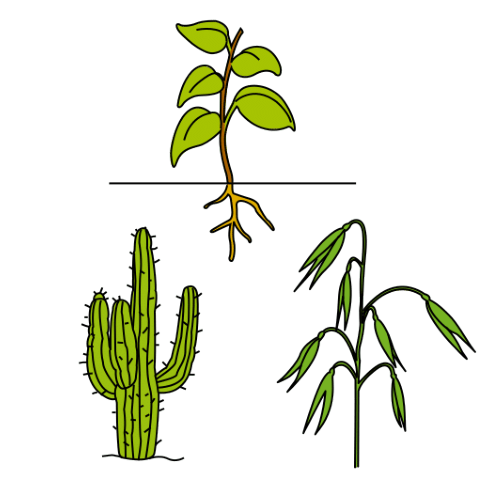

Oracion: pict_5441_yo_quiero pict_24031_evitar pict_31150_caerse_patinando
3
Procesando: ./imagenes_procesadas/pict_5441.png
Procesando: ./imagenes_procesadas/pict_24031.png
Procesando: ./imagenes_procesadas/pict_31150.png


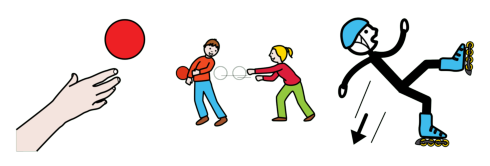

Prediction pict_5526_no pict_7271_tener pict_5526_no pict_11691_cuidar pict_7002_crecer pict_35477_paso
6
['./imagenes_procesadas/pict_5526.png', './imagenes_procesadas/pict_7271.png', './imagenes_procesadas/pict_5526.png', './imagenes_procesadas/pict_11691.png', './imagenes_procesadas/pict_7002.png', './imagenes_procesadas/pict_35477.png']
Procesando: ./imagenes_procesadas/pict_5526.png
Procesando: ./imagenes_procesadas/pict_7271.png
Procesando: ./imagenes_procesadas/pict_5526.png
Procesando: ./imagenes_procesadas/pict_11691.png
Procesando: ./imagenes_procesadas/pict_7002.png
Procesando: ./imagenes_procesadas/pict_35477.png


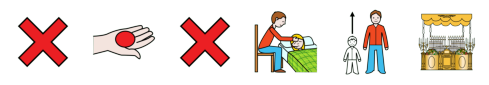

Oracion: pict_2511_pegar pict_8476_el pict_11238_dibujo
3
Procesando: ./imagenes_procesadas/pict_2511.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_11238.png


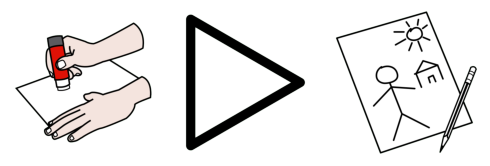

Prediction pict_11691_cuidar pict_8476_el pict_37340_texto
3
['./imagenes_procesadas/pict_11691.png', './imagenes_procesadas/pict_8476.png', './imagenes_procesadas/pict_37340.png']
Procesando: ./imagenes_procesadas/pict_11691.png
Procesando: ./imagenes_procesadas/pict_8476.png
Procesando: ./imagenes_procesadas/pict_37340.png


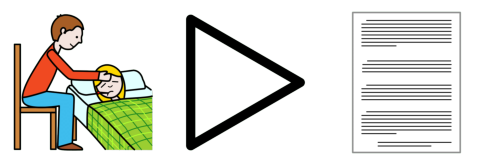

Oracion: pict_6517_hablar pict_7813_sin pict_4686_gritar
3
Procesando: ./imagenes_procesadas/pict_6517.png
Procesando: ./imagenes_procesadas/pict_7813.png
Procesando: ./imagenes_procesadas/pict_4686.png


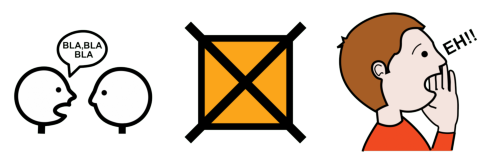

Prediction pict_3345_hablar pict_7064_con pict_11691_cuidar
3
['./imagenes_procesadas/pict_3345.png', './imagenes_procesadas/pict_7064.png', './imagenes_procesadas/pict_11691.png']
Procesando: ./imagenes_procesadas/pict_3345.png
Procesando: ./imagenes_procesadas/pict_7064.png
Procesando: ./imagenes_procesadas/pict_11691.png


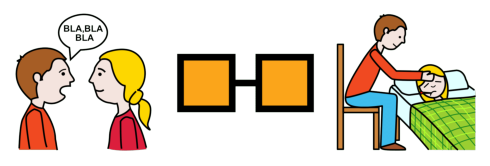

Oracion: pict_2474_observar pict_32302_fácil
2
Procesando: ./imagenes_procesadas/pict_2474.png
Procesando: ./imagenes_procesadas/pict_32302.png


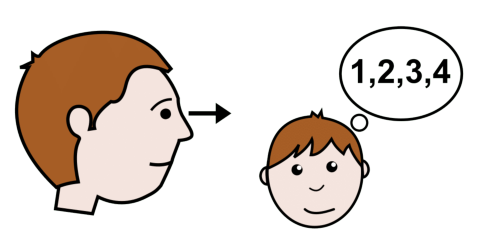

Prediction pict_2380_escribir pict_3189_, pict_5581_ser facil
4
['./imagenes_procesadas/pict_2380.png', './imagenes_procesadas/pict_3189.png', './imagenes_procesadas/pict_5581.png', 'facil']
Procesando: ./imagenes_procesadas/pict_2380.png
Procesando: ./imagenes_procesadas/pict_3189.png
Procesando: ./imagenes_procesadas/pict_5581.png
Procesando: facil


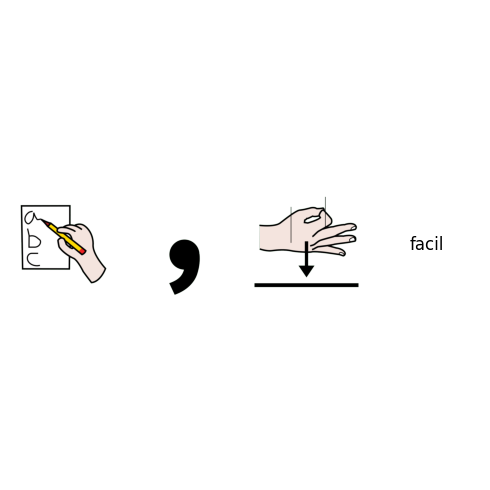

Oracion: pict_7037_seguir pict_8477_las pict_34705_instrucciones
3
Procesando: ./imagenes_procesadas/pict_7037.png
Procesando: ./imagenes_procesadas/pict_8477.png
Procesando: ./imagenes_procesadas/pict_34705.png


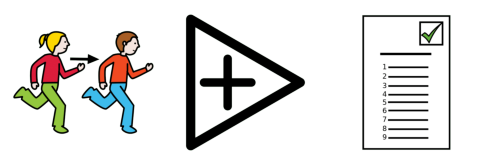

Prediction pict_11749_hacer pict_7031_las pict_7217_pregunta
3
['./imagenes_procesadas/pict_11749.png', './imagenes_procesadas/pict_7031.png', './imagenes_procesadas/pict_7217.png']
Procesando: ./imagenes_procesadas/pict_11749.png
Procesando: ./imagenes_procesadas/pict_7031.png
Procesando: ./imagenes_procesadas/pict_7217.png


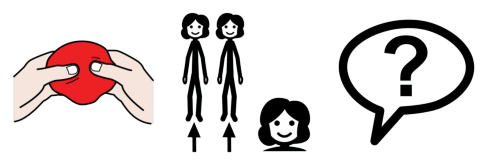

Oracion: pict_7141_leer pict_8474_un pict_11194_bello pict_22763_poesía
4
Procesando: ./imagenes_procesadas/pict_7141.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_11194.png
Procesando: ./imagenes_procesadas/pict_22763.png


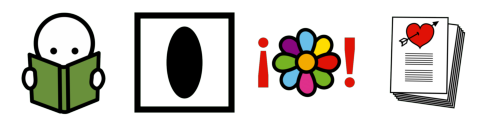

Prediction pict_7141_leer pict_8474_un pict_4604_claro poema
4
['./imagenes_procesadas/pict_7141.png', './imagenes_procesadas/pict_8474.png', './imagenes_procesadas/pict_4604.png', 'poema']
Procesando: ./imagenes_procesadas/pict_7141.png
Procesando: ./imagenes_procesadas/pict_8474.png
Procesando: ./imagenes_procesadas/pict_4604.png
Procesando: poema


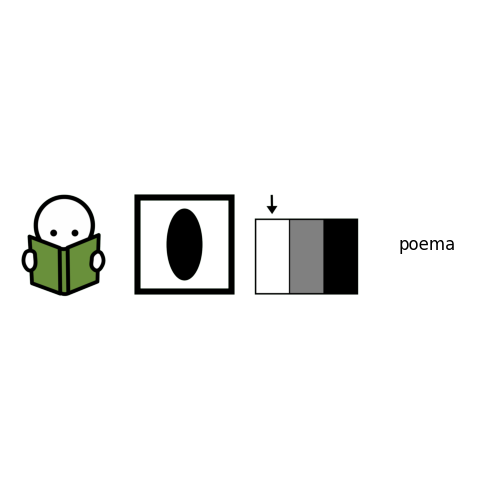

In [30]:
import os

for i, prediction in enumerate(predictions):
    
    print(f"Oracion: {str(dataset_valid[i]['traduccion'])}")
    originalTraduccion = obtener_tokens(str(dataset_valid[i]['traduccion']))

    imprimir_imagenes(originalTraduccion)

    print(f"Prediction {prediction}")
    
    tokens = obtener_tokens(prediction) 
    
    print(tokens)
    imprimir_imagenes(tokens)

#rutas_imagenes = []
#for elemento in tokens:
#  rutas_imagenes.append(obtener_ruta(elemento))

#print(f"oracion original: {dataset_valid[idx].get('oracion')}")
#print(f"traduccion modelo base: {dataset_valid[idx].get('traduccion')}")
#print(f"traduccion modelo T5: {oracion_traducida}")
#imprimir_imagenes(rutas_imagenes)
